In [5]:
import dask.dataframe as dd
import matplotlib.pyplot as plt
import aux as aux
from dask.distributed import SSHCluster,Client
import math
import os
import pandas as pd
import numpy as np

In [17]:
client = Client('10.67.22.165:41169')

In [18]:
path=os.path.abspath('/home/data/data.csv')

df = dd.read_csv(path,blocksize='30MB')
df.head()

,when,hwid,metric,value
0,1601510485159,SW-065,SA4,0
1,1601510485159,SW-065,SA3,0
2,1601510485159,SW-065,SA2,0
3,1601510485159,SW-065,S34,0
4,1601510485159,SW-065,S33,1


# Task 1

In [19]:
hwids=['SW-065','SW-088','SW-106','SW-115']
metrics=['S117','S118','S169','S170']

### Task 1.1 (Anomaly finding)

In [20]:
df_fourmotors=df[df['metric'].isin(metrics)]

In [7]:
aux.find_anomaly_number(df_fourmotors)

hw: SW-065 metric: S170
The instances of 1 single isolated uptime or downtime reading are: 0
The instances of uptimes or downtimes between 30 sec and 1 min are: 0
The instances of <30 seconds uptimes or downtimes are: 0
hw: SW-065 metric: S117
The instances of 1 single isolated uptime or downtime reading are: 0
The instances of uptimes or downtimes between 30 sec and 1 min are: 2
The instances of <30 seconds uptimes or downtimes are: 2
hw: SW-065 metric: S169
The instances of 1 single isolated uptime or downtime reading are: 0
The instances of uptimes or downtimes between 30 sec and 1 min are: 1
The instances of <30 seconds uptimes or downtimes are: 0
hw: SW-065 metric: S118
The instances of 1 single isolated uptime or downtime reading are: 0
The instances of uptimes or downtimes between 30 sec and 1 min are: 0
The instances of <30 seconds uptimes or downtimes are: 0
hw: SW-088 metric: S117
The instances of 1 single isolated uptime or downtime reading are: 0
The instances of uptimes or

Hardware : SW-065 ; Engine : S117


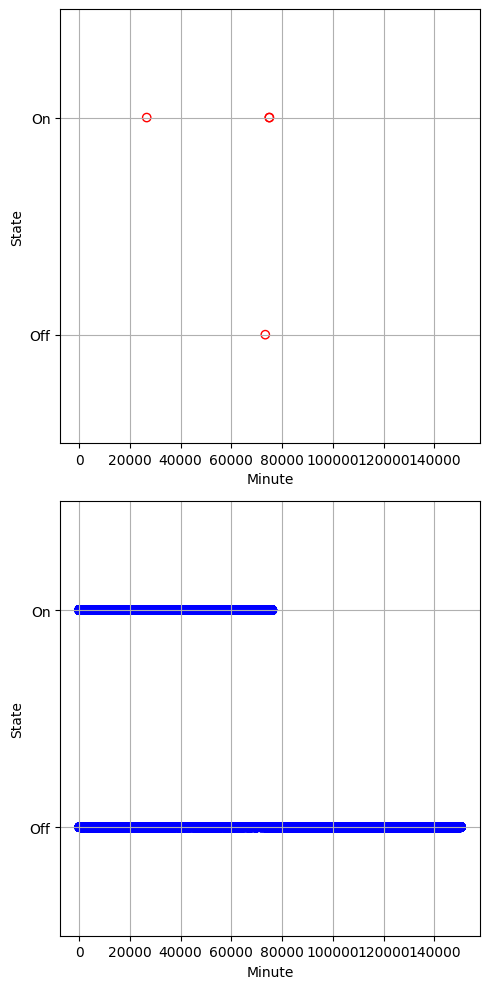

Hardware : SW-065 ; Engine : S118


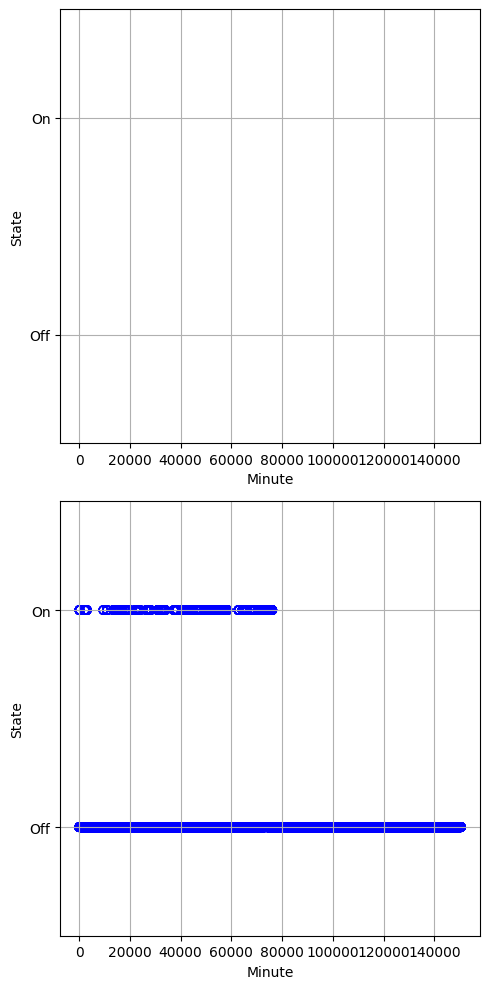

Hardware : SW-065 ; Engine : S169


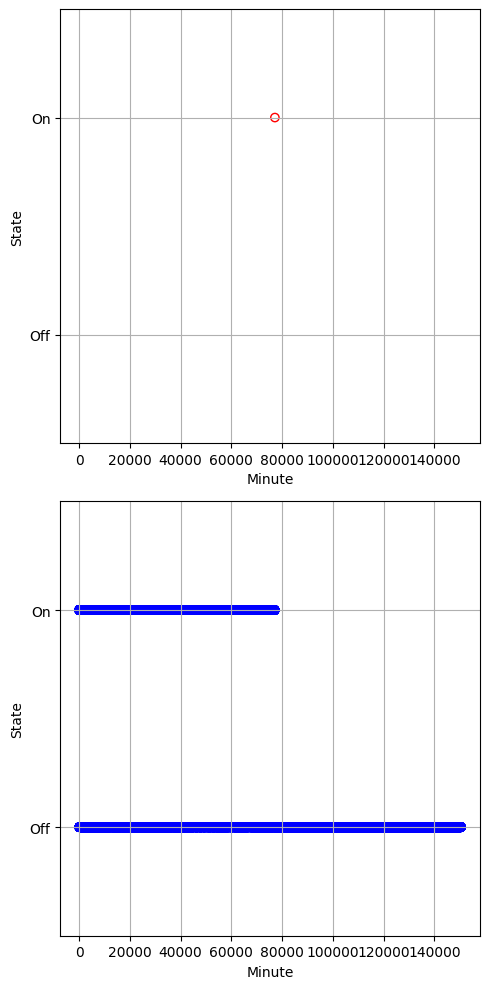

Hardware : SW-065 ; Engine : S170


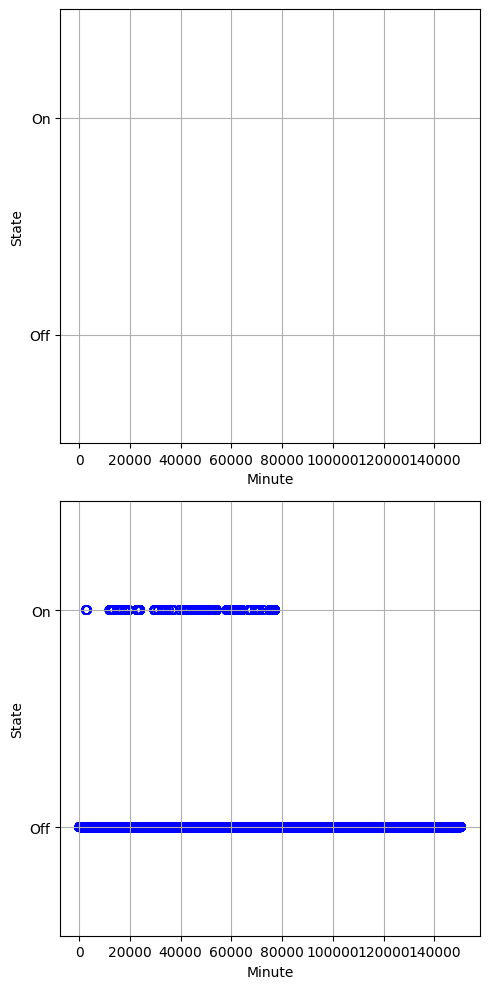

Hardware : SW-088 ; Engine : S117


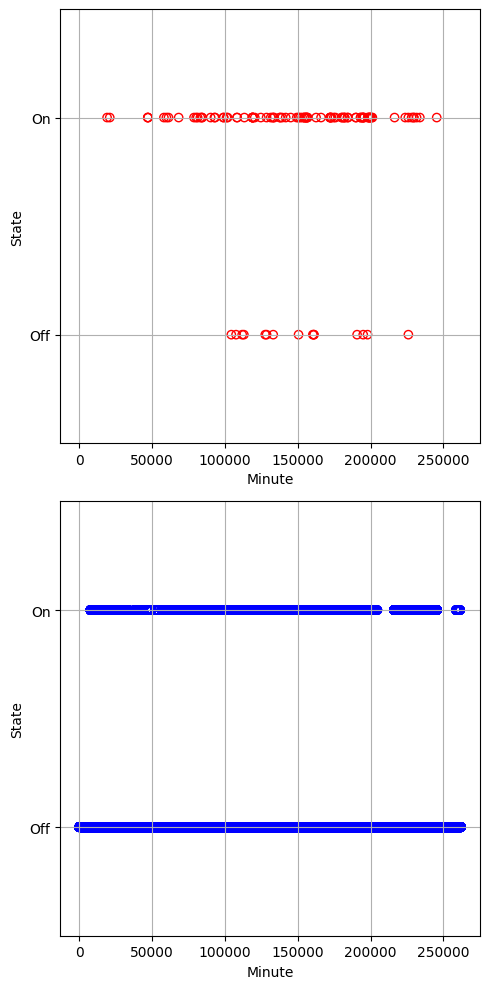

Hardware : SW-088 ; Engine : S118


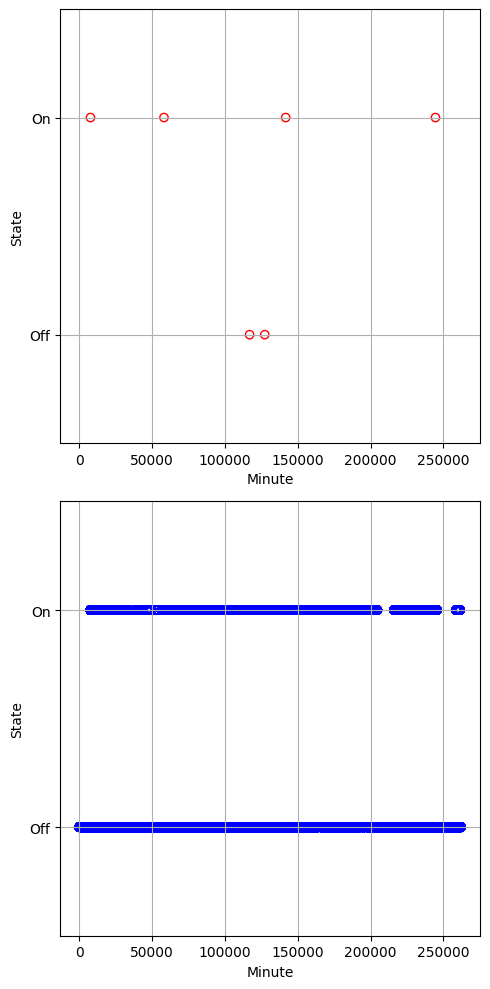

Hardware : SW-088 ; Engine : S169


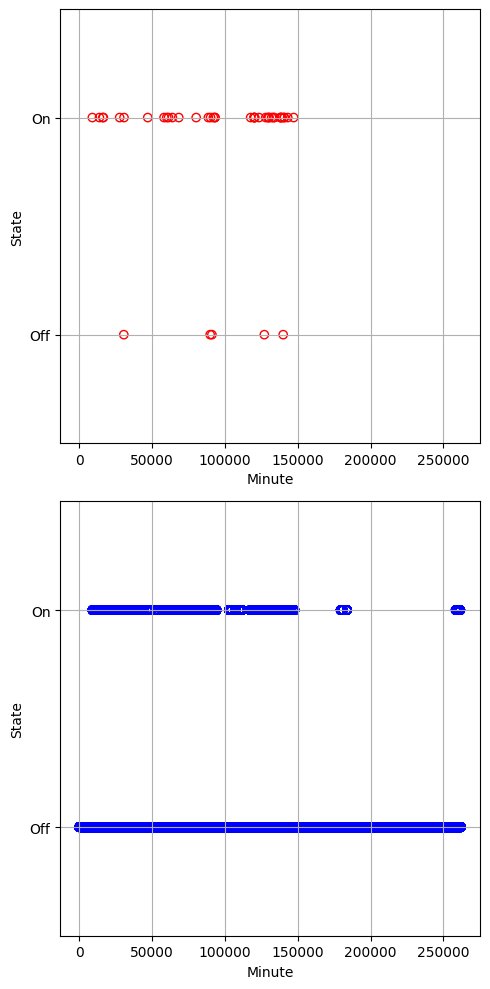

Hardware : SW-088 ; Engine : S170


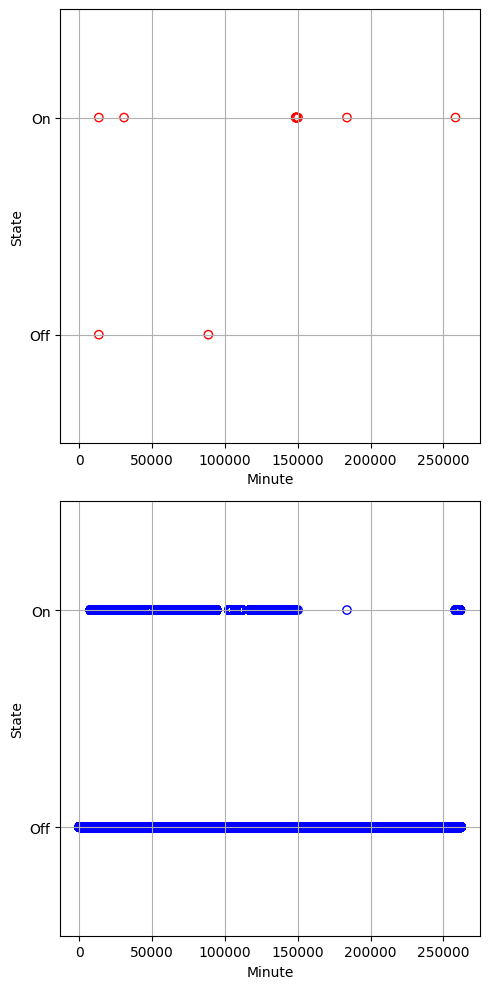

Hardware : SW-106 ; Engine : S117


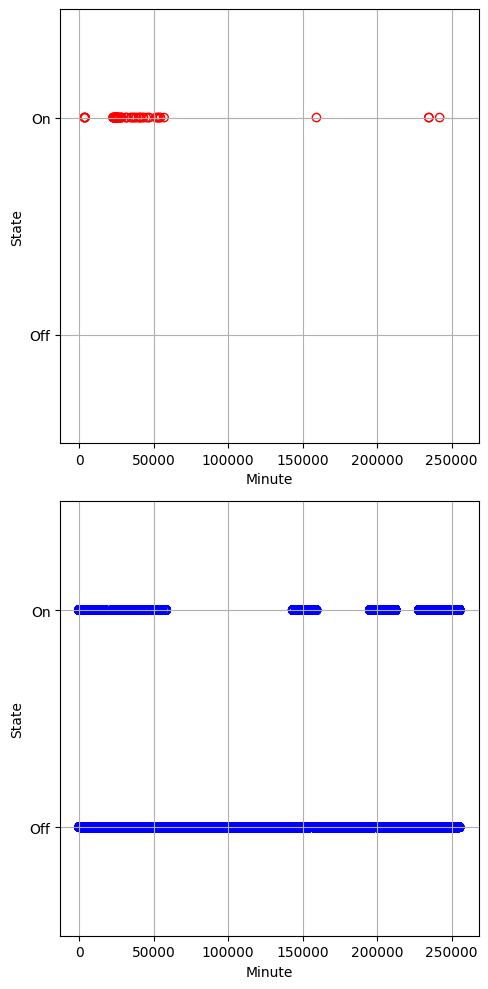

Hardware : SW-106 ; Engine : S118


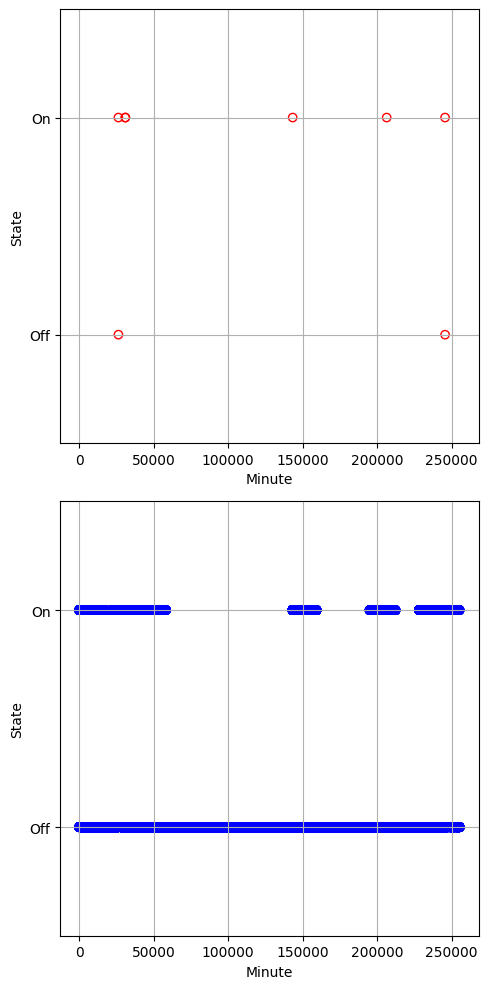

Hardware : SW-106 ; Engine : S169


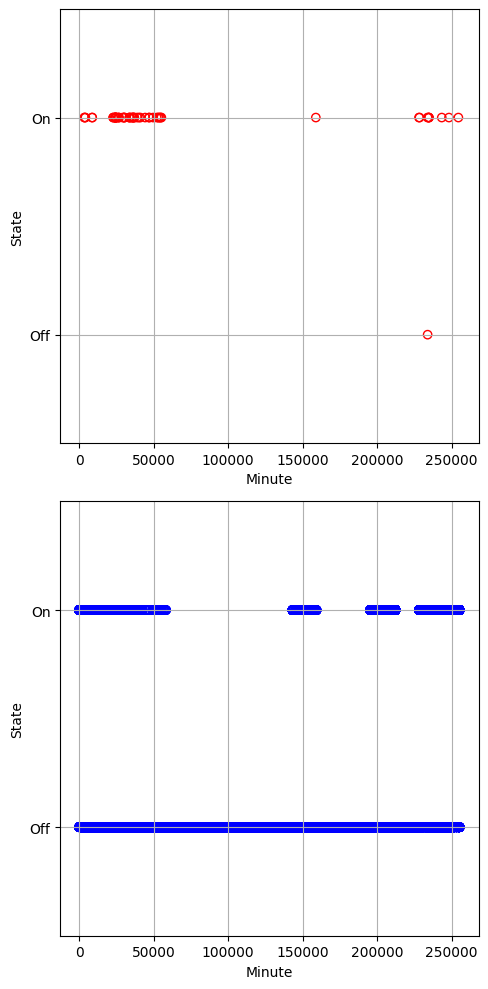

Hardware : SW-106 ; Engine : S170


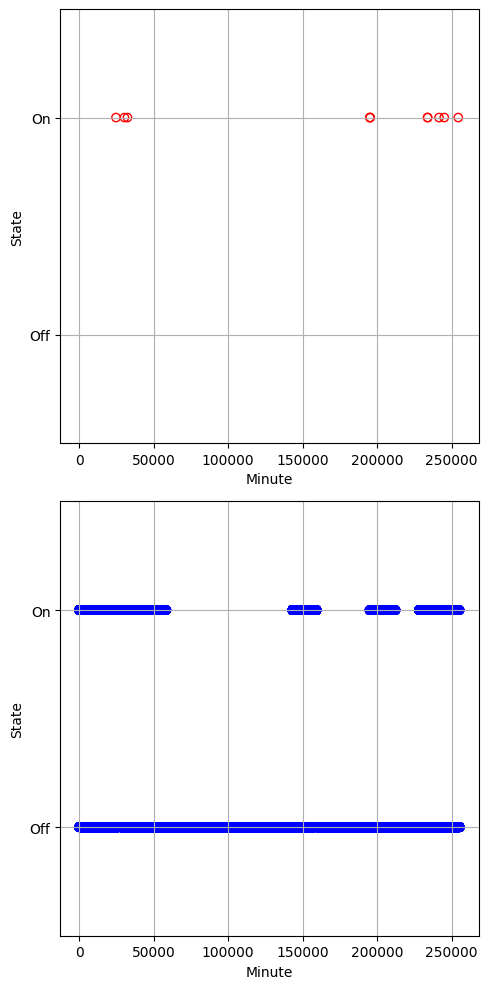

Hardware : SW-115 ; Engine : S117


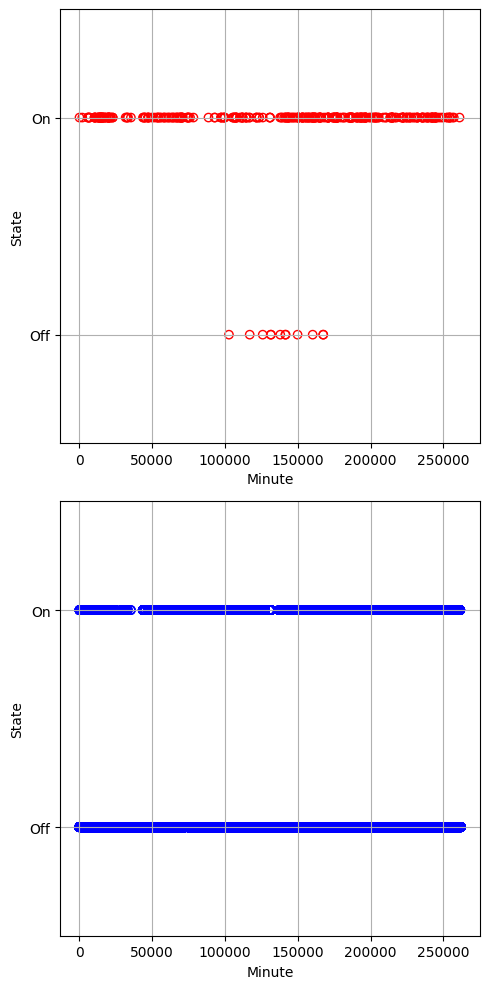

Hardware : SW-115 ; Engine : S118


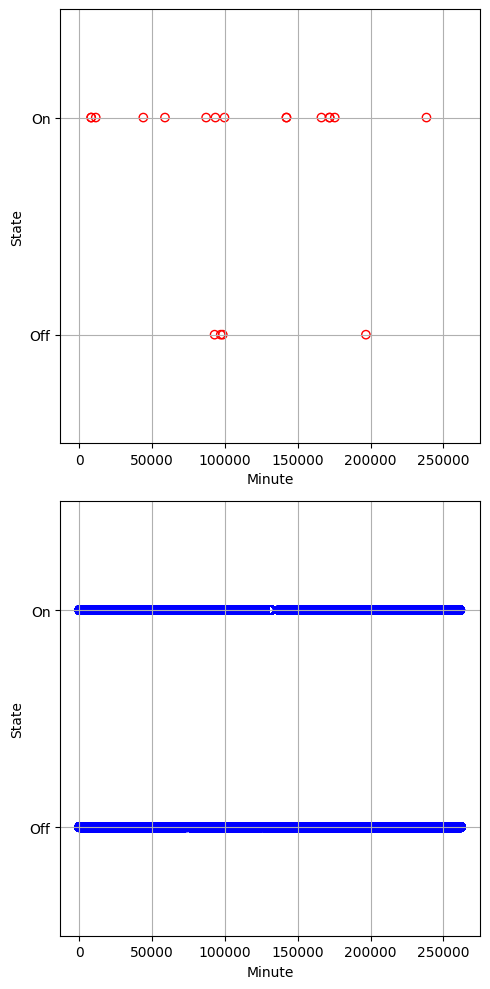

Hardware : SW-115 ; Engine : S169


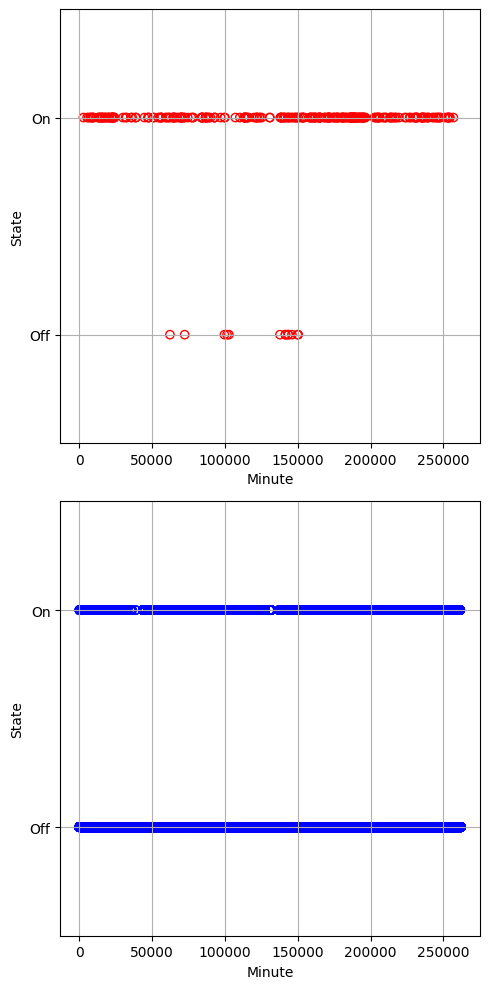

Hardware : SW-115 ; Engine : S170


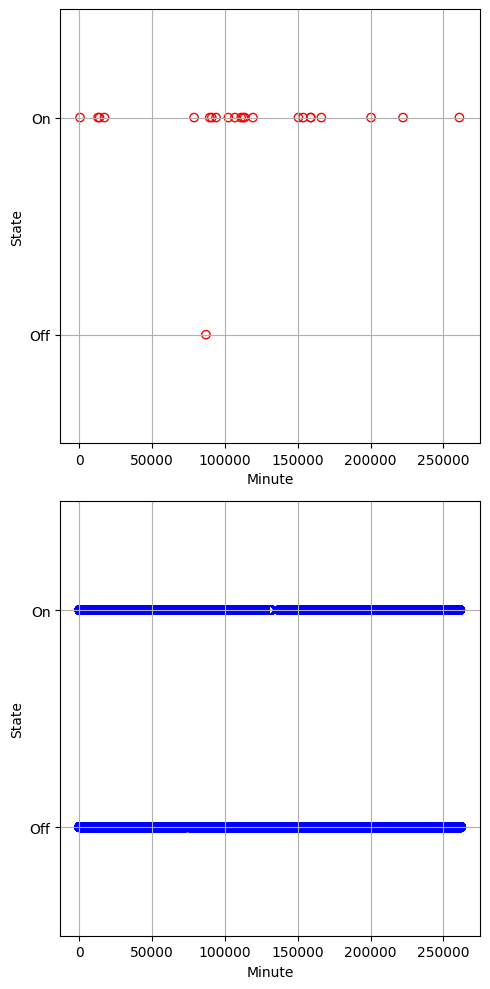

In [8]:
for hw in hwids:
    for metric in metrics:
        print("Hardware :" , hw, "; Engine :", metric)
        time, anom, val = aux.get_norm_val_anom(df, hw, metric, aggfunc='max')
        aux.plot_anom_or_trend(time, anom, val, 'both')

        results_df = pd.DataFrame({
            'Time': time,
            'Anomaly': anom,
            'Value': val
        })

        filepath = f'{hw}_{metric}.csv'
        
        results_df.to_csv(filepath, index=False)

### Task 1.2 (Correlation finding)

In [21]:
motors_list=metrics

In [25]:
def calc_write_correlations(motor_fill,metrics_list,metrics,hw,motor):

    pearson,spearman,kendall,tot=aux.corr_finder(motor_fill,metrics_list,window=50)

    with open(f"{hw}_{motor}_correlations.txt",'a') as file:

        file.write(','.join(metrics))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')
    

An important thing to note when doing these calculations is that the computational time is dominated by the process of normalization/filling of the data. Because of this, we gain hours of time by reusing the already computed values when possible. For example the external metrics (those not circuit or motor specific) are equal for all motors in the same machine and the circuit specific ones can be reused for same-circuit-same-machine motors.

To take advantage of this, we want to first run the correlation study for all the external metrics, then for all the circuit specific ones and finally for the motor specific ones. Unfortunately by doing this we have each file formatted as follows: a first line where the external metrics are listed, followed by as many lines of Pearson coefficients as these metrics are, the same for Spearman, Kendall and the total correlations (this is only 1 line). Then another line with the circuit specific metrics listed, followed by the coefficients and then the same for the motor specific metric. 

However, at the end of this and before plotting the data a bit of manual labour is needed. Our plotting function wants the data in a specific format: we just need to create a first line with all the metrics names (concatenating together the external, circuit specific and motor specific ones), put all Pearson coefficients, followed by all Spearman's and all Kendall's (we keep somewhere else the total coefficients for further analysis).

For these reasons we have reported below the functions that calculate the correlations but we do not advise to run them for two reasons: first of all, the computation time is the longest in the project, secondly one would have to do a bit of work to reformat the files produced if he wishes to plot them later. We also submit, together with the rest of the material, the already formatted files in case one wants to try the plot function.

In [ ]:
#SW-065 externals
metrics=['S10','S33','S39','S40','S41','S5','S53']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[0], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[0], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[0], motors_list[2], aggfunc='mean')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[0], motors_list[3], aggfunc='mean')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[0], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)


calc_write_correlations(motor1,metrics_list,metrics,hwids[0],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[0],motors_list[1])
calc_write_correlations(motor3,metrics_list,metrics,hwids[0],motors_list[2])
calc_write_correlations(motor4,metrics_list,metrics,hwids[0],motors_list[3])

In [ ]:
#SW-088 externals
metrics=['P1','P2','S10','S25','S33','S35','S37','S39','S40','S41','S46','S47','S5','S53','S55','S6','S64','S7','S70','S8','S9']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[1], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[1], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[1], motors_list[2], aggfunc='mean')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[1], motors_list[3], aggfunc='mean')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[1], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)


calc_write_correlations(motor1,metrics_list,metrics,hwids[1],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[1],motors_list[1])
calc_write_correlations(motor3,metrics_list,metrics,hwids[1],motors_list[2])
calc_write_correlations(motor4,metrics_list,metrics,hwids[1],motors_list[3])

In [ ]:
#SW-106 externals
metrics=['P1','P2','S10','S33','S35','S37','S39','S40','S41','S46','S47','S5','S53','S55','S6','S64','S7','S70','S8','S9']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[2], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[2], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[2], motors_list[2], aggfunc='mean')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[2], motors_list[3], aggfunc='mean')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[2], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)


calc_write_correlations(motor1,metrics_list,metrics,hwids[2],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[2],motors_list[1])
calc_write_correlations(motor3,metrics_list,metrics,hwids[2],motors_list[2])
calc_write_correlations(motor4,metrics_list,metrics,hwids[2],motors_list[3])

In [ ]:
#SW-115 externals
metrics=['P1','S10','S33','S37','S39','S40','S41','S46','S47','S5','S53','S55','S6','S7','S70','S8','S9']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[3], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[3], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[3], motors_list[2], aggfunc='mean')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[3], motors_list[3], aggfunc='mean')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[3], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)


calc_write_correlations(motor1,metrics_list,metrics,hwids[3],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[3],motors_list[1])
calc_write_correlations(motor3,metrics_list,metrics,hwids[3],motors_list[2])
calc_write_correlations(motor4,metrics_list,metrics,hwids[3],motors_list[3])

In [ ]:
#SW-065 circuit 1
metrics=['S112','S113','S114','S115','S123','S127','S201','S202','S203','S73',\
        'S100','S101','S102','S106','S107','S108','S122','S124','S126']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[0], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[0], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[0], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min2, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor1,metrics_list,metrics,hwids[0],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[0],motors_list[1])

In [ ]:
#SW-065 circuit 2
metrics=['S130','S171','S172','S173','S174','S179','S183','S204','S205','S206',\
        'S157','S158','S159','S163','S164','S165','S178','S180']

metrics_list=[]

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[0], motors_list[2], aggfunc='mean')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[0], motors_list[3], aggfunc='mean')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[0], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor3,metrics_list,metrics,hwids[0],motors_list[2])
calc_write_correlations(motor4,metrics_list,metrics,hwids[0],motors_list[3])

In [ ]:
#SW-088 circuit 1
metrics=['S112','S113','S114','S115','S123','S127','S201','S202','S203','S73',\
        'S100','S101','S102','S106','S107','S108','S122','S124','S126']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[1], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[1], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[1], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min2, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor1,metrics_list,metrics,hwids[1],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[1],motors_list[1])

In [ ]:
#SW-088 circuit 2
metrics=['S130','S171','S172','S173','S174','S179','S183','S204','S205','S206',\
        'S157','S158','S159','S163','S164','S165','S178','S180']

metrics_list=[]

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[1], motors_list[2], aggfunc='mean')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[1], motors_list[3], aggfunc='mean')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[1], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor3,metrics_list,metrics,hwids[1],motors_list[2])
calc_write_correlations(motor4,metrics_list,metrics,hwids[1],motors_list[3])

In [ ]:
#SW-106 circuit 1
metrics=['S112','S113','S114','S115','S123','S127','S201','S202','S203','S73',\
        'S100','S101','S102','S106','S107','S108','S122','S124','S126']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[2], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[2], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[2], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min2, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor1,metrics_list,metrics,hwids[2],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[2],motors_list[1])

In [ ]:
#SW-106 circuit 2
metrics=['S130','S171','S172','S173','S174','S179','S183','S204','S205','S206',\
        'S157','S158','S159','S163','S164','S165','S178','S180']

metrics_list=[]

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[2], motors_list[2], aggfunc='mean')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[2], motors_list[3], aggfunc='mean')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[2], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor3,metrics_list,metrics,hwids[2],motors_list[3])
calc_write_correlations(motor4,metrics_list,metrics,hwids[2],motors_list[4])

In [ ]:
#SW-115 circuit 1
metrics=['S112','S113','S114','S115','S123','S127','S201','S202','S203','S73',\
        'S100','S101','S102','S106','S107','S108','S122','S124','S126']

metrics_list=[]

min1, anom1, val1 = aux.get_norm_val_anom(df, hwids[3], motors_list[0], aggfunc='mean')
motor1 = pd.DataFrame({'Minute':min1, 'Anomaly':anom1, 'Value':val1})

min2, anom2, val2 = aux.get_norm_val_anom(df, hwids[3], motors_list[1], aggfunc='mean')
motor2 = pd.DataFrame({'Minute':min2, 'Anomaly':anom2, 'Value':val2})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[3], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min2, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor1,metrics_list,metrics,hwids[3],motors_list[0])
calc_write_correlations(motor2,metrics_list,metrics,hwids[3],motors_list[1])

In [ ]:
#SW-115 circuit 2
metrics=['S130','S171','S172','S173','S174','S179','S183','S204','S205','S206',\
        'S157','S158','S159','S163','S164','S165','S178','S180']

metrics_list=[]

min3, anom3, val3 = aux.get_norm_val_anom(df, hwids[3], motors_list[2], aggfunc='max')
motor3 = pd.DataFrame({'Minute':min3, 'Anomaly':anom3, 'Value':val3})

min4, anom4, val4 = aux.get_norm_val_anom(df, hwids[3], motors_list[3], aggfunc='max')
motor4 = pd.DataFrame({'Minute':min4, 'Anomaly':anom4, 'Value':val4})
    
for metric in metrics:
    print(f"Calculating for metric {metric}")
    metric_val, metric_min = aux.get_norm_data(df, hwids[3], metric)
    metric_fill = aux.fill_missing_min(metric_val, metric_min)
    metric_df = pd.DataFrame({'Minute':min4, 'Value':metric_fill})
    metrics_list.append(metric_df)

calc_write_correlations(motor3,metrics_list,metrics,hwids[3],motors_list[2])
calc_write_correlations(motor4,metrics_list,metrics,hwids[3],motors_list[3])

In [ ]:
#SW-065 motor-specific 

min, anom, val = aux.get_norm_val_anom(df, hwids[0], motors_list[0], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[0],'S109')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[0],motors_list[0])

min, anom, val = aux.get_norm_val_anom(df, hwids[0], motors_list[1], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[0],'S110')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[0],motors_list[1])

min, anom, val = aux.get_norm_val_anom(df, hwids[0], motors_list[2], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[0],'S166')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[0],motors_list[2])

min, anom, val = aux.get_norm_val_anom(df, hwids[0], motors_list[3], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[0],'S167')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[0],motors_list[3])

In [ ]:
#SW-088 motor-specific 

min, anom, val = aux.get_norm_val_anom(df, hwids[1], motors_list[0], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[1],'S109')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[1],motors_list[0])

min, anom, val = aux.get_norm_val_anom(df, hwids[1], motors_list[1], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[1],'S110')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[1],motors_list[1])

min, anom, val = aux.get_norm_val_anom(df, hwids[1], motors_list[2], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[1],'S166')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[1],motors_list[2])

min, anom, val = aux.get_norm_val_anom(df, hwids[1], motors_list[3], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[1],'S167')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[1],motors_list[3])

In [ ]:
#SW-106 motor-specific 

min, anom, val = aux.get_norm_val_anom(df, hwids[2], motors_list[0], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[2],'S109')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[2],motors_list[0])

min, anom, val = aux.get_norm_val_anom(df, hwids[2], motors_list[1], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[2],'S110')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[2],motors_list[1])

min, anom, val = aux.get_norm_val_anom(df, hwids[2], motors_list[2], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[2],'S166')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[2],motors_list[2])

min, anom, val = aux.get_norm_val_anom(df, hwids[2], motors_list[3], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[2],'S167')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[2],motors_list[3])

In [ ]:
#SW-115 motor-specific 

min, anom, val = aux.get_norm_val_anom(df, hwids[3], motors_list[0], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[3],'S109')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[3],motors_list[0])

min, anom, val = aux.get_norm_val_anom(df, hwids[3], motors_list[1], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[3],'S110')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[3],motors_list[1])

min, anom, val = aux.get_norm_val_anom(df, hwids[3], motors_list[2], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[3],'S166')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[3],motors_list[2])

min, anom, val = aux.get_norm_val_anom(df, hwids[3], motors_list[3], aggfunc='max')
motor = pd.DataFrame({'Minute':min, 'Anomaly':anom, 'Value':val})
metric_val,metric_min=aux.get_norm_data(df,hwids[3],'S167')
metric_fill=aux.fill_missing_min(metric_val,metric_min)
metric_df=pd.DataFrame({'Minute':min, 'Value':metric_fill})
metrics_list=[metric_df]
calc_write_correlations(motor,metrics_list,metrics,hwids[3],motors_list[3])

Plotting all non-NaN Pearson coefficients
41


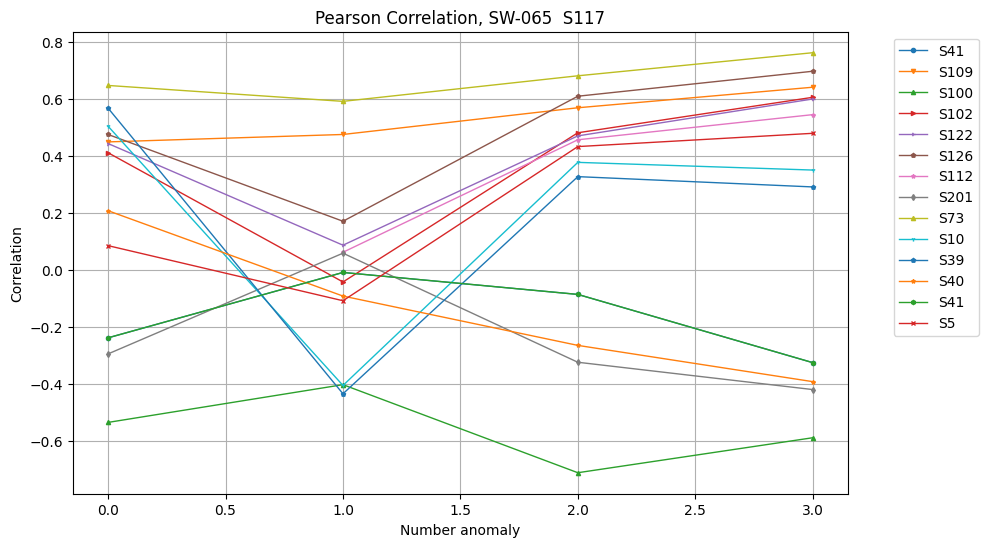

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
41


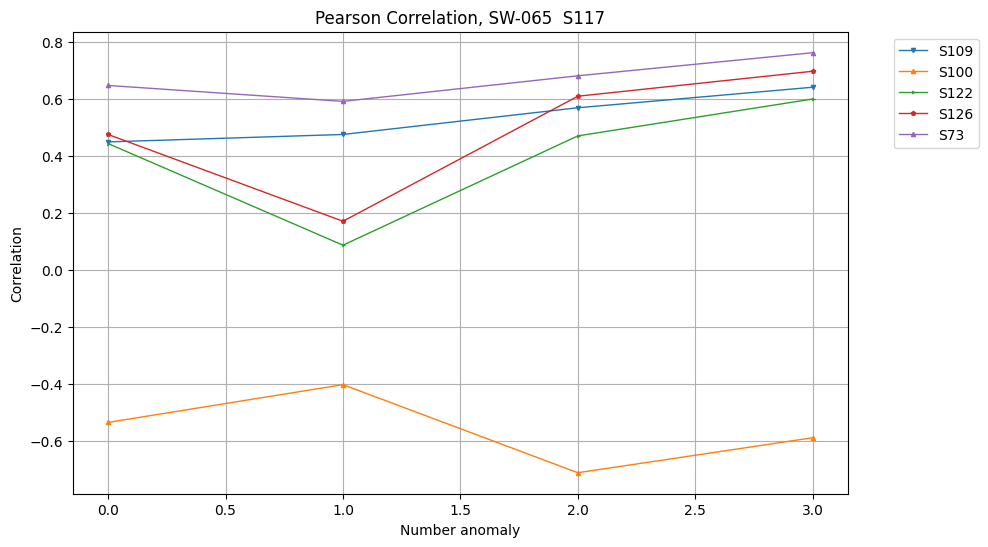

Plotting all non-NaN Spearman coefficients
41


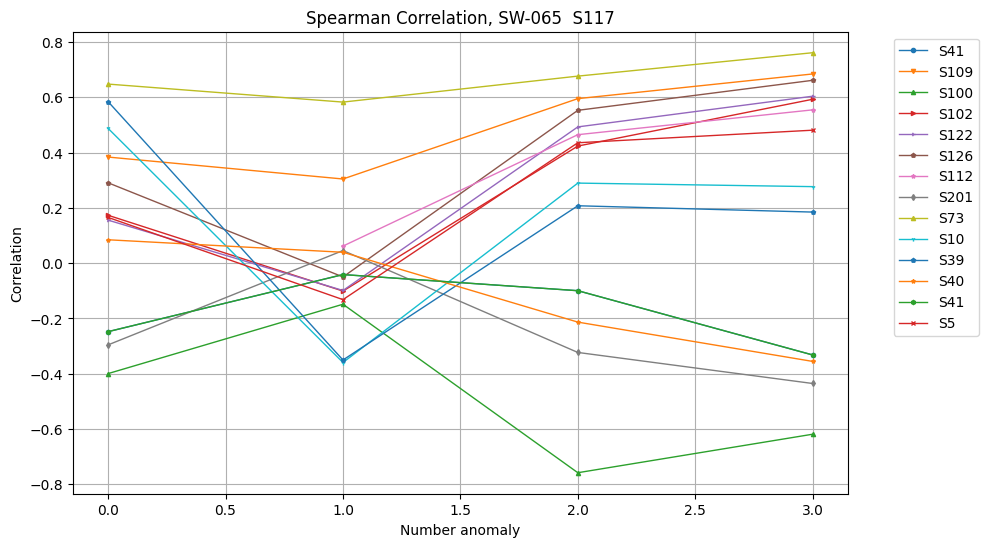

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
41


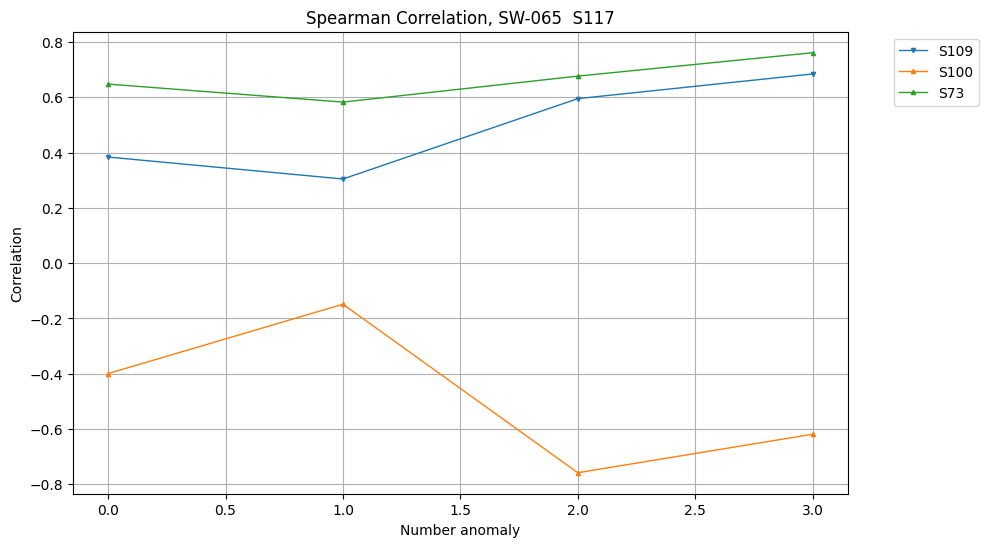

Plotting all non-NaN Kendall coefficients
41


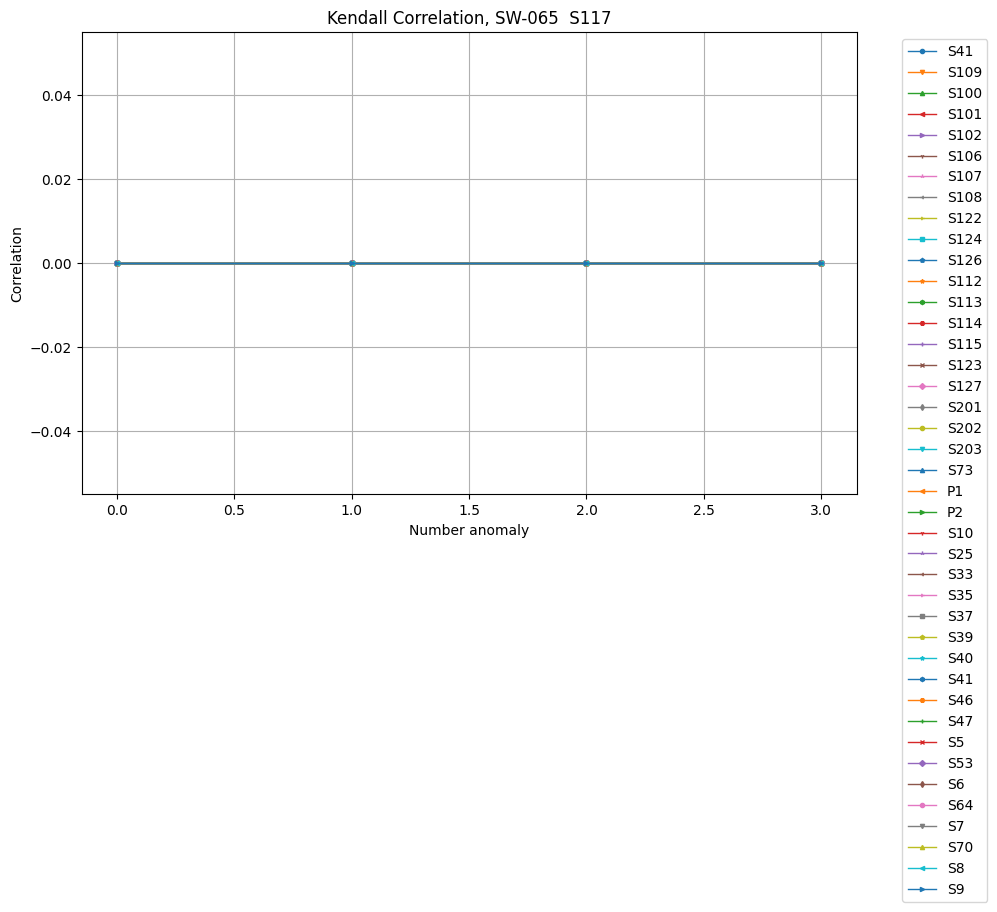

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
41


/home/braidi/aux.py:441: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


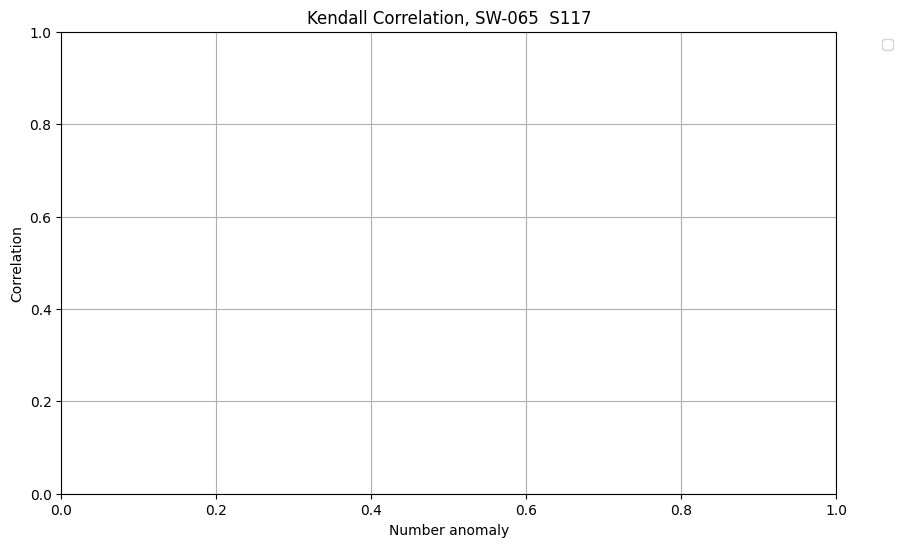

Plotting all non-NaN Pearson coefficients
26


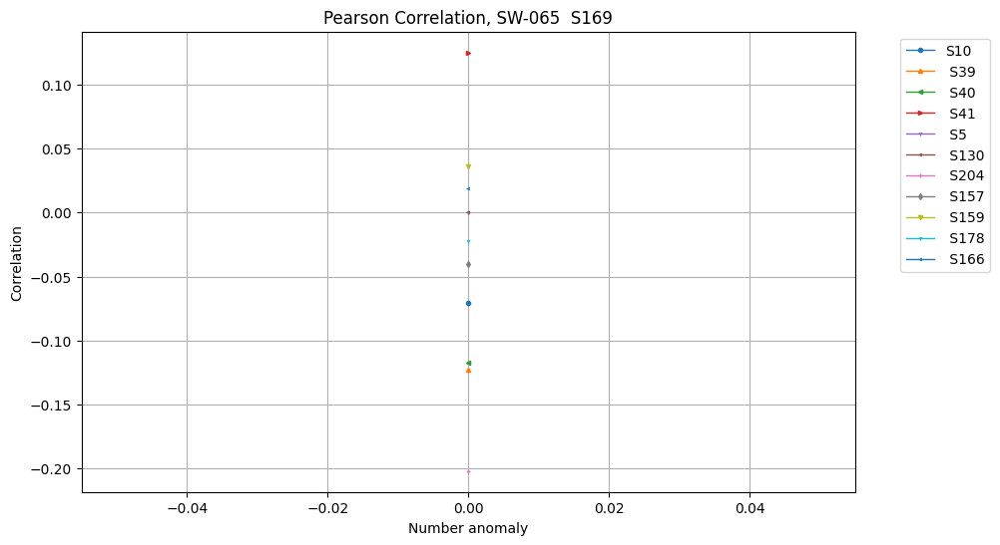

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
26


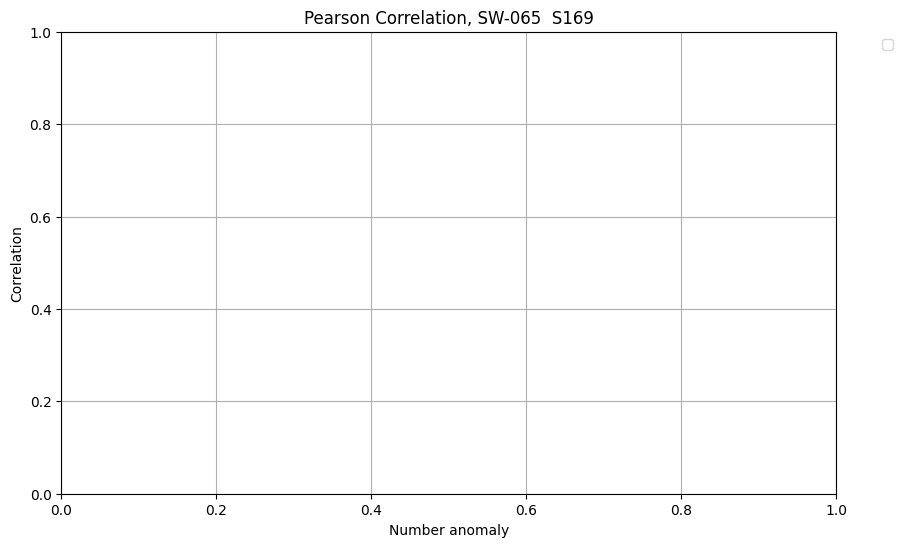

Plotting all non-NaN Spearman coefficients
26


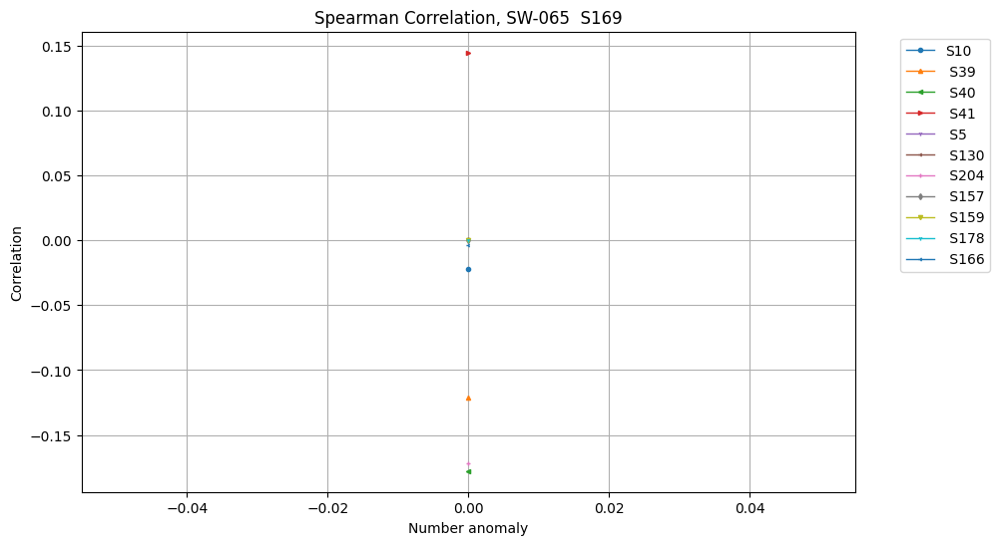

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
26


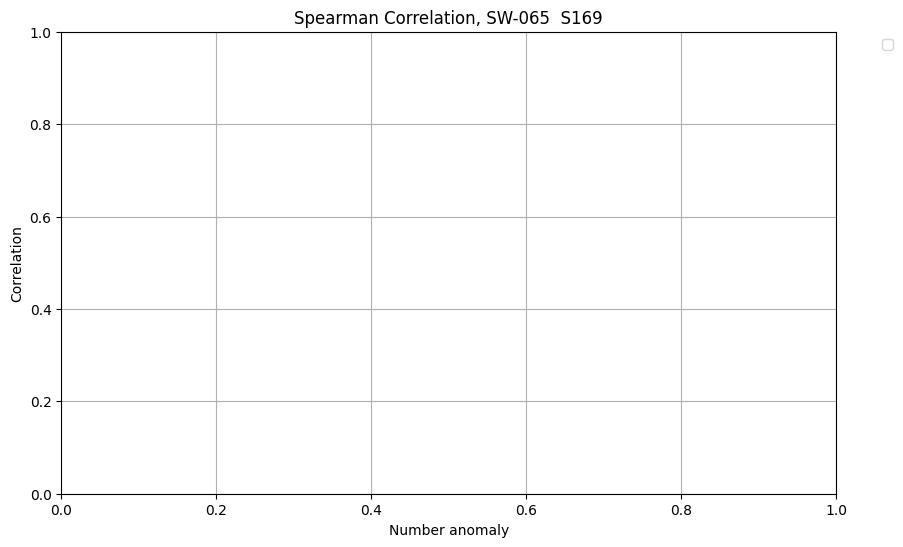

Plotting all non-NaN Kendall coefficients
26


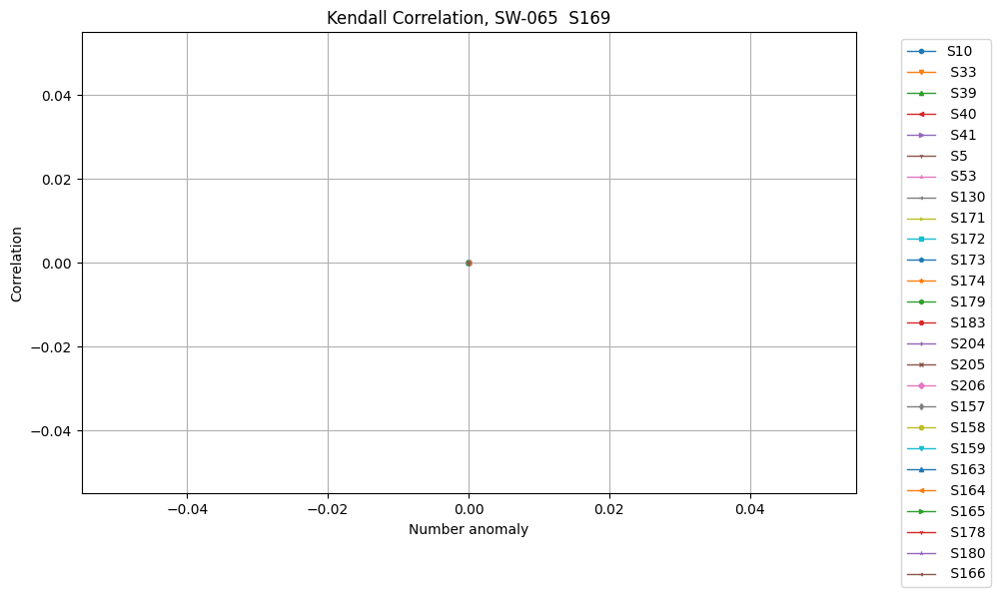

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
26


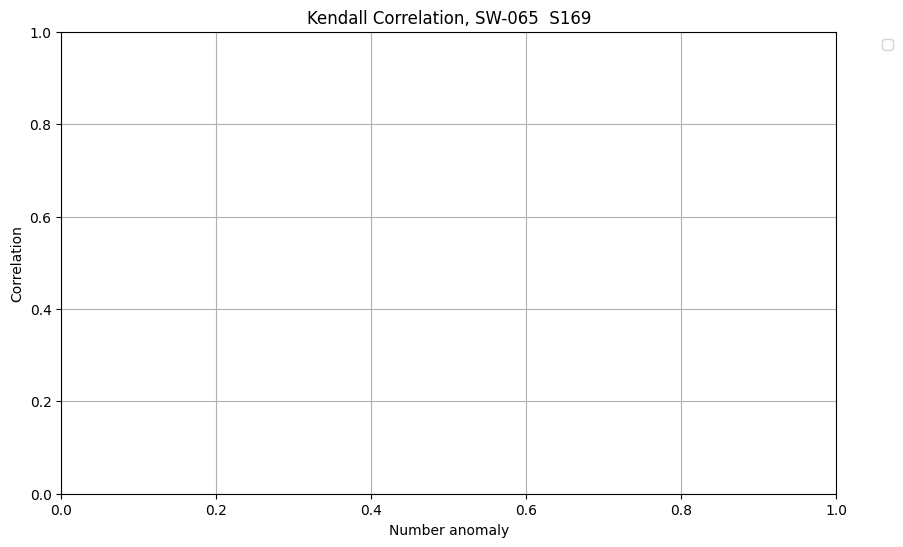

Plotting all non-NaN Pearson coefficients
42


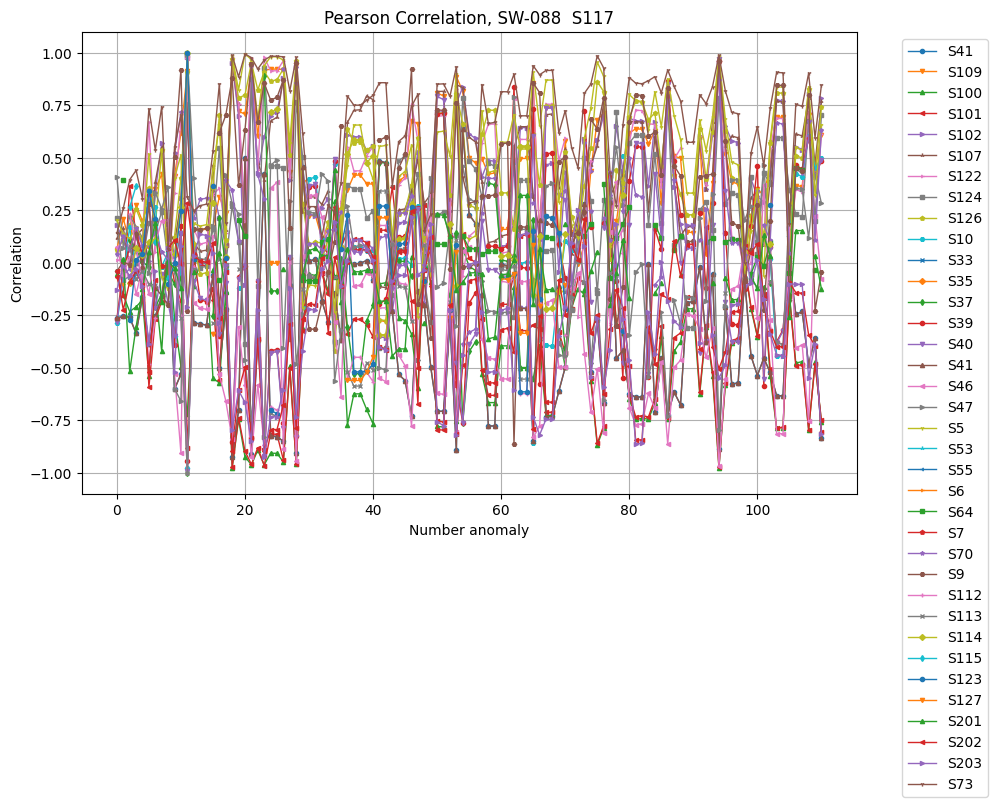

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
42


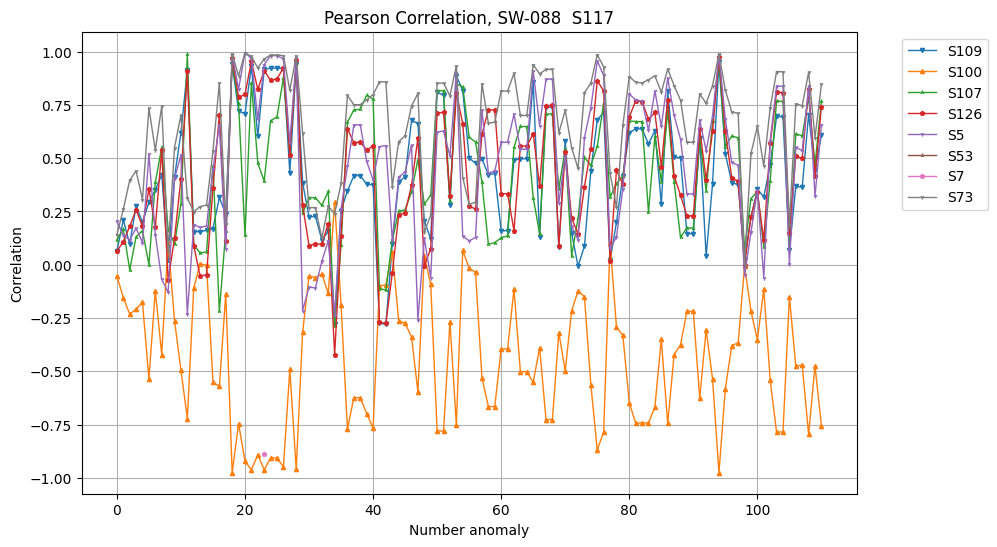

Plotting all non-NaN Spearman coefficients
42


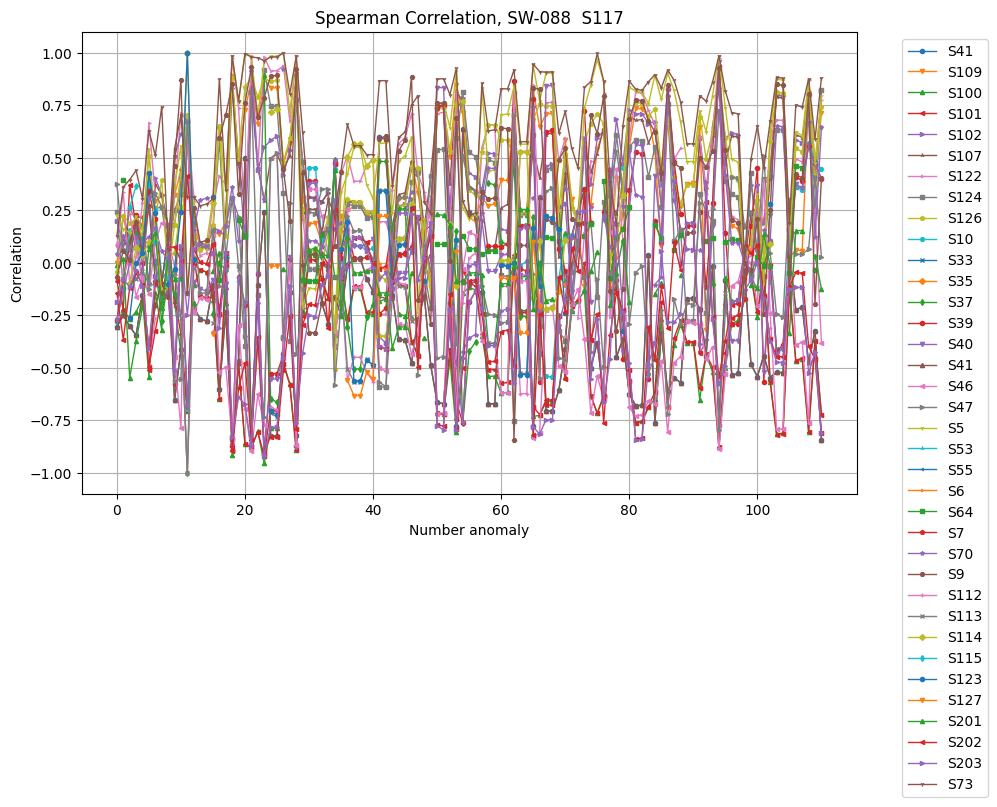

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
42


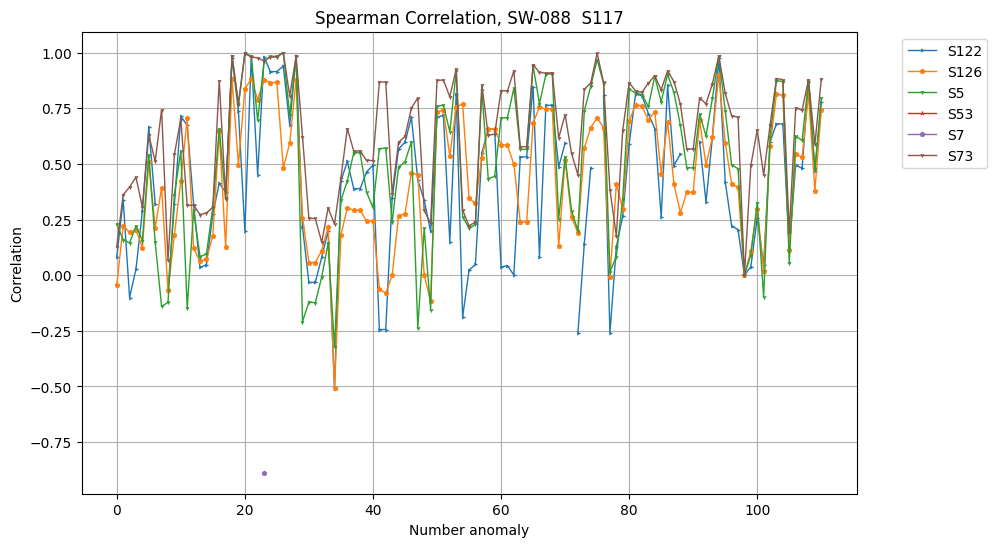

Plotting all non-NaN Kendall coefficients
42


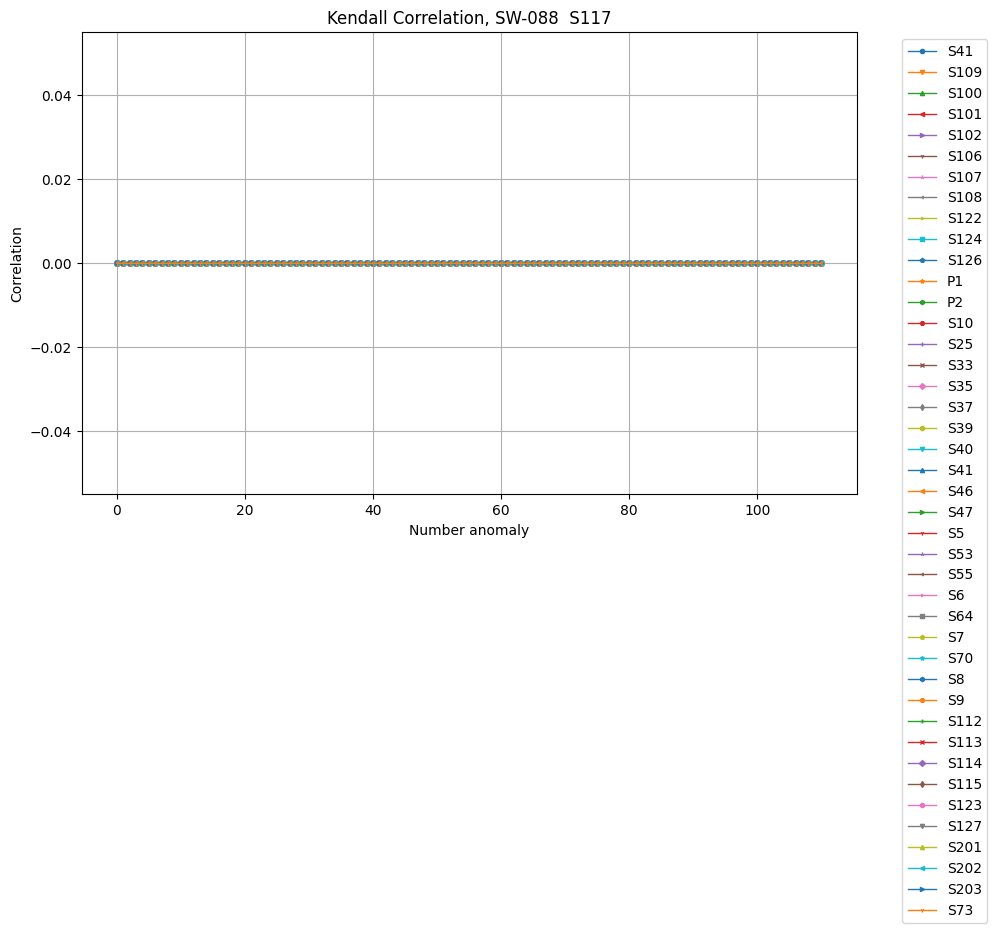

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
42


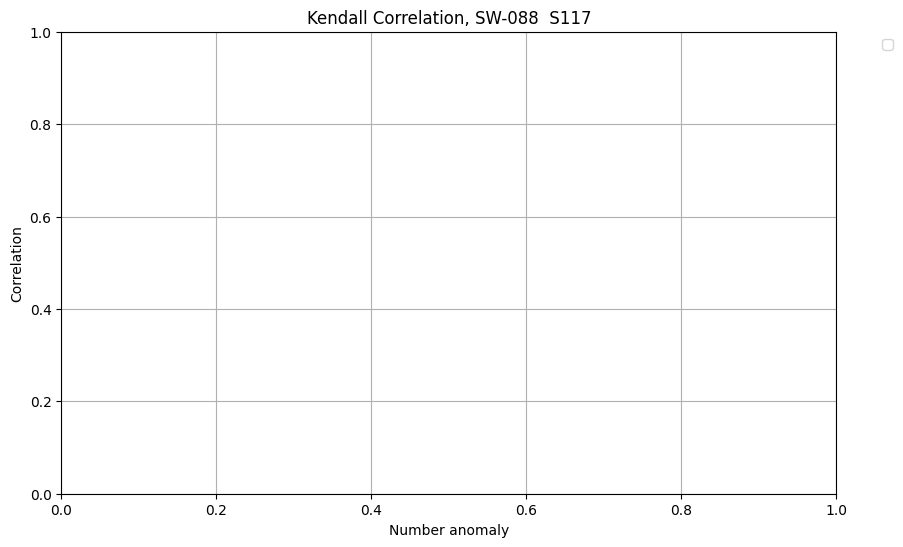

Plotting all non-NaN Pearson coefficients
11


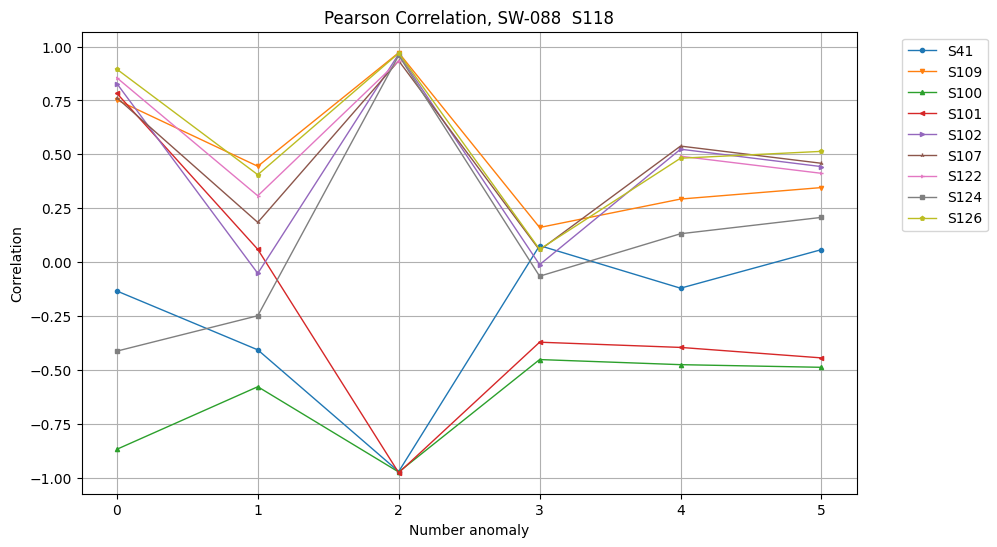

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
11


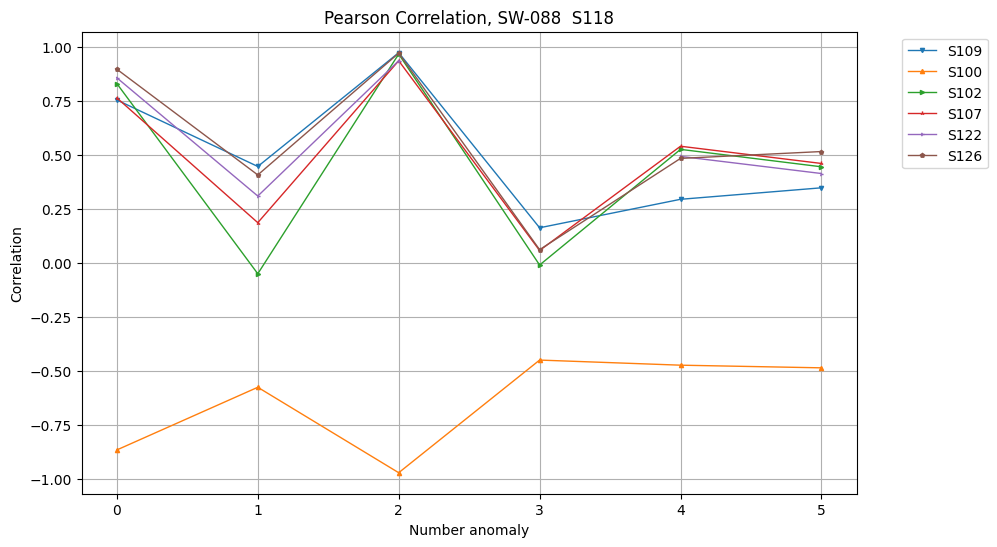

Plotting all non-NaN Spearman coefficients
11


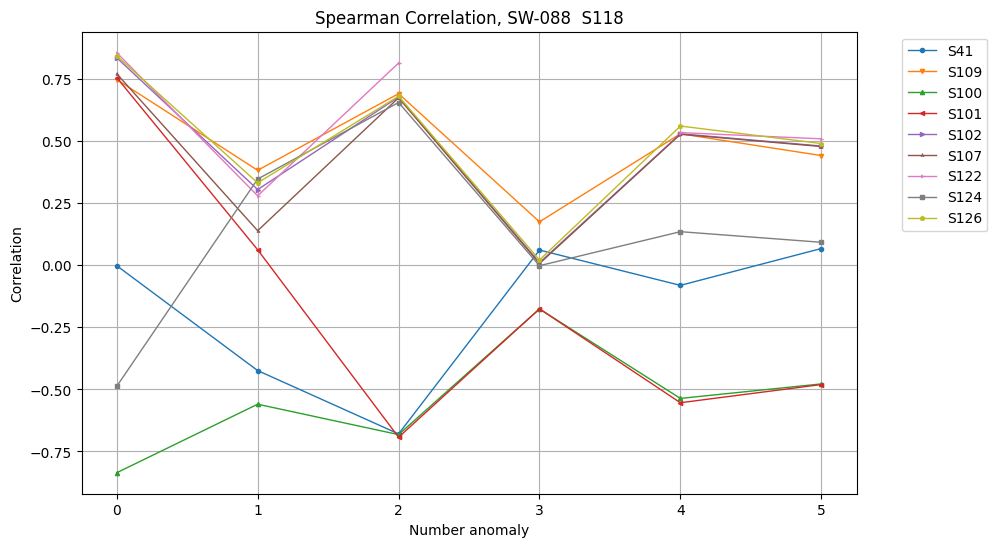

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
11


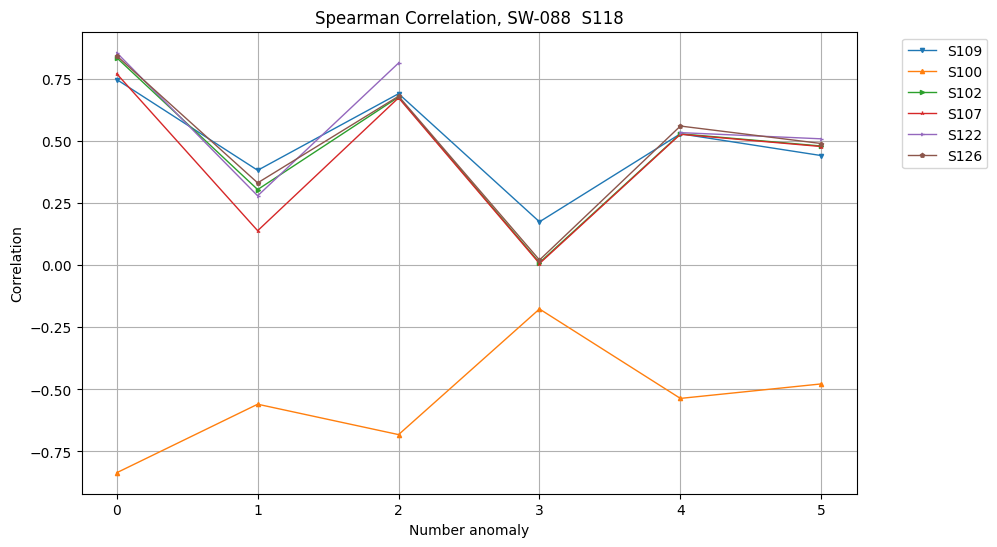

Plotting all non-NaN Kendall coefficients
11


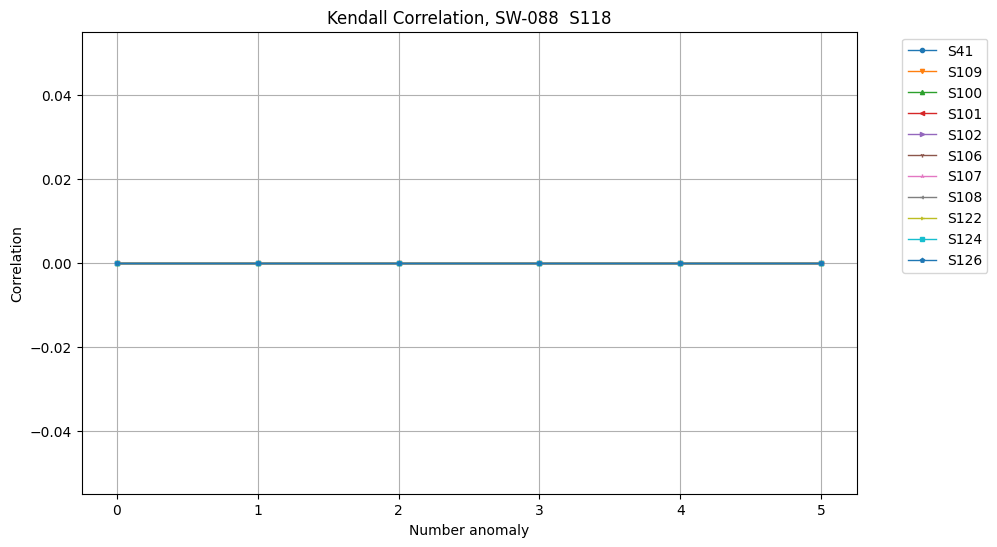

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
11


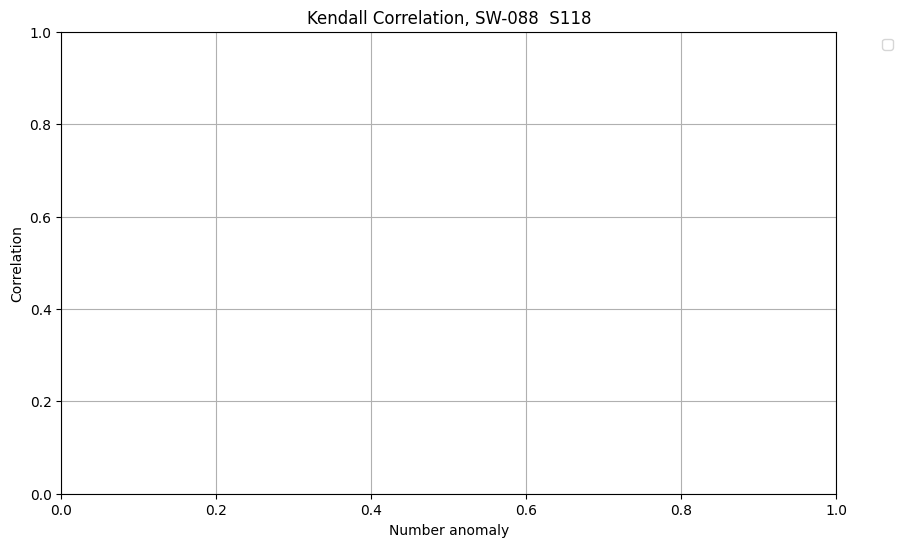

Plotting all non-NaN Pearson coefficients
40


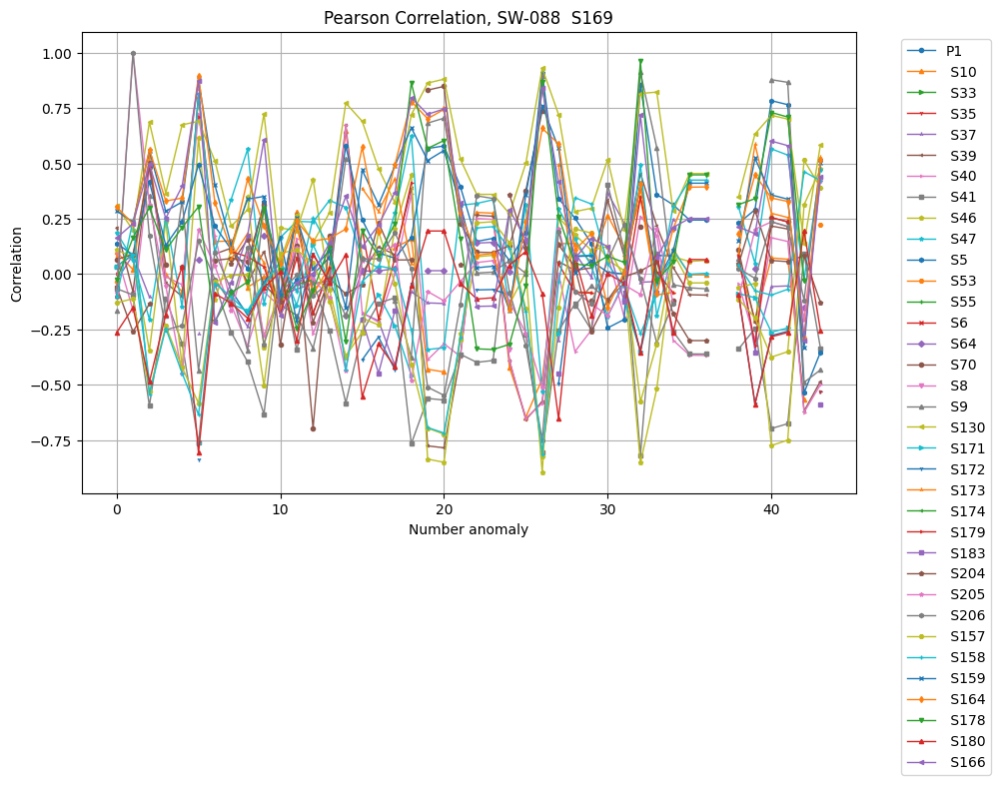

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
40


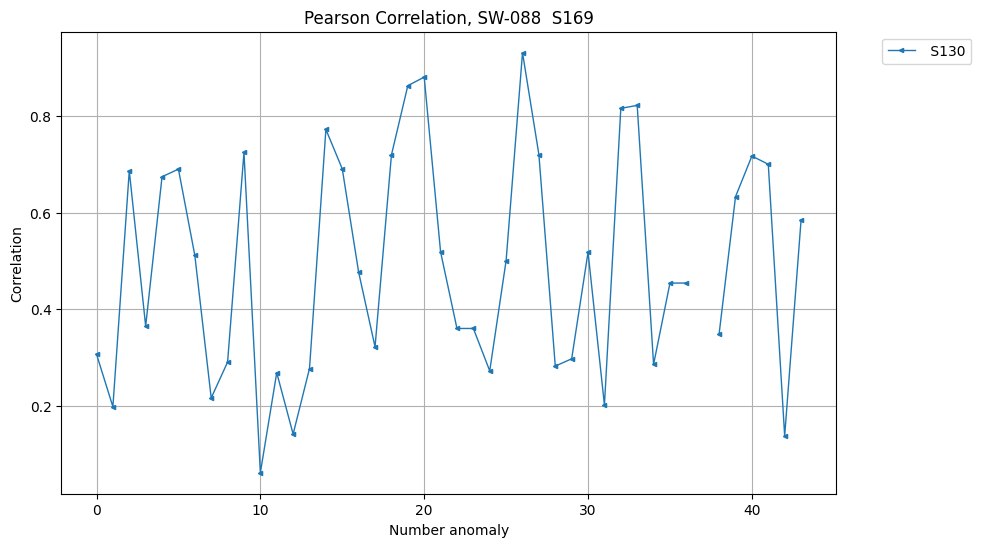

Plotting all non-NaN Spearman coefficients
40


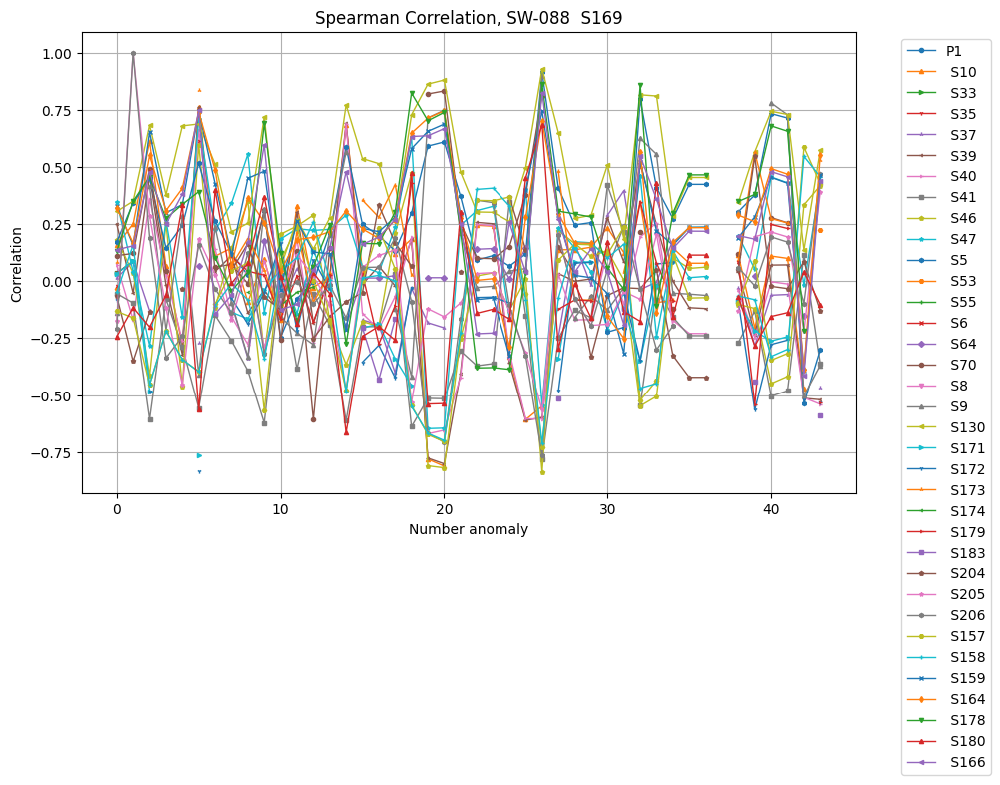

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
40


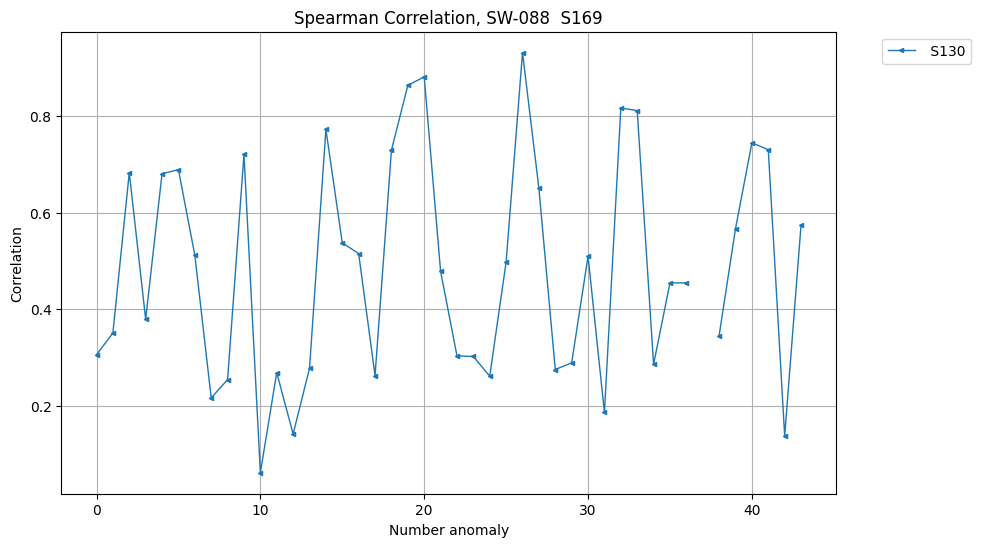

Plotting all non-NaN Kendall coefficients
40


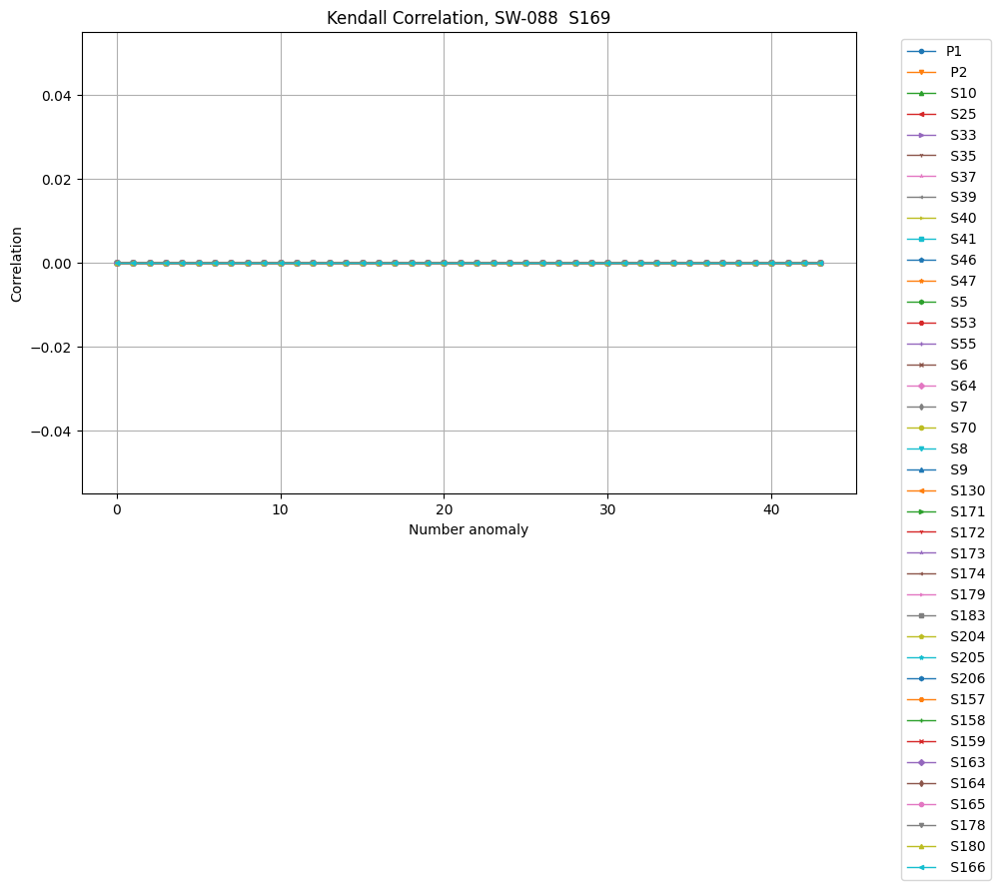

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
40


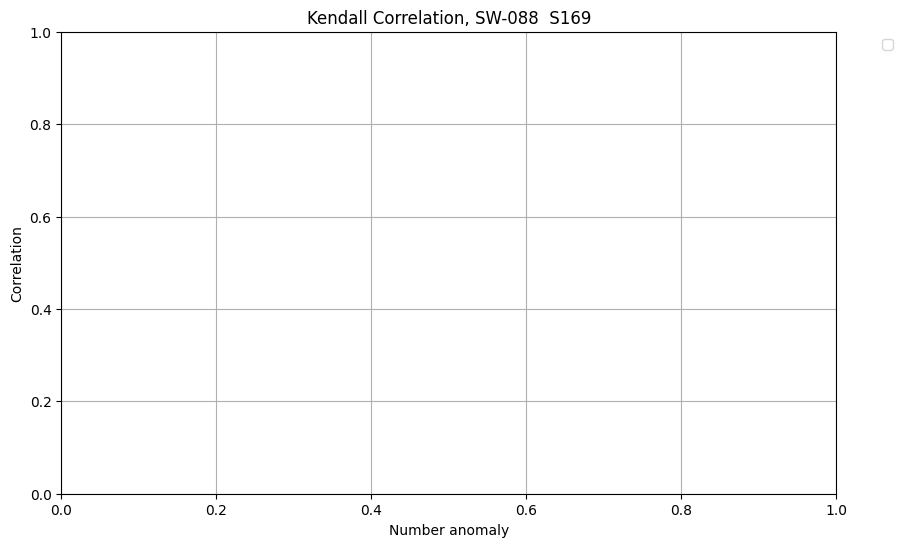

Plotting all non-NaN Pearson coefficients
40


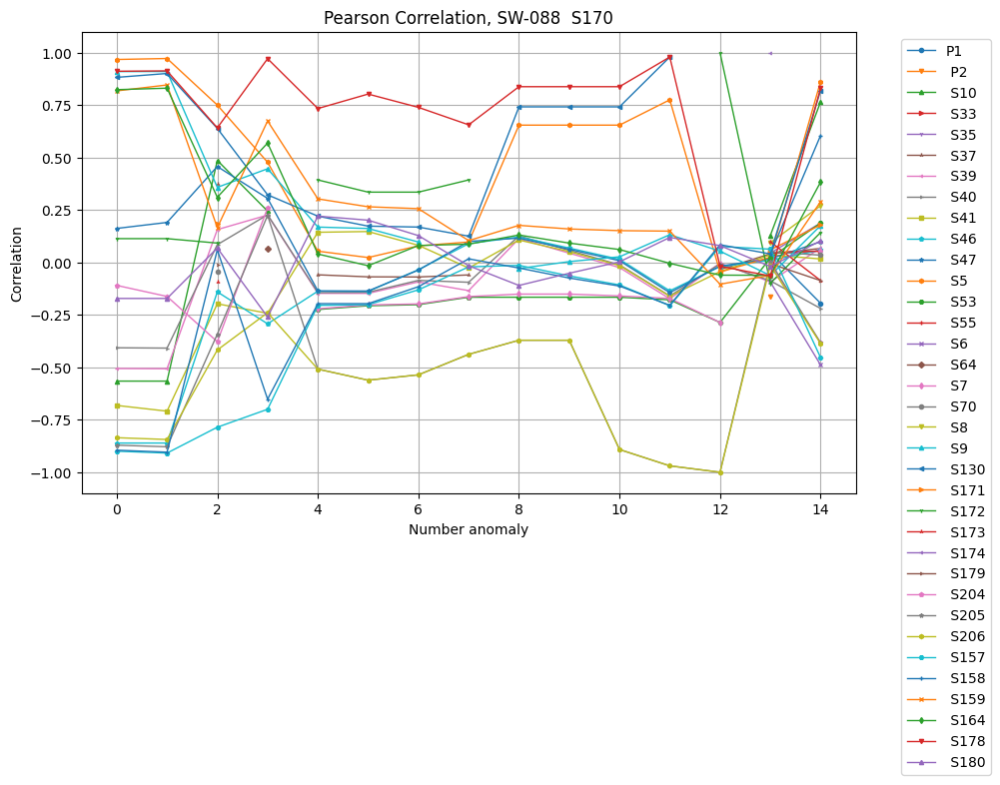

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
40


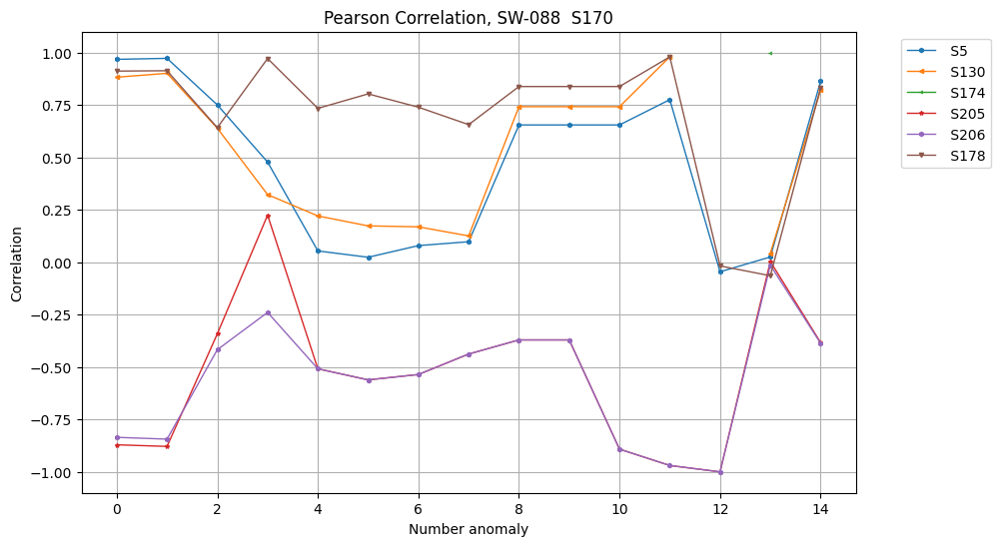

Plotting all non-NaN Spearman coefficients
40


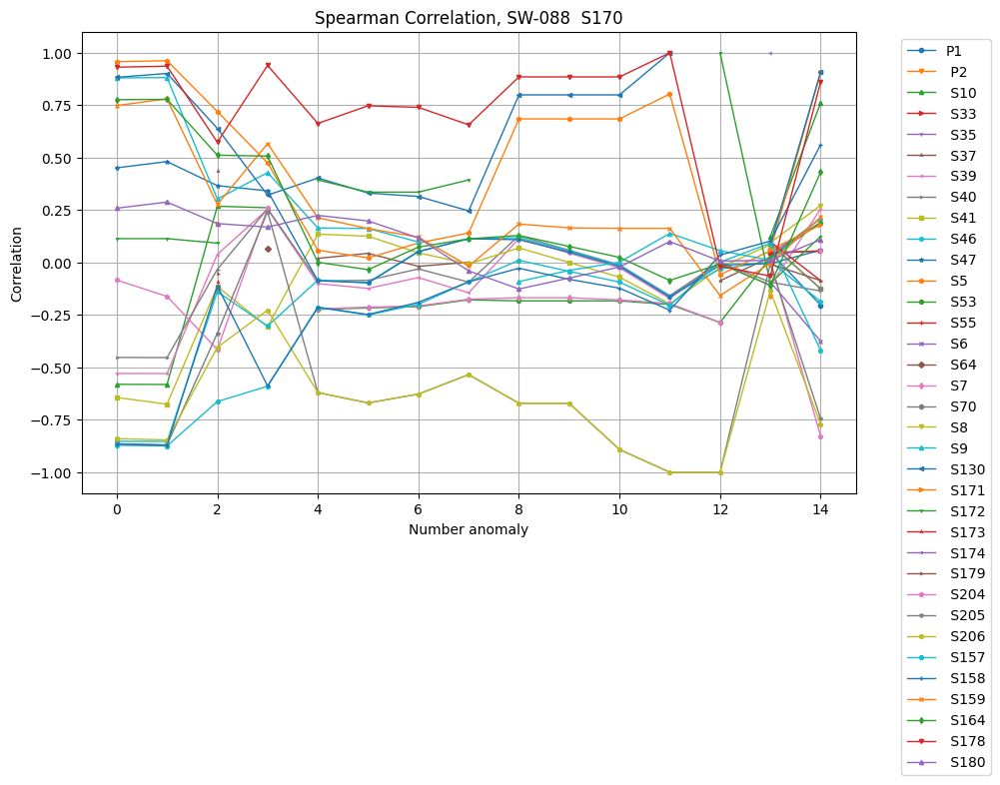

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
40


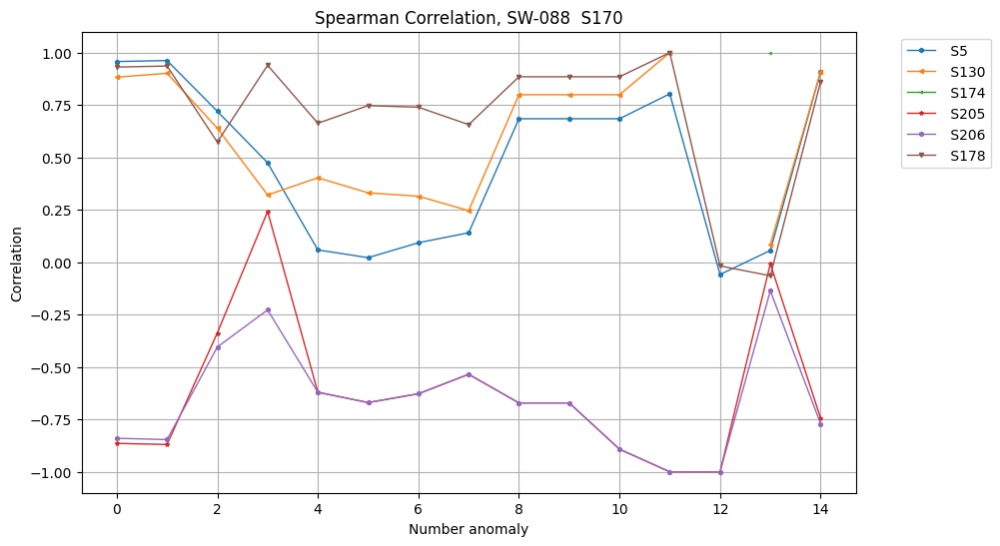

Plotting all non-NaN Kendall coefficients
40


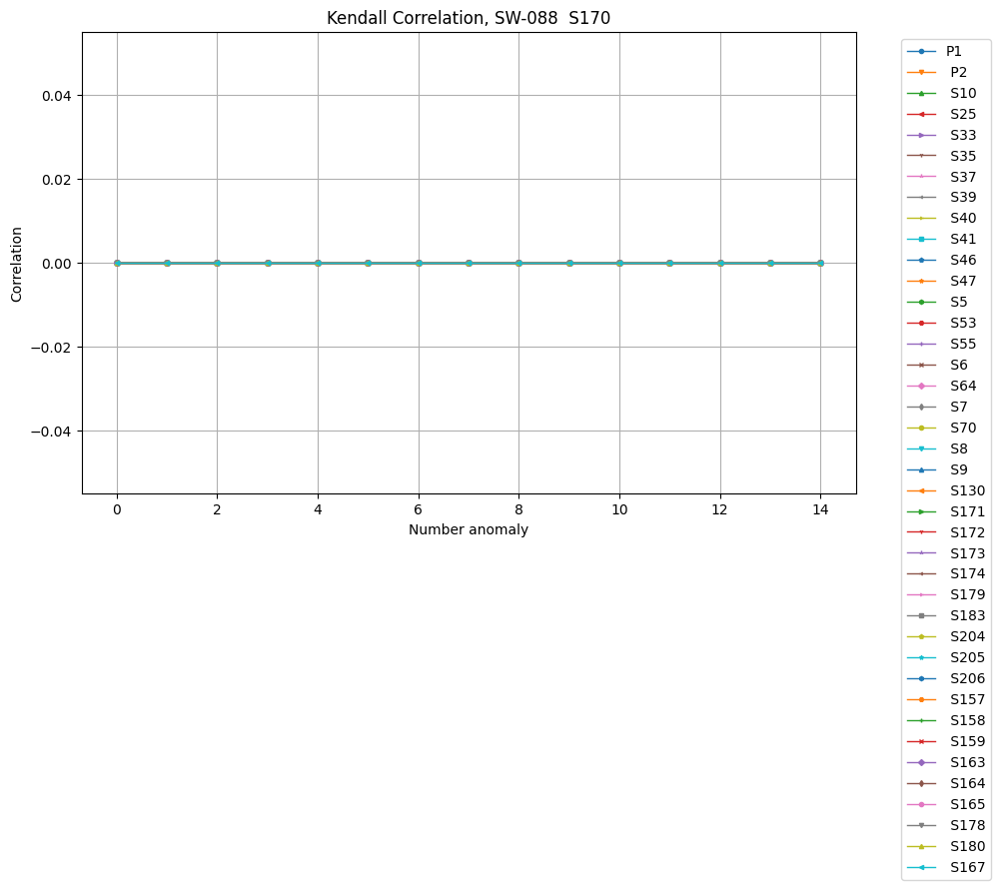

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
40


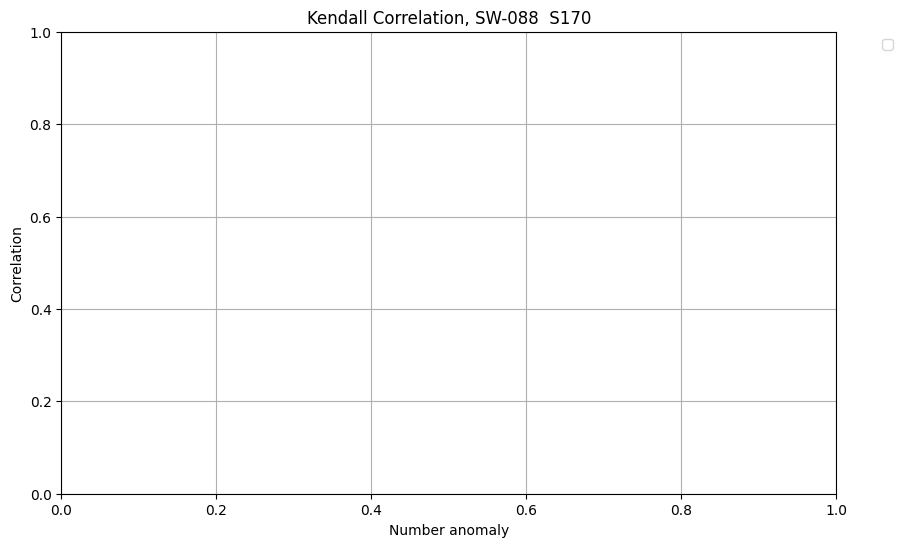

Plotting all non-NaN Pearson coefficients
41


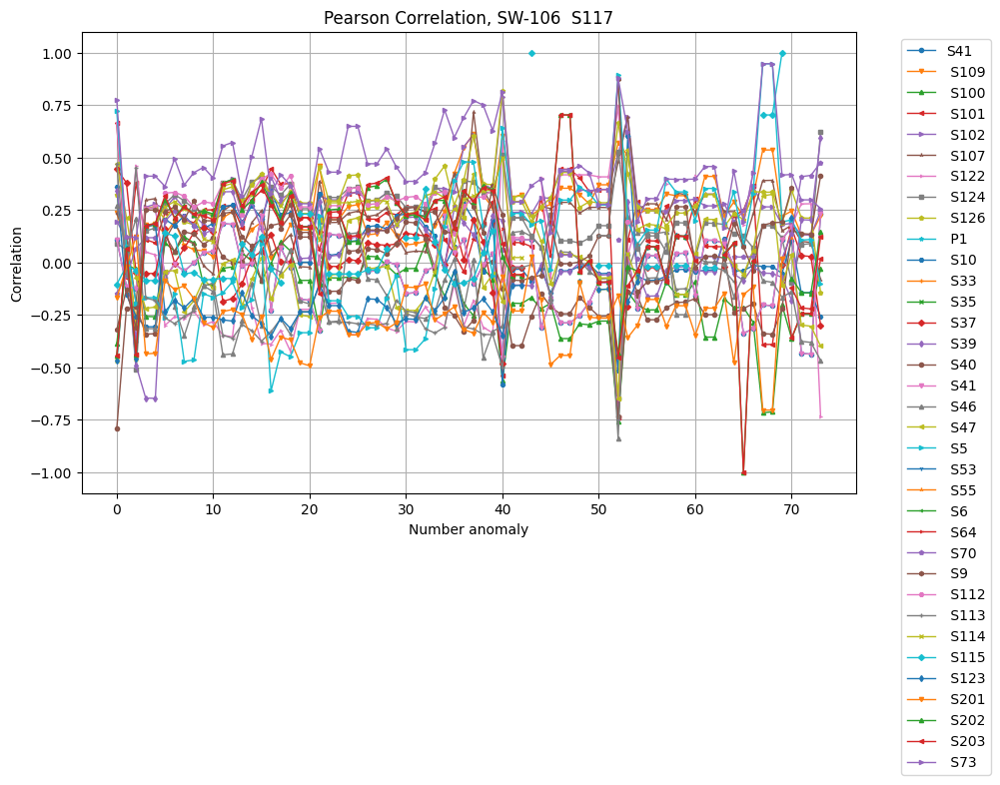

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
41


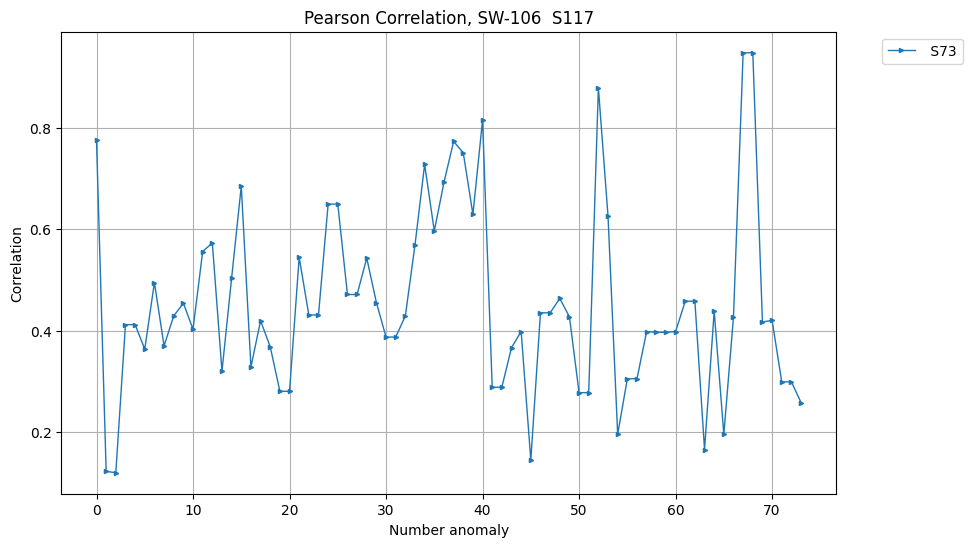

Plotting all non-NaN Spearman coefficients
41


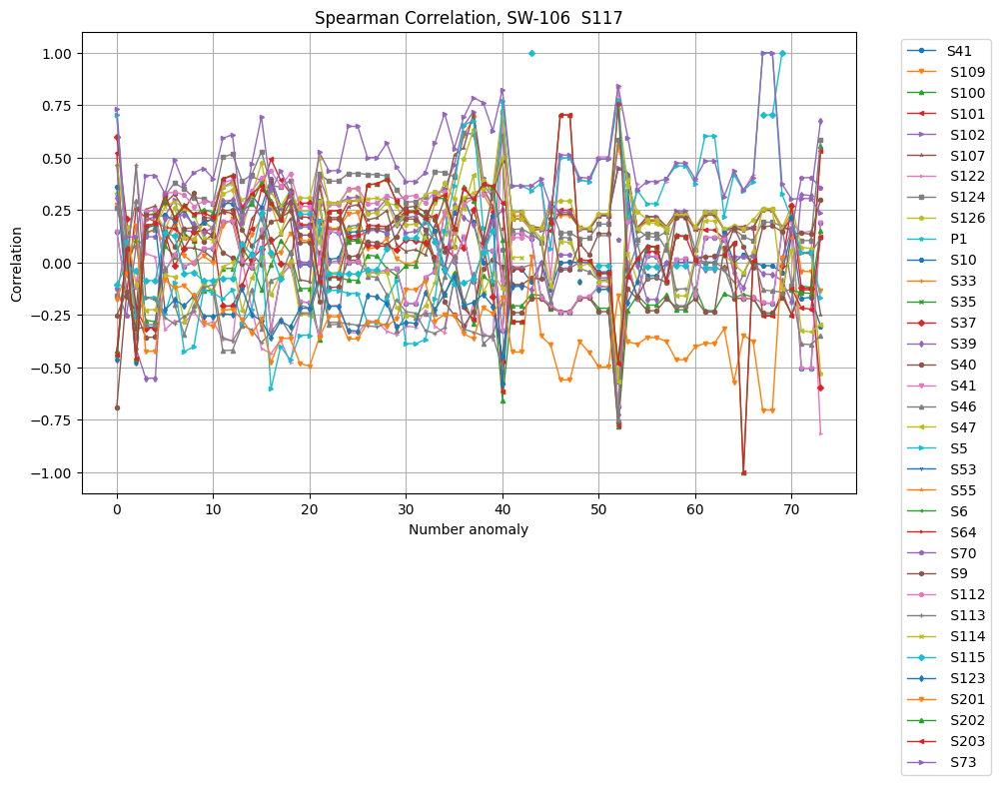

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
41


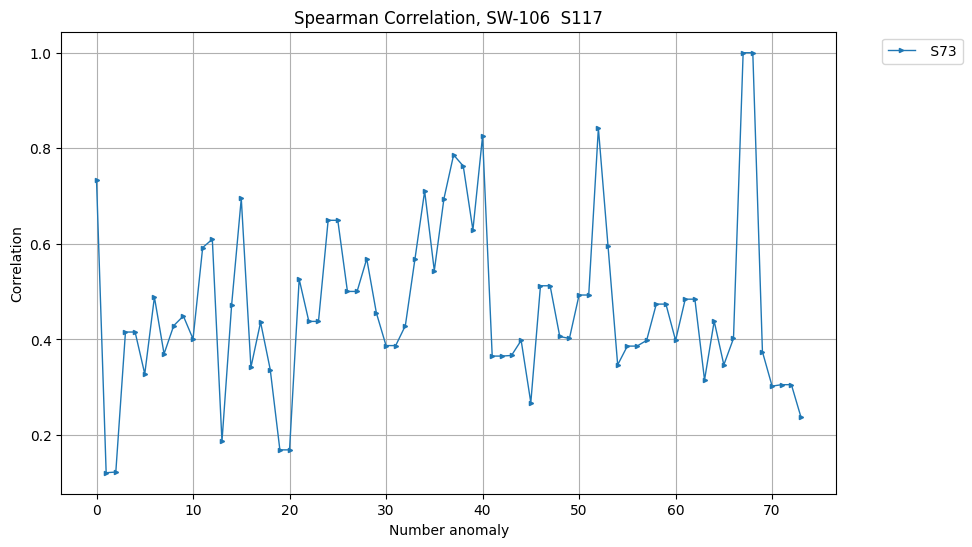

Plotting all non-NaN Kendall coefficients
41


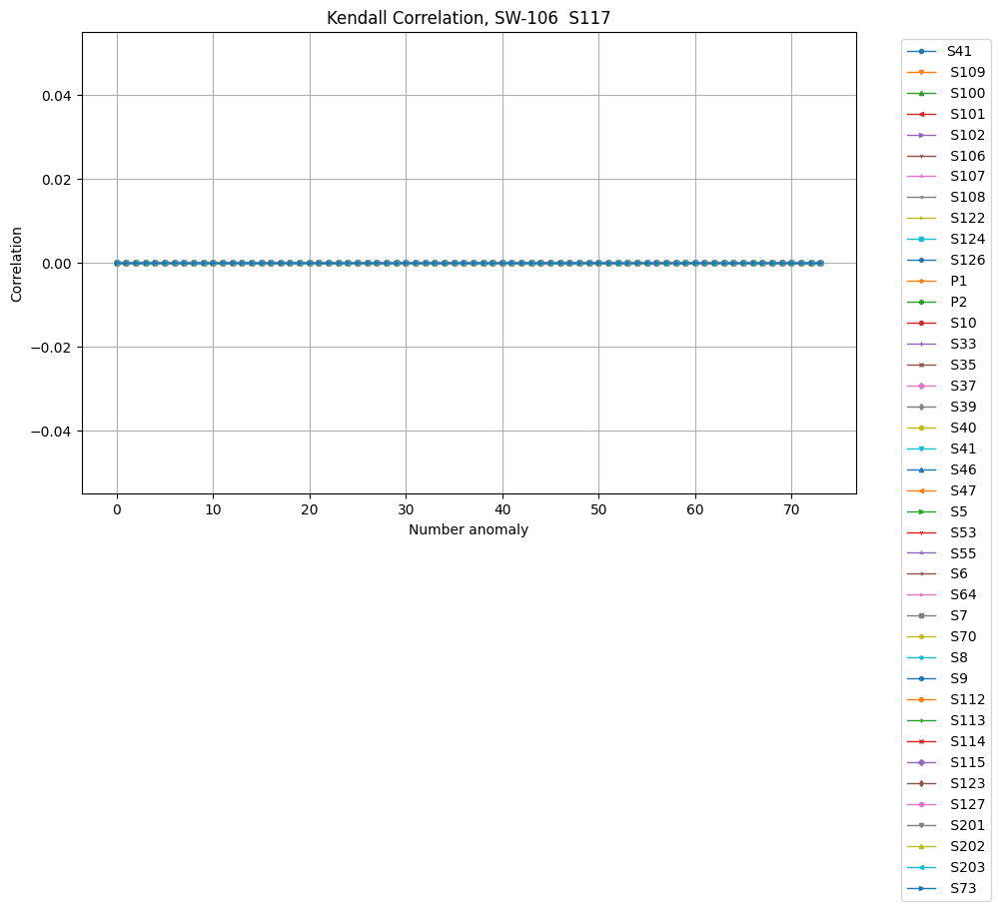

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
41


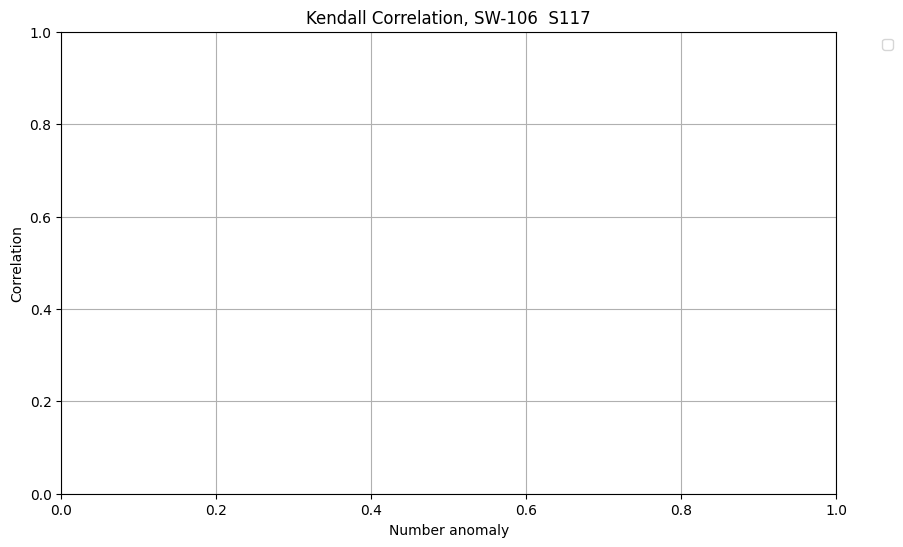

Plotting all non-NaN Pearson coefficients
41


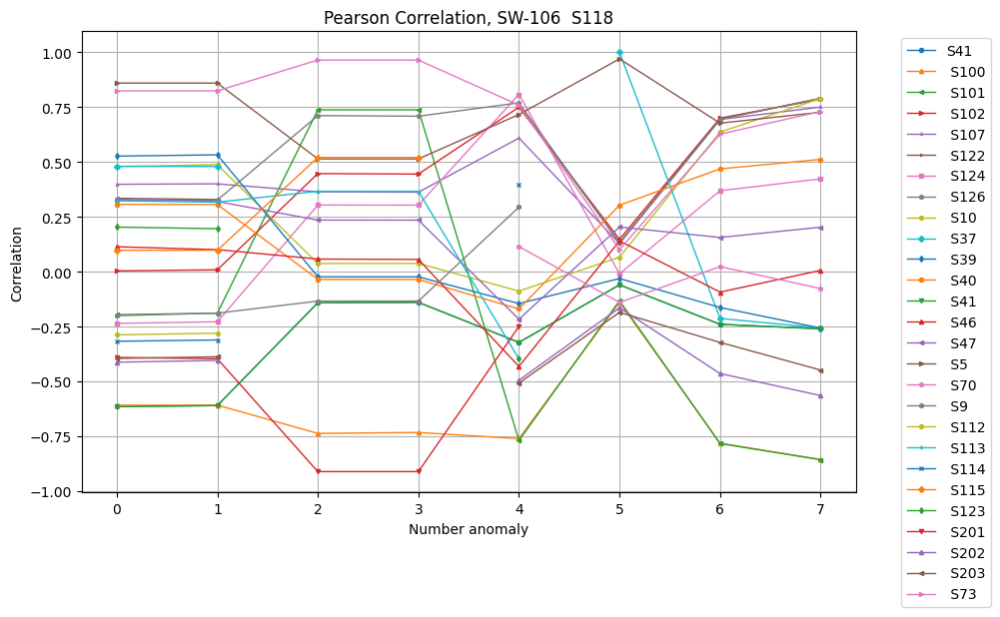

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
41


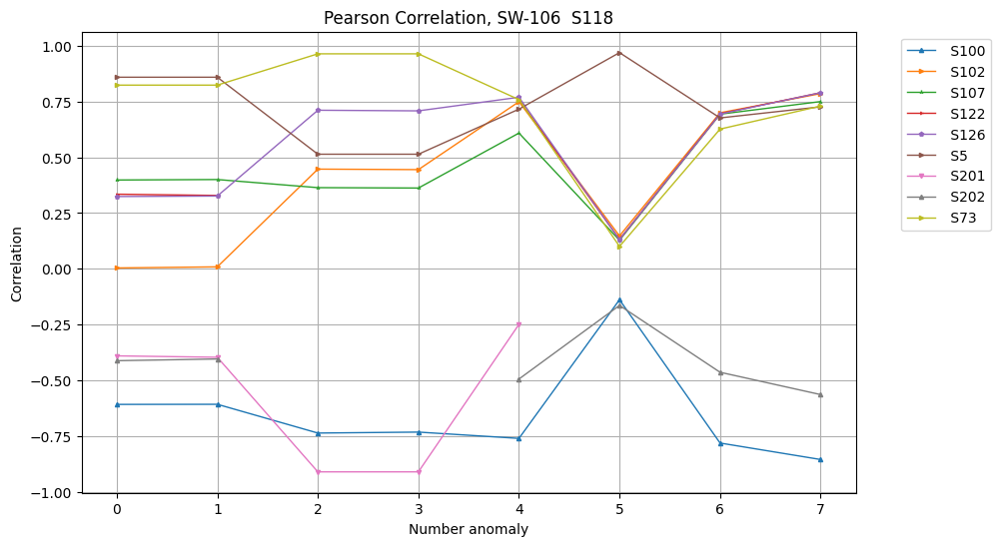

Plotting all non-NaN Spearman coefficients
41


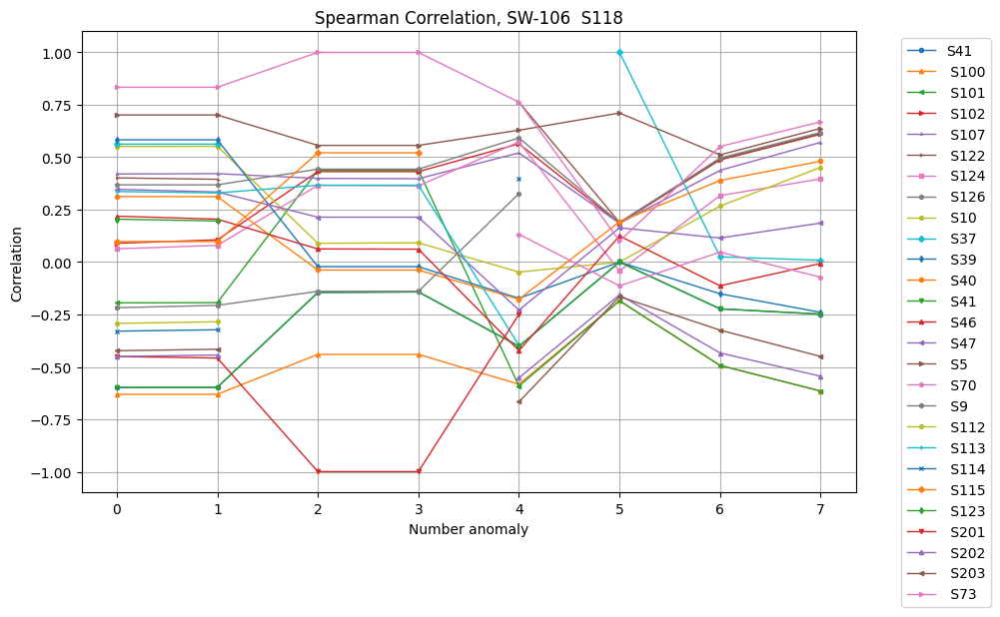

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
41


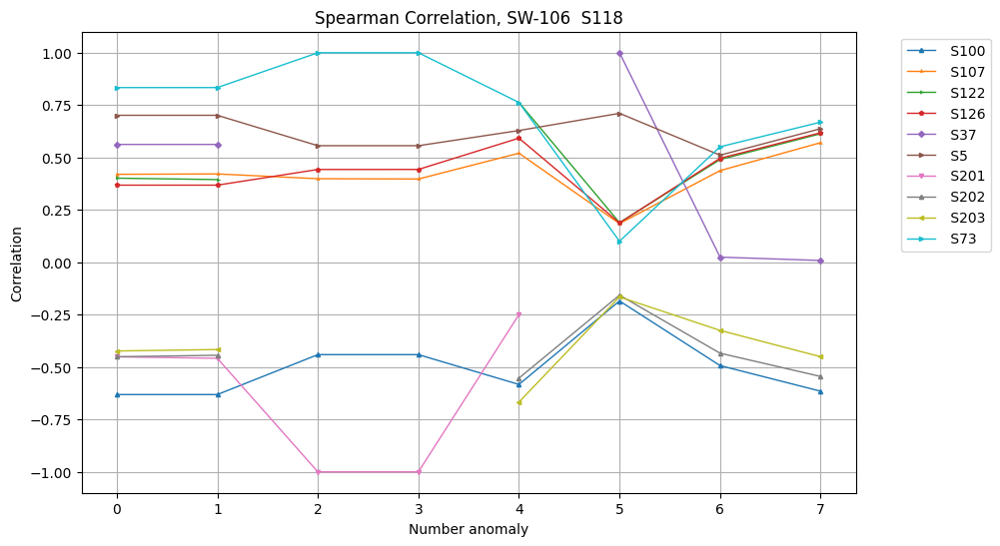

Plotting all non-NaN Kendall coefficients
41


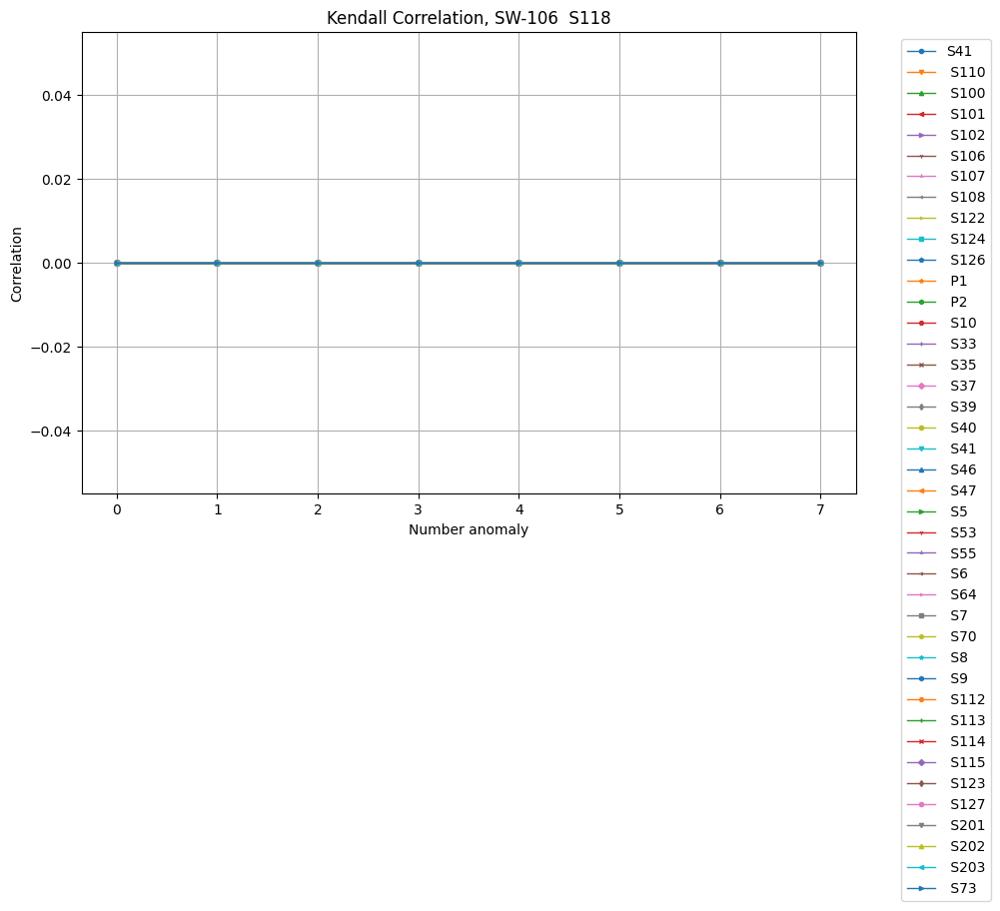

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
41


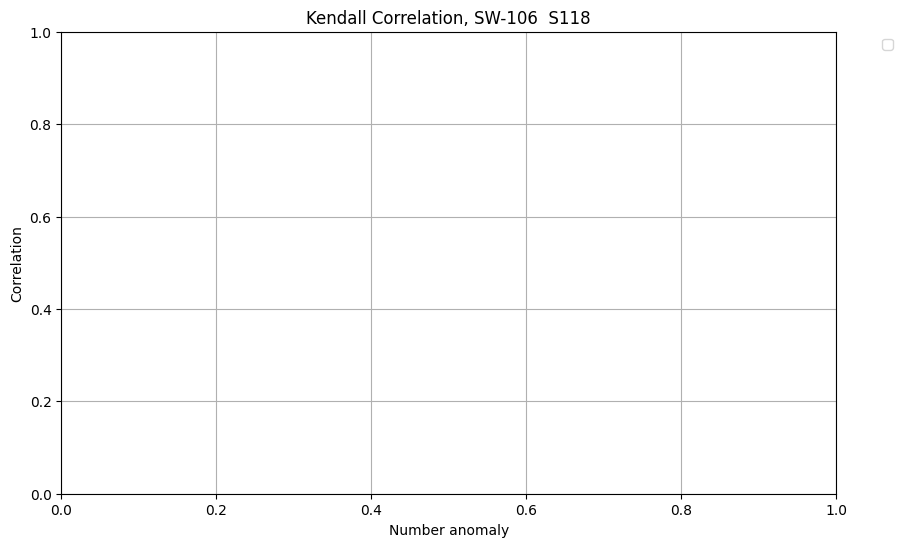

Plotting all non-NaN Pearson coefficients
1


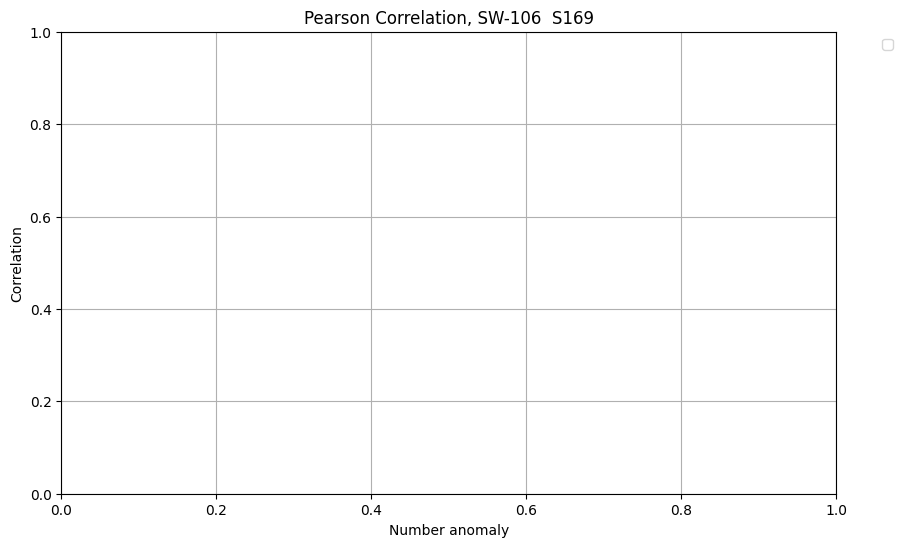

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
1


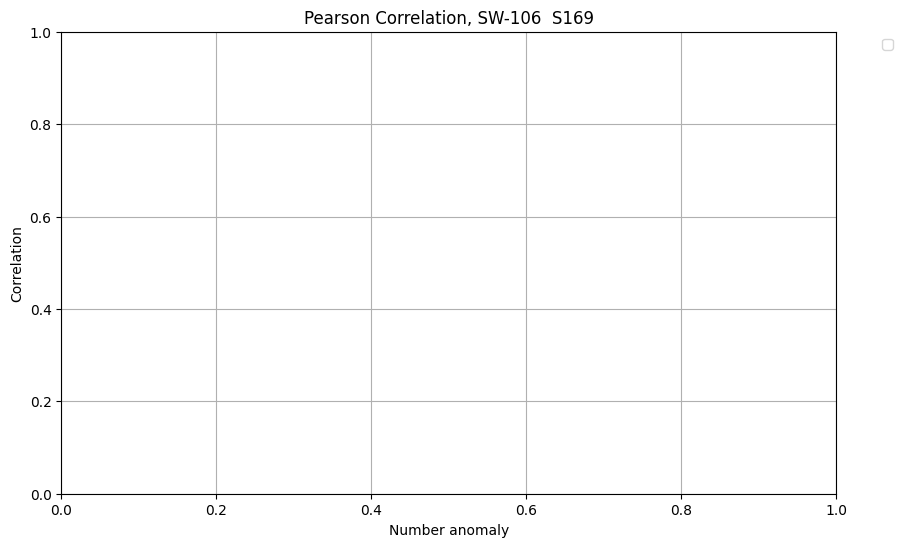

Plotting all non-NaN Spearman coefficients
1


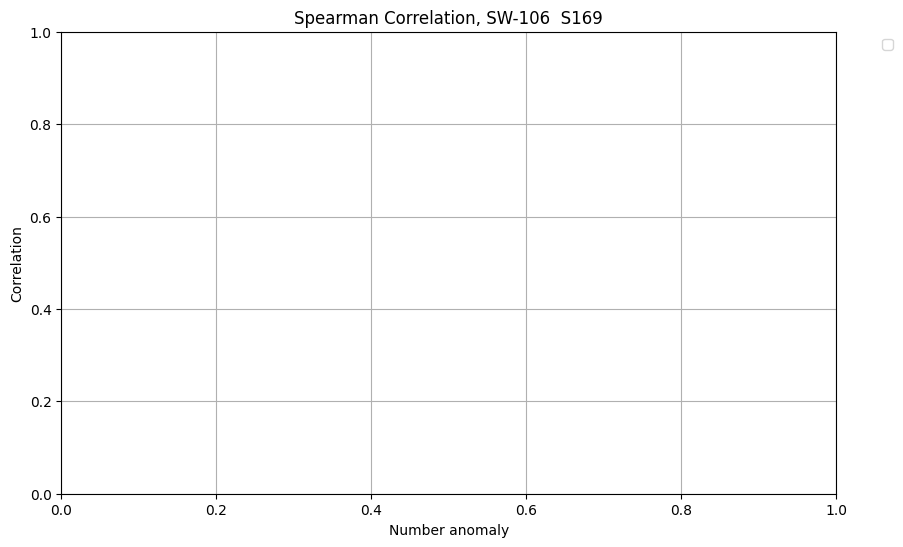

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
1


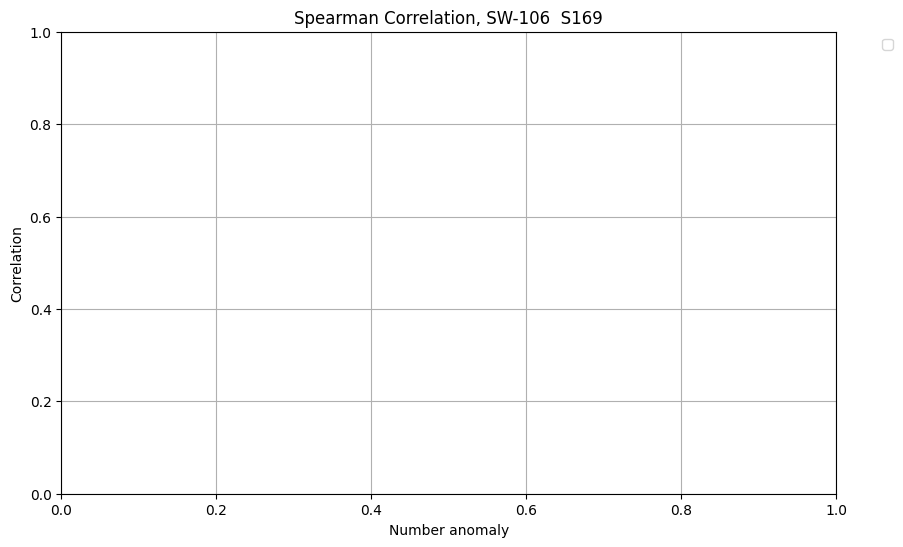

Plotting all non-NaN Kendall coefficients
1


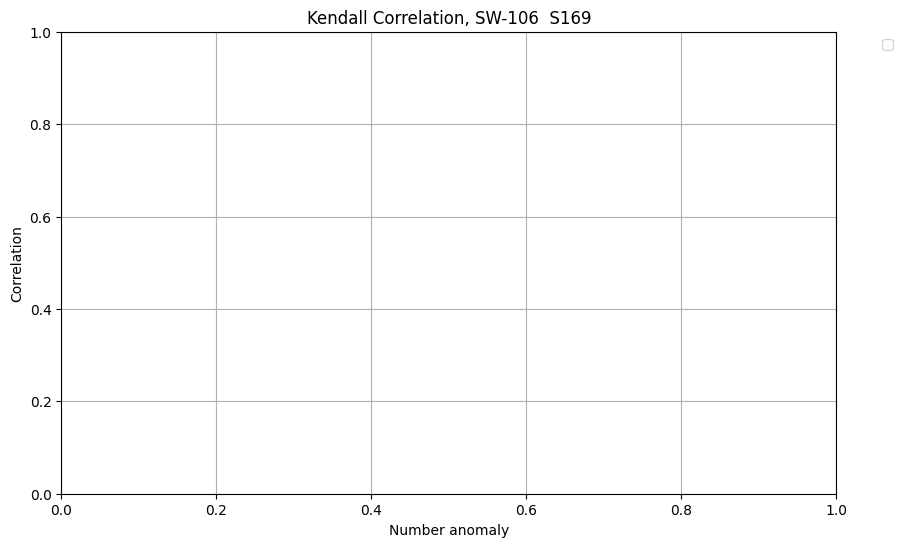

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
1


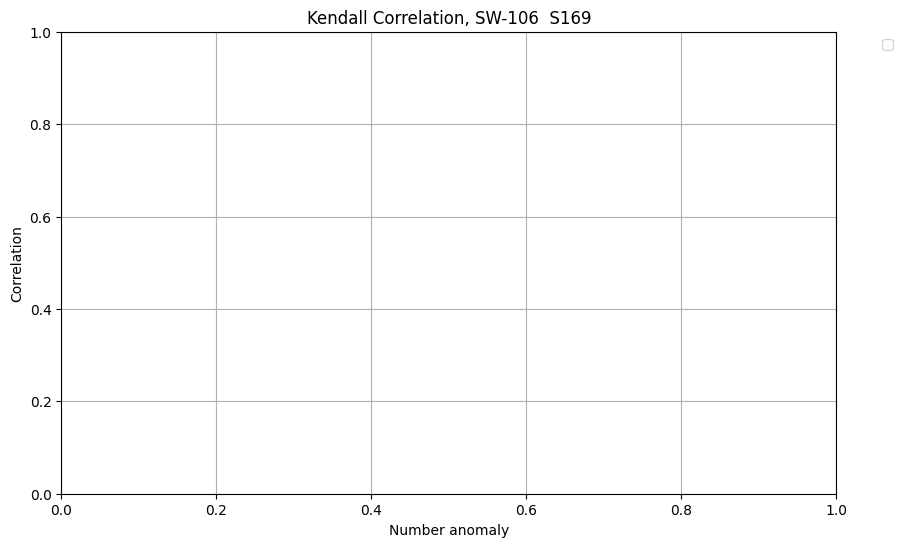

Plotting all non-NaN Pearson coefficients
39


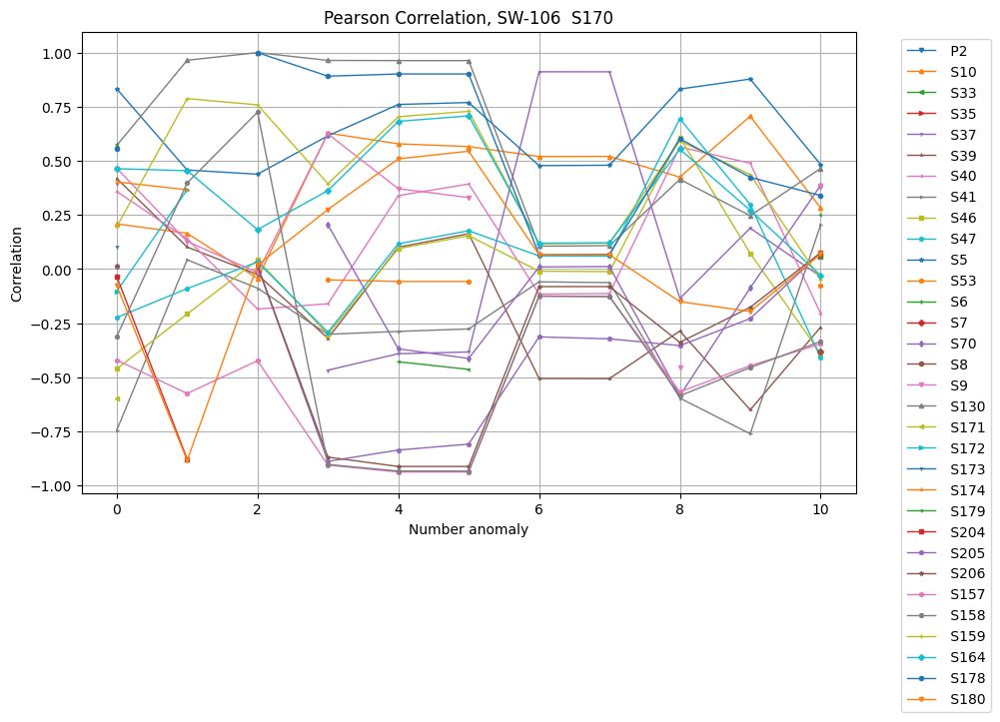

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
39


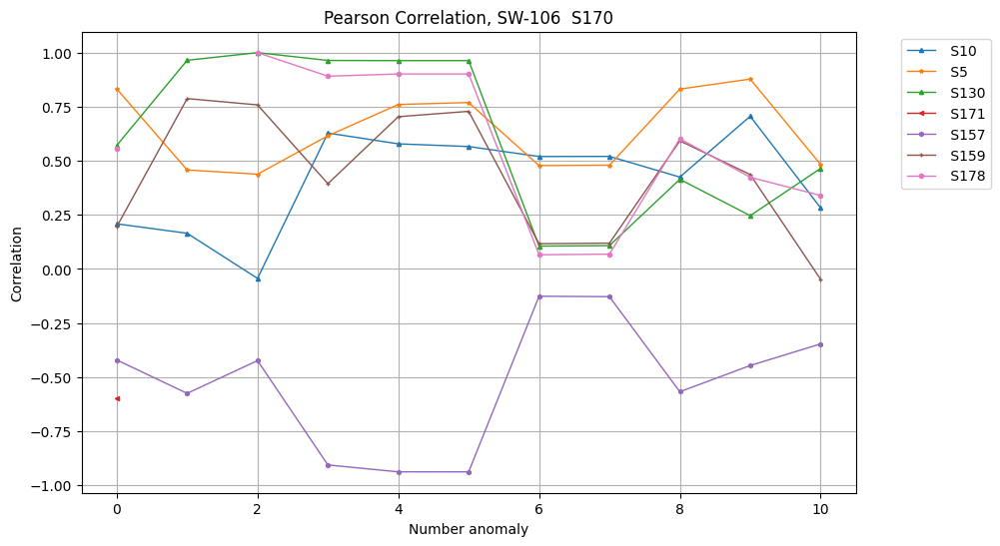

Plotting all non-NaN Spearman coefficients
39


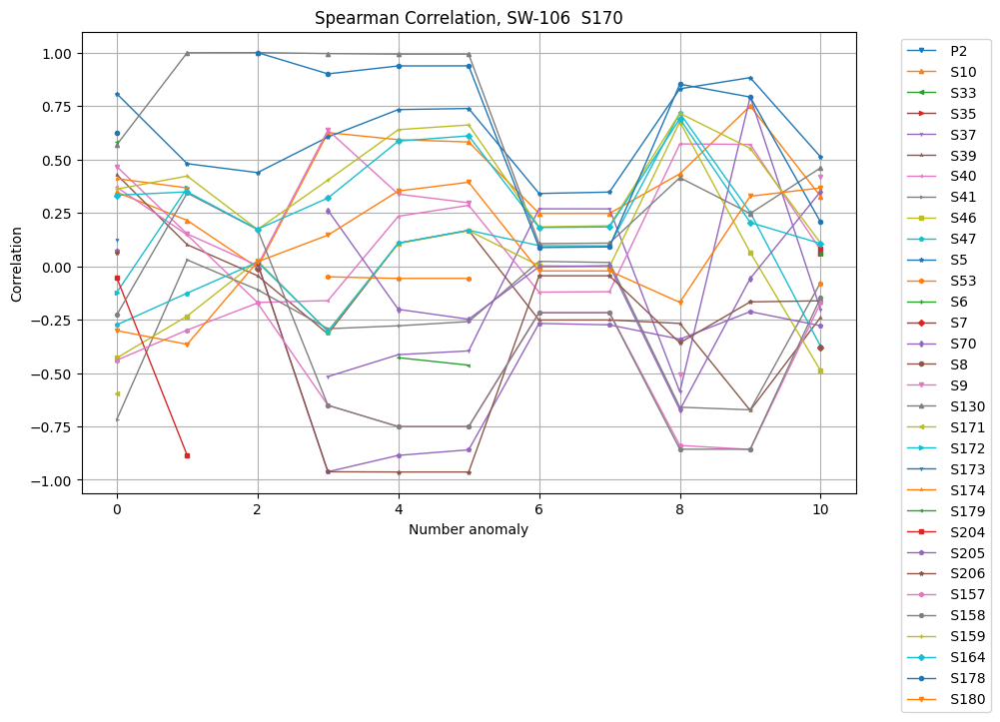

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
39


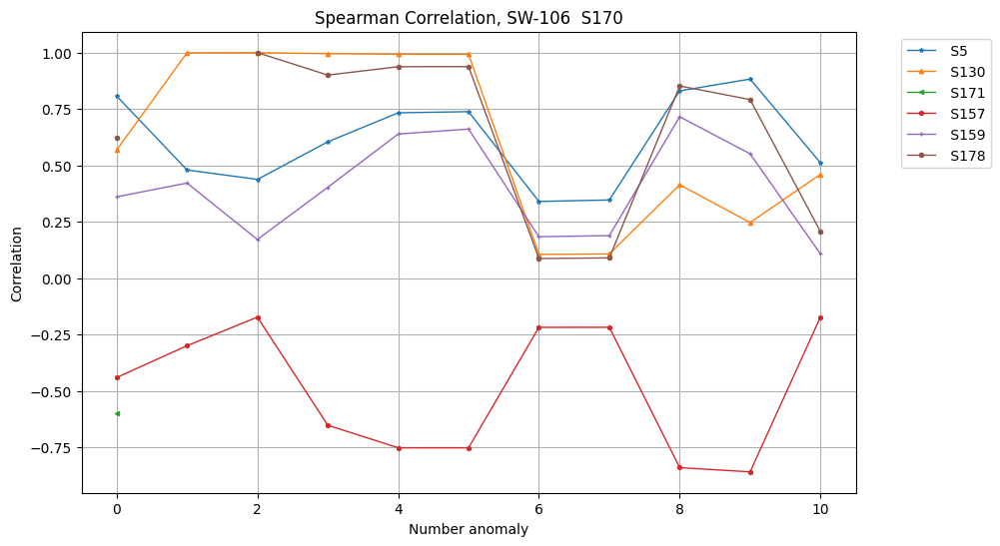

Plotting all non-NaN Kendall coefficients
39


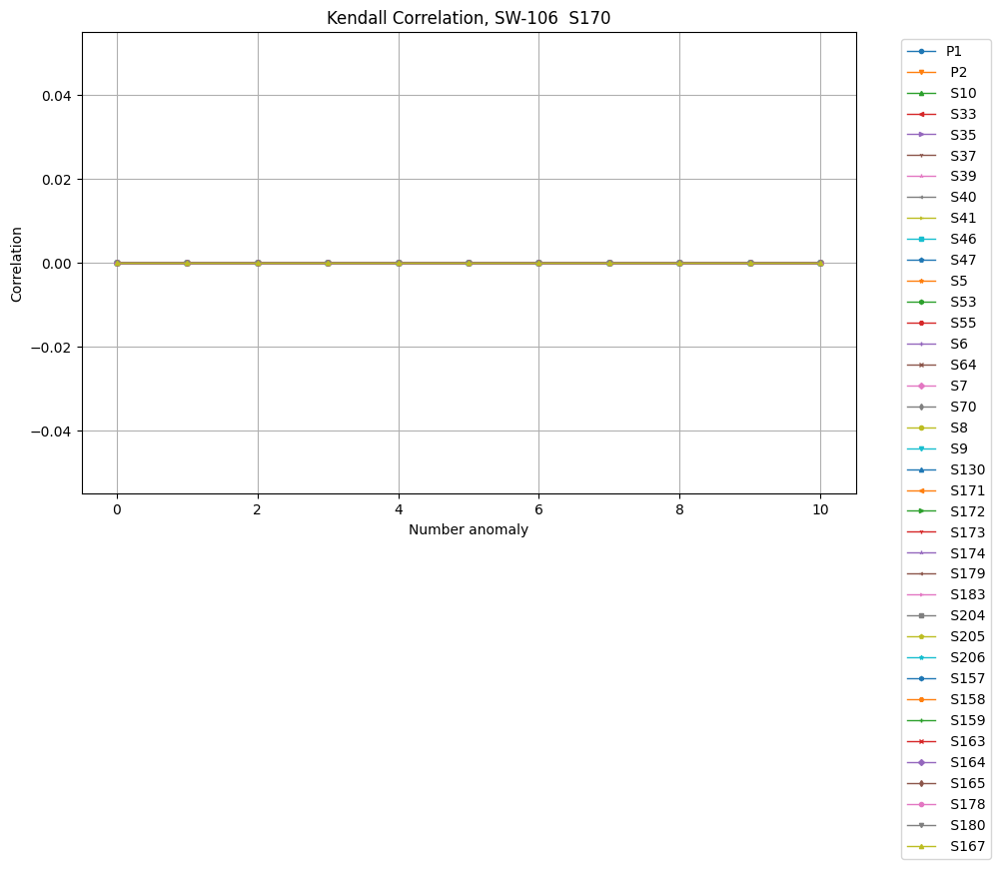

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
39


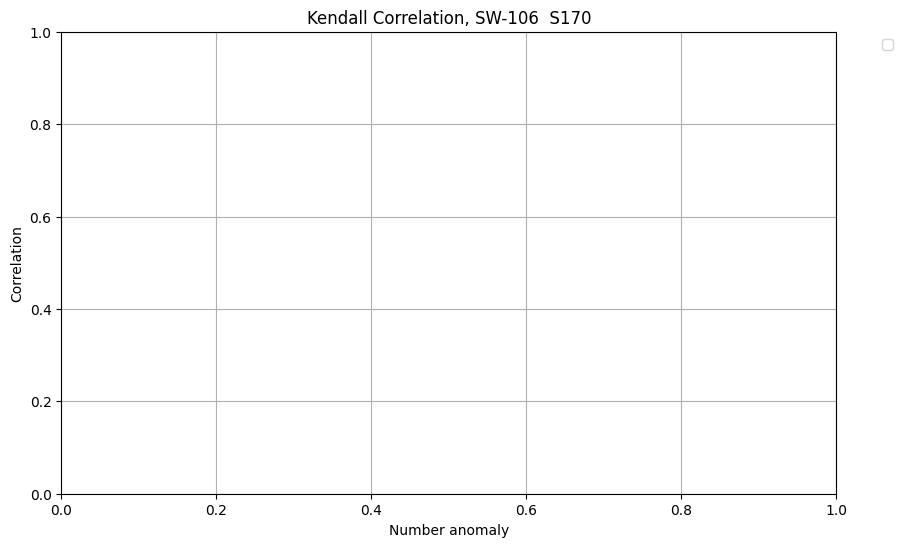

Plotting all non-NaN Pearson coefficients
38


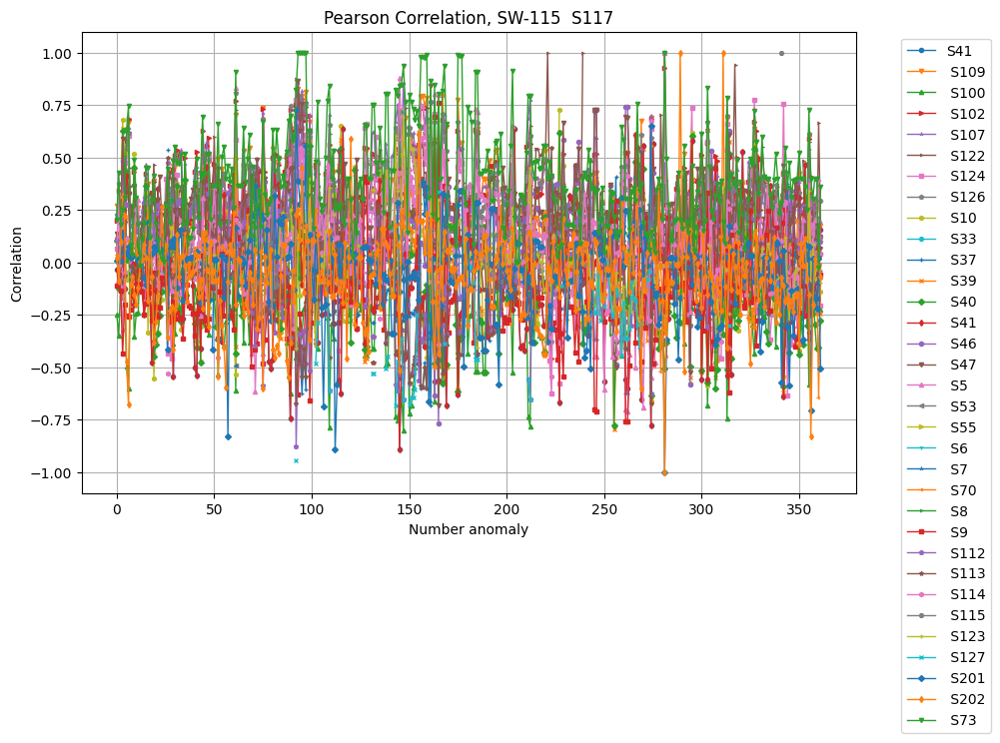

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
38


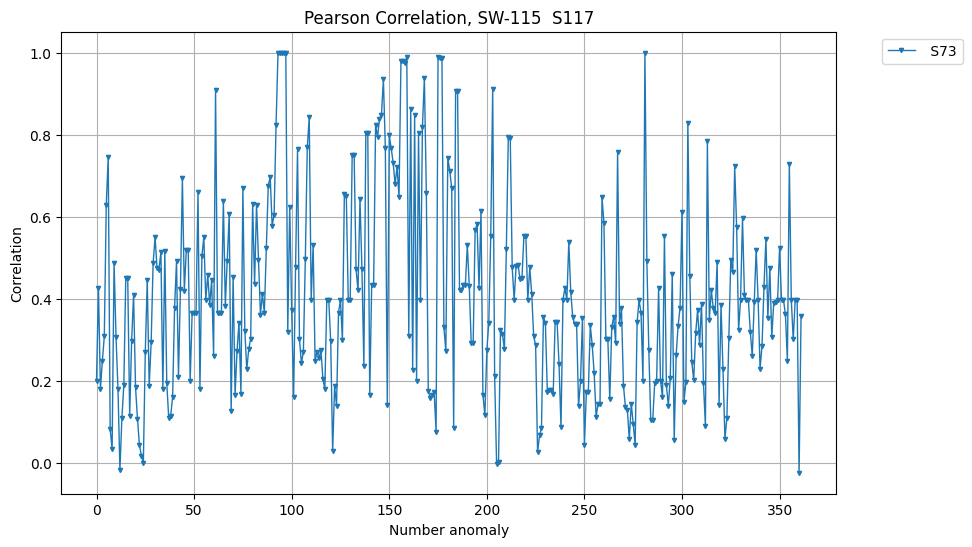

Plotting all non-NaN Spearman coefficients
38


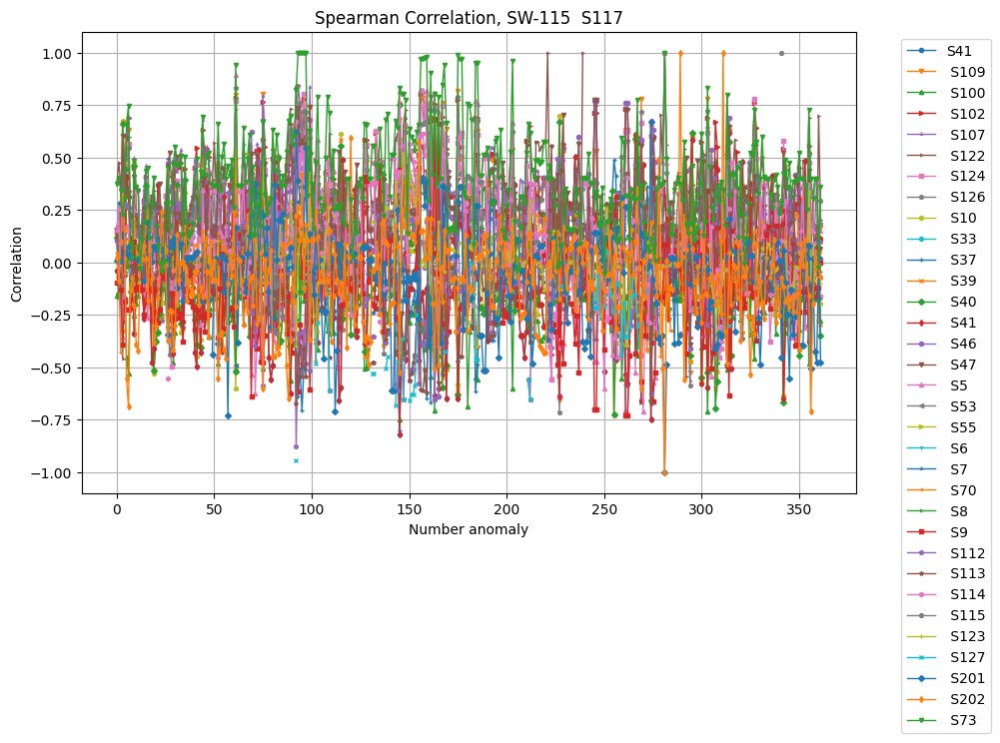

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
38


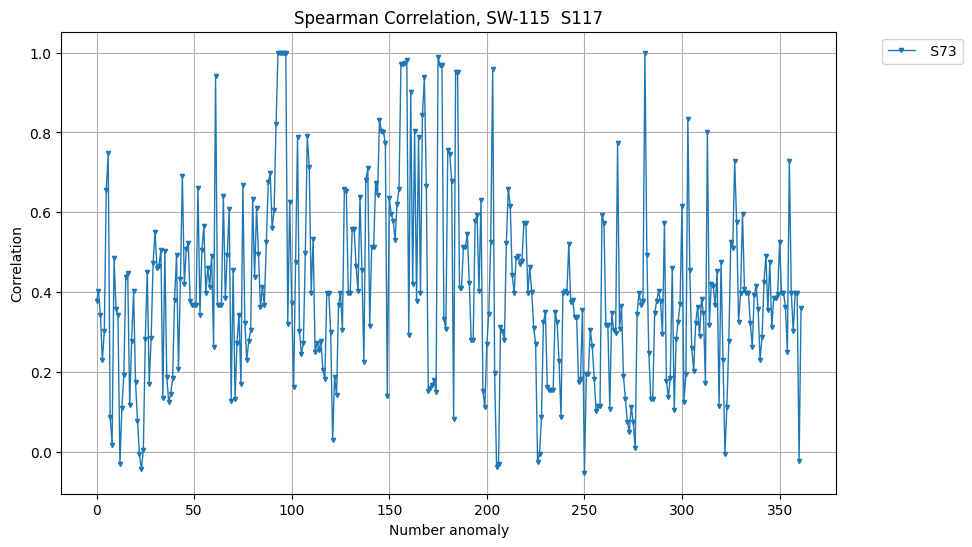

Plotting all non-NaN Kendall coefficients
38


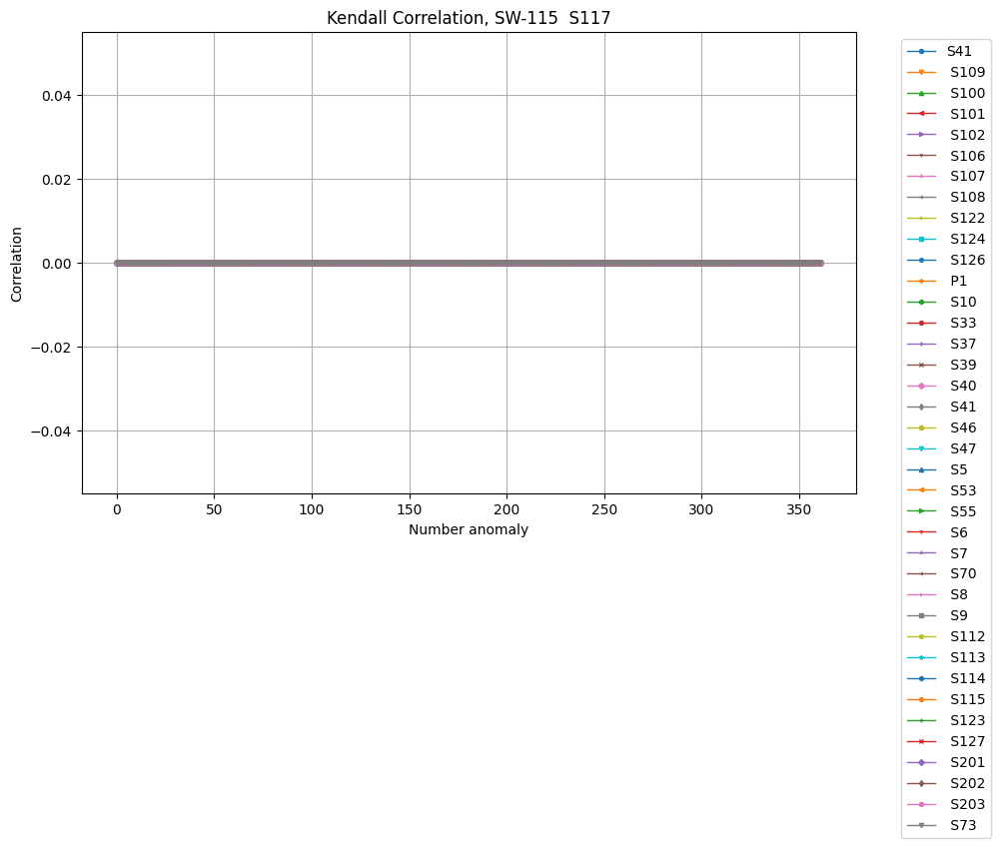

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
38


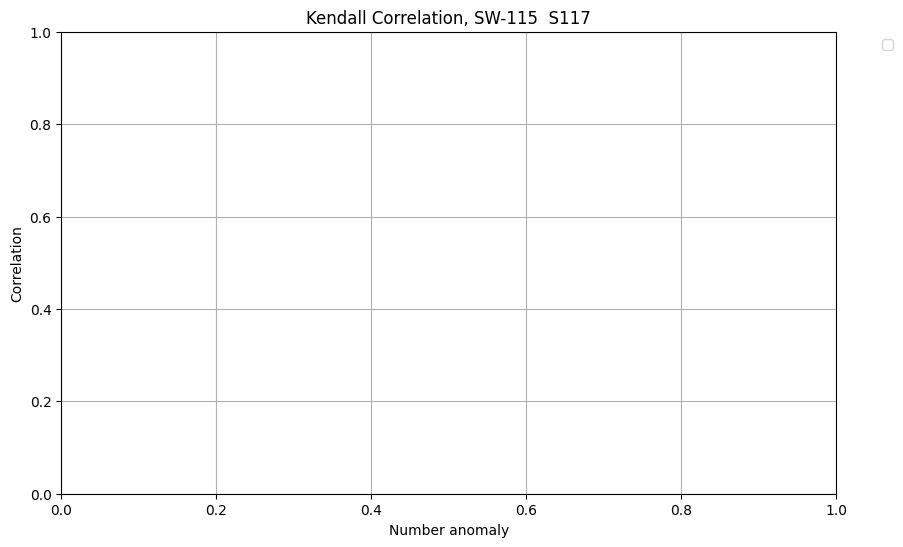

Plotting all non-NaN Pearson coefficients
38


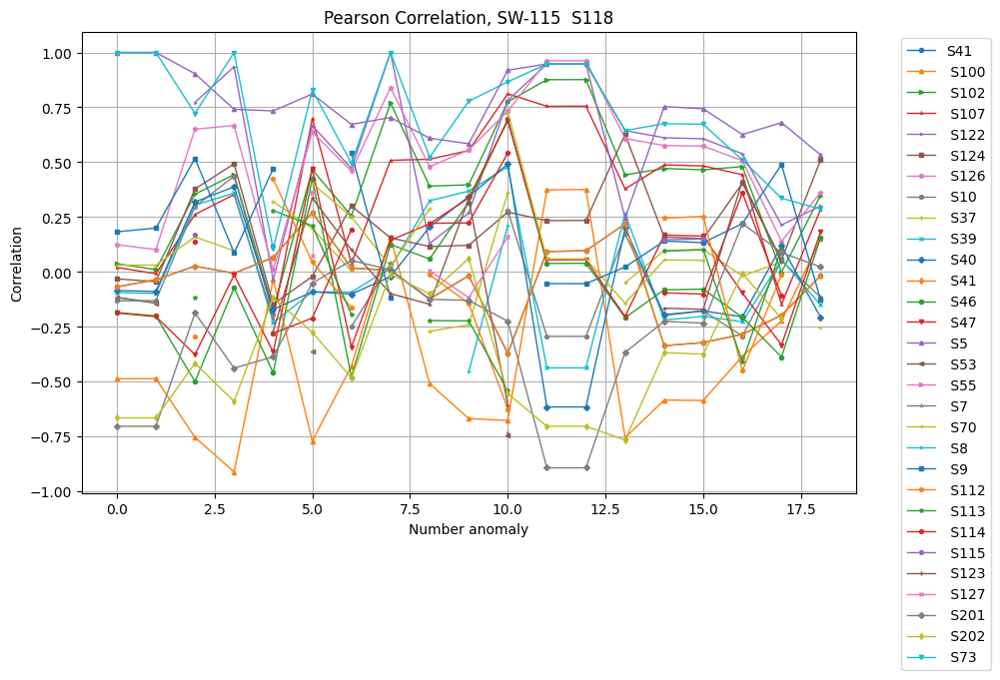

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
38


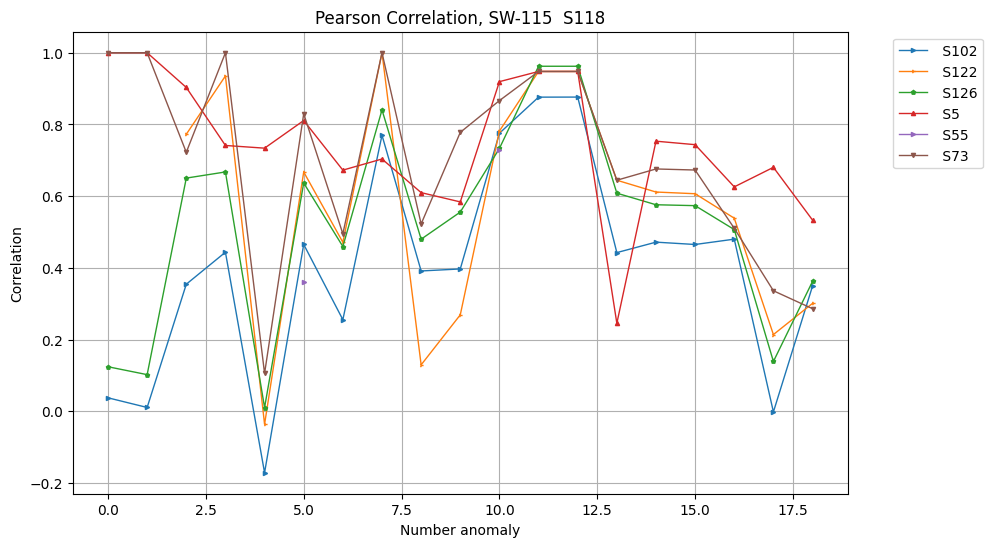

Plotting all non-NaN Spearman coefficients
38


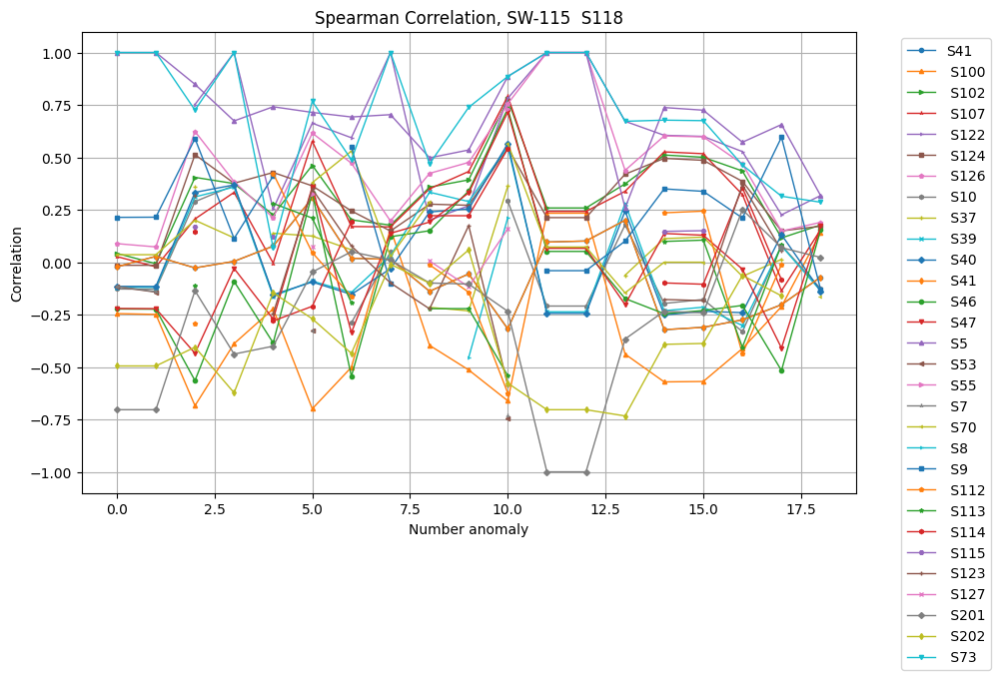

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
38


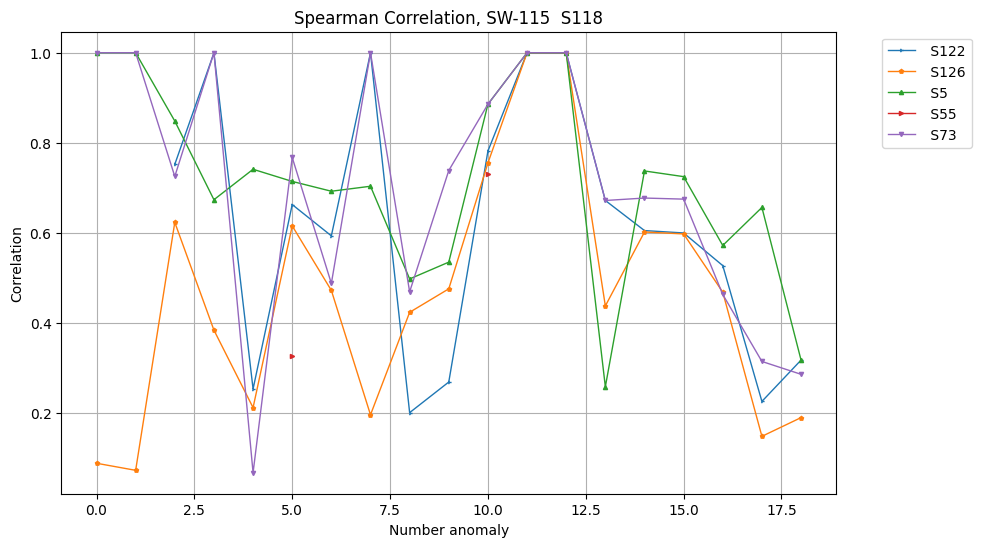

Plotting all non-NaN Kendall coefficients
38


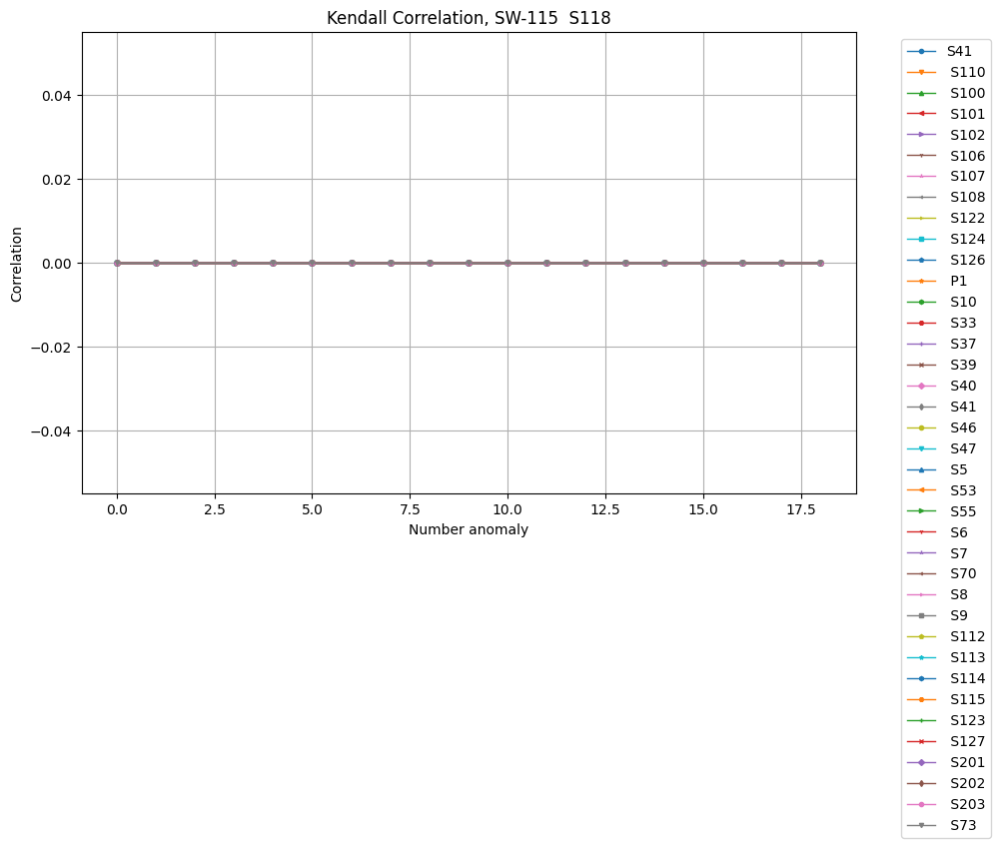

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
38


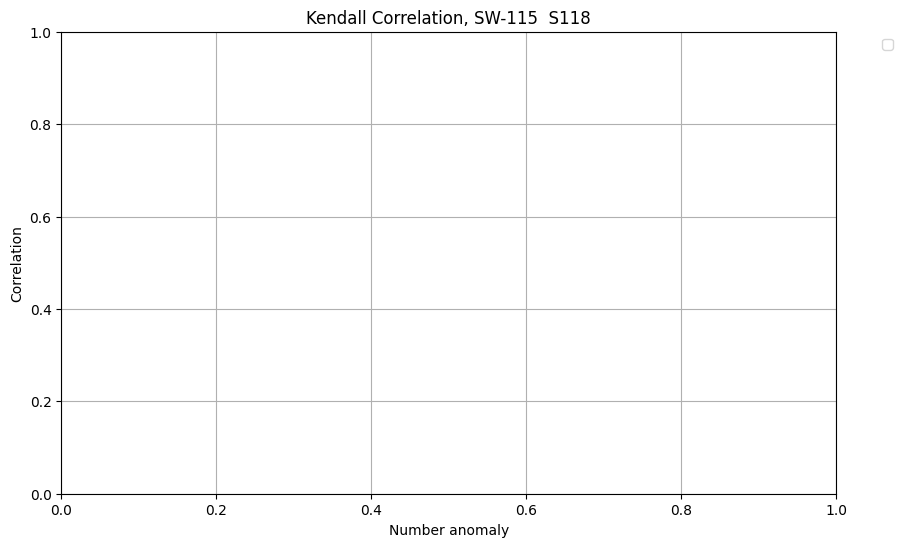

Plotting all non-NaN Pearson coefficients
36


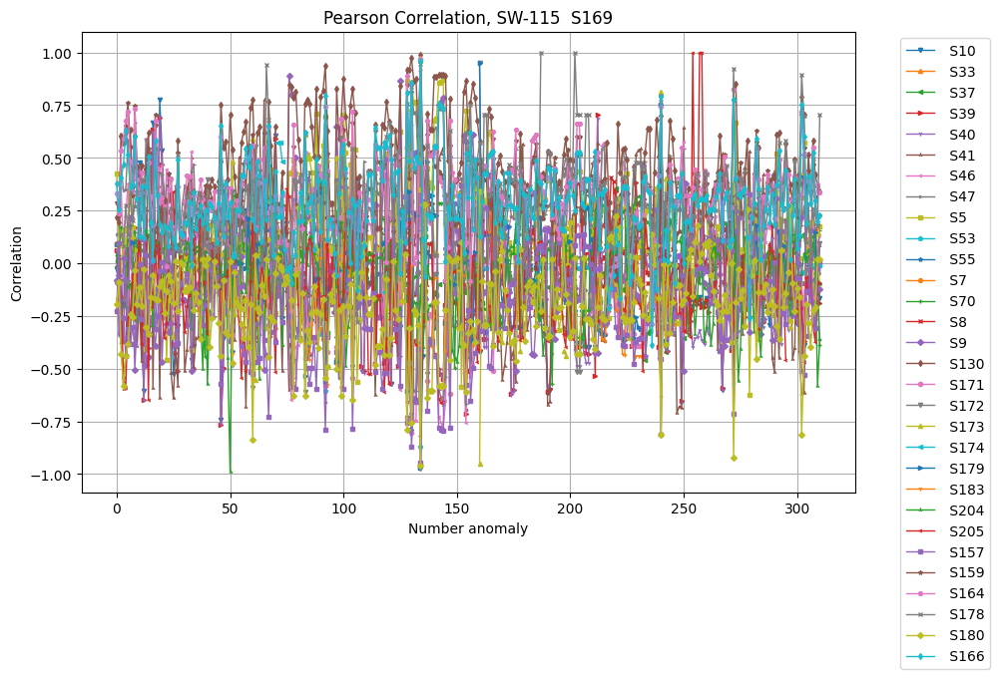

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
36


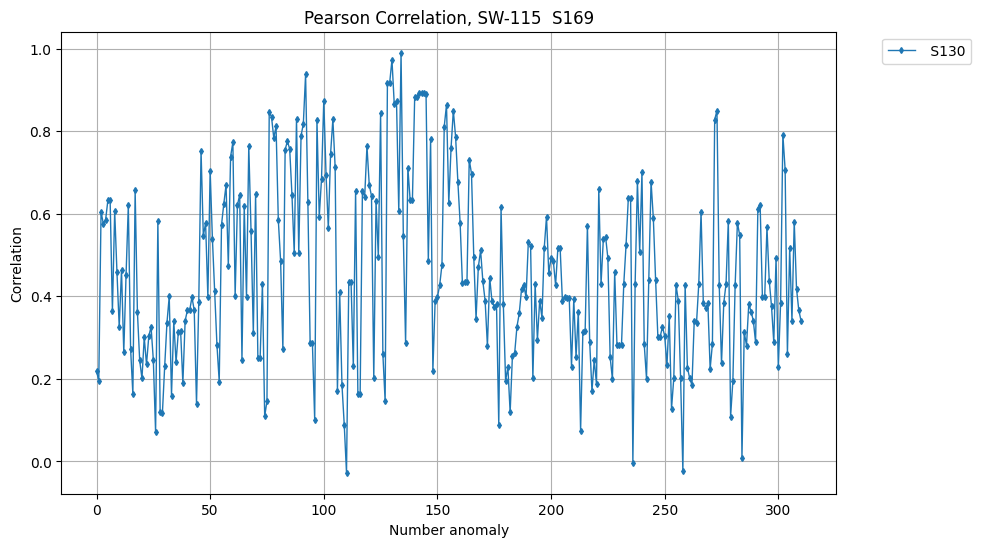

Plotting all non-NaN Spearman coefficients
36


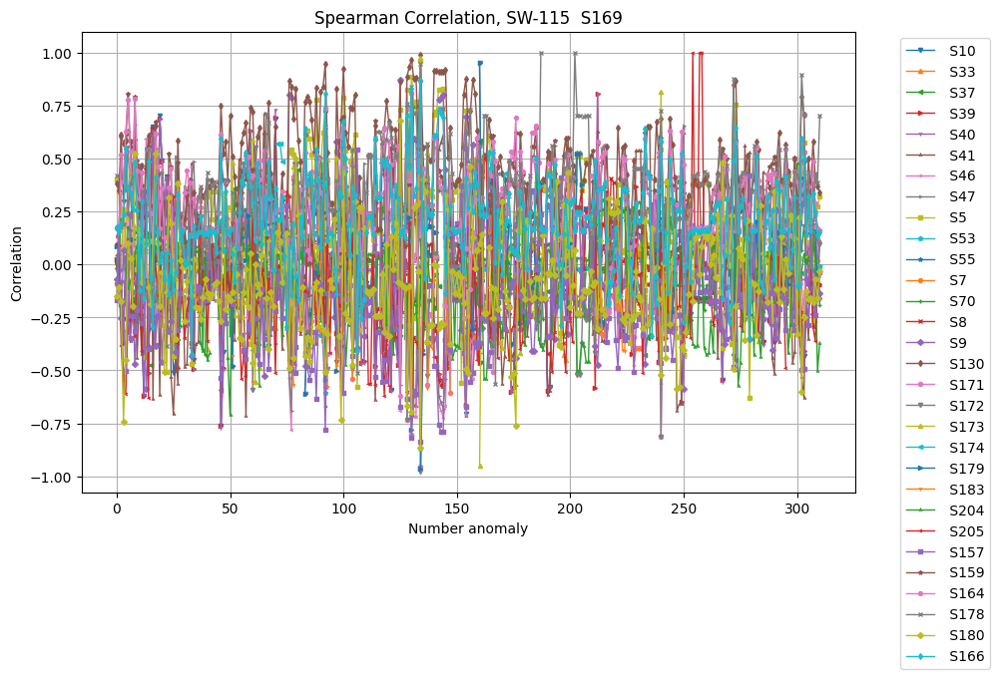

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
36


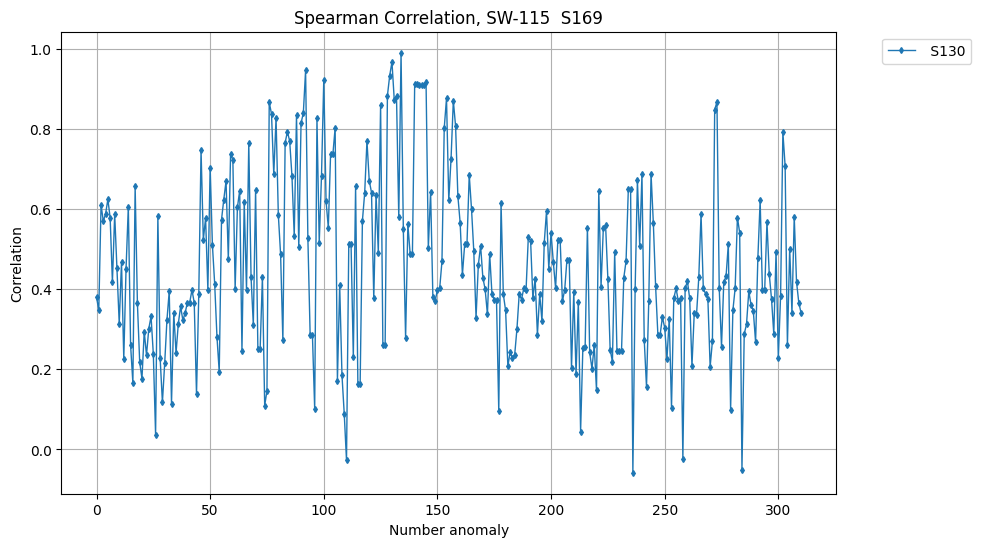

Plotting all non-NaN Kendall coefficients
36


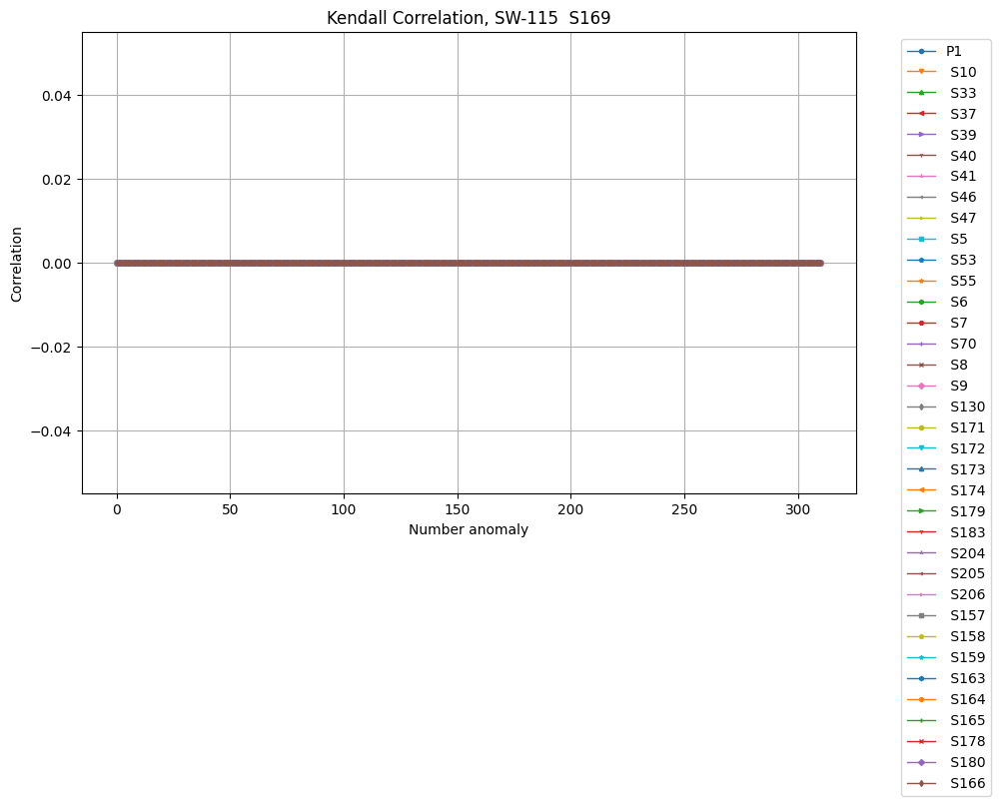

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
36


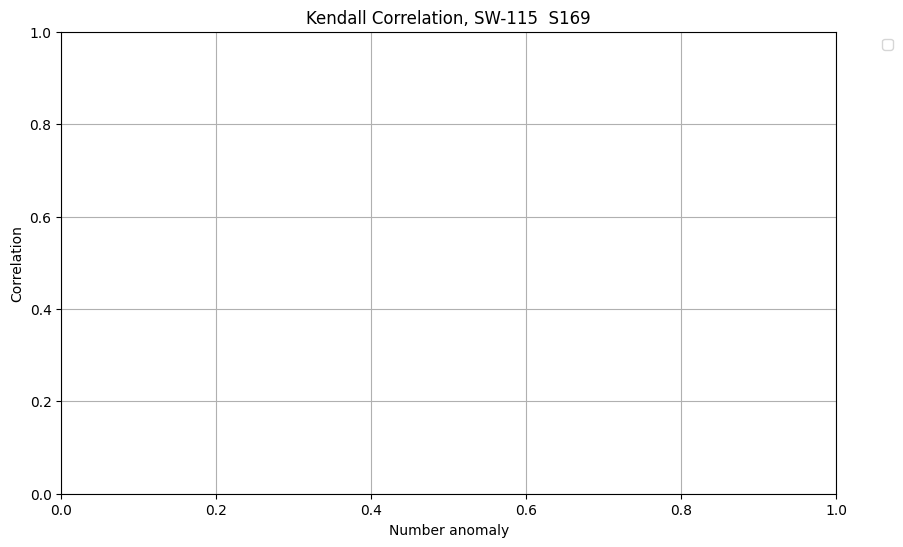

Plotting all non-NaN Pearson coefficients
36


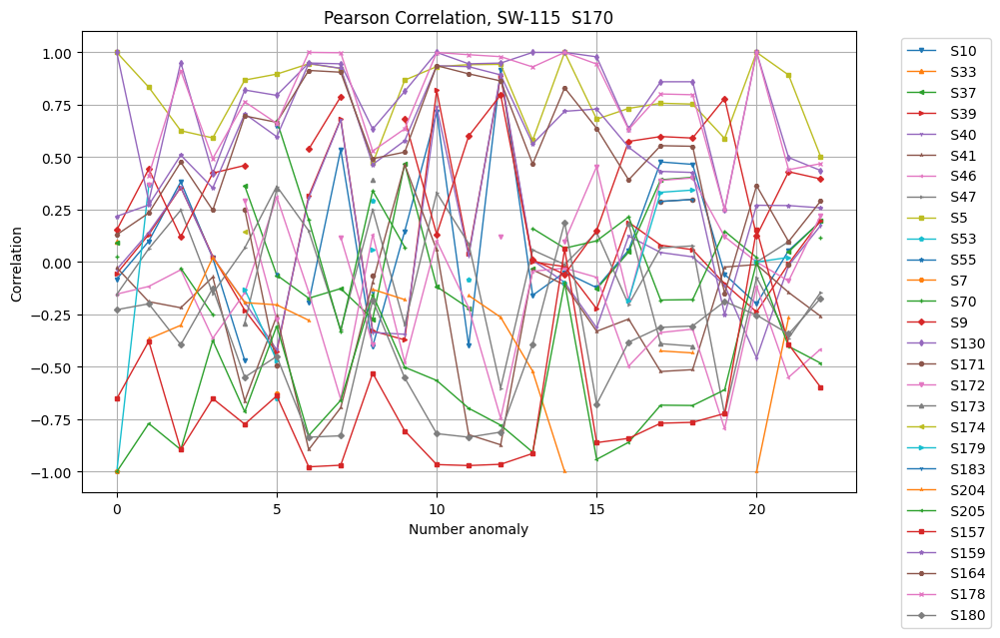

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
36


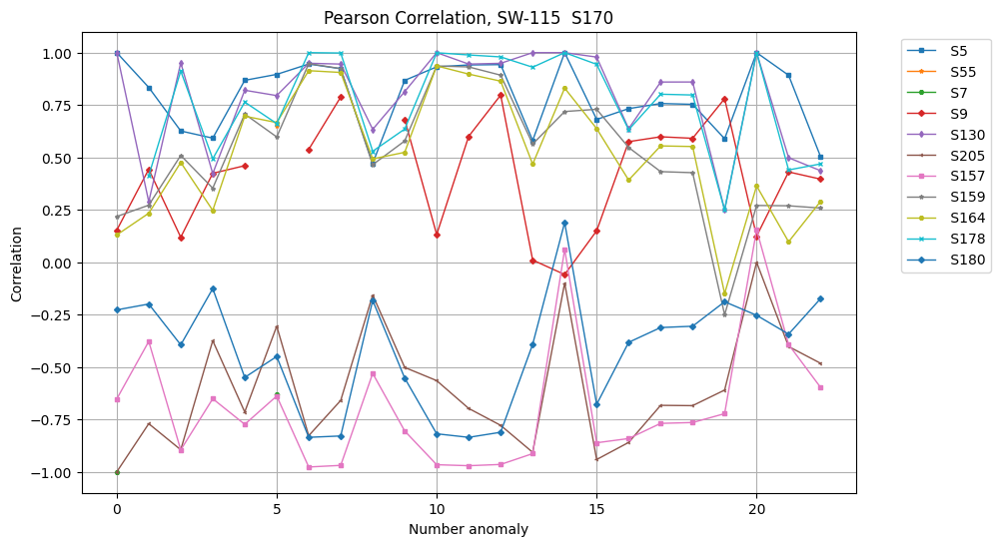

Plotting all non-NaN Spearman coefficients
36


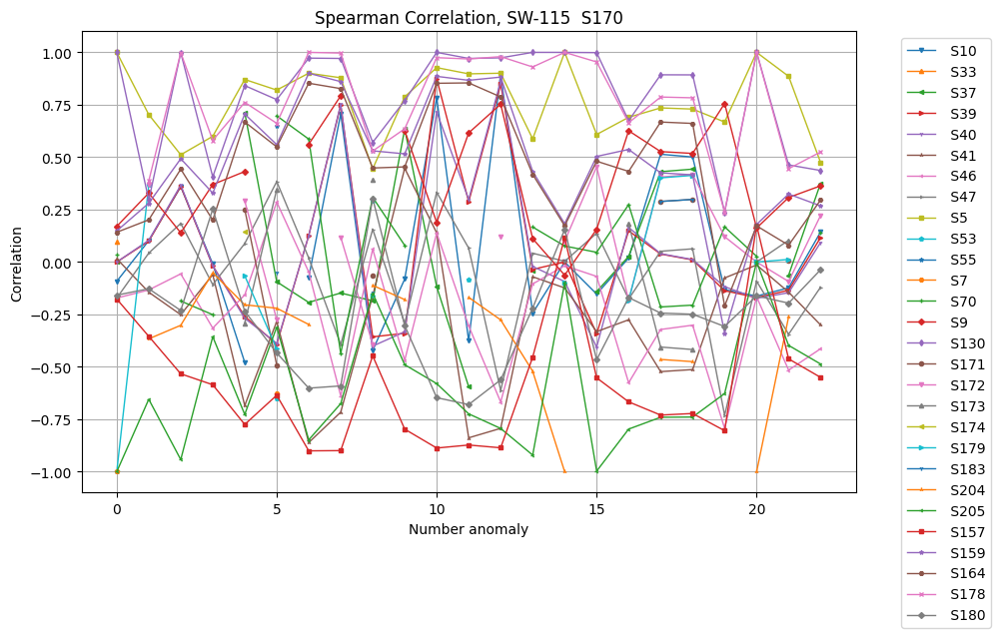

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
36


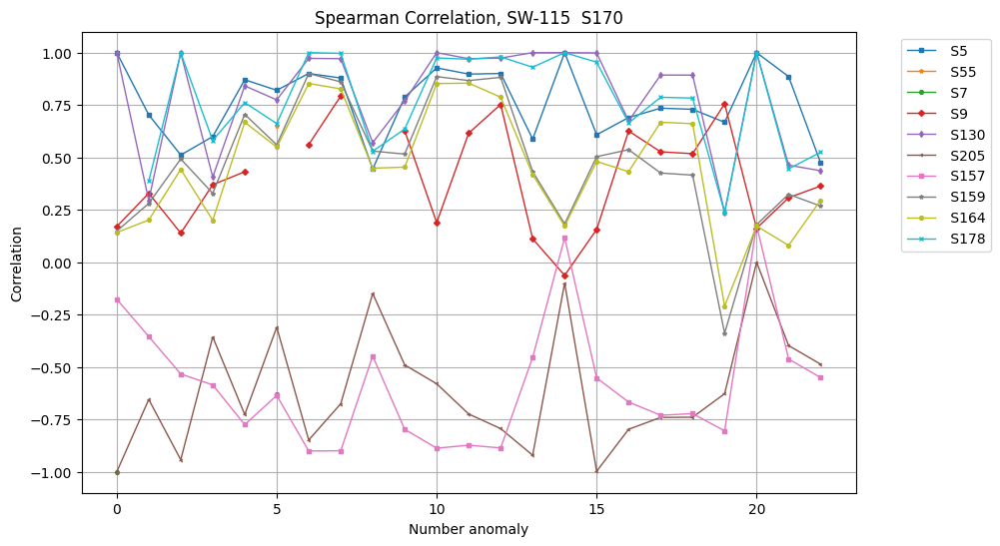

Plotting all non-NaN Kendall coefficients
36


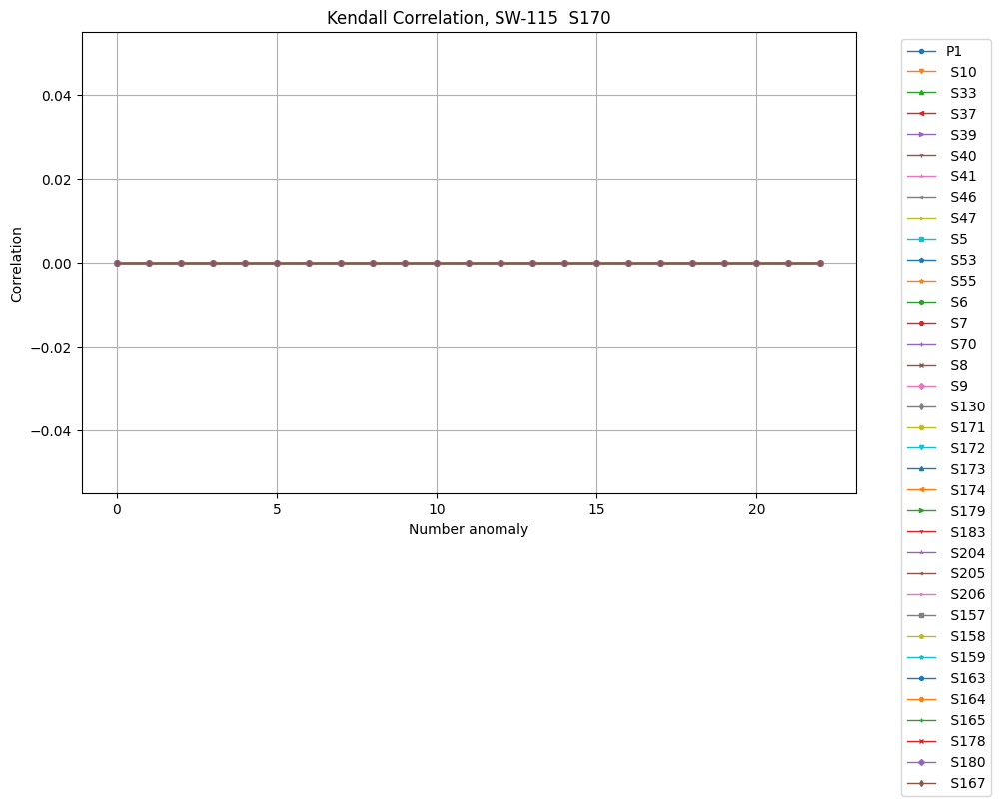

Plotting Kendall coefficients of metrics that have a mean value greater than 0.4
36


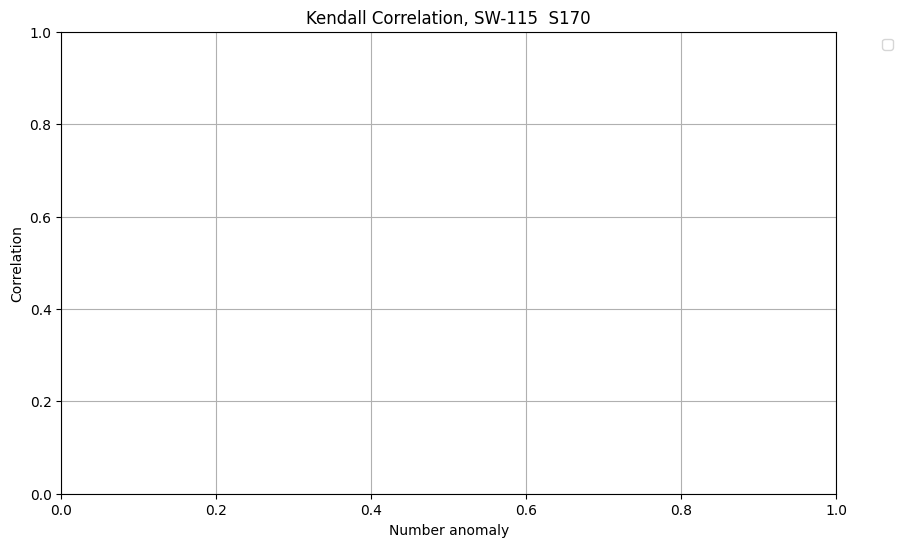

In [7]:
limit_value=0.4
for hw in hwids:
    for motor in motors_list:

        if hw=='SW-065' and (motor=='S118' or motor=='S170'):
            continue

        file_path= f'./{hw}_{motor}_correlations.txt'

        print(f'Plotting all non-NaN Pearson coefficients')
        aux.read_and_plot(file_path,'Pearson',hw,motor)
        print(f'Plotting Pearson coefficients of metrics that have a mean value greater than {limit_value}')
        aux.read_and_plot(file_path,'Pearson',hw,motor,avg_lim=limit_value)
        print(f'Plotting all non-NaN Spearman coefficients')
        aux.read_and_plot(file_path,'Spearman',hw,motor)
        print(f'Plotting Spearman coefficients of metrics that have a mean value greater than {limit_value}')
        aux.read_and_plot(file_path,'Spearman',hw,motor,avg_lim=limit_value)
        print(f'Plotting all non-NaN Kendall coefficients')
        aux.read_and_plot(file_path,'Kendall',hw,motor)
        print(f'Plotting Kendall coefficients of metrics that have a mean value greater than {limit_value}')
        aux.read_and_plot(file_path,'Kendall',hw,motor,avg_lim=limit_value)

We present the graphs as a collapsed cell because of their high number, making the notebook more readable.

# Task 2

In [14]:
metrics=['S125','S181']

In [14]:
for hw in hwids:
    for metric in metrics:
        perc_val,perc_min=aux.get_norm_data(df,hw,metric)
        perc_fill=aux.fill_missing_min(perc_val,perc_min)

        total_hours=len(perc_fill)/60
        active_hours=len([x for x in perc_fill if x!=0])/60
        max_hours=len([x for x in perc_fill if x==100])/60

        print('############')
        print(f'Analyzing the active time of metric {metric} for machine {hw}')
        print(f'The circuit is active for a total of {active_hours} over {total_hours}\
              of measurements ({active_hours/total_hours*100}% of the measurement time).')
        print(f'The circuit runs at max capacity for {max_hours} hours ({max_hours/total_hours*100}% of the measurement time).')

############
Analyzing the active time of metric S125 for machine SW-065
The circuit is active for a total of 923.3666666666667 over 2508.2166666666667             of measurements (36.813672396722765% of the measurement time).
The circuit runs at max capacity for 2.533333333333333 hours (0.10100137547925817% of the measurement time).
############
Analyzing the active time of metric S181 for machine SW-065
The circuit is active for a total of 918.1833333333333 over 2508.2166666666667             of measurements (36.607018266630334% of the measurement time).
The circuit runs at max capacity for 1.6166666666666667 hours (0.0644548251413687% of the measurement time).
############
Analyzing the active time of metric S125 for machine SW-088
The circuit is active for a total of 1529.0166666666667 over 4368.0             of measurements (35.004960317460316% of the measurement time).
The circuit runs at max capacity for 583.2666666666667 hours (13.353174603174603% of the measurement time).
####

In [15]:
for hw in hwids:
    load1_val,load1_min=aux.get_norm_data(df,hw,'S125')
    load1_fill=aux.fill_missing_min(load1_val,load1_min)
    load2_val,load2_min=aux.get_norm_data(df,hw,'S181')
    load2_fill=aux.fill_missing_min(load2_val,load2_min)
    temp_val,temp_min=aux.get_norm_data(df,hw,'S41')
    temp_fill=aux.fill_missing_min(temp_val,temp_min)
    temp_fill_min=np.arange(0,len(temp_fill))

    min1=min(len(temp_fill),len(load1_fill))
    min2=min(len(temp_fill),len(load2_fill))

    df1=pd.DataFrame({'S41':temp_fill[:min1],'S125':load1_fill[:min1]})
    df2=pd.DataFrame({'S41':temp_fill[:min2],'S181':load2_fill[:min2]})

    print(f"Full correlations between S125 and S41 of machine {hw}:\n")
    print(f"Pearson Correlation: {df1.corr(method='pearson').iloc[0,1]}\n")
    print(f"Spearman Correlation: {df1.corr(method='spearman').iloc[0,1]}\n")
    print(f"Kendall Correlation: {df1.corr(method='kendall').iloc[0,1]}\n")
    print(f"Full correlations between S181 and S41 of machine {hw}:\n")
    print(f"Pearson Correlation: {df2.corr(method='pearson').iloc[0,1]}\n")
    print(f"Spearman Correlation: {df2.corr(method='spearman').iloc[0,1]}\n")
    print(f"Kendall Correlation: {df2.corr(method='kendall').iloc[0,1]}\n")

Full correlations between S125 and S41 of machine SW-065:

Pearson Correlation: 0.5548278865462399

Spearman Correlation: 0.5835982925041243

Kendall Correlation: 0.46898141211617994

Full correlations between S181 and S41 of machine SW-065:

Pearson Correlation: 0.5823590657539236

Spearman Correlation: 0.6070870936838436

Kendall Correlation: 0.48696616758341793

Full correlations between S125 and S41 of machine SW-088:

Pearson Correlation: -0.5235761264143559

Spearman Correlation: -0.5229717835233373

Kendall Correlation: -0.4152143776511528

Full correlations between S181 and S41 of machine SW-088:

Pearson Correlation: -0.23537864838694034

Spearman Correlation: -0.2057156654910363

Kendall Correlation: -0.16674042434393582

Full correlations between S125 and S41 of machine SW-106:

Pearson Correlation: -0.2630489261572677

Spearman Correlation: -0.26305095604027723

Kendall Correlation: -0.22148879975670122

Full correlations between S181 and S41 of machine SW-106:

Pearson Cor

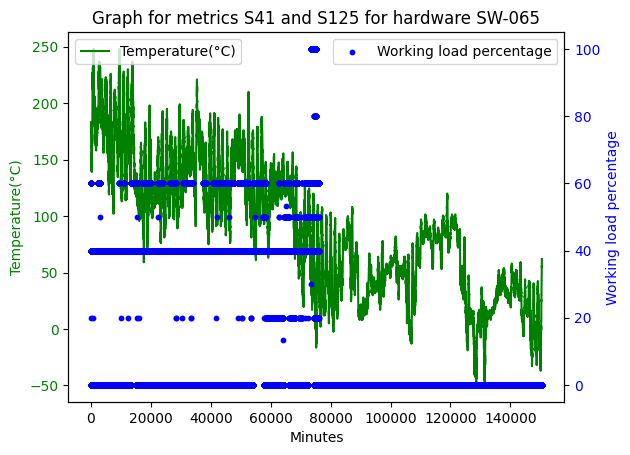

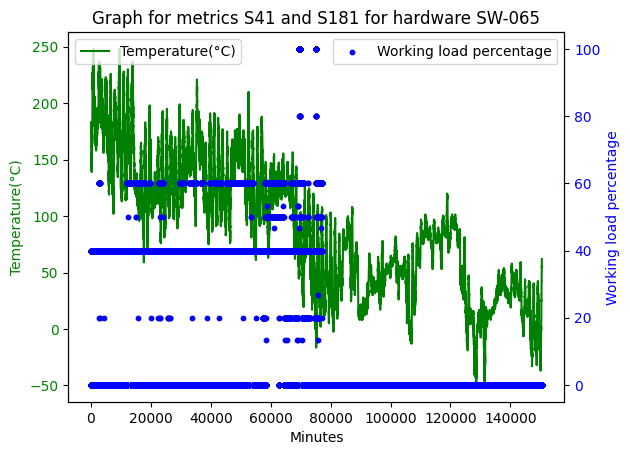

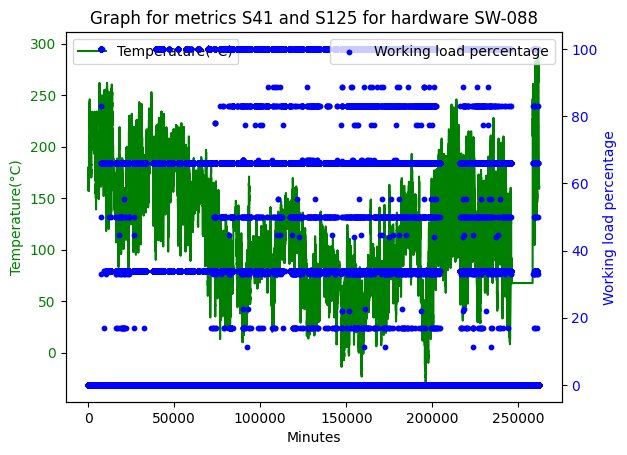

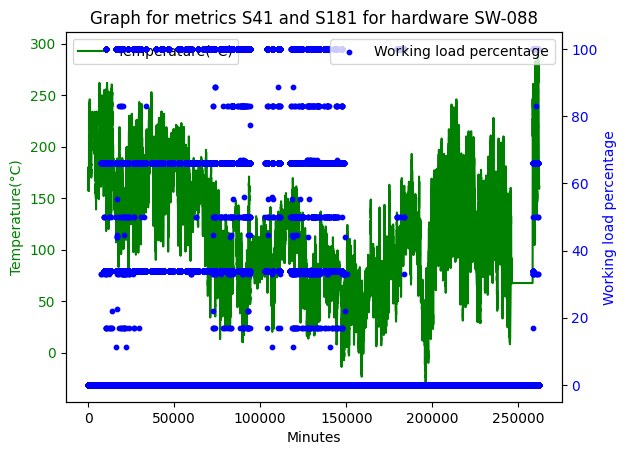

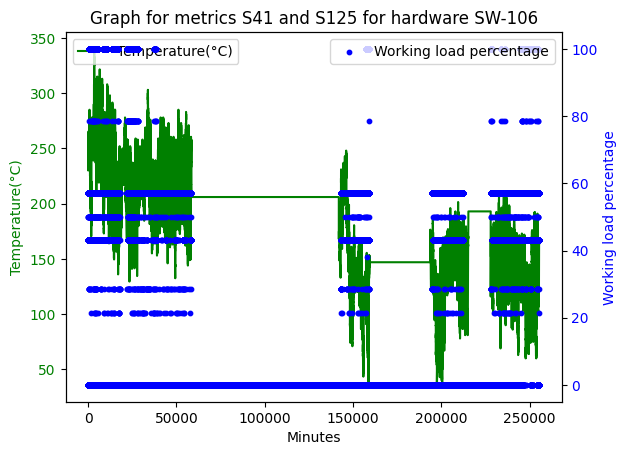

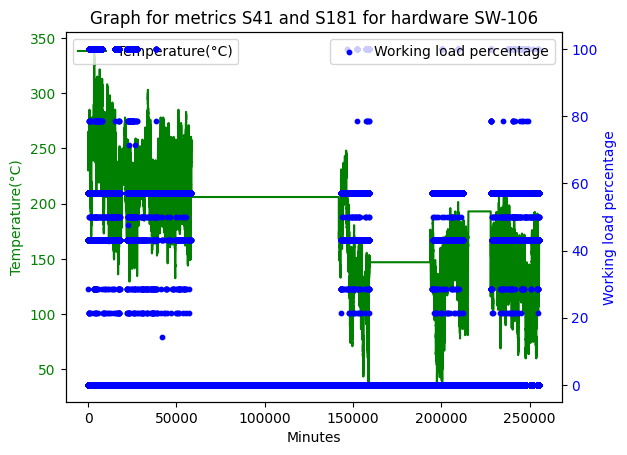

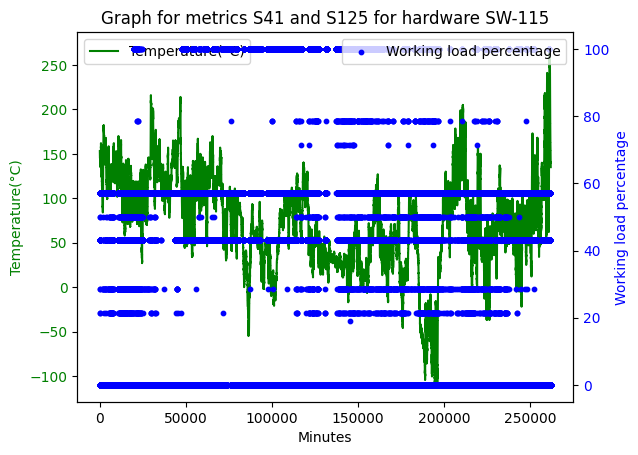

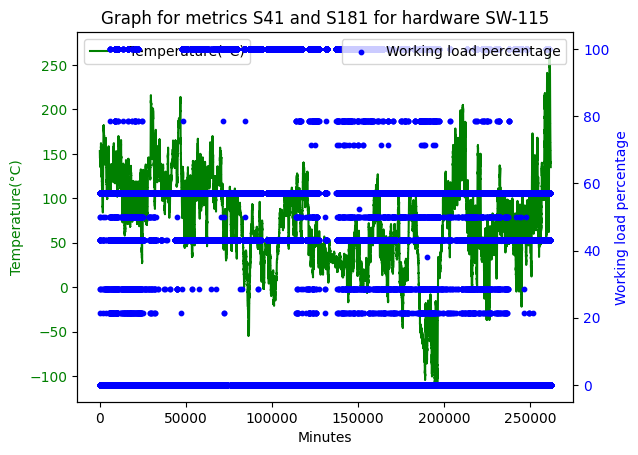

In [15]:
for hw in hwids:
    temp_val, temp_min = aux.get_norm_data(df,hw,'S41')
    temp_fill = aux.fill_missing_min(temp_val, temp_min)
    for metric in metrics:
        perc_val, perc_min = aux.get_norm_data(df,hw,metric)
        perc_fill = aux.fill_missing_min(perc_val, perc_min)
        
        fig,ax1 = plt.subplots()
    
        ax1.plot(range(len(temp_fill)), temp_fill, 'g-', label='Temperature(°C)')
        ax1.set_xlabel('Minutes')
        ax1.set_ylabel('Temperature(°C)', color='g')
        ax1.tick_params(axis='y', labelcolor='g')

        ax2 = ax1.twinx()

        ax2.scatter(range(len(perc_fill)), perc_fill, s= 10, color='b', label='Working load percentage')
        ax2.set_ylabel('Working load percentage', color='b')
        ax2.tick_params(axis='y', labelcolor='b')
        
        ax1.legend(loc='upper left')
        ax2.legend(loc='upper right')

        plt.title(f"Graph for metrics S41 and {metric} for hardware {hw}")

        output_directory = './Task2/Graphs'  
        output_file = f'{hw}_{metric}_plot.png'

        os.makedirs(output_directory, exist_ok=True)

        output_path = os.path.join(output_directory, output_file)
        
        plt.savefig(output_path)
        plt.show()


# Task 3

In [28]:
#faults only present in SW-088
hardware = 'SW-088'
alarm_list = ['A5', 'A9']

a5 = aux.separate_readings(df, hardware, alarm_list[0])
a9 = aux.separate_readings(df, hardware, alarm_list[1])

In [29]:
a5_fault = pd.DataFrame({'minute':a5['minute'], 'fault':a5['fault']})
a9_7 = pd.DataFrame({'minute':a9['minute'], 'fault':a9['A9_7']})
a9_8 = pd.DataFrame({'minute':a9['minute'], 'fault':a9['A9_8']})
a9_fault = pd.DataFrame({'minute':a9['minute'], 'fault':a9['fault']})

The same things said about the computing of the correlations in Task 1 are valid here; also in this case we attach the already reformatted files.

In [ ]:
#external metrics (common between C1 and C2)
metric_list = ['P1','P2','S10','S25','S33','S35','S37','S39','S40','S41',\
               'S46','S47','S5','S53','S55','S6','S64','S7','S70','S8','S9']

metric_norm = []
for metric in metric_list:
    print(f"Calculating for metric {metric}")
    values, minutes = aux.get_norm_data(df, hardware, metric)
    metric_val = aux.fill_missing_min(values, minutes)
    time = np.arange(0, len(metric_val))
    metric_norm.append(pd.DataFrame({'minute': time, 'value': metric_val}))

In [35]:
#calculating correlations for a5_fault
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a5_fault, metric_norm, window = 15, shift = shift)

    with open(f"a5_fault_shift{shift}_correlations.txt",'a') as file:

        file.write(','.join(metric_list))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')


In [ ]:
#calculating correlations for a9_fault
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a9_fault, metric_norm, window = 15, shift = shift)

    with open(f"a9_fault_shift{shift}_correlations.txt",'a') as file:

        file.write(','.join(metric_list))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')


In [ ]:
#calculating correlations for a9_7
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a9_7, metric_norm, window = 15, shift = shift)

    with open(f"a9_7_shift{shift}_correlations.txt",'a') as file:

        file.write(','.join(metric_list))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')


In [ ]:
#calculating correlations for a9_8
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a9_8, metric_norm, window = 15, shift = shift)

    with open(f"a9_8_shift{shift}_correlations.txt",'a') as file:

        file.write(','.join(metric_list))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')


In [ ]:
#metrics for A5 (circuit 1 specific)
metric_list = ['S117', 'S118', 'S112', 'S113', 'S114', 'S115', 'S123', 'S127', 'S201', 'S202', 'S203',\
                'S73', 'S100', 'S101', 'S102', 'S106', 'S107', 'S108', 'S122', 'S124', 'S126', 'S109', 'S110']

metric_norm = []
for metric in metric_list:
    print(f"Calculating for metric {metric}")
    values, minutes = aux.get_norm_data(df, hardware, metric)
    metric_val = aux.fill_missing_min(values, minutes)
    time = np.arange(0, len(metric_val))
    metric_norm.append(pd.DataFrame({'minute': time, 'value': metric_val}))

In [ ]:
#calculating correlations
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a5_fault, metric_norm, window = 15, shift = shift)

    with open(f"a5_fault_shift{shift}_correlations.txt",'a') as file:

        file.write(','.join(metrics))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')

In [ ]:
#metrics for A9 (circuit 2 specific)
metric_list = ['S169', 'S170','S130', 'S171', 'S172', 'S173', 'S174', 'S179', 'S183', 'S204', 'S205', 'S206', 'S157', 'S158', 'S159']

metric_norm = []
for metric in metric_list:
    print(f"Calculating for metric {metric}")
    values, minutes = aux.get_norm_data(df, hardware, metric)
    metric_val = aux.fill_missing_min(values, minutes)
    time = np.arange(0, len(metric_val))
    metric_norm.append(pd.DataFrame({'minute': time, 'value': metric_val}))

In [ ]:
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a9_fault, metric_norm, window = 15, shift = shift)

    with open(f"a9_fault_shift{shift}_correlations.txt",'a') as file:
        file.write(','.join(metrics))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')

In [ ]:
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a9_7, metric_norm, window = 15, shift = shift)

    with open(f"a9_7_shift{shift}_correlations.txt",'a') as file:
        file.write(','.join(metrics))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')

In [ ]:
for shift in range(0, 31, 5):
    tot, pearson, spearman, kendall = aux.corr_finder_shift(a9_8, metric_norm, window = 15, shift = shift)

    with open(f"a9_8_shift{shift}_correlations.txt",'a') as file:
        file.write(','.join(metrics))
        file.write('\n')

        for corrs in pearson:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in spearman:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')

        for corrs in kendall:
            file.write(' '.join(map(str,corrs)))
            file.write('\n')
        
        file.write(' '.join(map(str,tot)))
        file.write('\n')

Here, the same work we've done for the correlations files in Task 1 is needed. After that we can use the same function to plot the correlation coefficients.

In [2]:
shifts=[0,5,10,15,20,25,30]
columns=['a5_fault','a9_7','a9_8','a9_fault']
col_names=['Alarm 5 Fault-','Alarm 9 bit 7-','Alarm 9 bit 8-','Alarm 9 Fault-']

In [3]:
limit_value=0.4

The notebook crashes if we plot all together in the same cell, we will divide them. All of the outputs are collapsed because of the amount of graphs.

Plotting all non-NaN Pearson coefficients
44


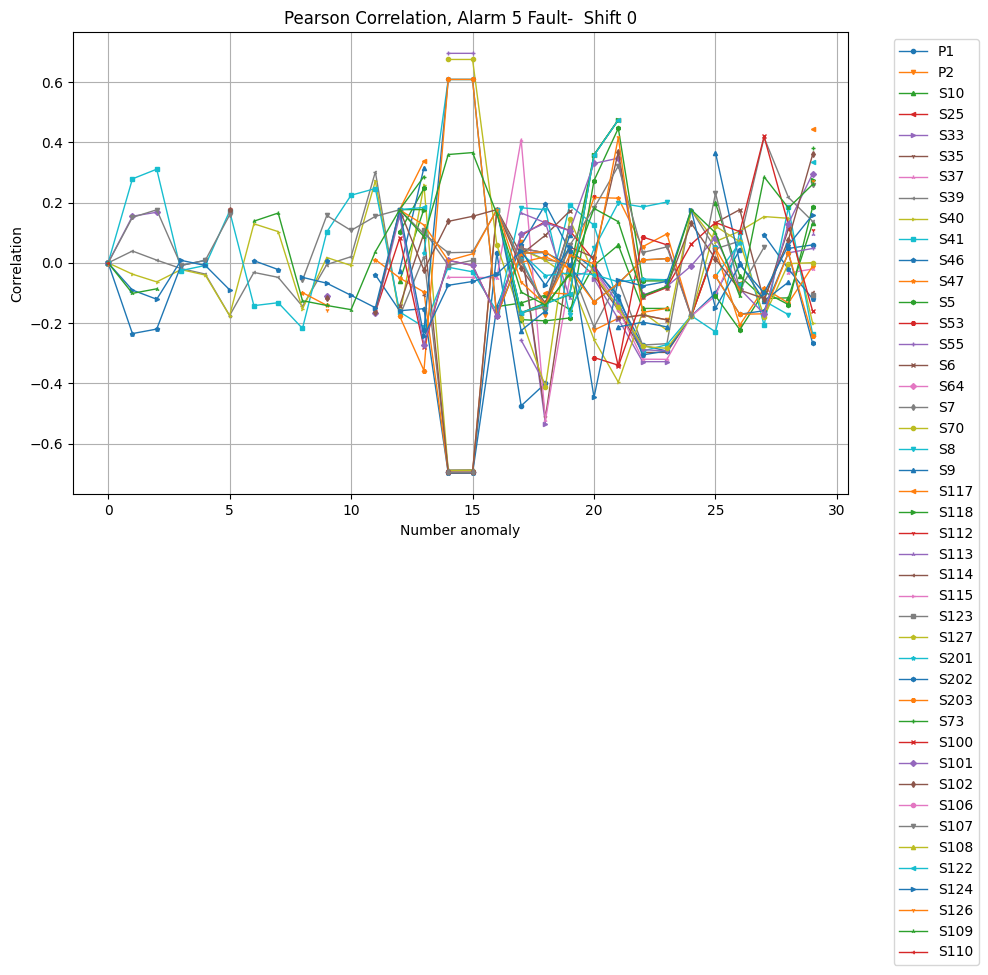

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
44


/home/braidi/aux.py:441: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


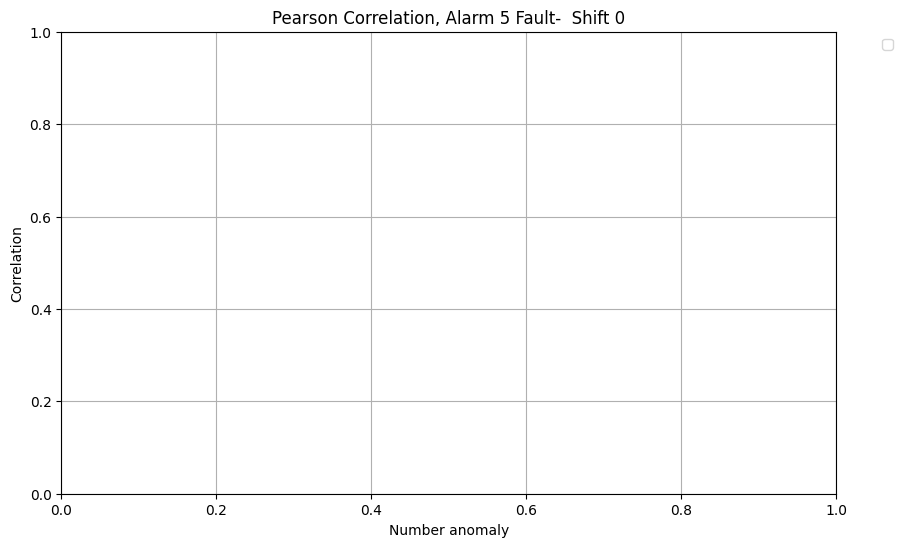

Plotting all non-NaN Spearman coefficients
44


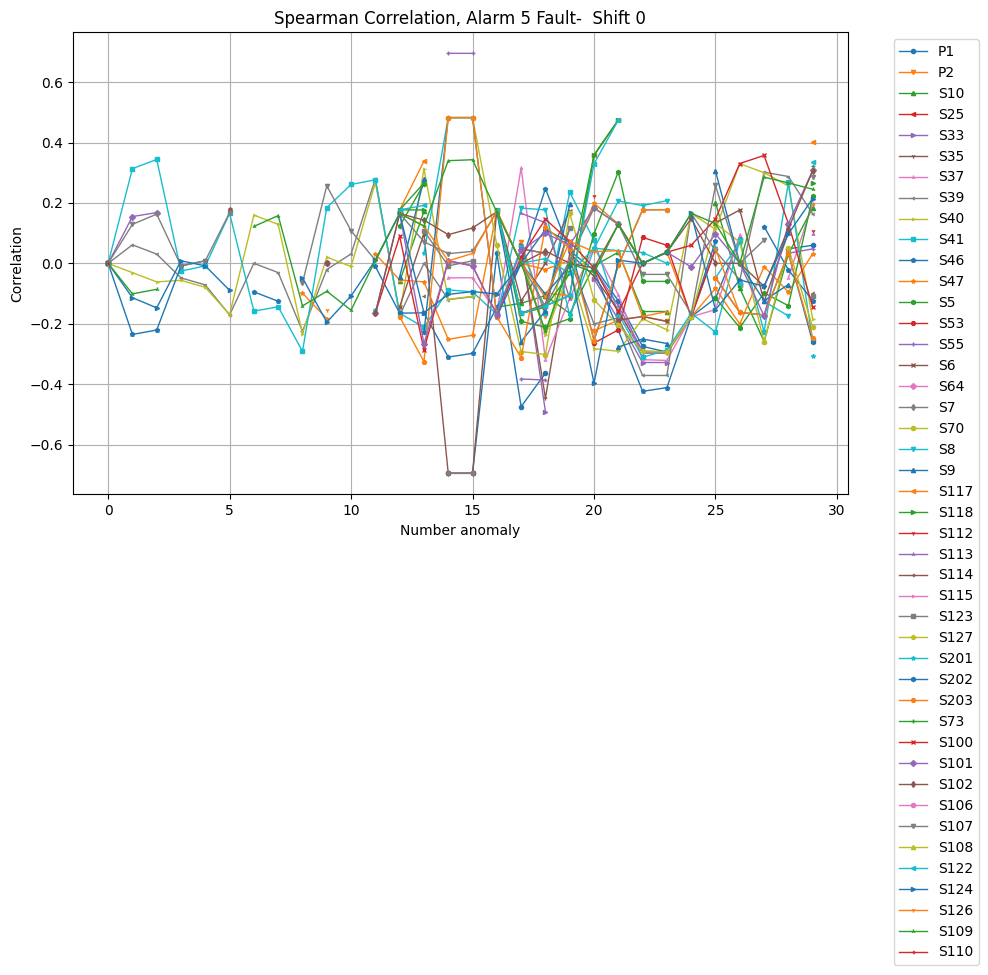

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
44


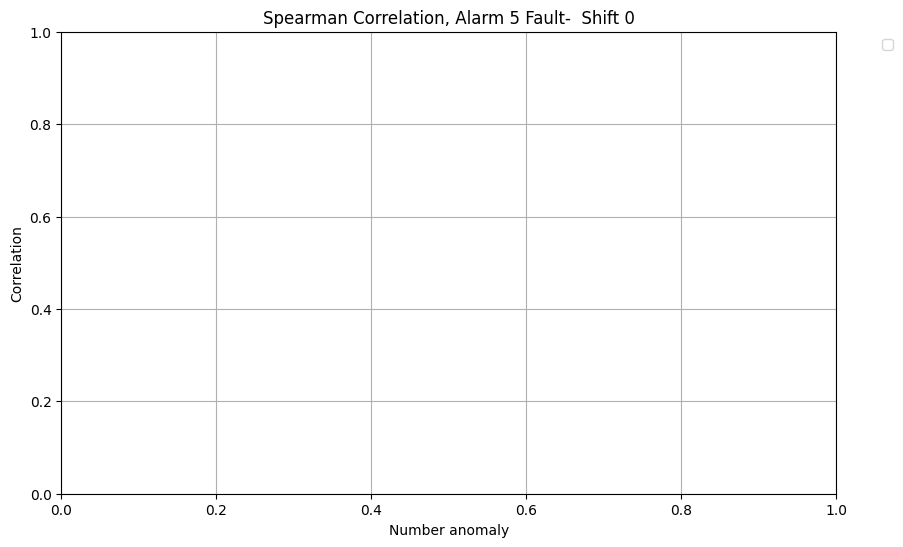

Plotting all non-NaN Pearson coefficients
44


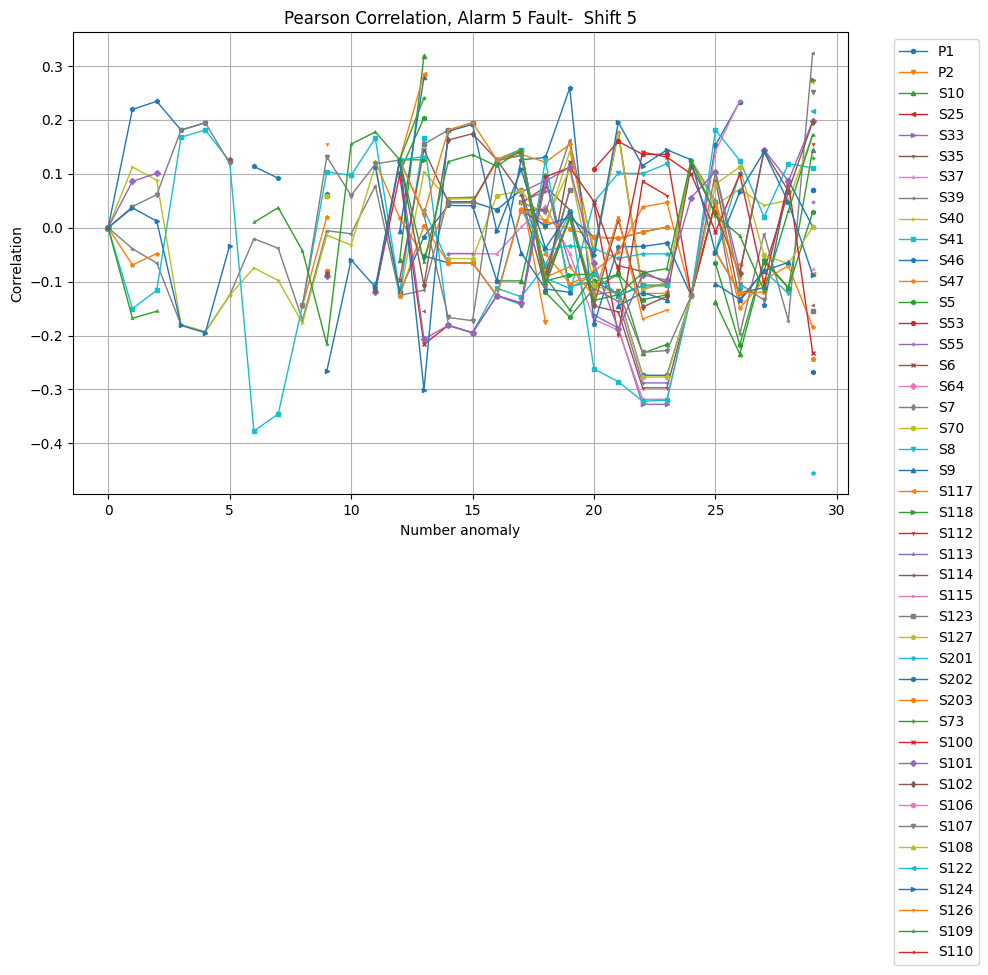

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
44


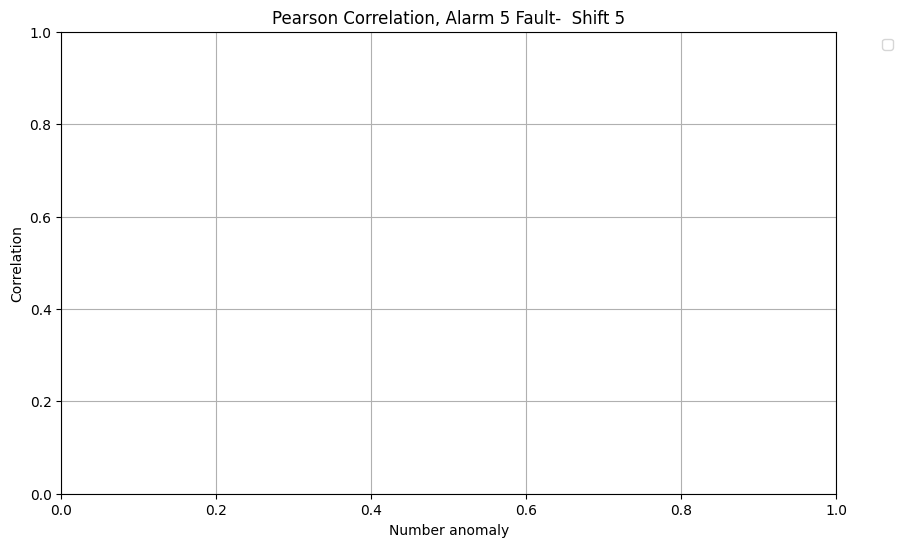

Plotting all non-NaN Spearman coefficients
44


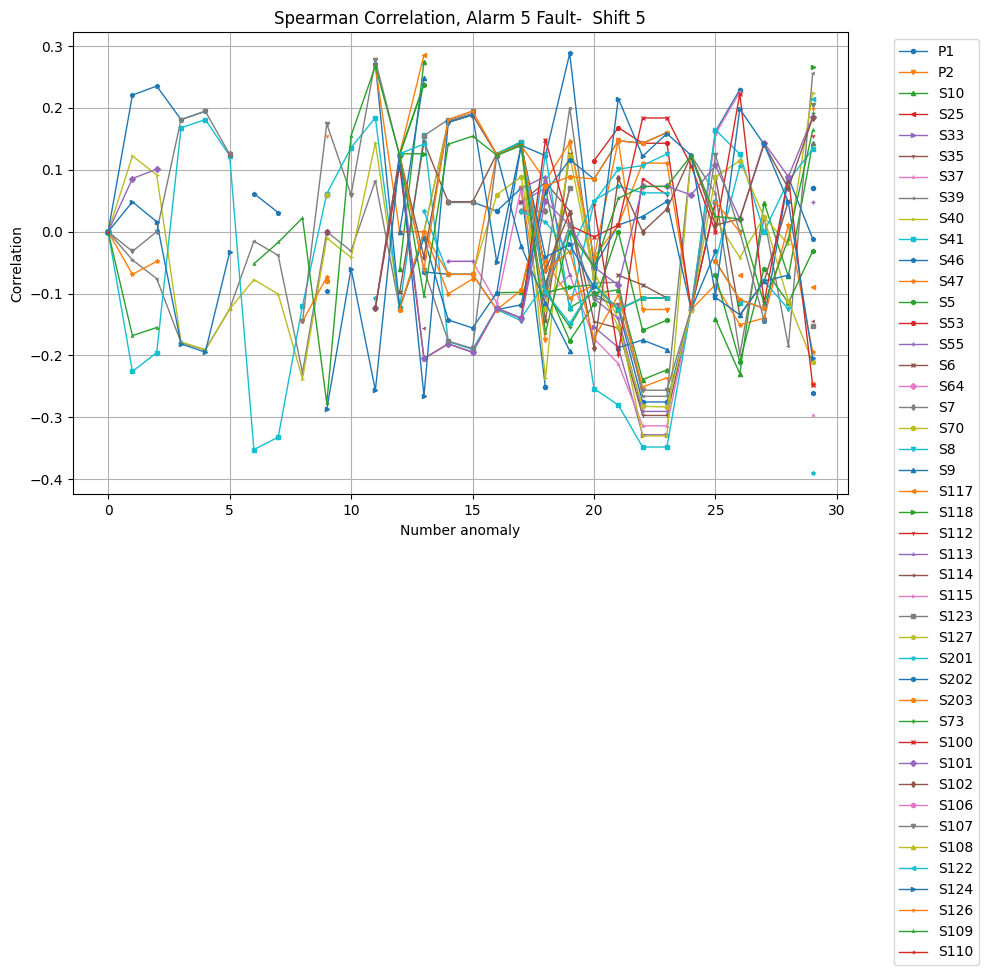

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
44


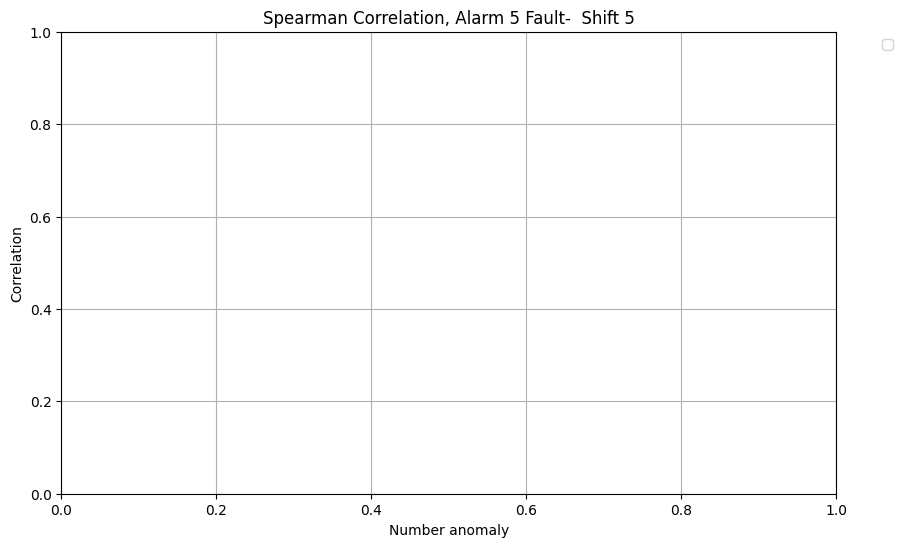

Plotting all non-NaN Pearson coefficients
44


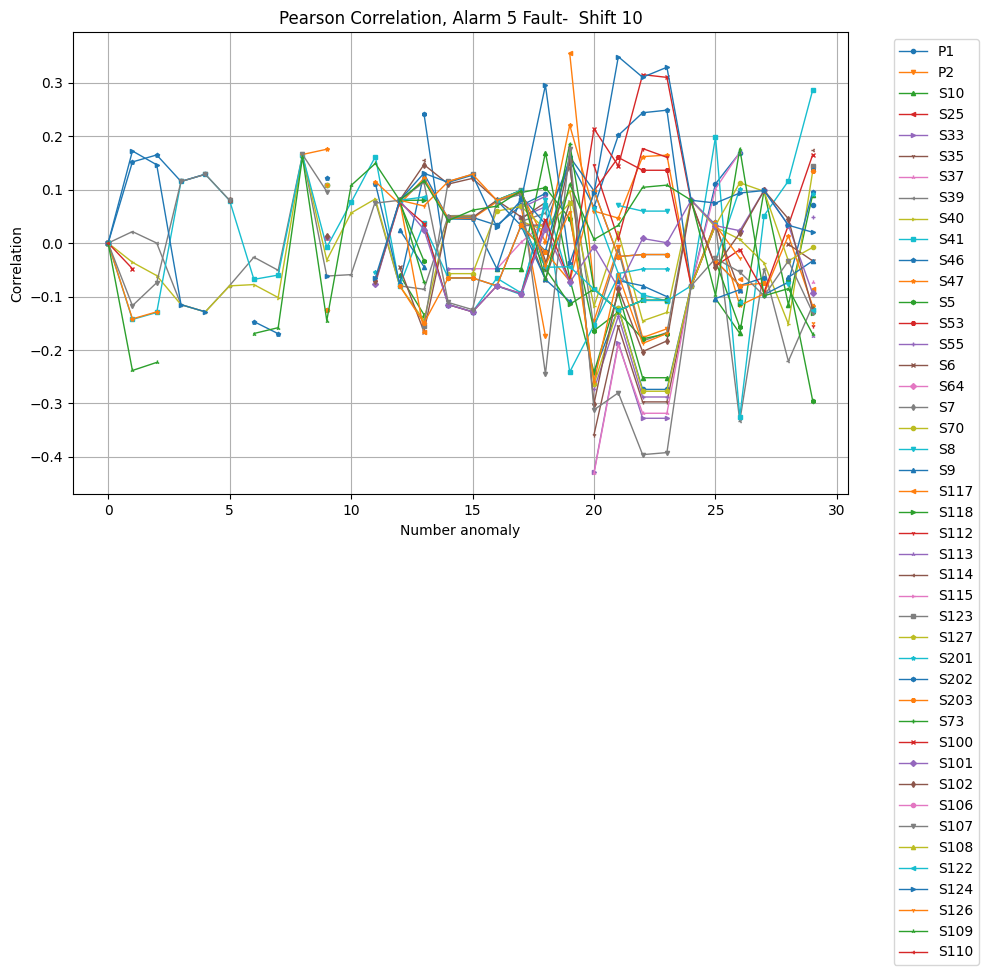

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
44


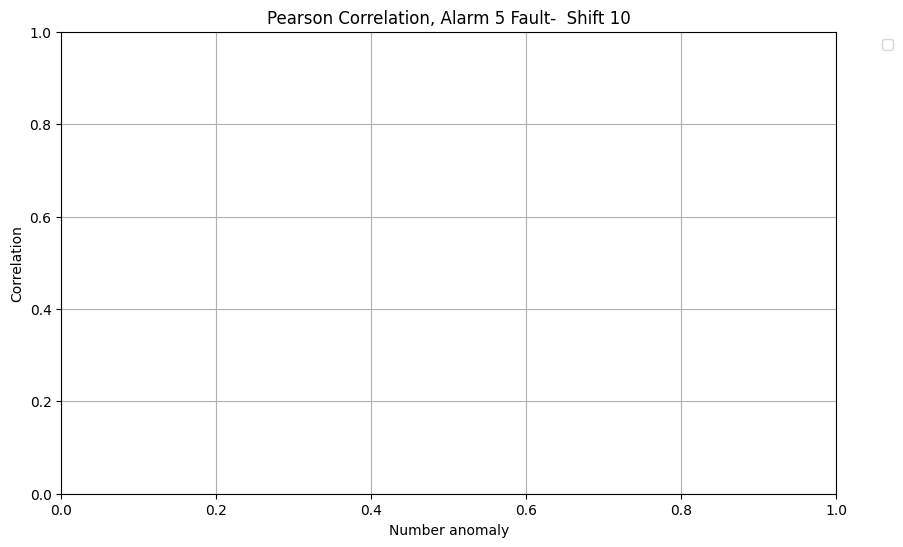

Plotting all non-NaN Spearman coefficients
44


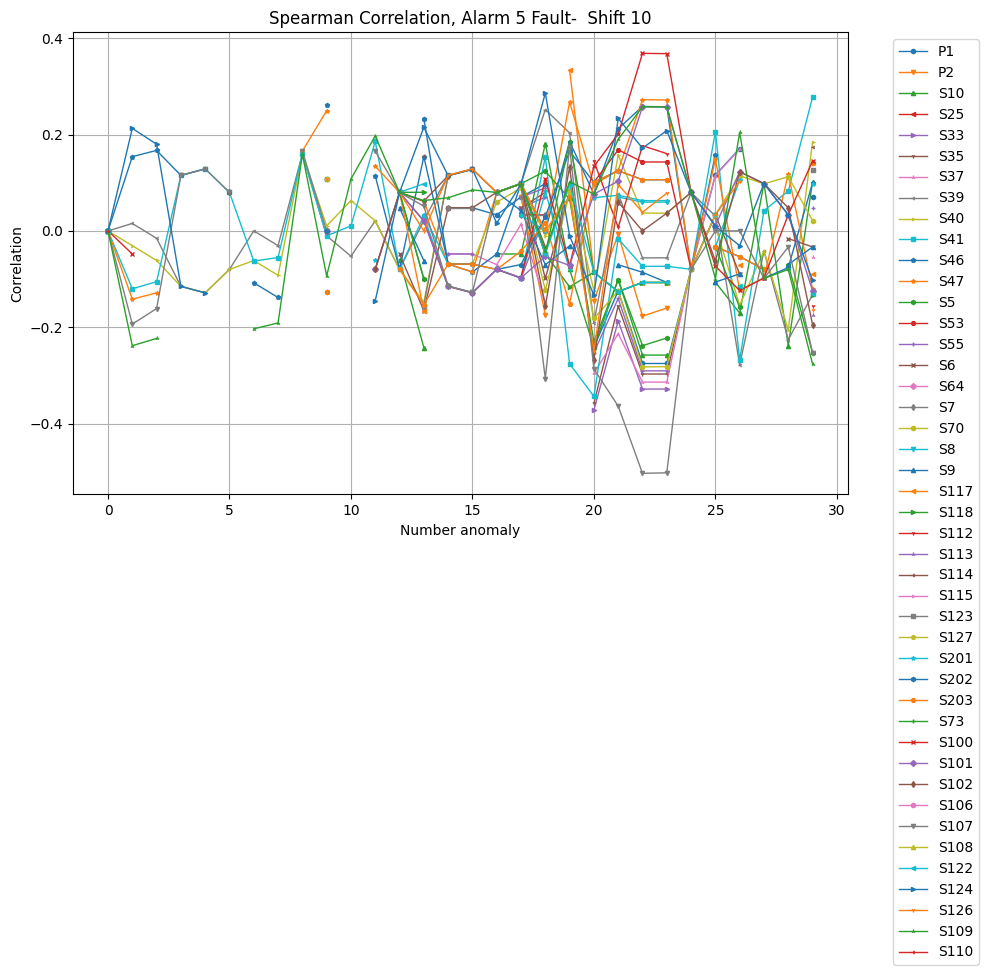

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
44


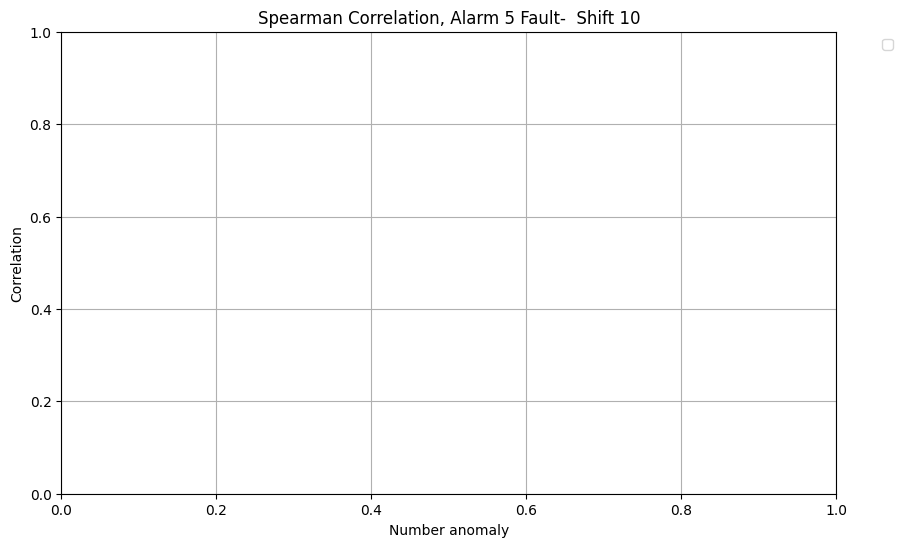

Plotting all non-NaN Pearson coefficients
44


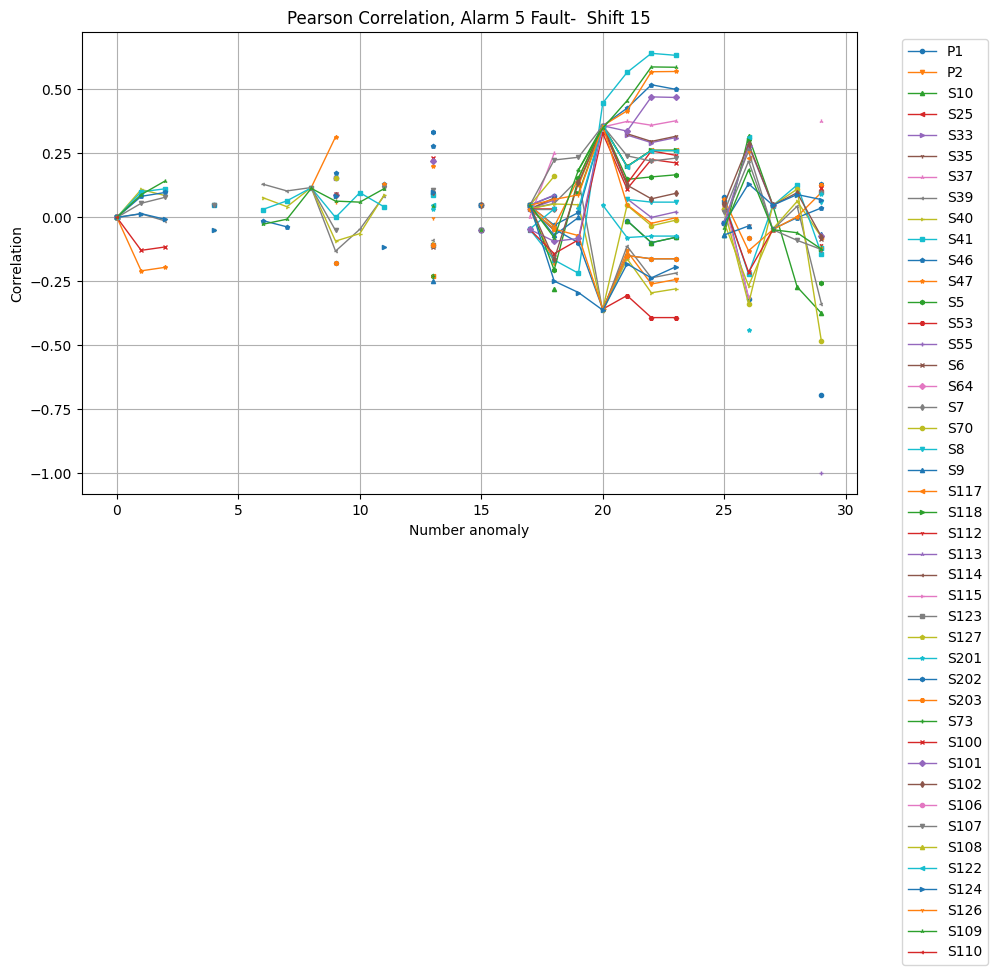

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
44


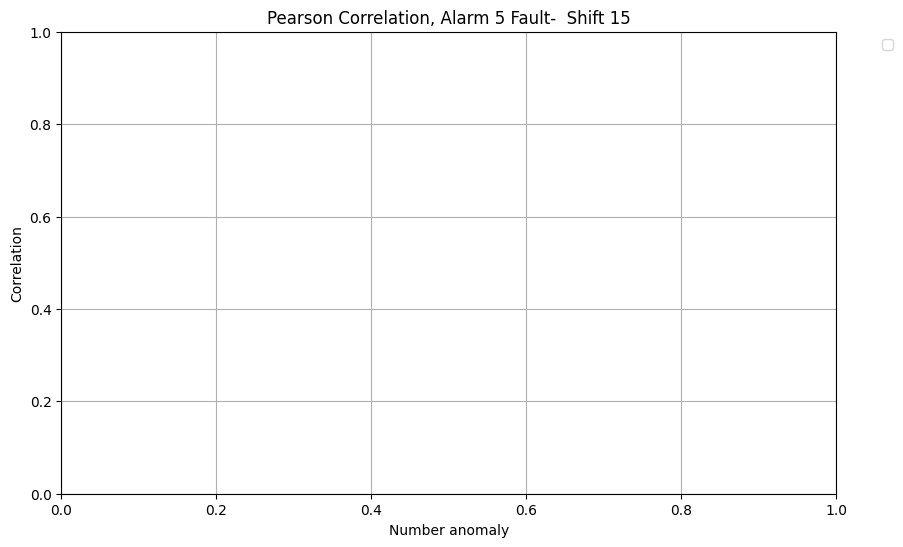

Plotting all non-NaN Spearman coefficients
44


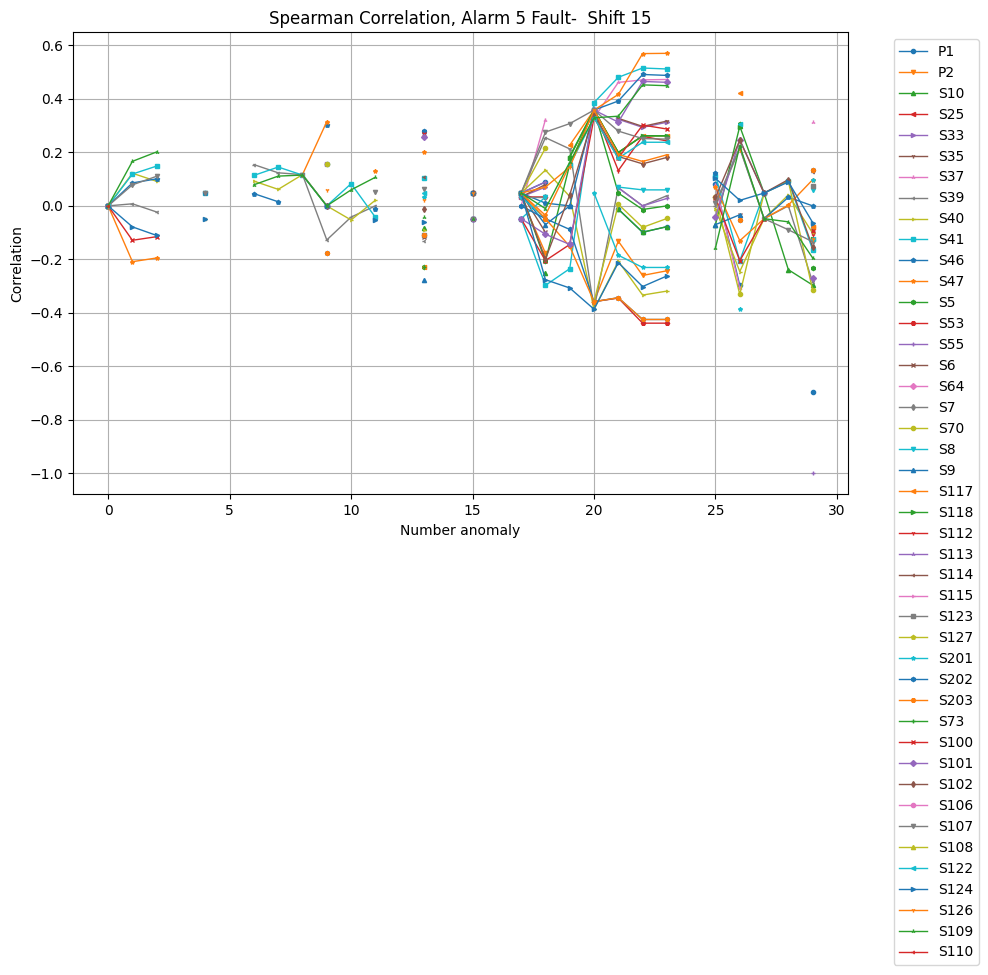

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
44


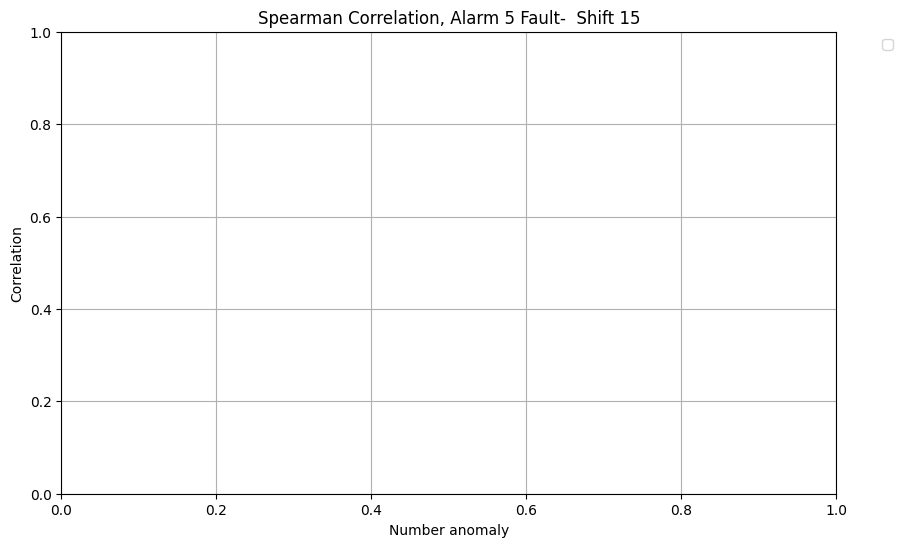

Plotting all non-NaN Pearson coefficients
44


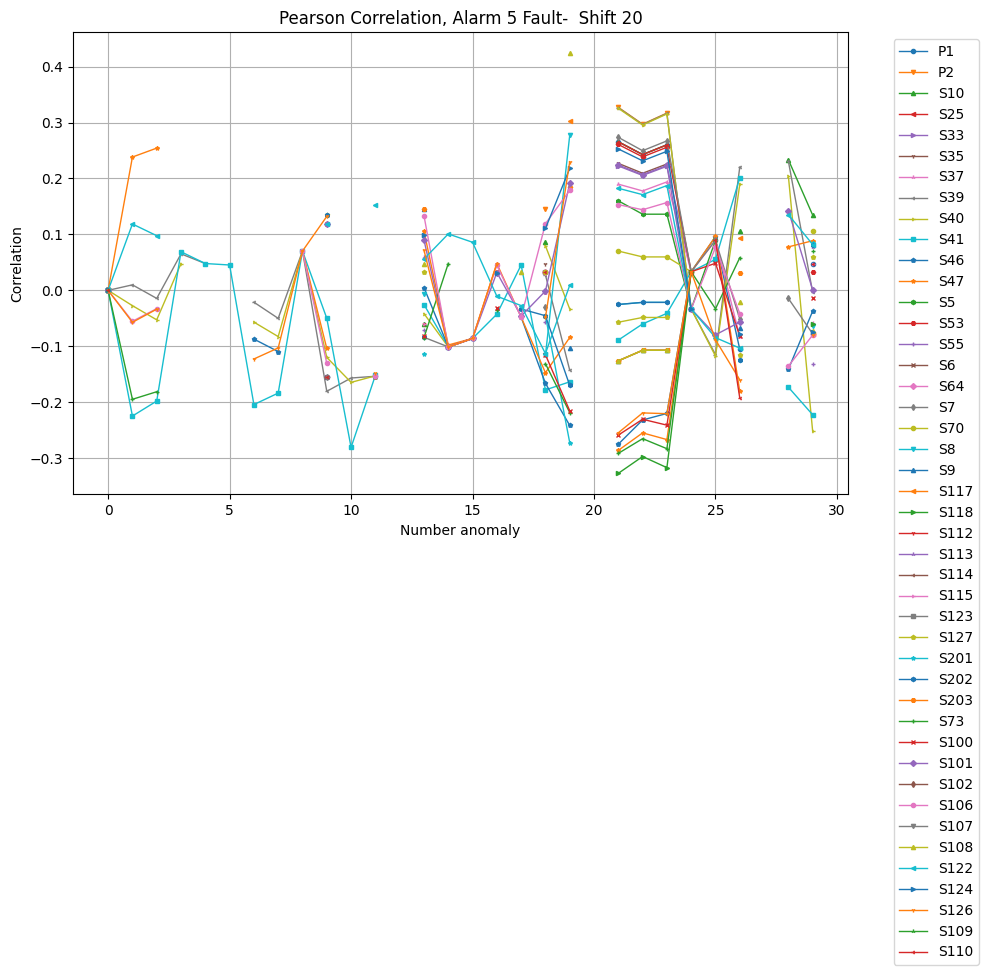

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
44


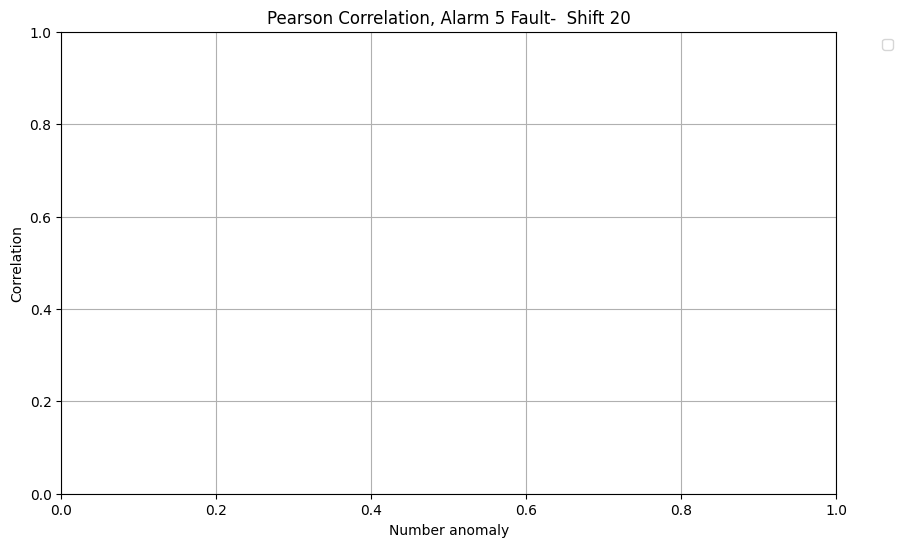

Plotting all non-NaN Spearman coefficients
44


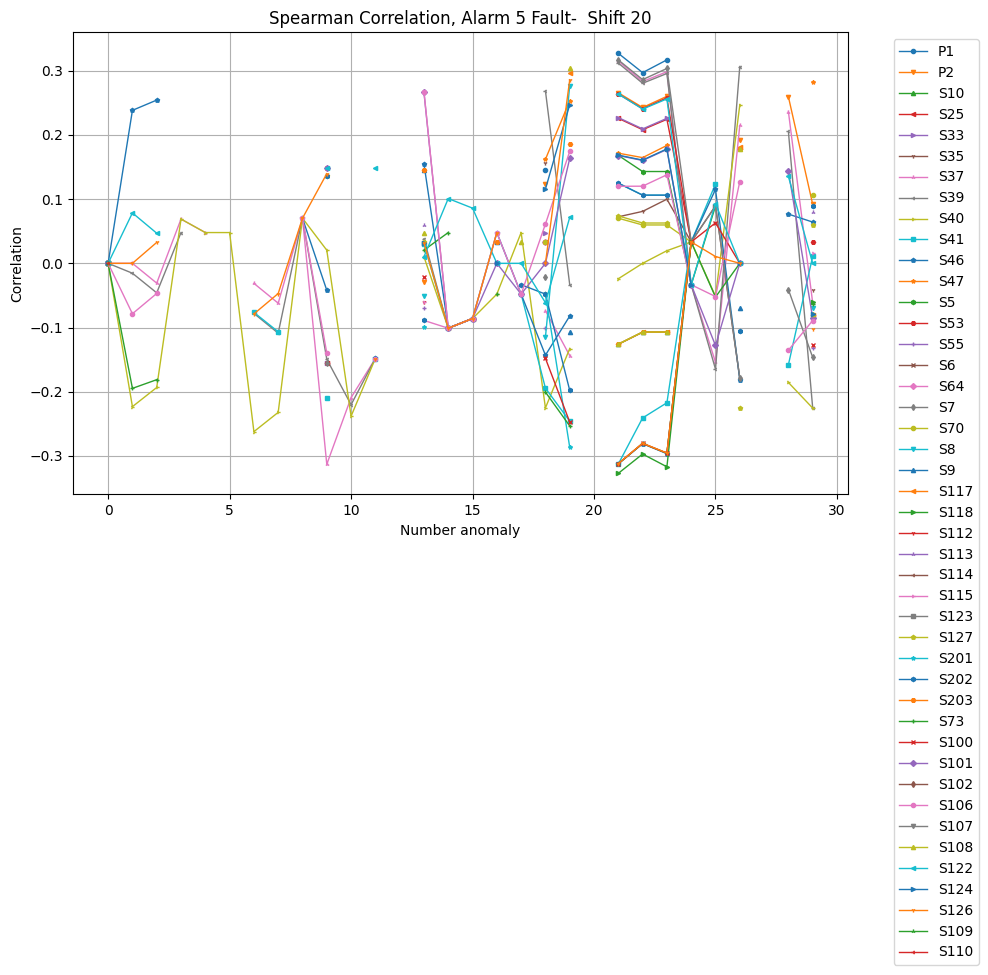

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
44


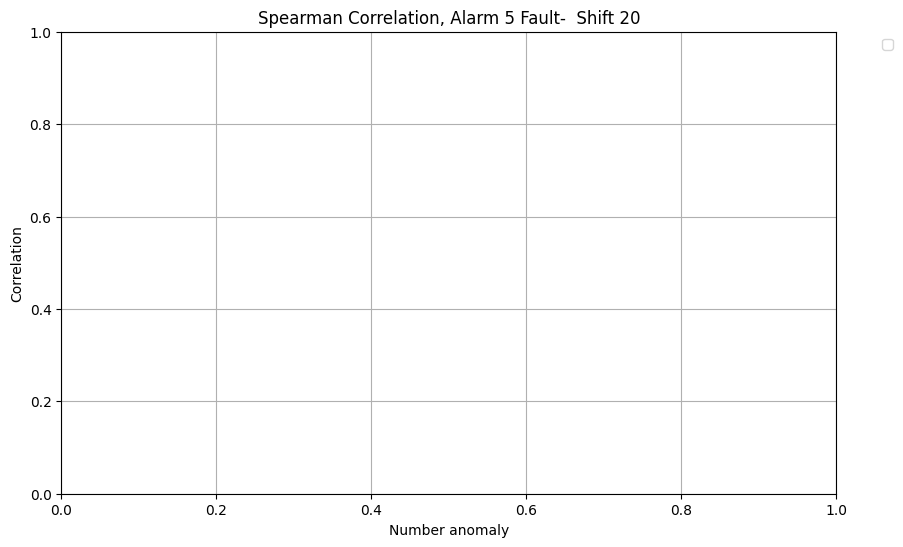

Plotting all non-NaN Pearson coefficients
44


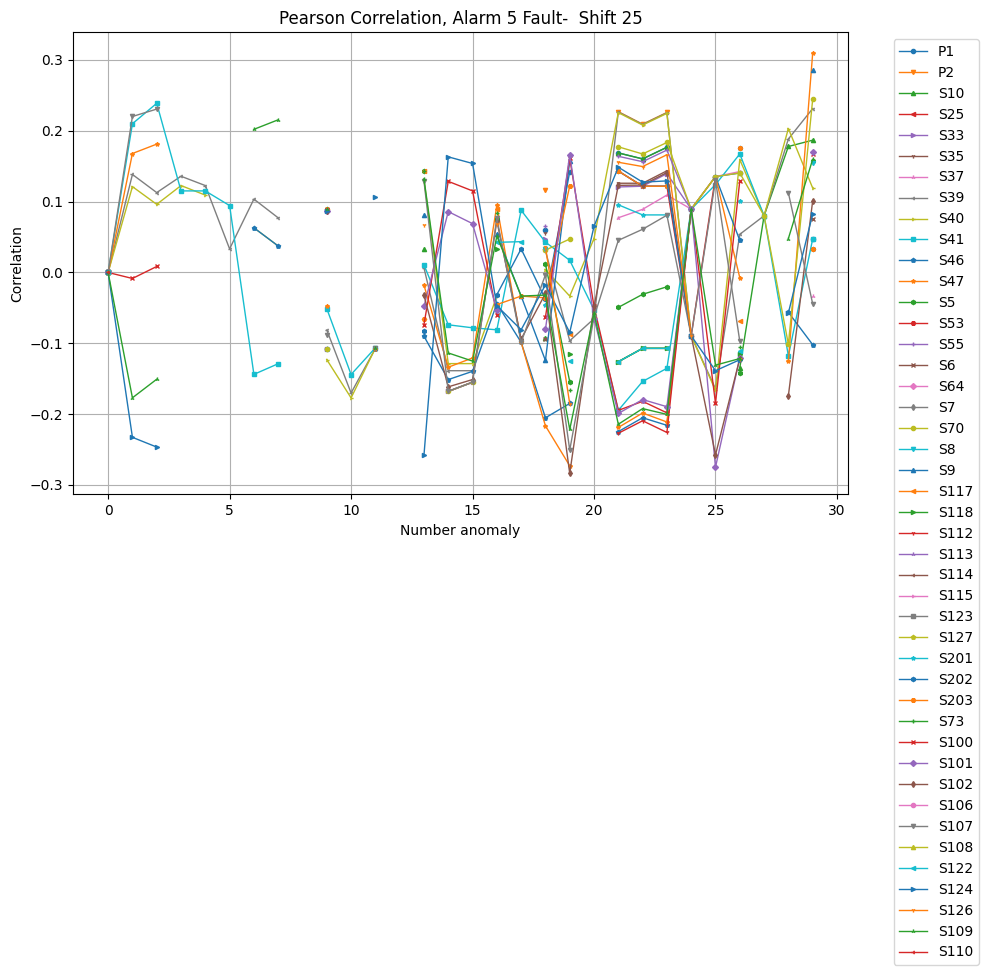

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
44


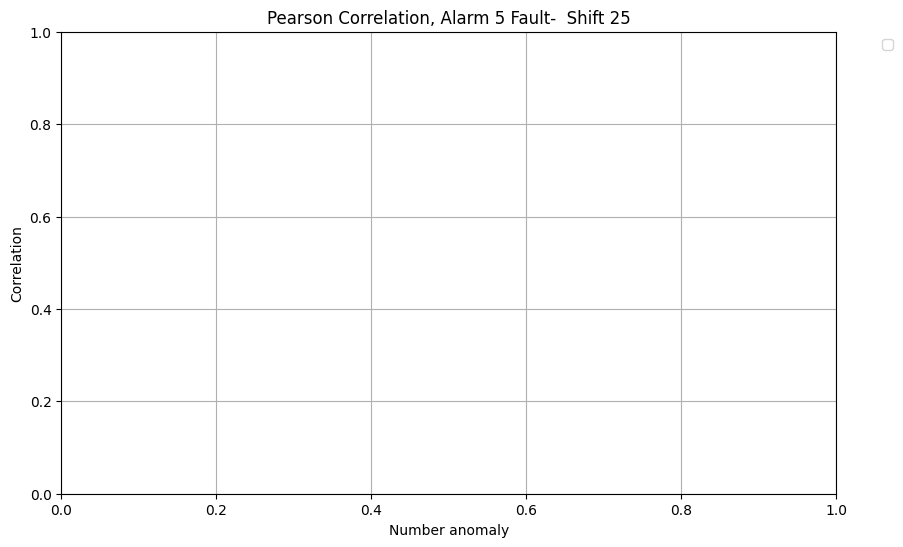

Plotting all non-NaN Spearman coefficients
44


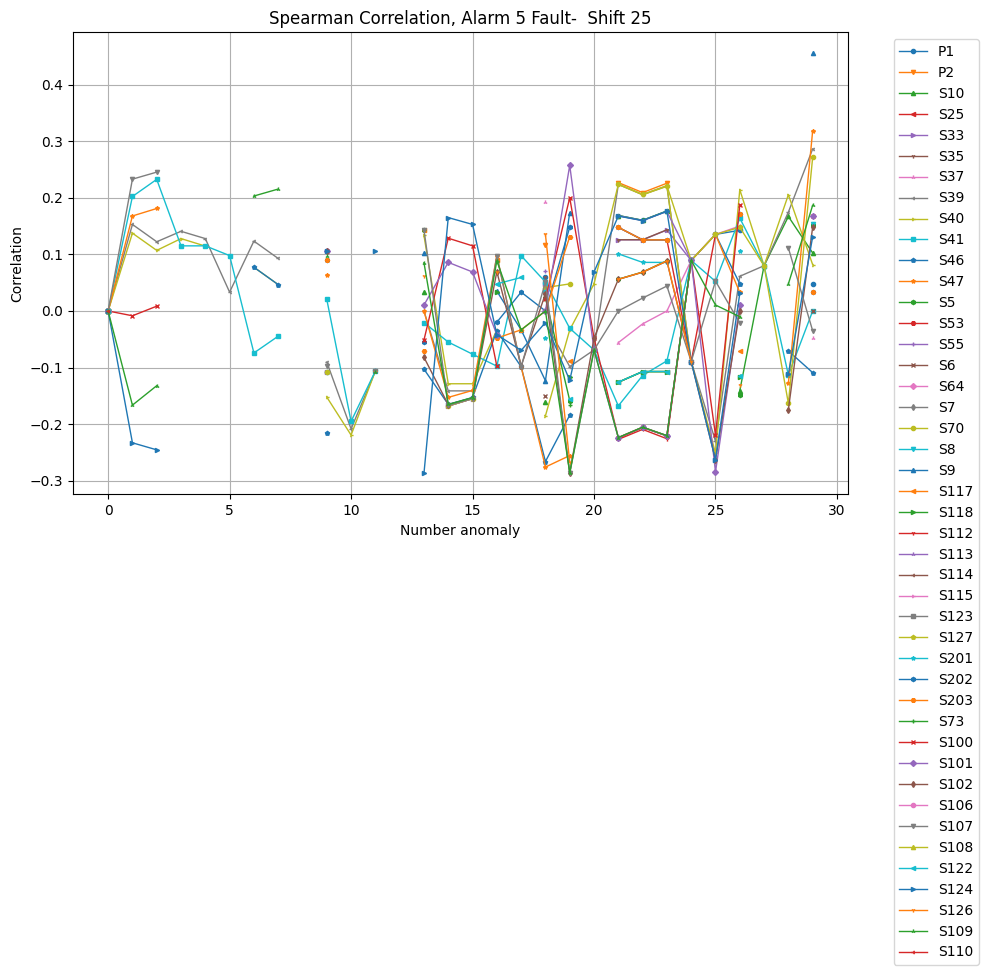

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
44


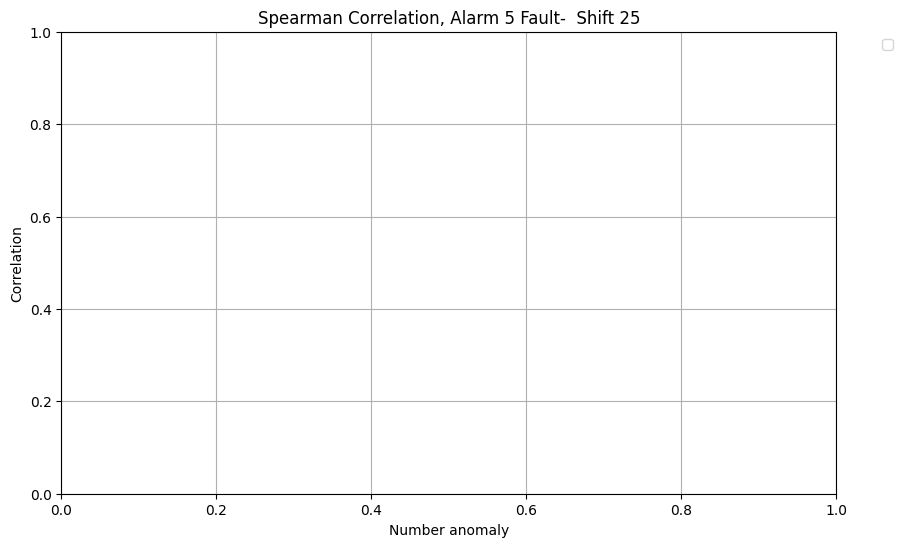

Plotting all non-NaN Pearson coefficients
44


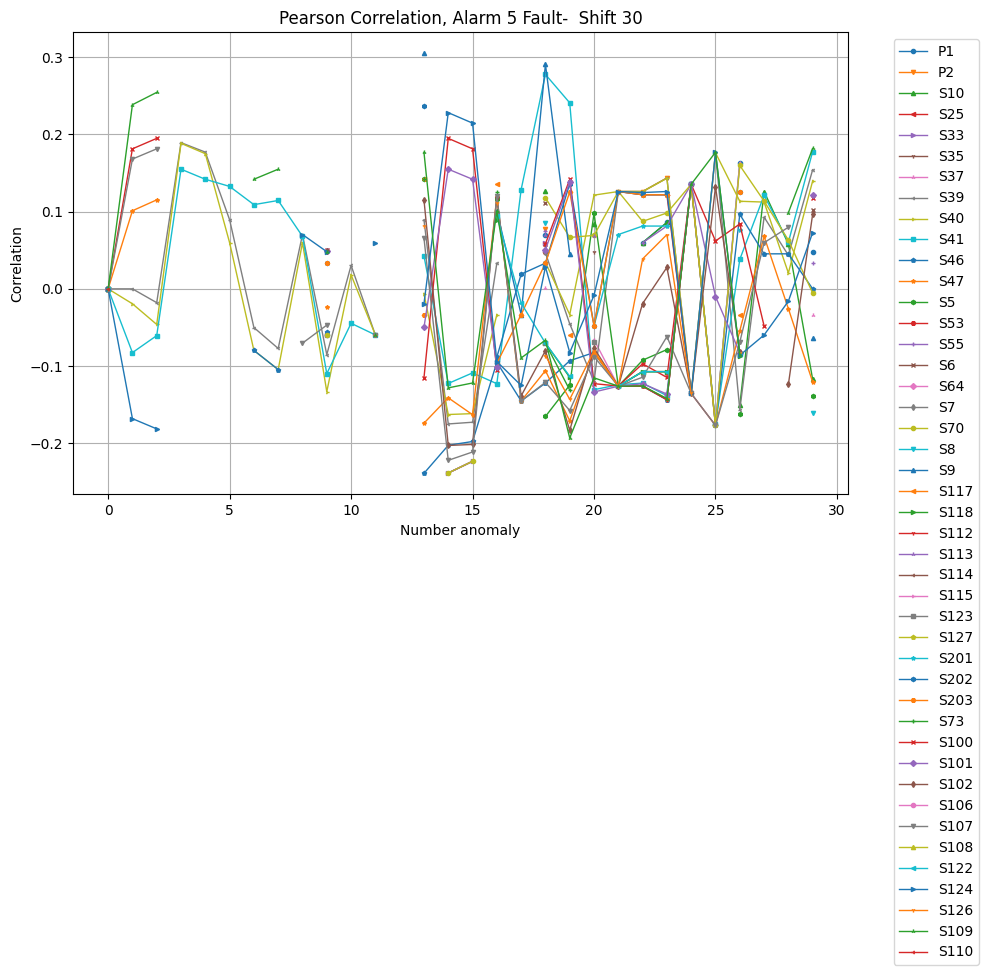

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
44


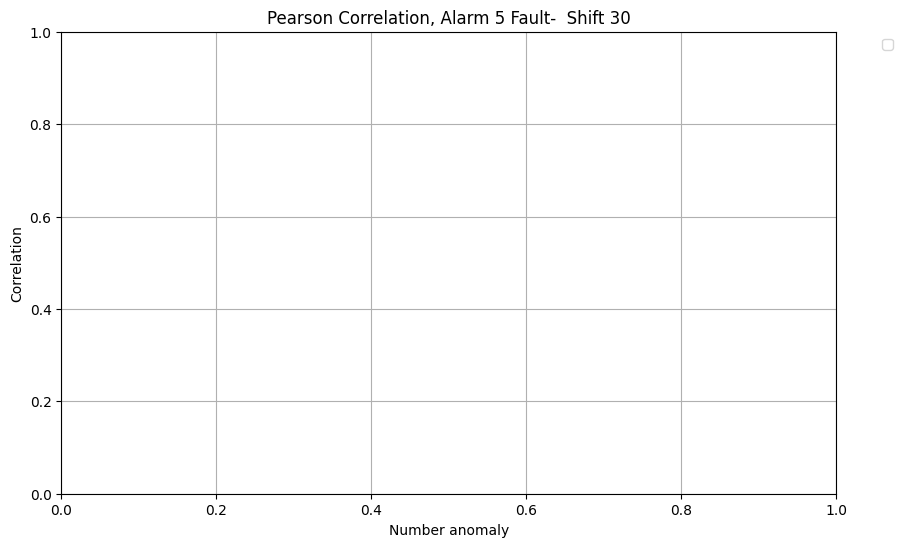

Plotting all non-NaN Spearman coefficients
44


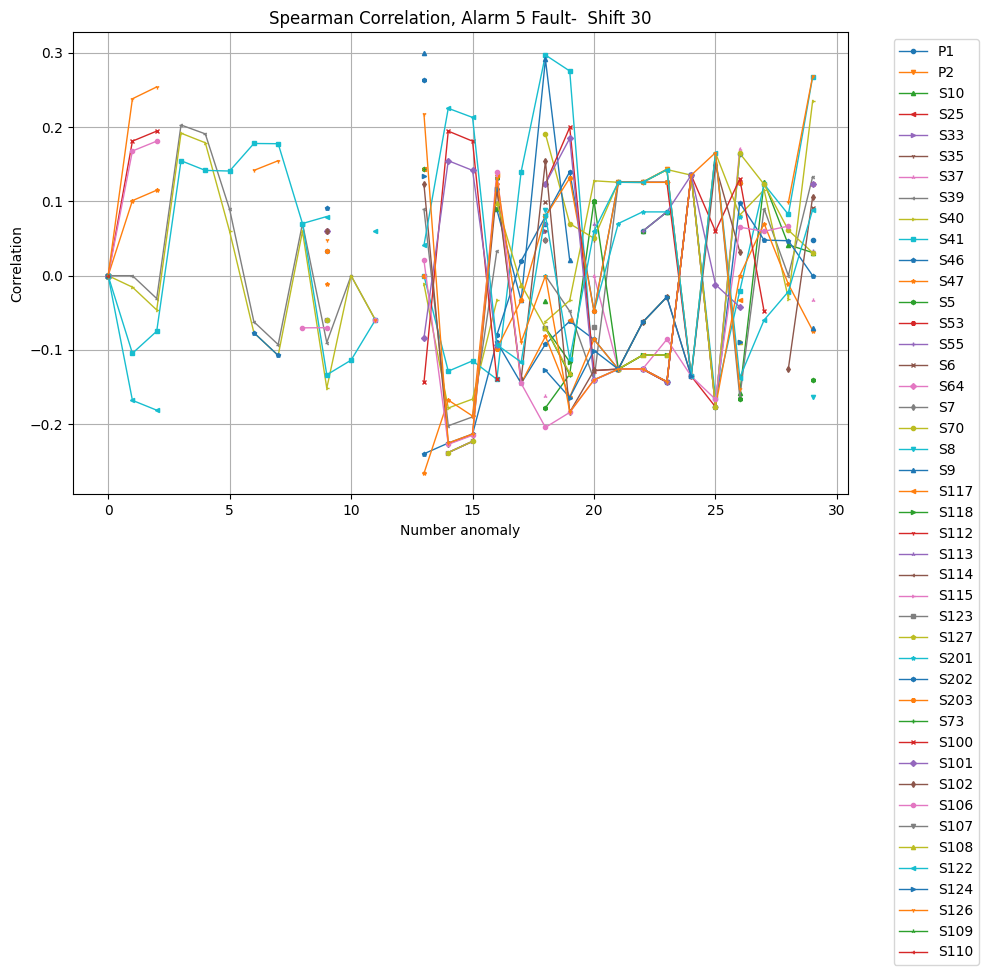

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
44


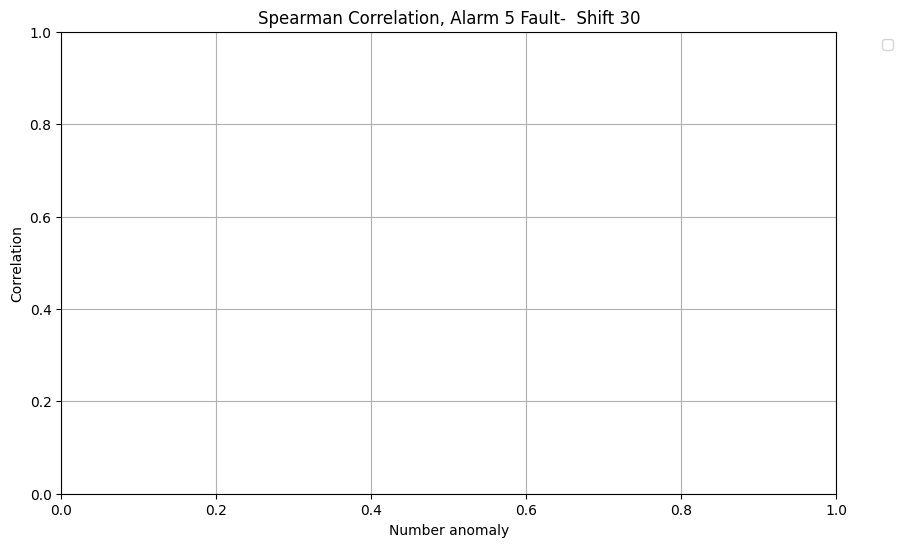

In [8]:
for shift in shifts:

    text1=col_names[0]
    text2=f'Shift {shift}'

    file_path= f'./{columns[0]}_shift{shift}_correlations.txt'

    print(f'Plotting all non-NaN Pearson coefficients')
    aux.read_and_plot(file_path,'Pearson',text1,text2)
    print(f'Plotting Pearson coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Pearson',text1,text2,avg_lim=limit_value)
    print(f'Plotting all non-NaN Spearman coefficients')
    aux.read_and_plot(file_path,'Spearman',text1,text2)
    print(f'Plotting Spearman coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Spearman',text1,text2,avg_lim=limit_value)

Plotting all non-NaN Pearson coefficients
43


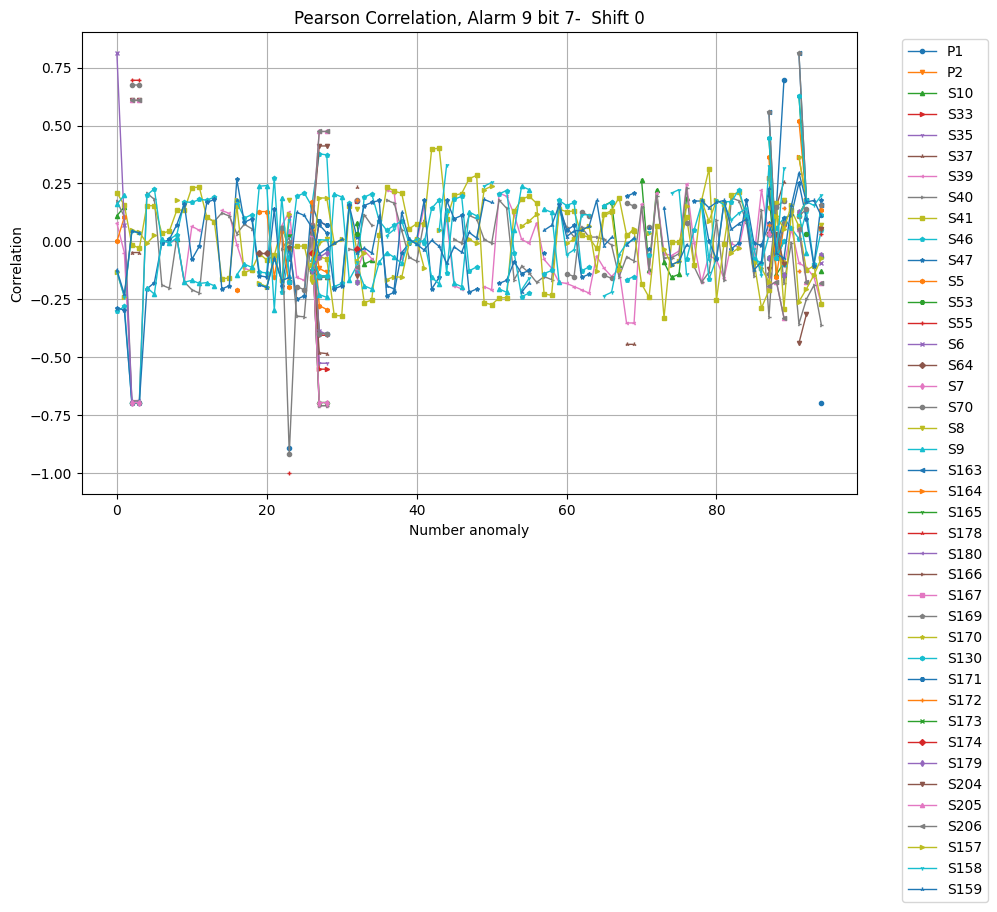

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


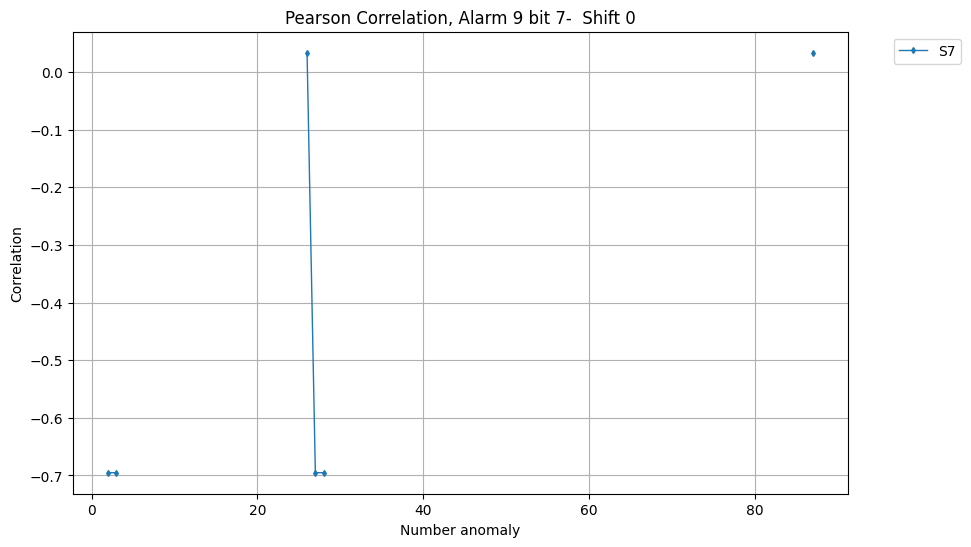

Plotting all non-NaN Spearman coefficients
43


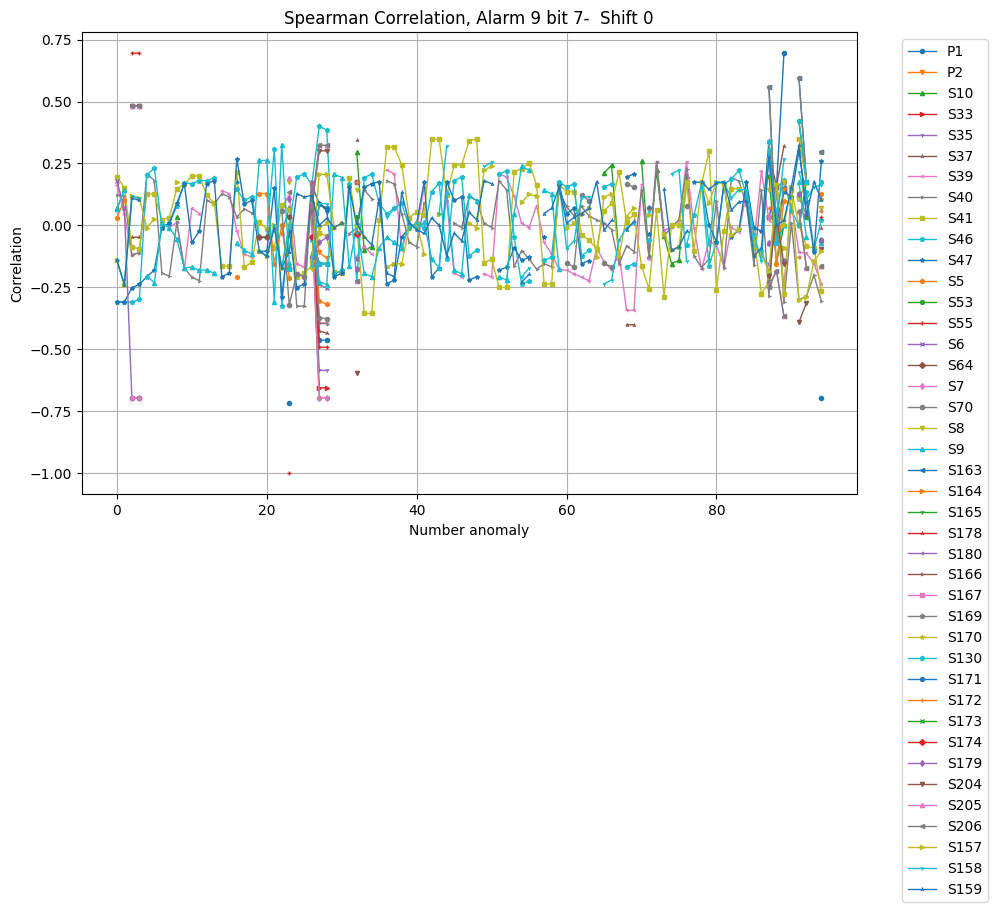

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


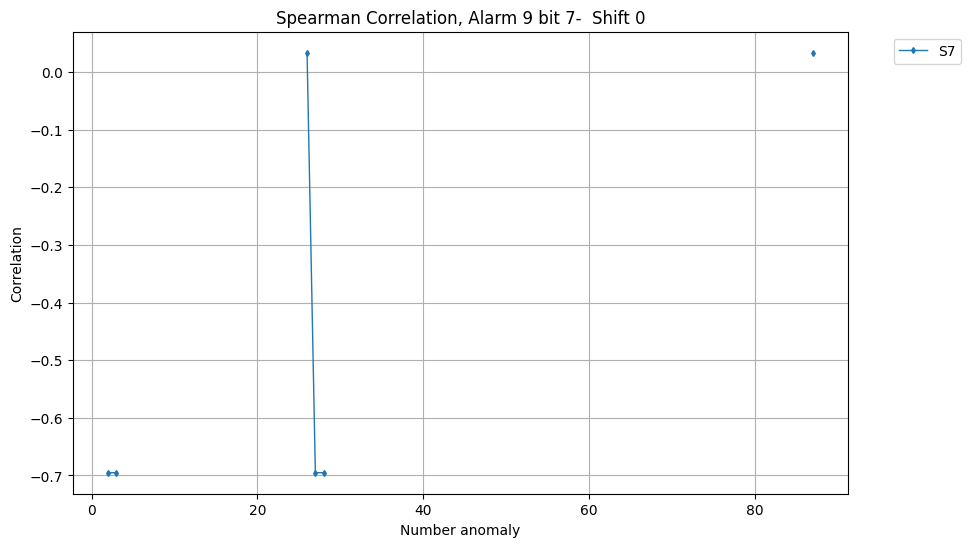

Plotting all non-NaN Pearson coefficients
43


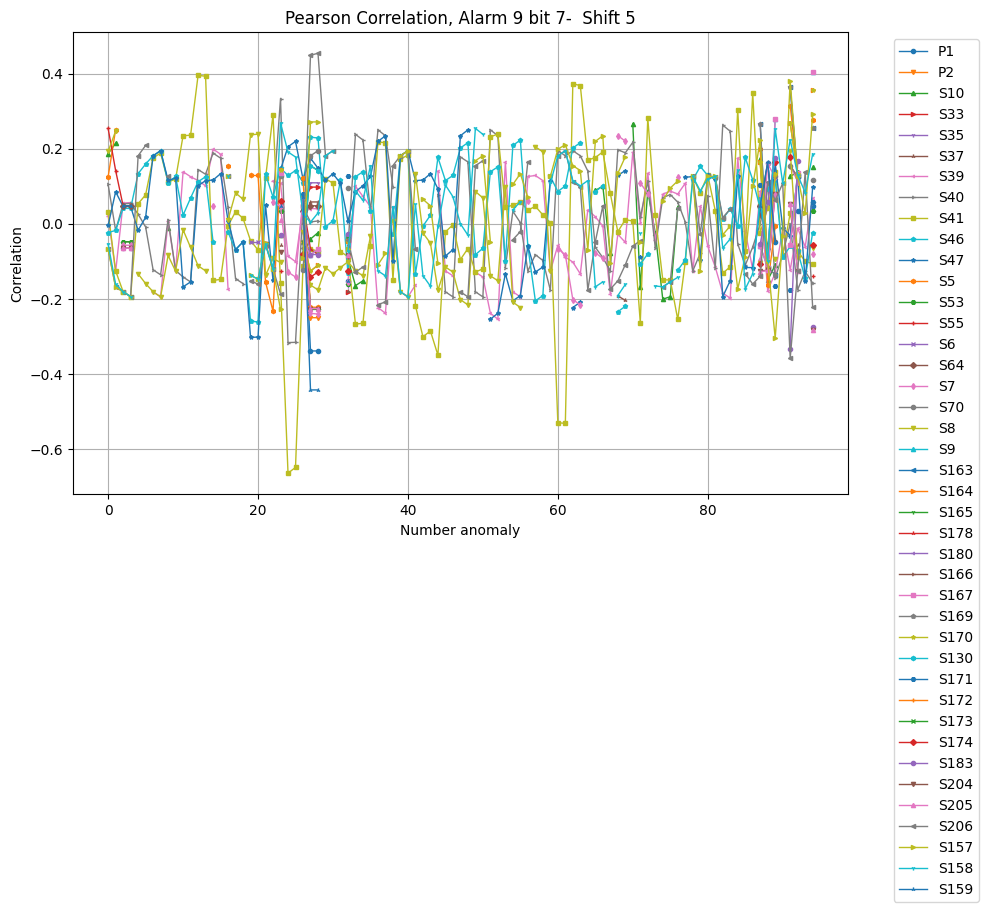

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


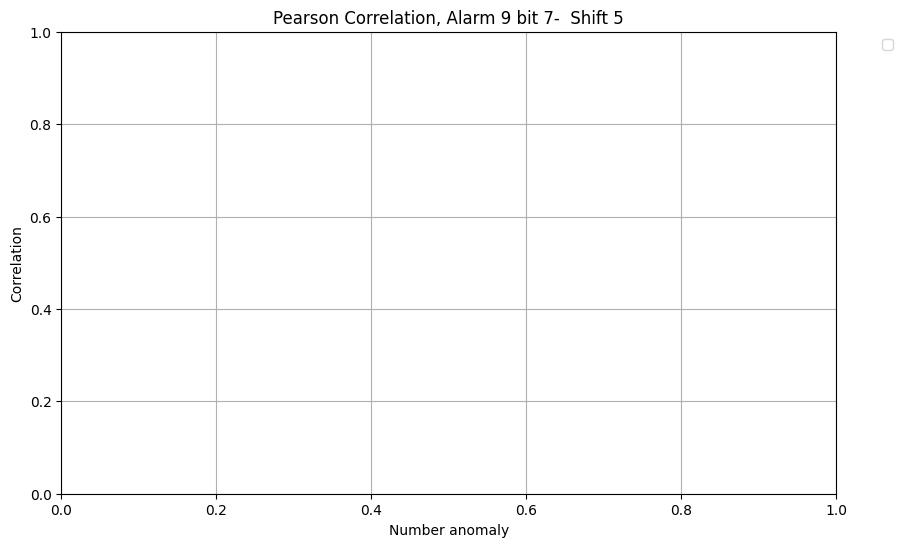

Plotting all non-NaN Spearman coefficients
43


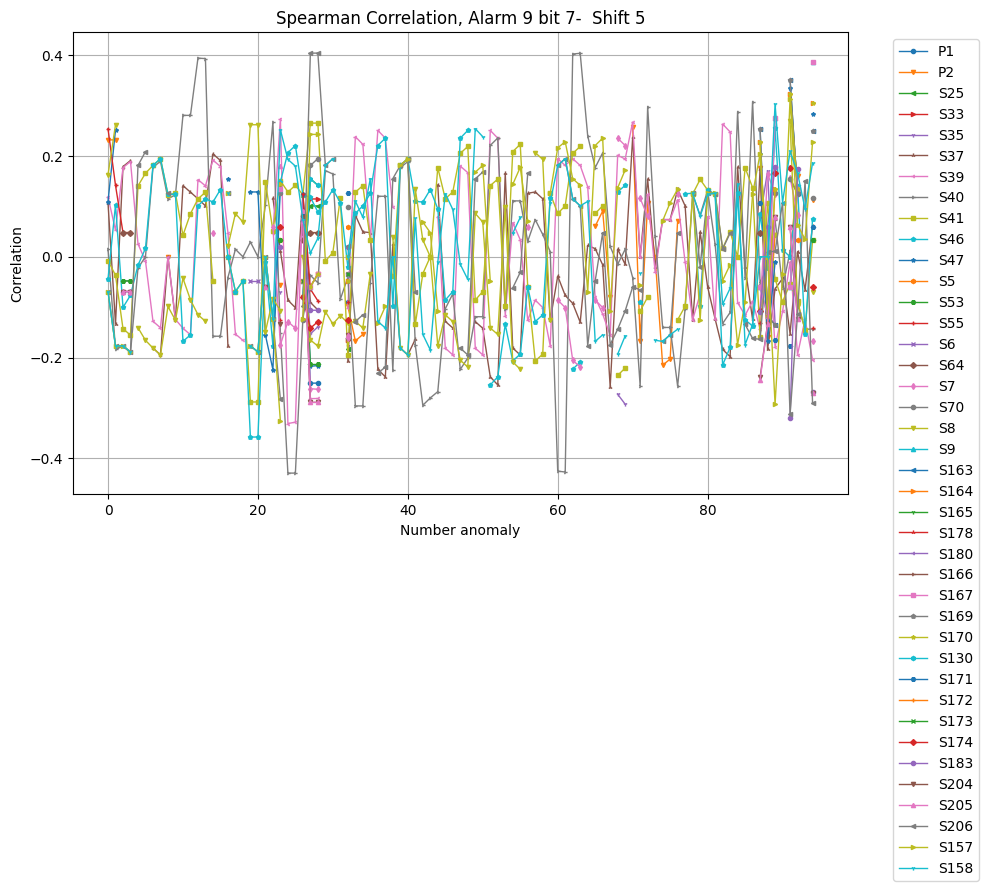

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


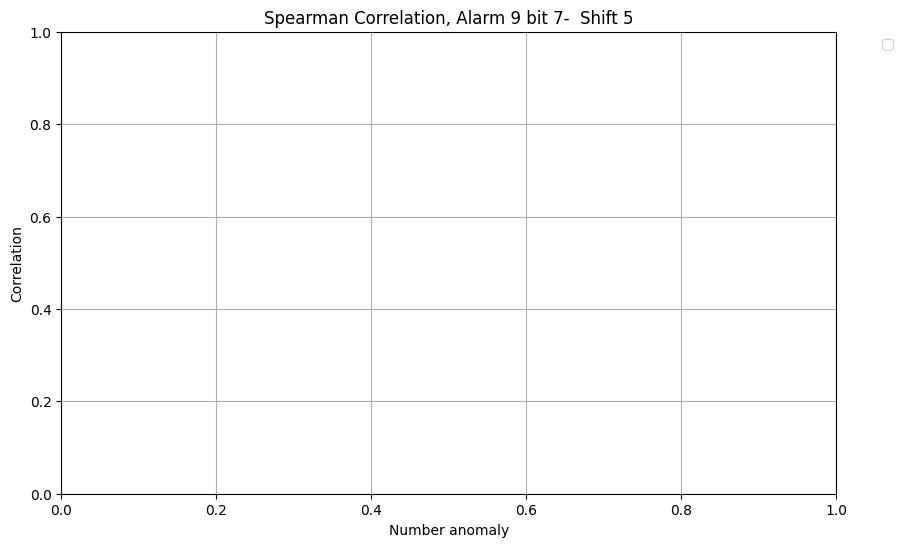

Plotting all non-NaN Pearson coefficients
43


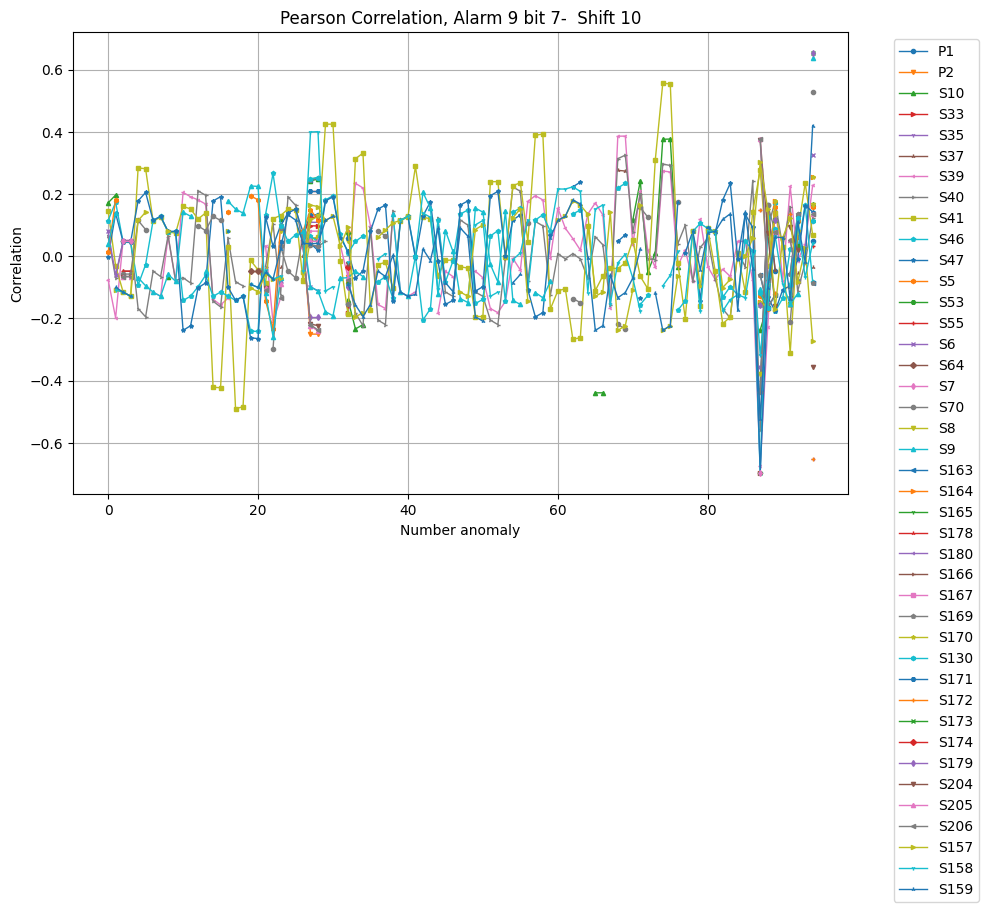

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


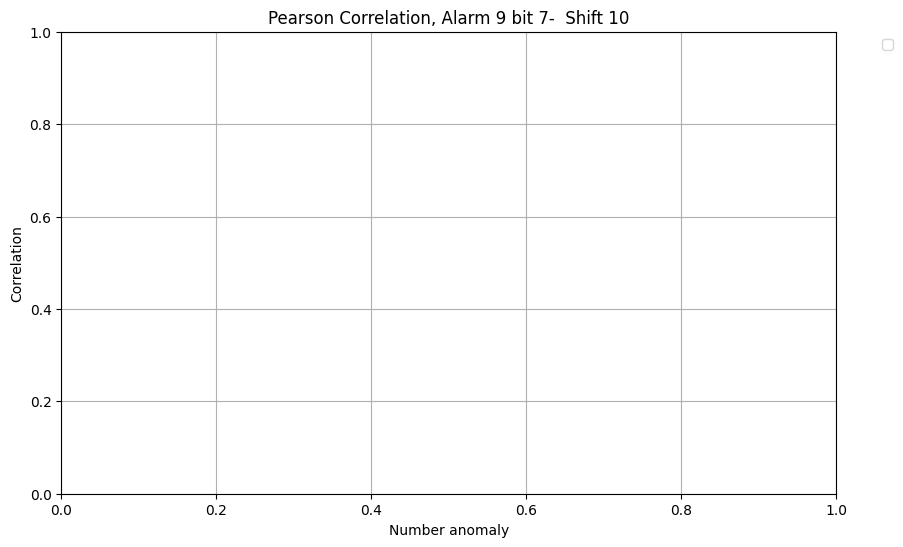

Plotting all non-NaN Spearman coefficients
43


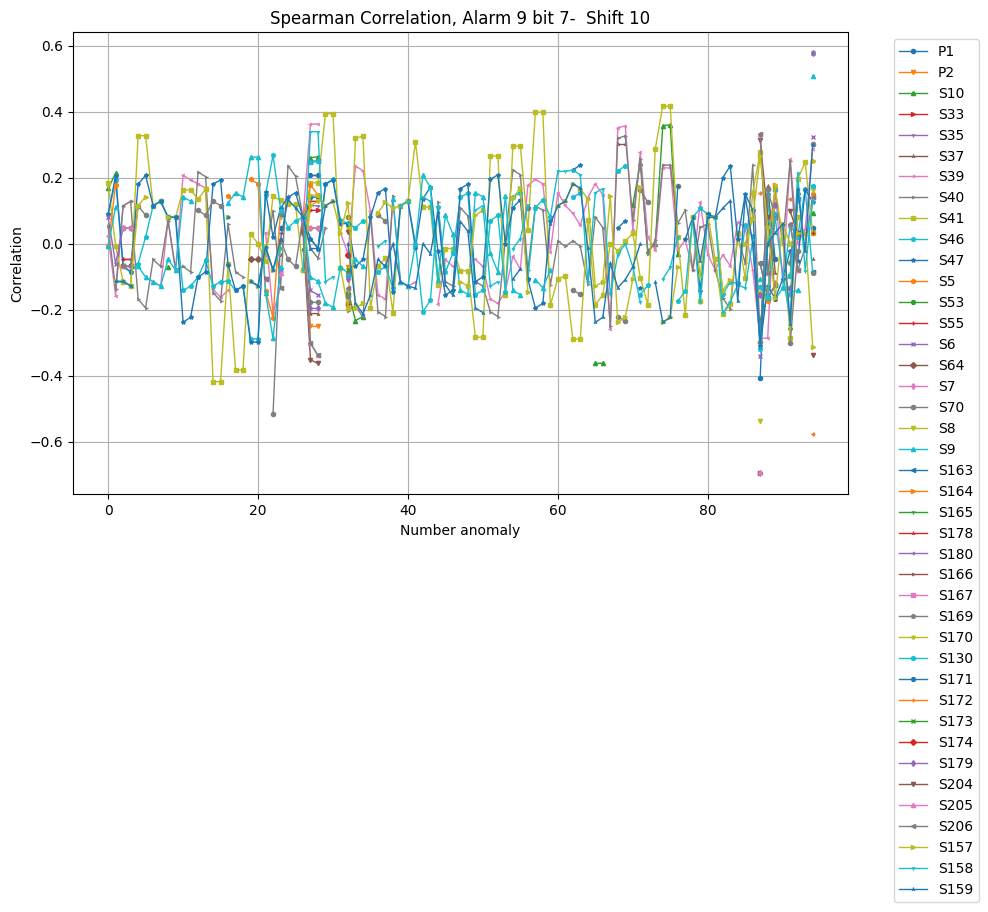

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


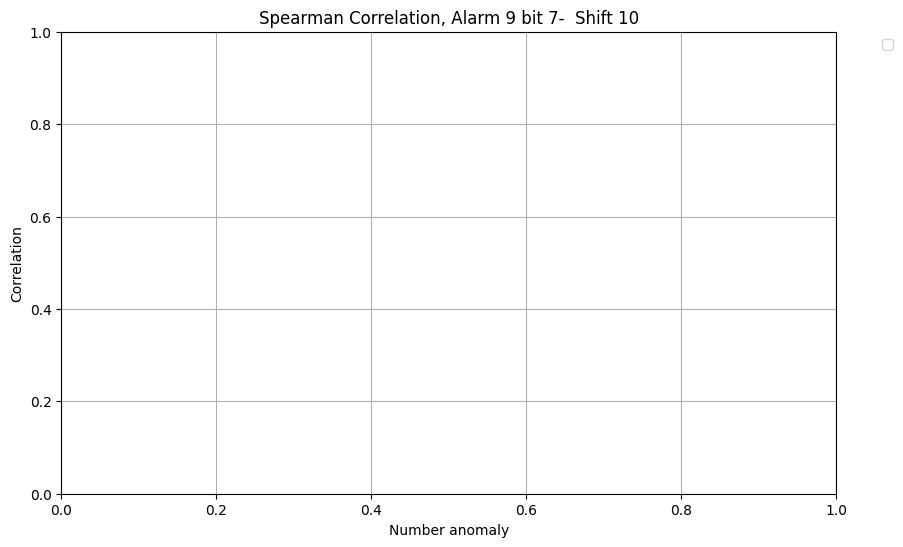

Plotting all non-NaN Pearson coefficients
43


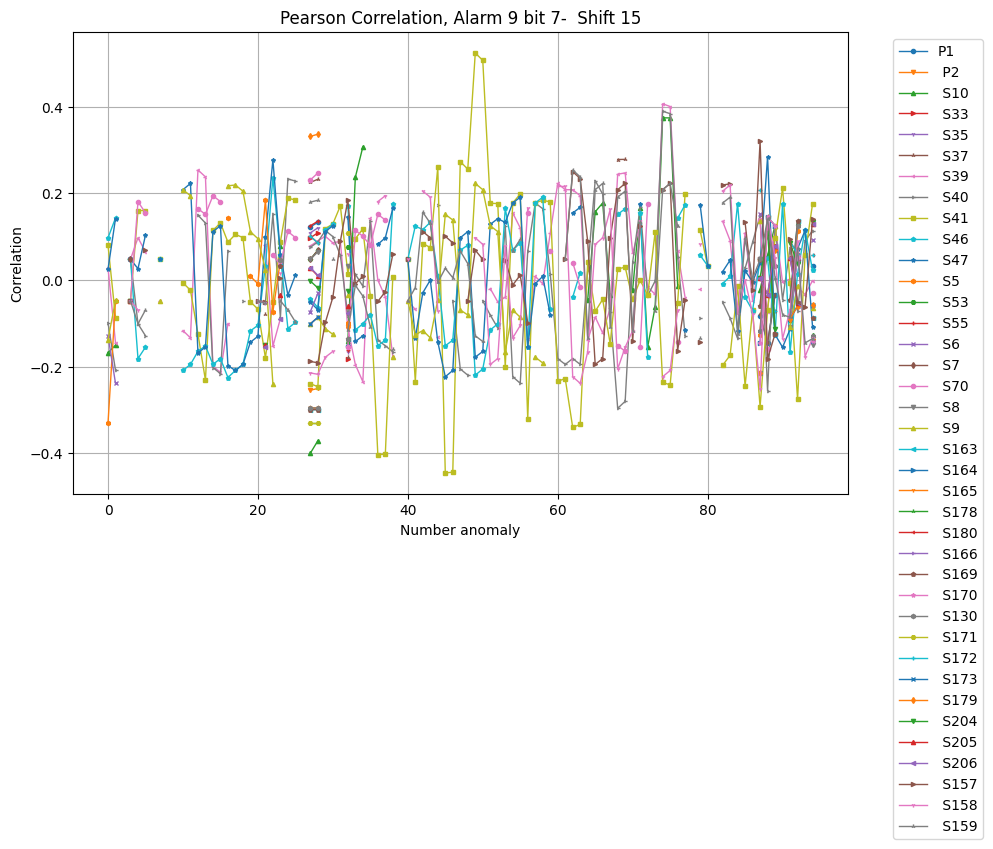

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


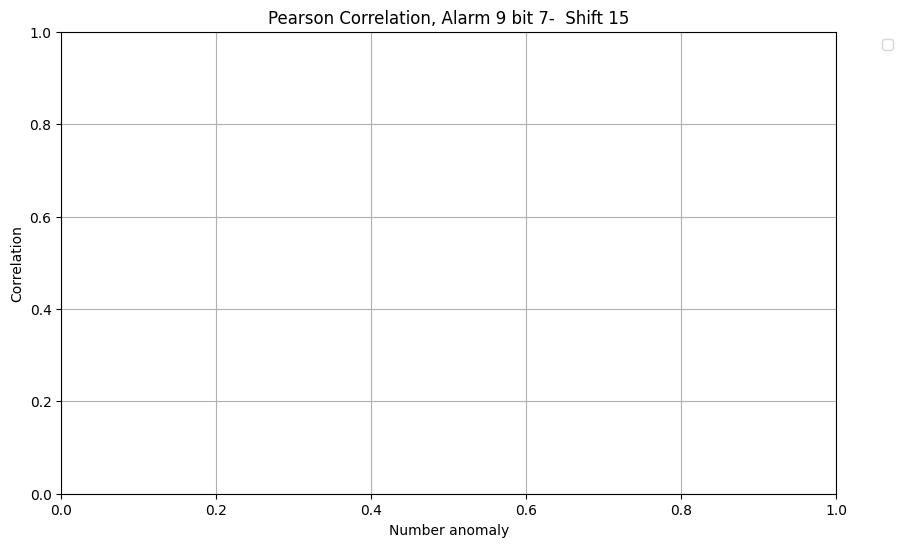

Plotting all non-NaN Spearman coefficients
43


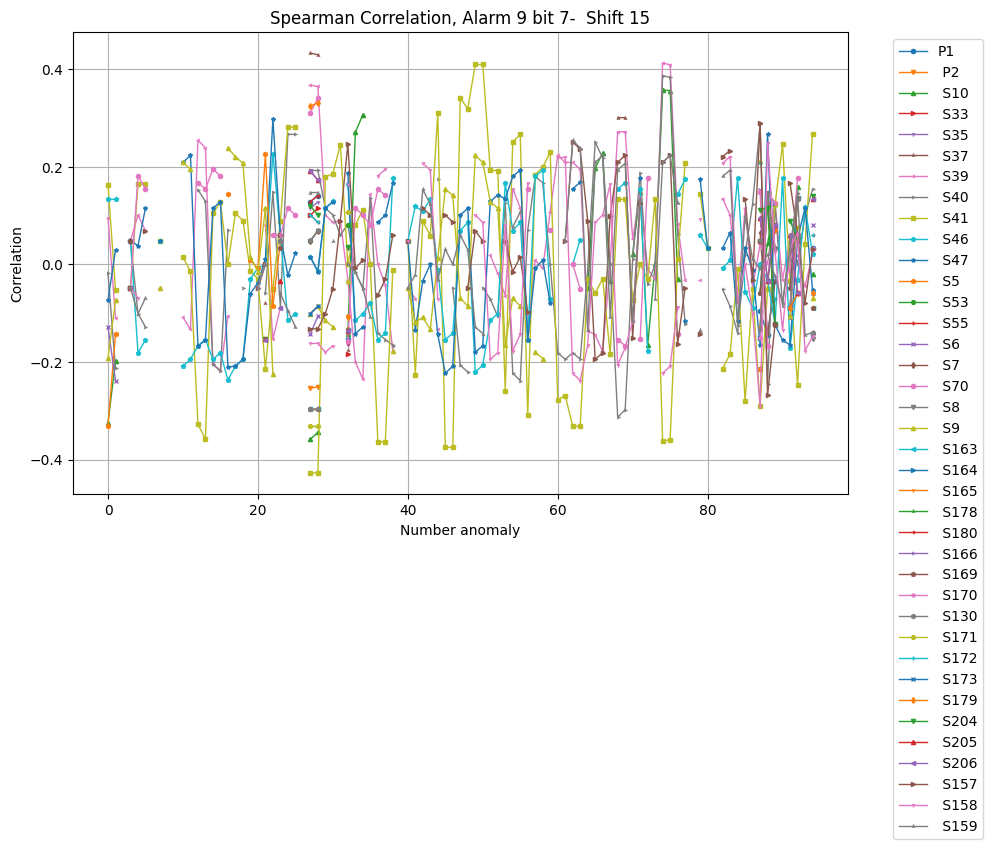

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


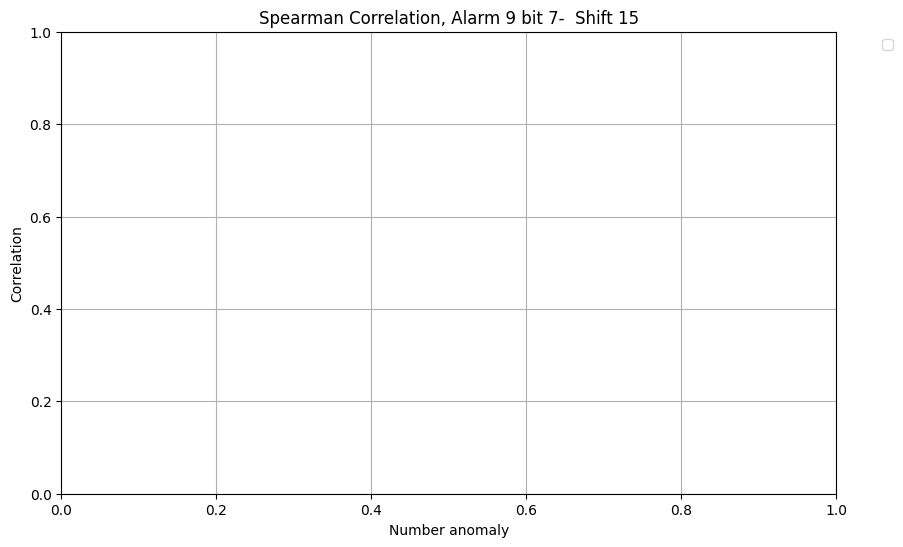

Plotting all non-NaN Pearson coefficients
43


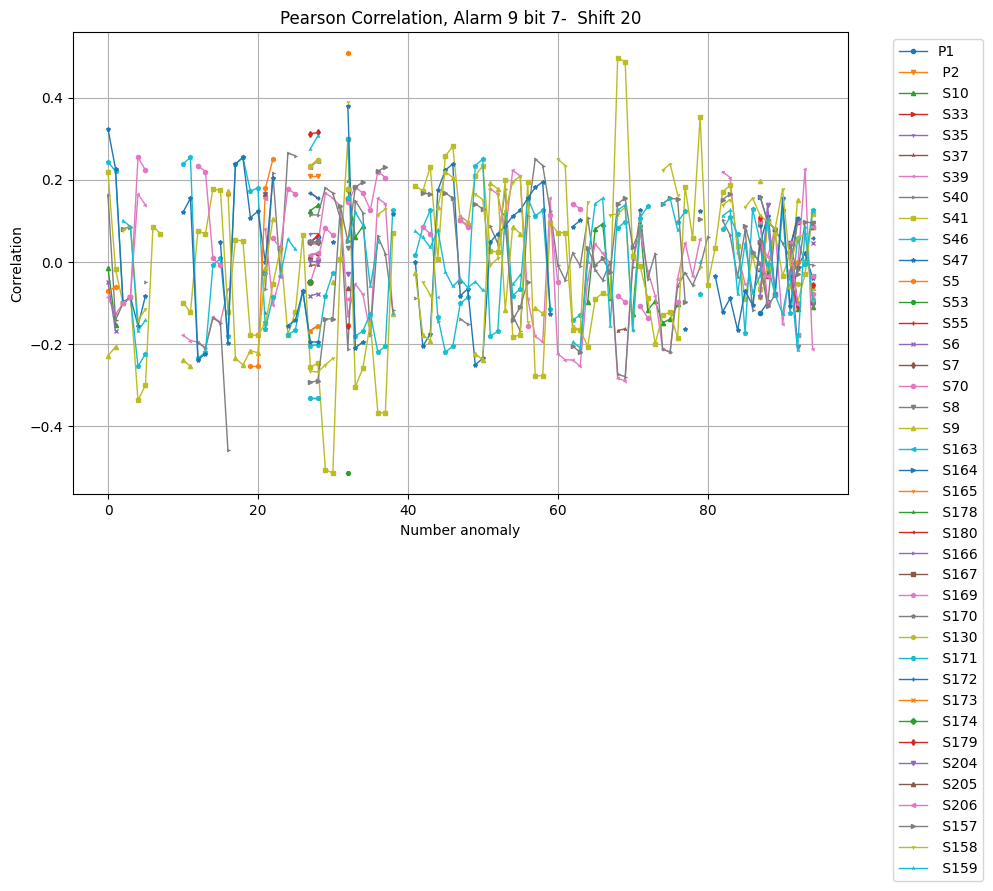

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


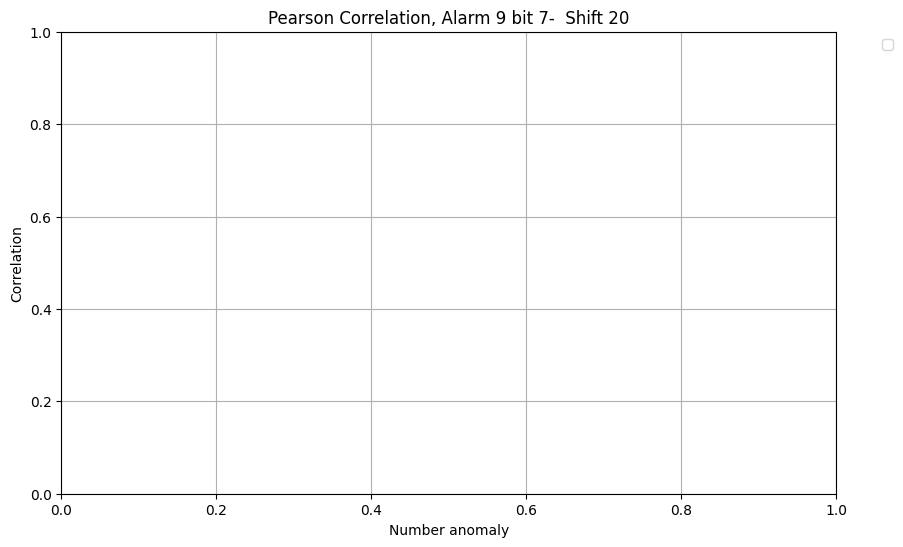

Plotting all non-NaN Spearman coefficients
43


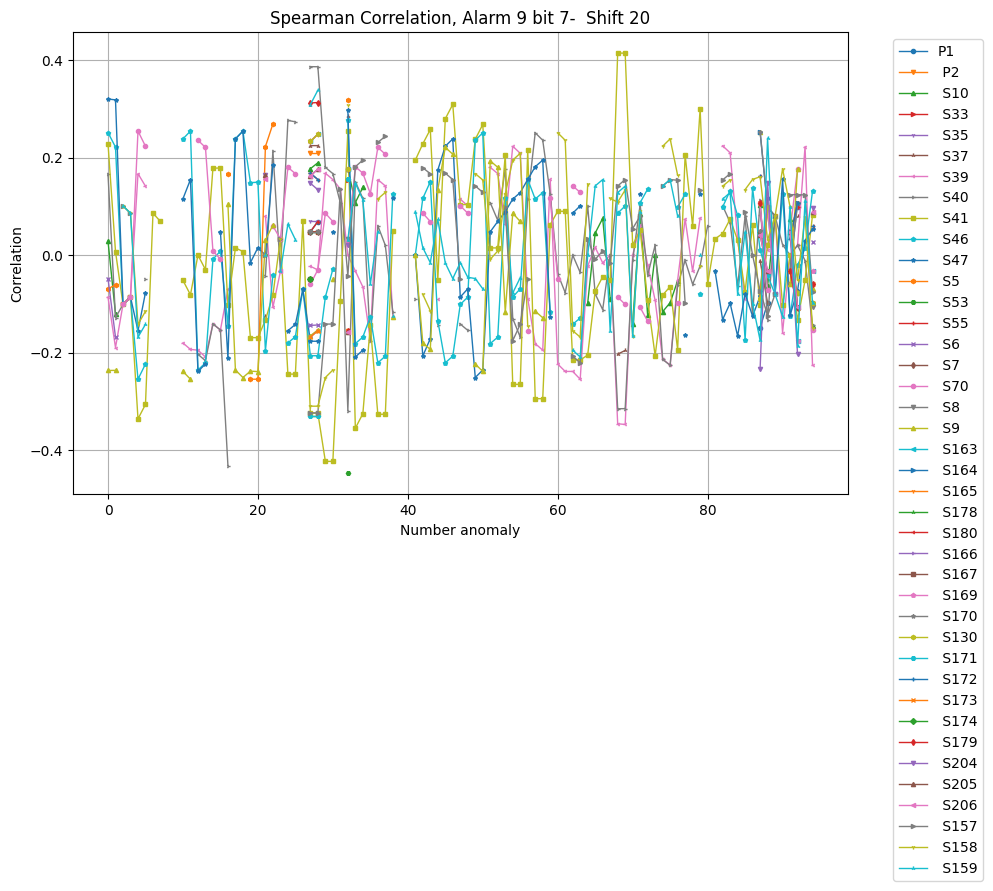

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


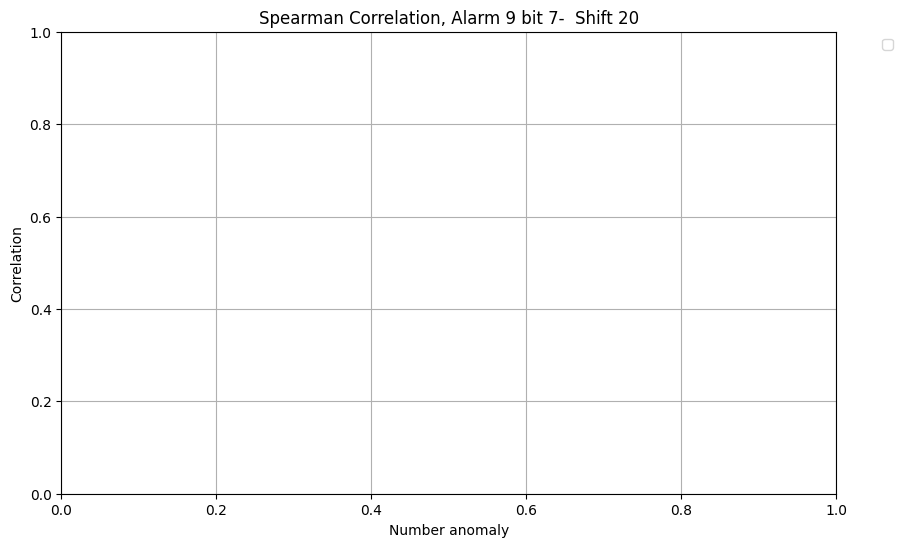

Plotting all non-NaN Pearson coefficients
43


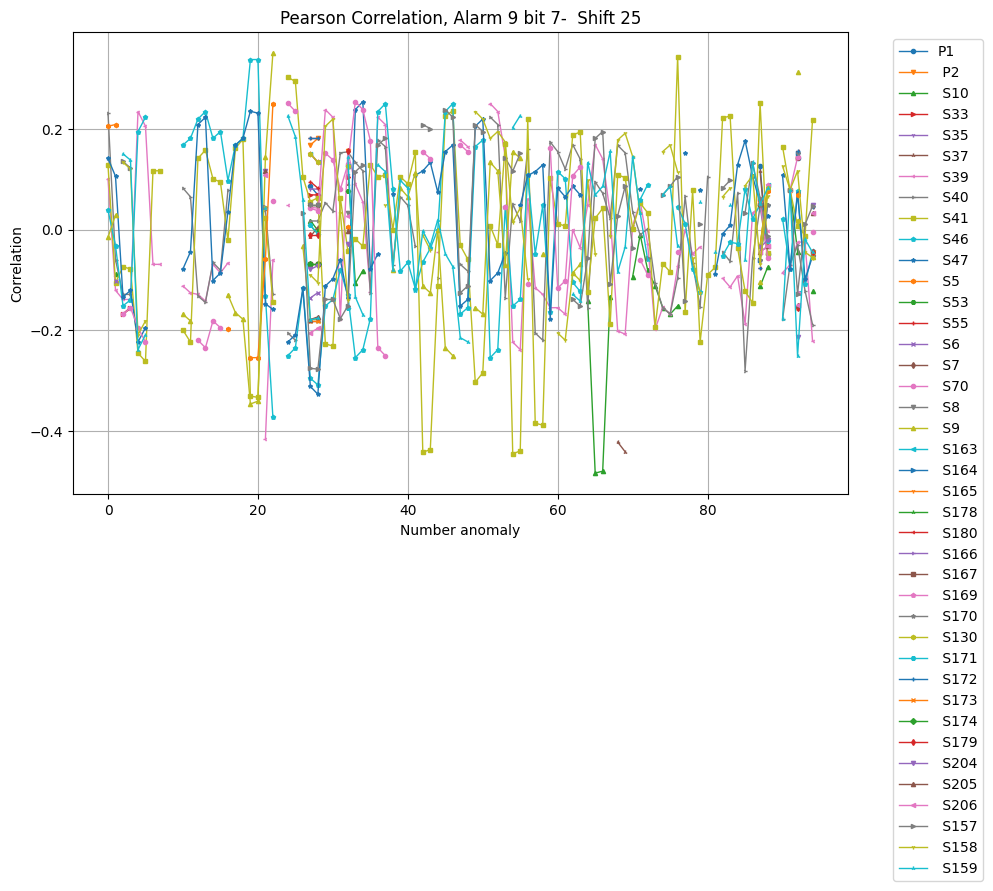

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


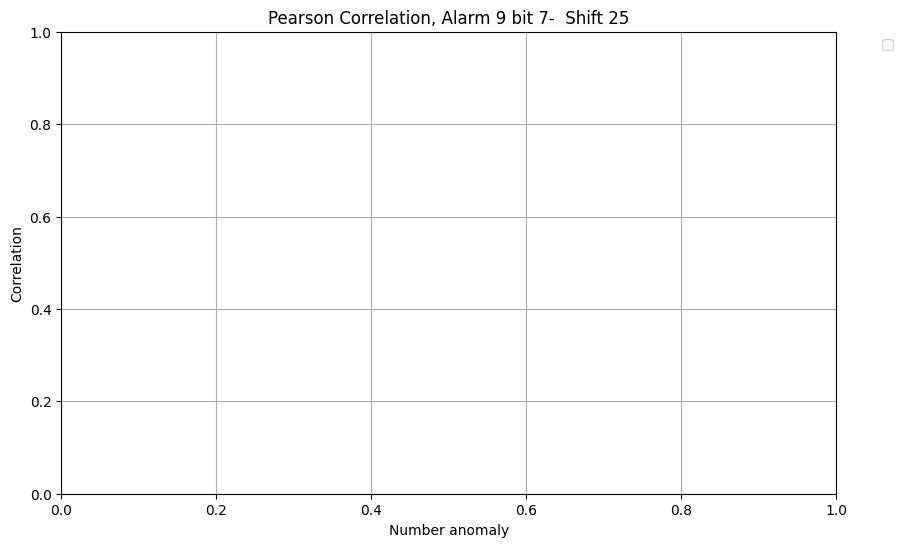

Plotting all non-NaN Spearman coefficients
43


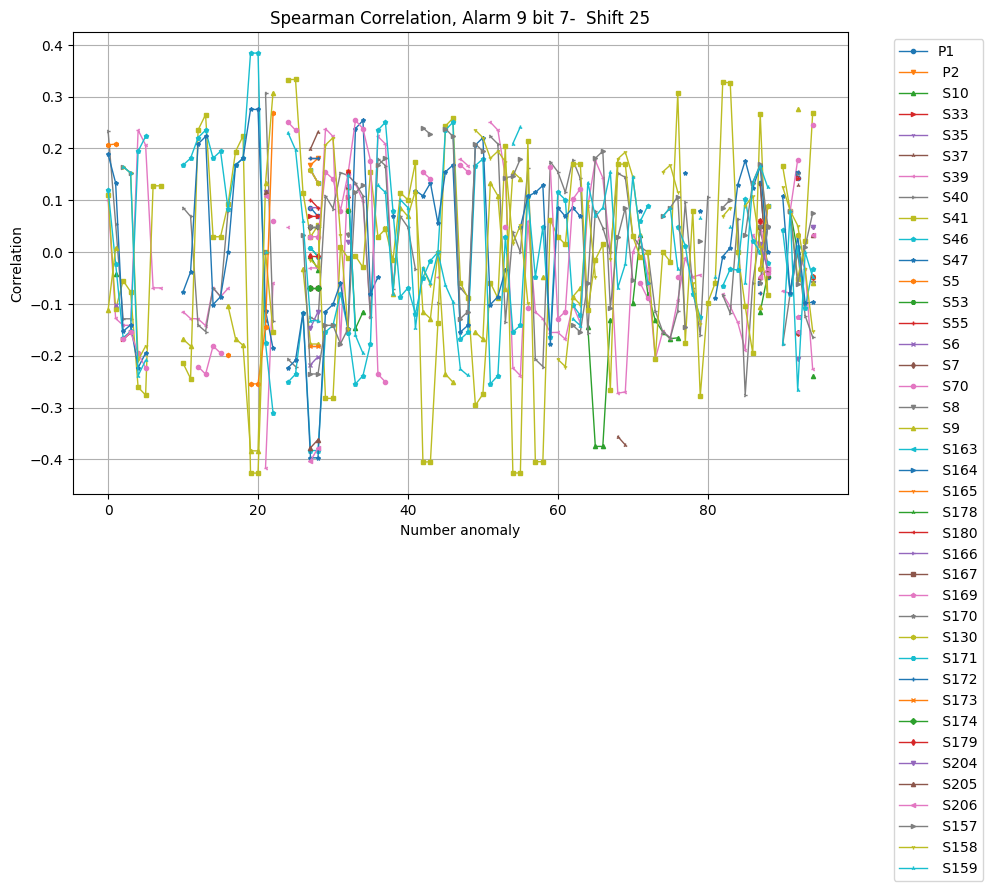

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


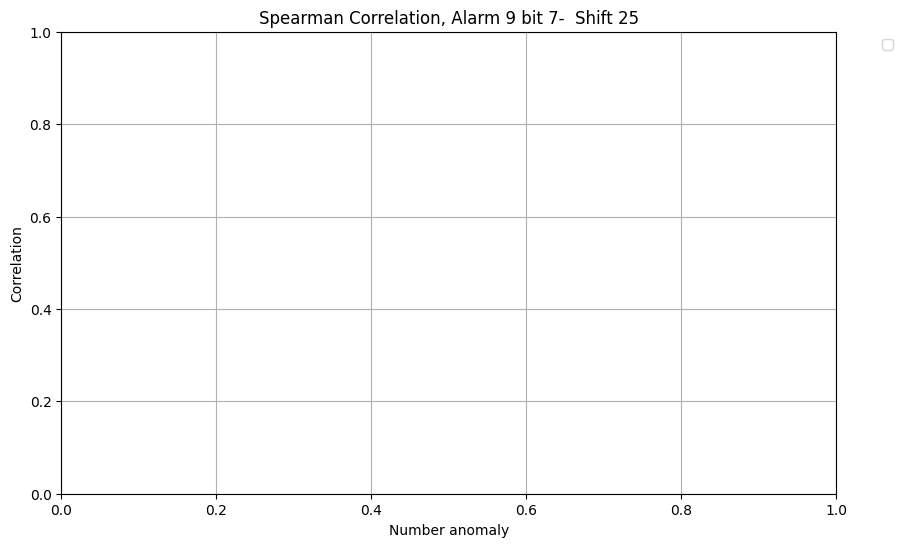

Plotting all non-NaN Pearson coefficients
43


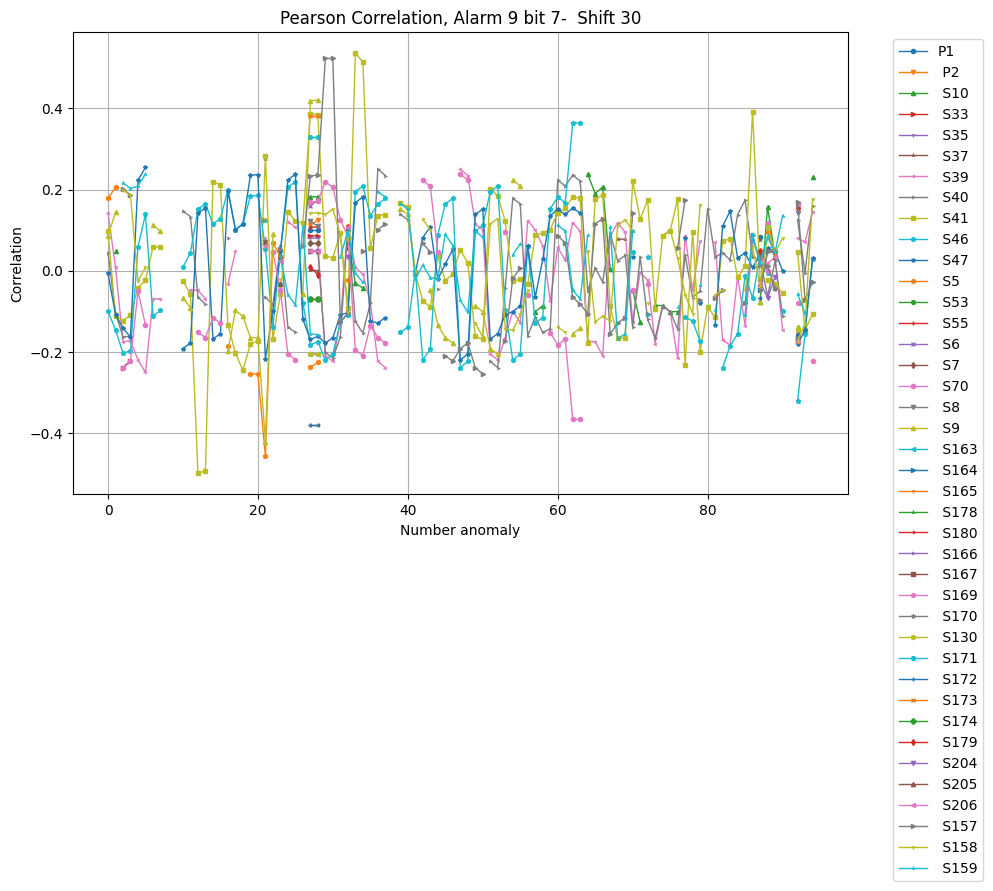

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


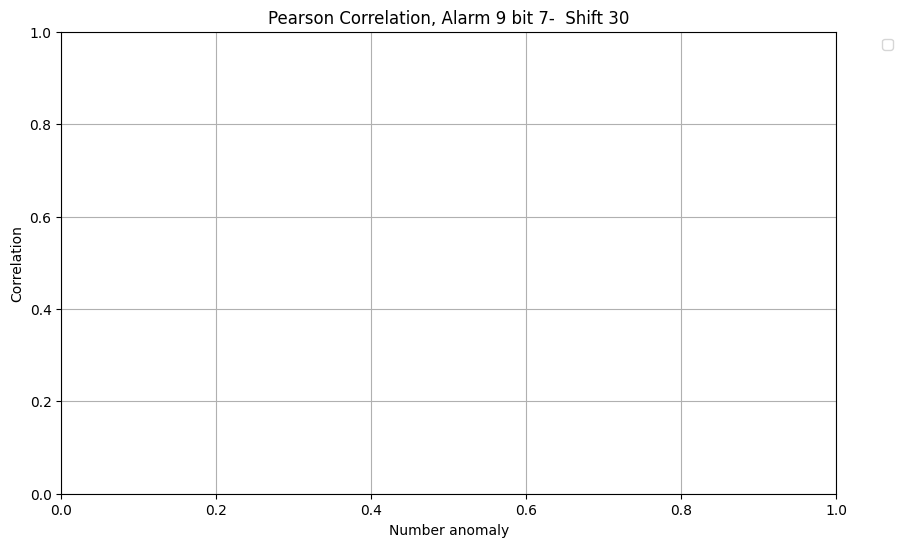

Plotting all non-NaN Spearman coefficients
43


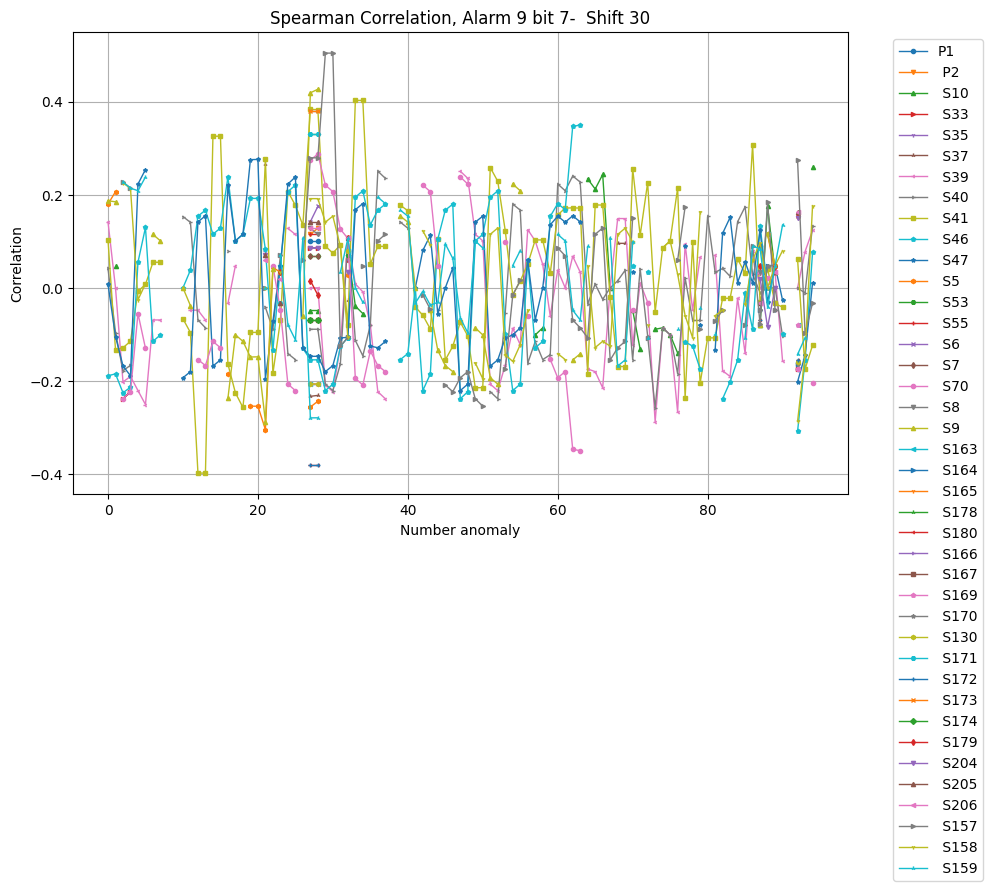

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


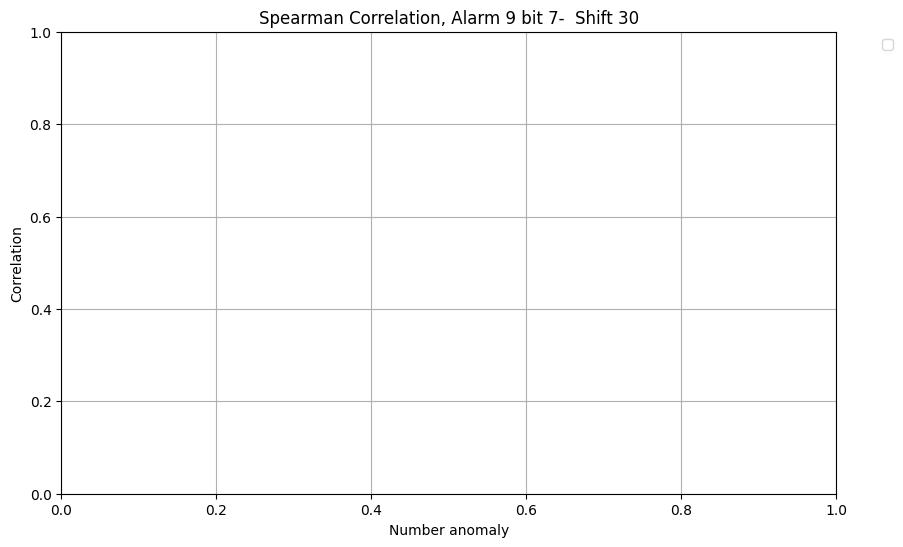

In [9]:
for shift in shifts:

    text1=col_names[1]
    text2=f'Shift {shift}'

    file_path= f'./{columns[1]}_shift{shift}_correlations.txt'

    print(f'Plotting all non-NaN Pearson coefficients')
    aux.read_and_plot(file_path,'Pearson',text1,text2)
    print(f'Plotting Pearson coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Pearson',text1,text2,avg_lim=limit_value)
    print(f'Plotting all non-NaN Spearman coefficients')
    aux.read_and_plot(file_path,'Spearman',text1,text2)
    print(f'Plotting Spearman coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Spearman',text1,text2,avg_lim=limit_value)

Plotting all non-NaN Pearson coefficients
43


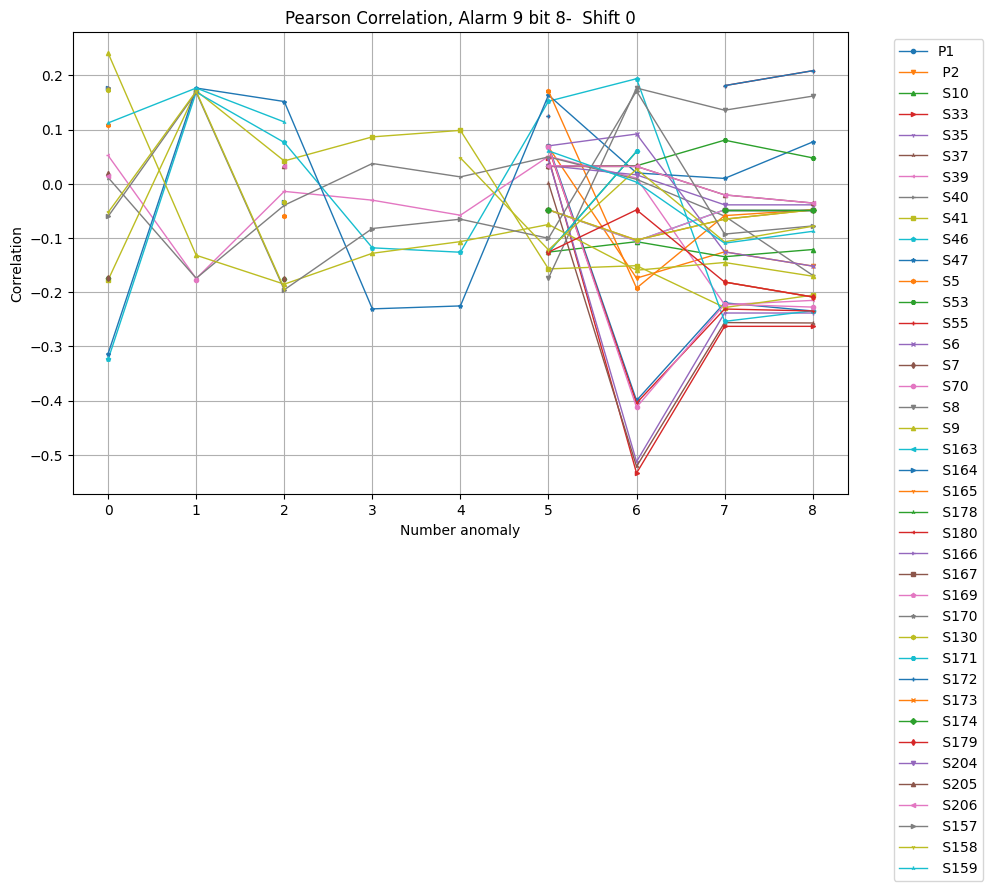

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


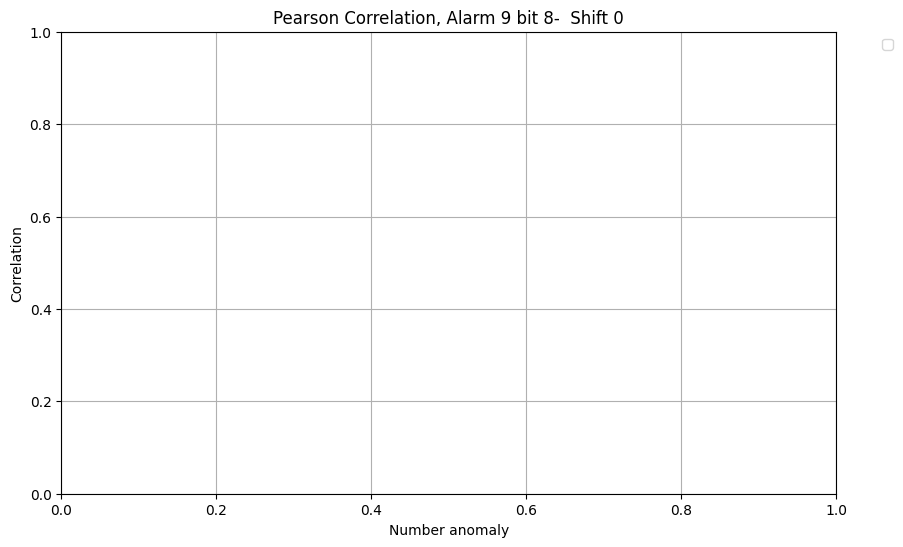

Plotting all non-NaN Spearman coefficients
43


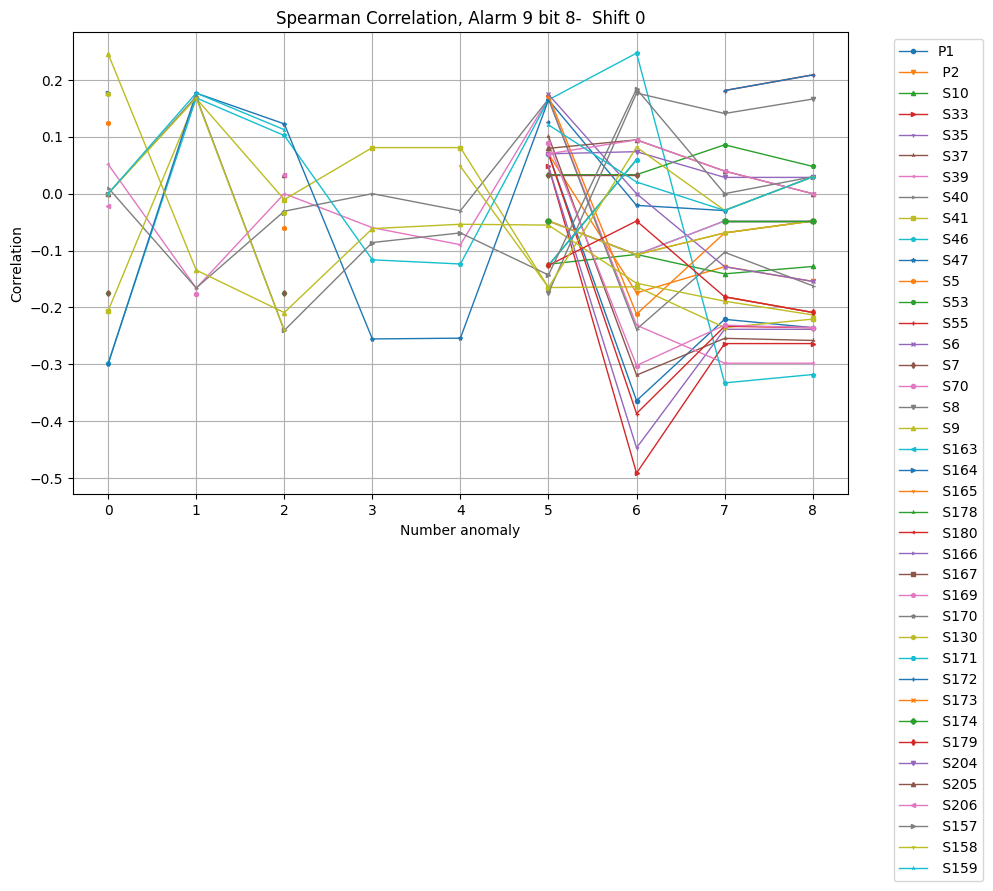

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


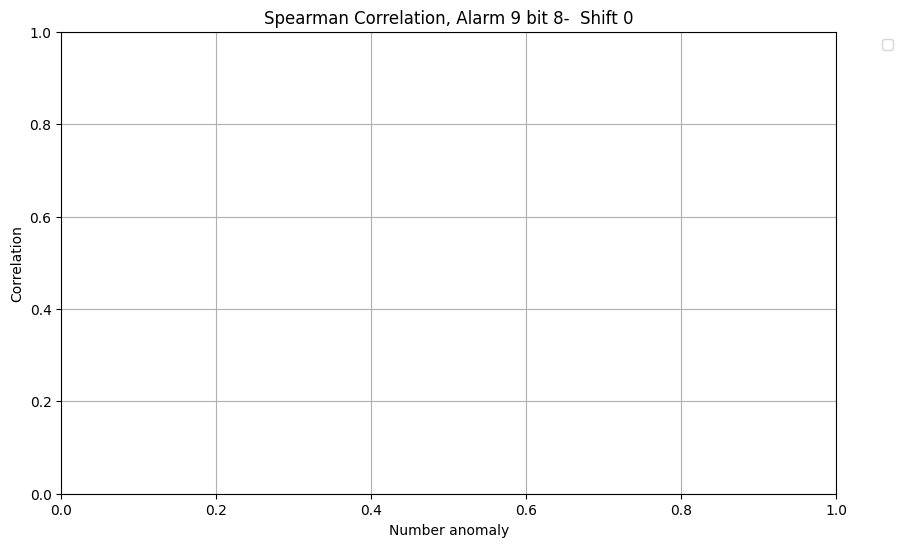

Plotting all non-NaN Pearson coefficients
43


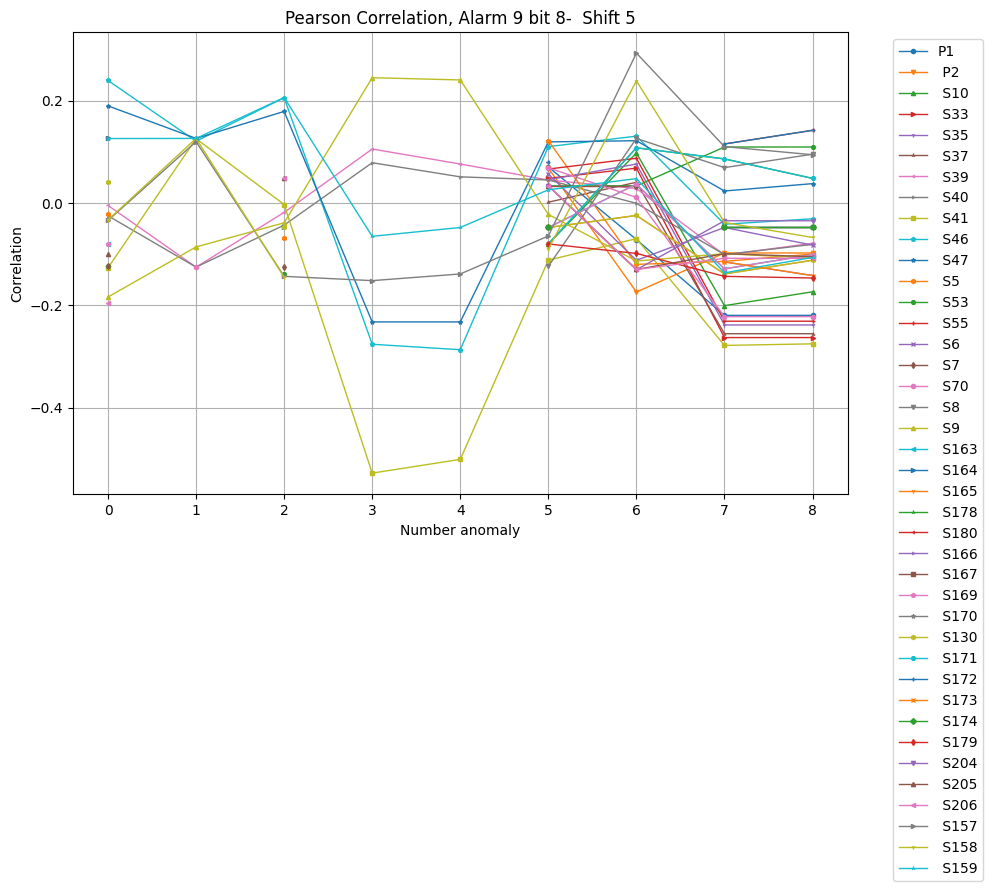

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


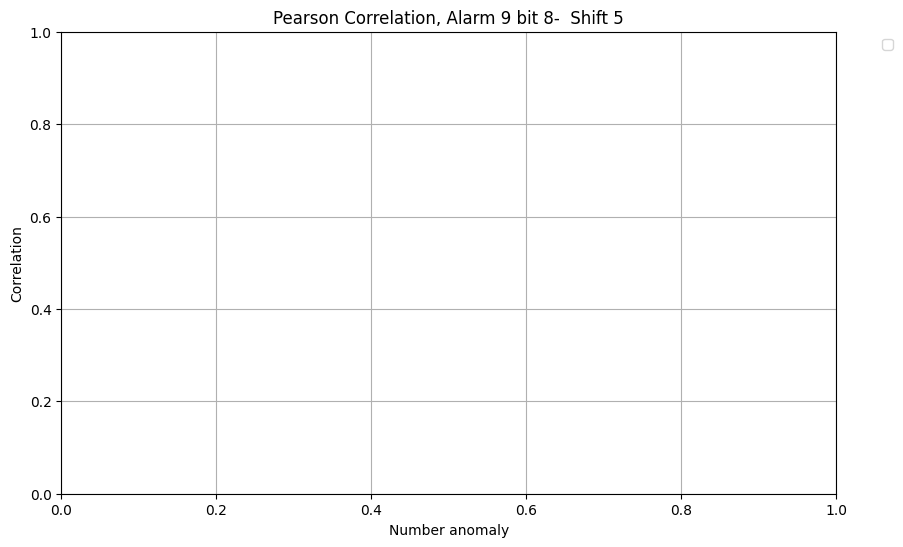

Plotting all non-NaN Spearman coefficients
43


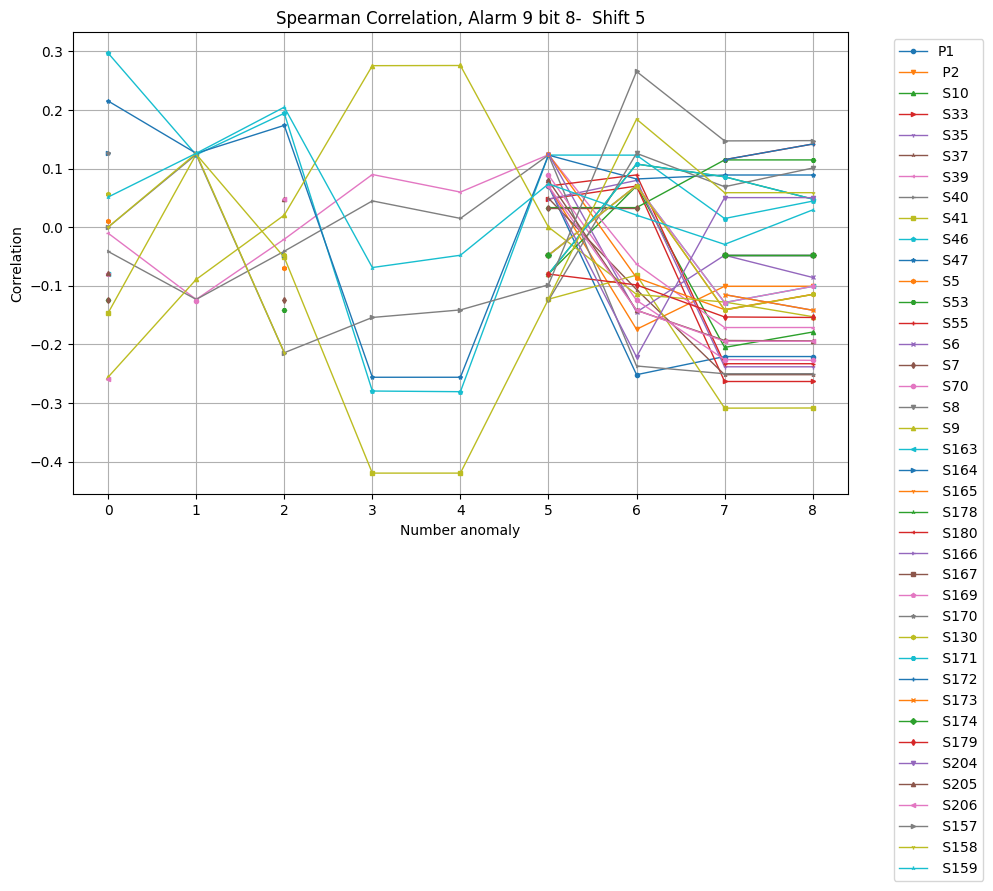

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


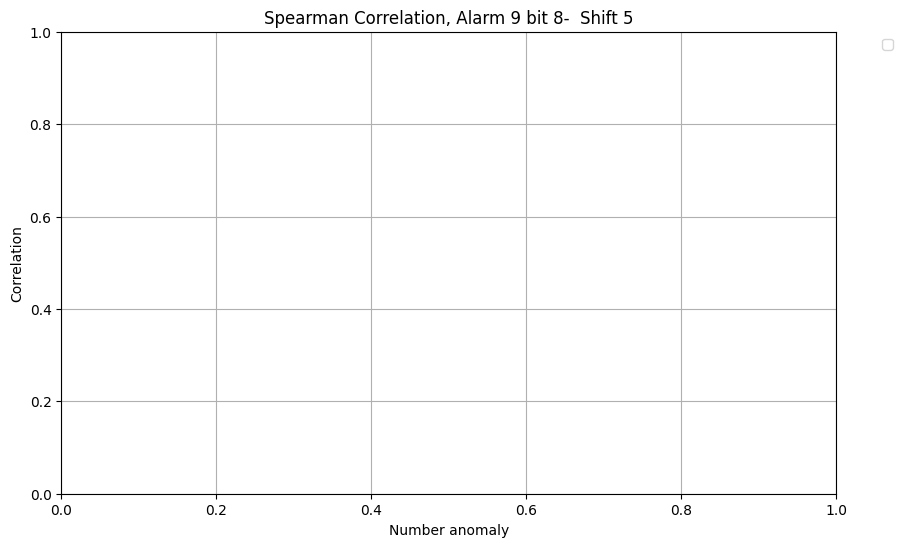

Plotting all non-NaN Pearson coefficients
43


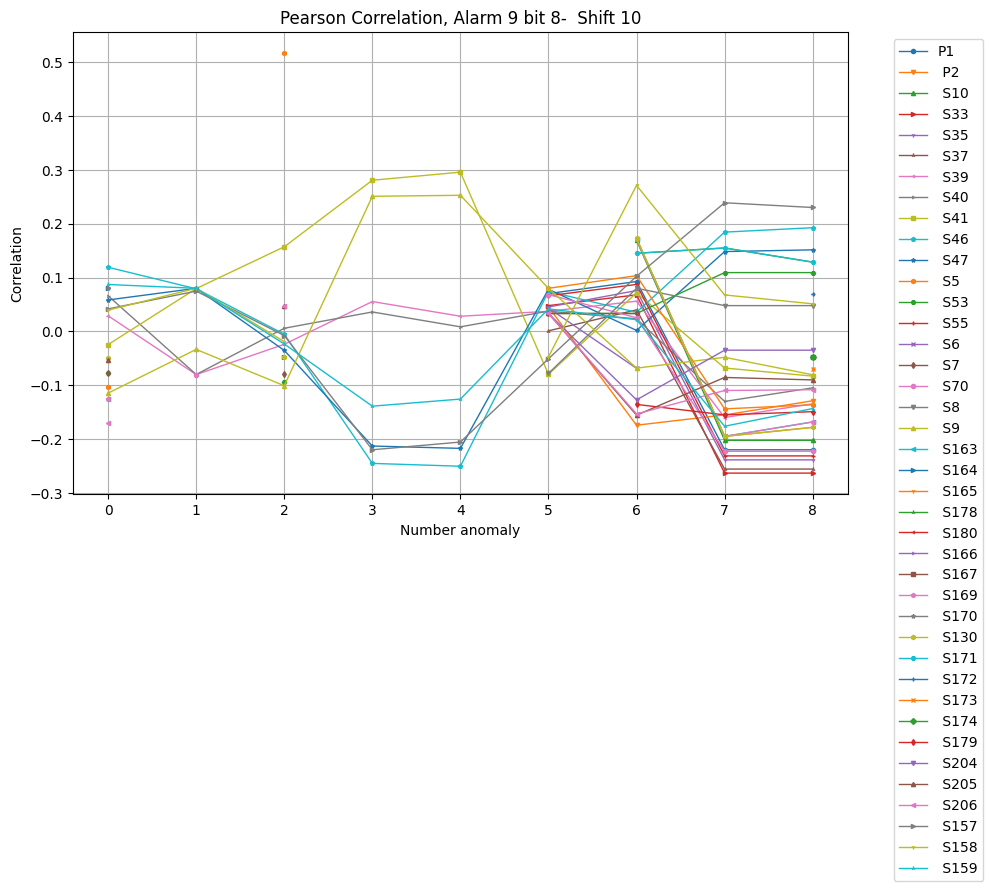

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


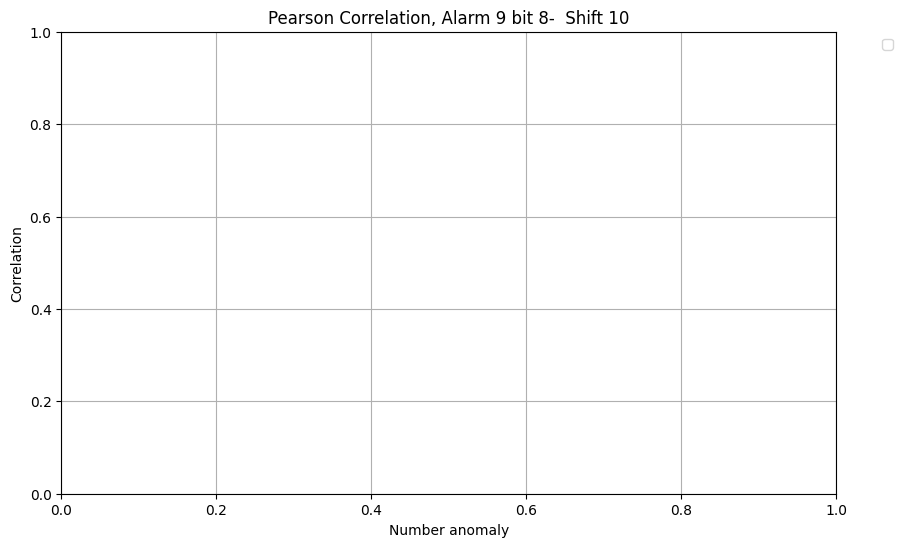

Plotting all non-NaN Spearman coefficients
43


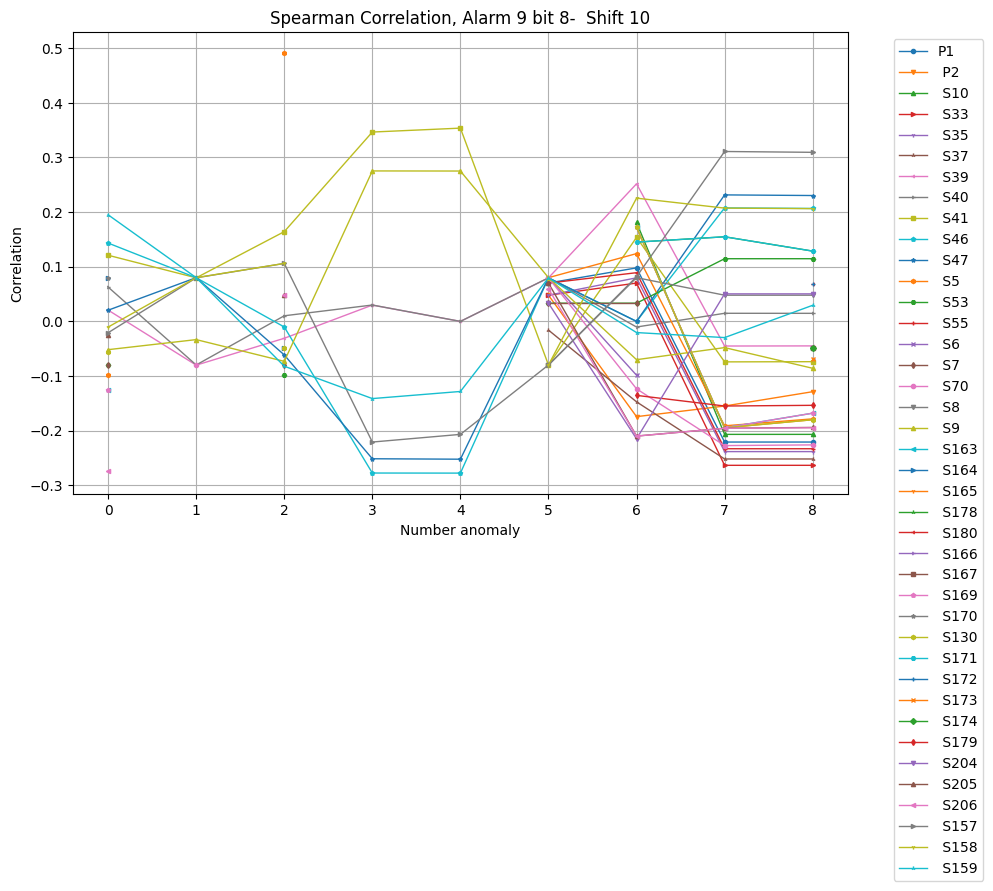

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


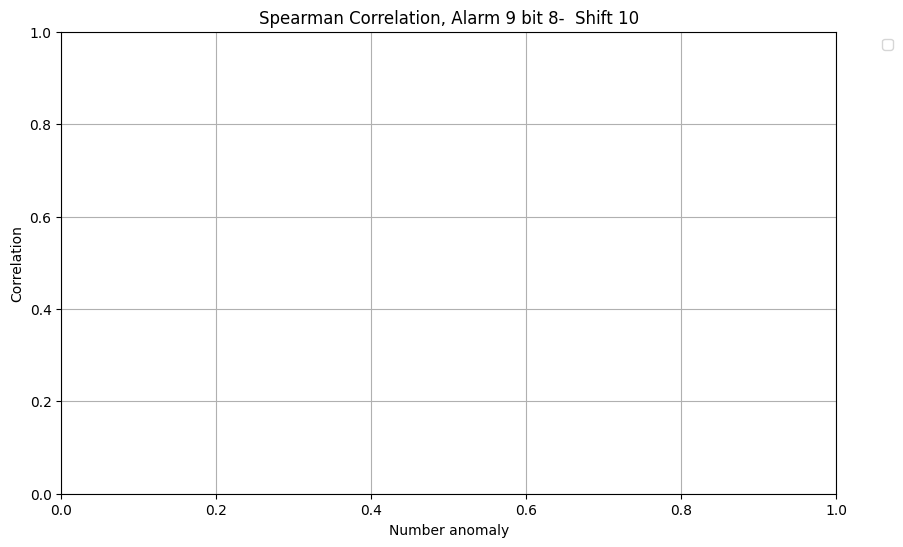

Plotting all non-NaN Pearson coefficients
43


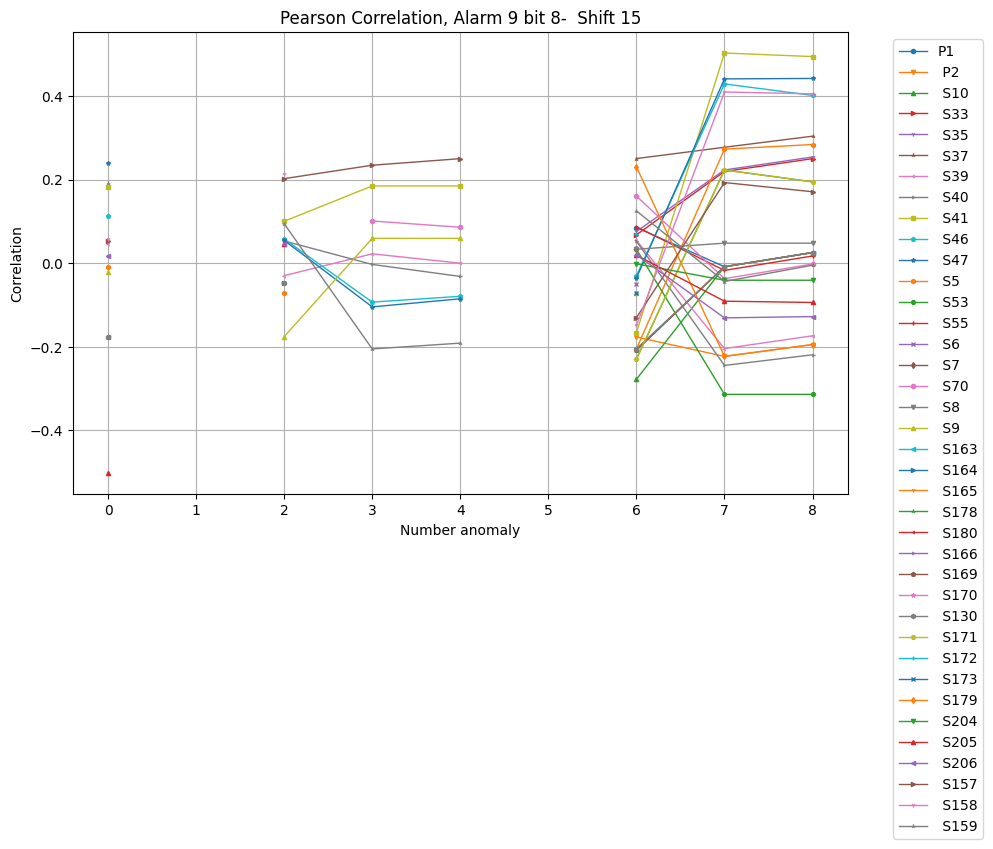

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


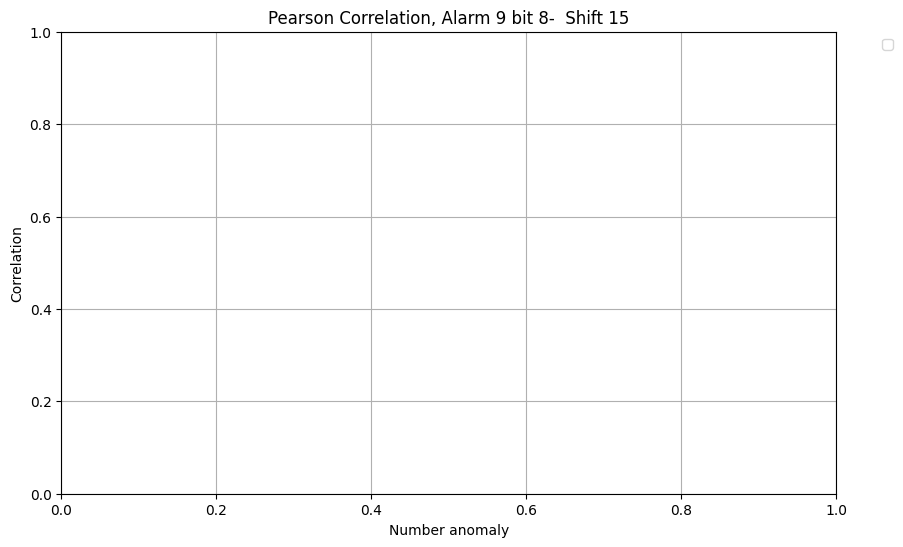

Plotting all non-NaN Spearman coefficients
43


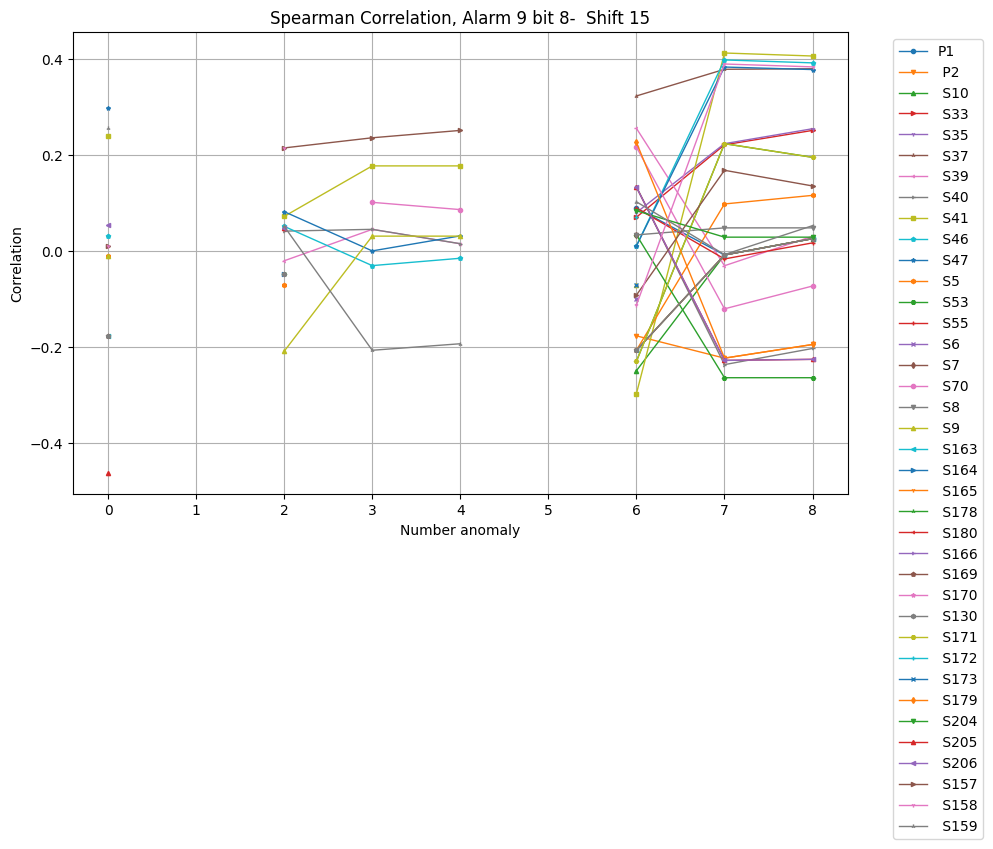

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


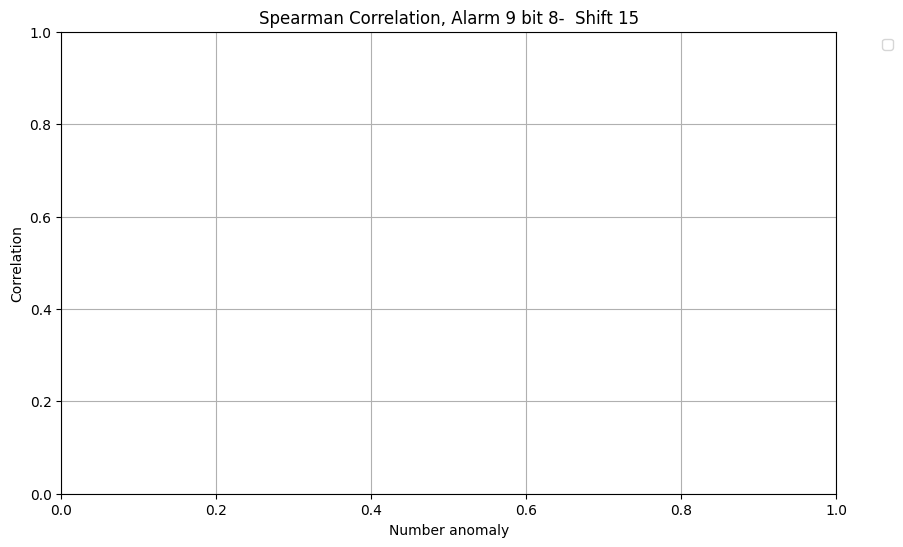

Plotting all non-NaN Pearson coefficients
43


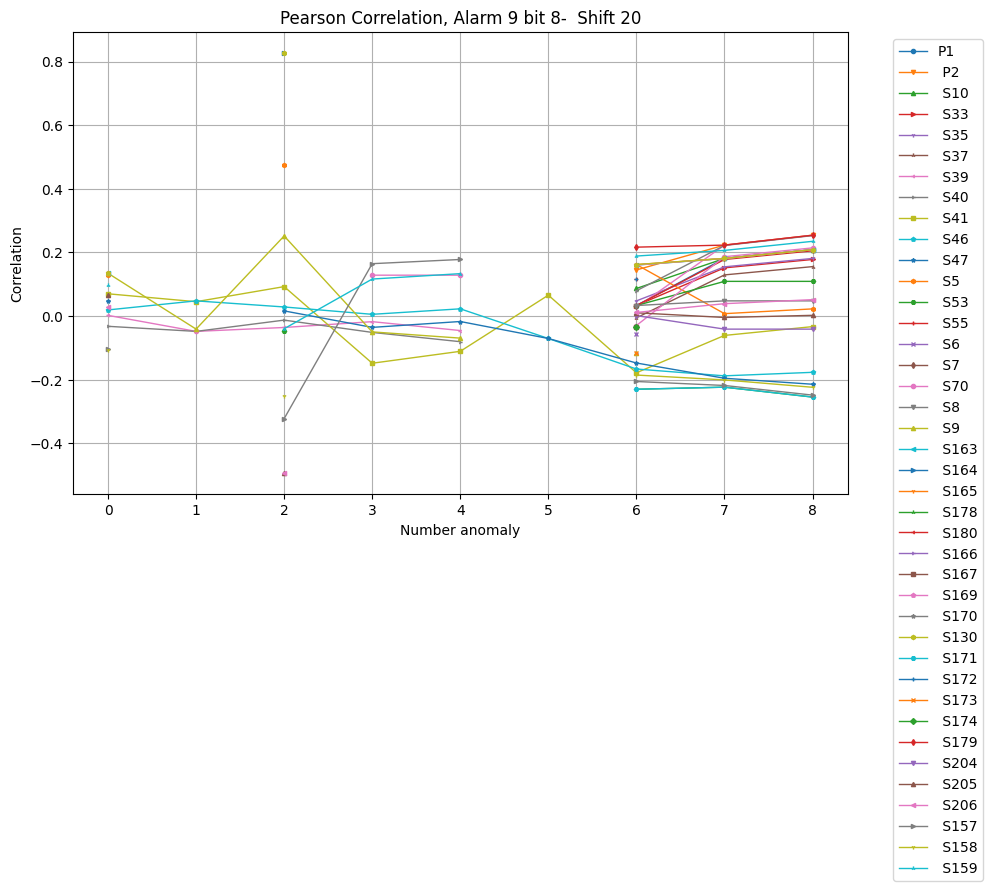

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


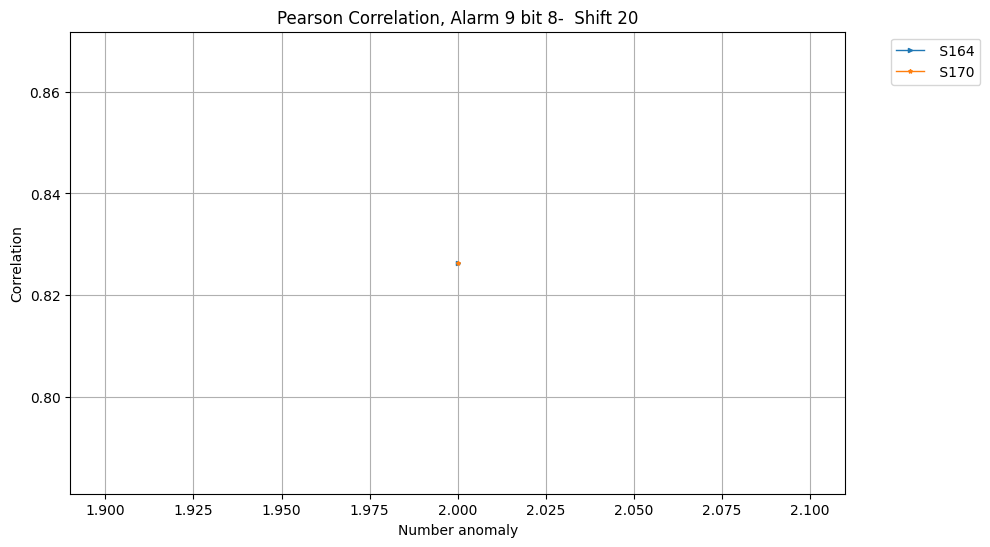

Plotting all non-NaN Spearman coefficients
43


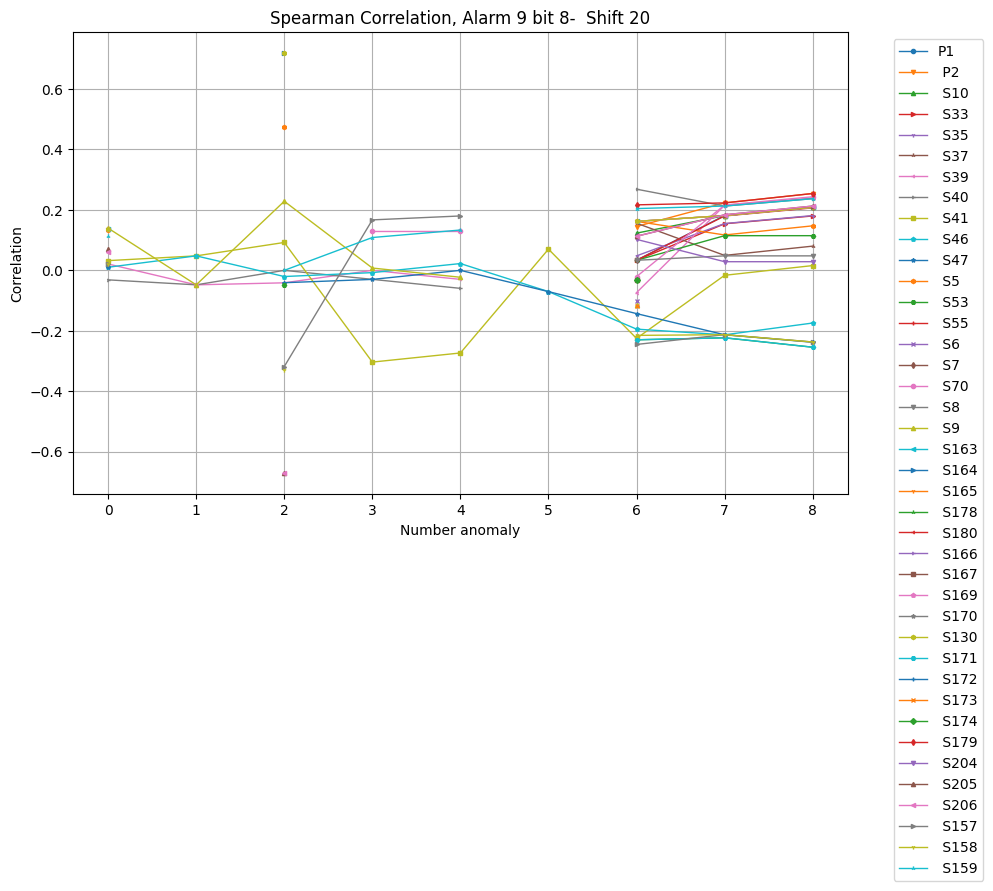

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


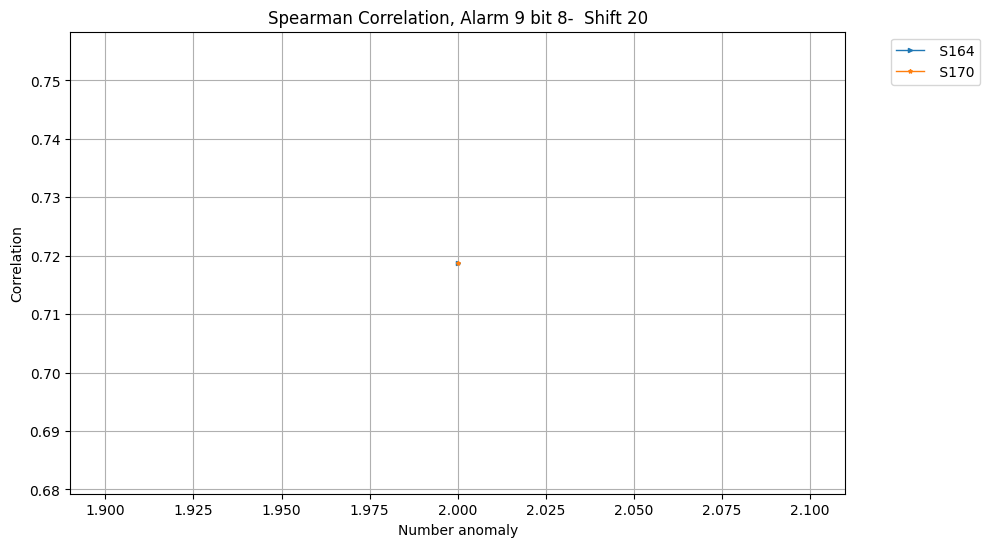

Plotting all non-NaN Pearson coefficients
43


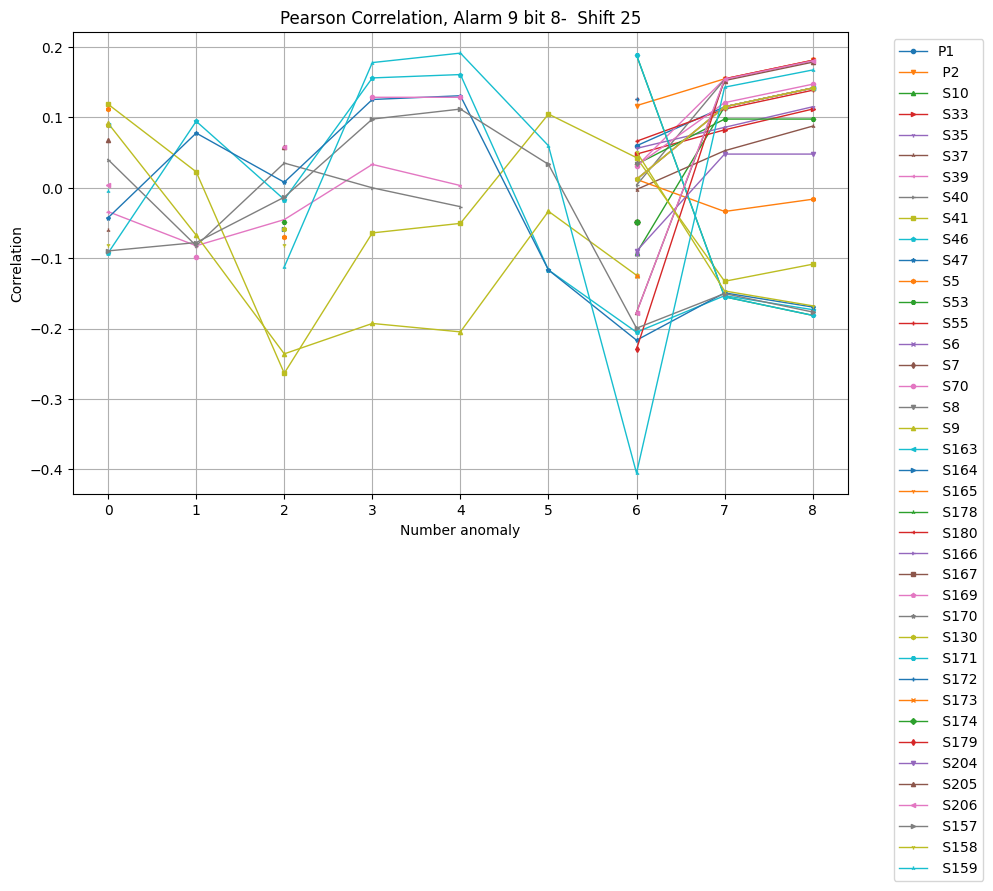

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


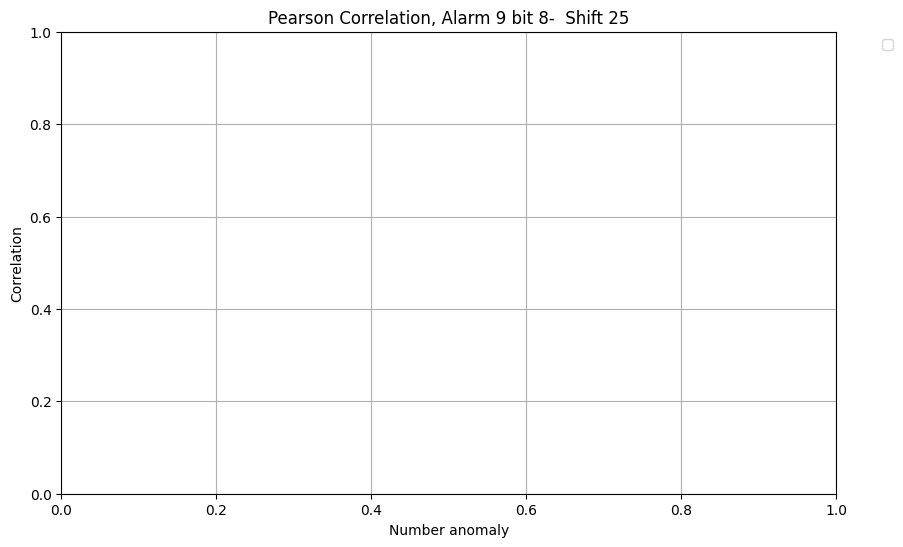

Plotting all non-NaN Spearman coefficients
43


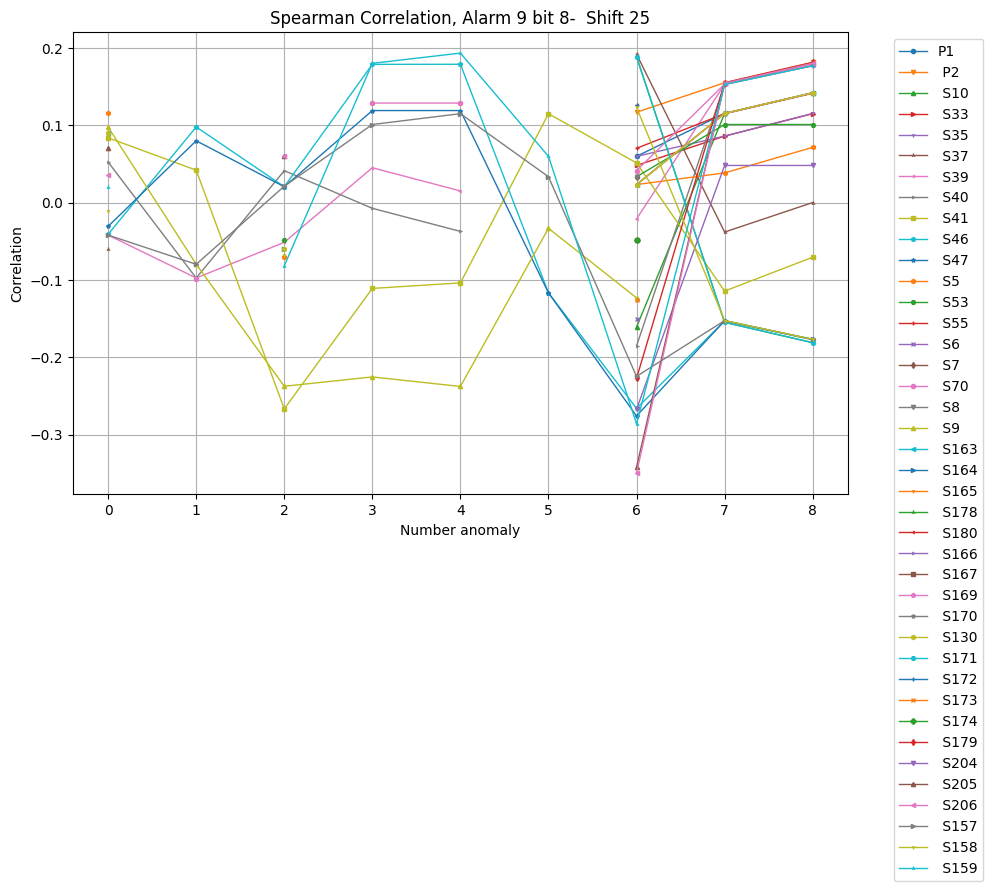

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


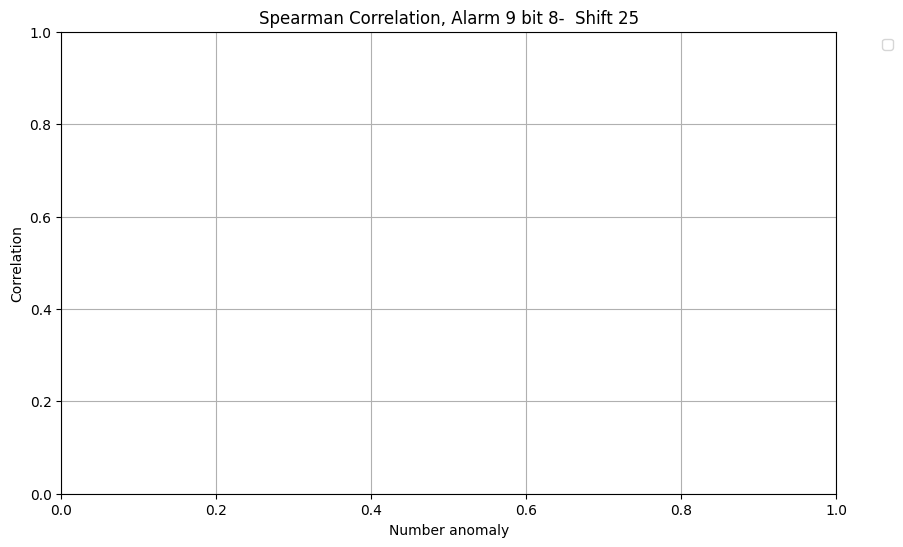

Plotting all non-NaN Pearson coefficients
43


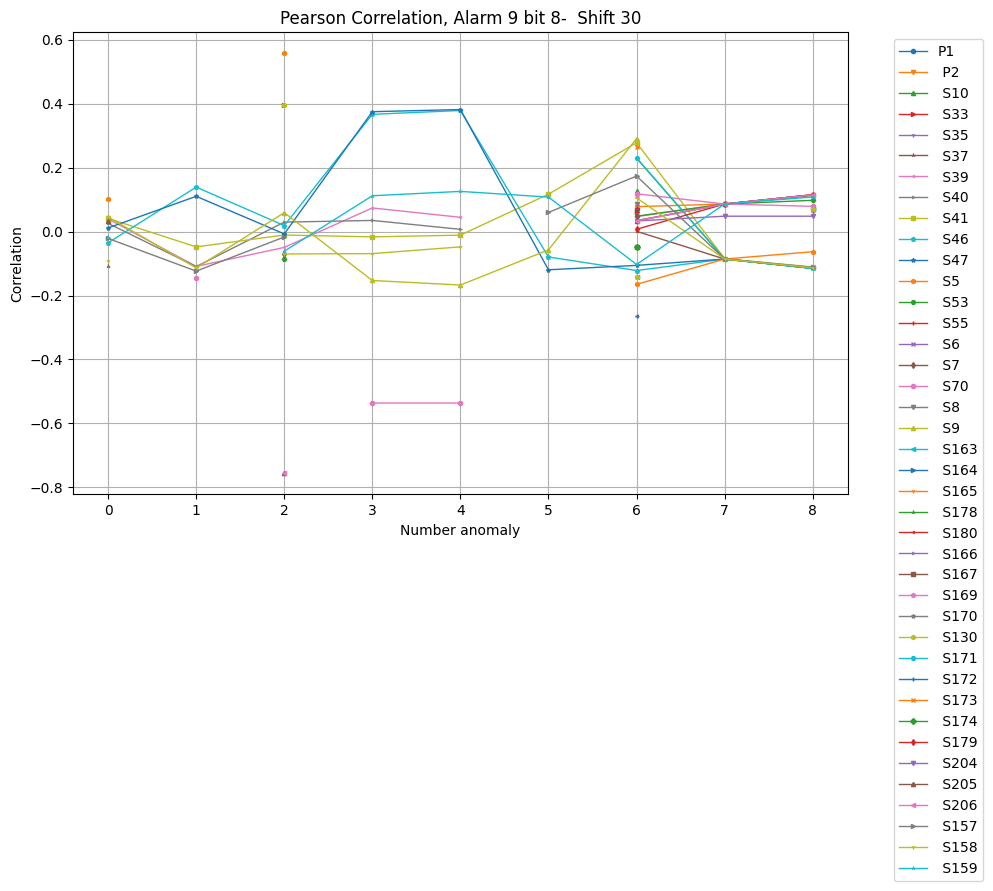

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


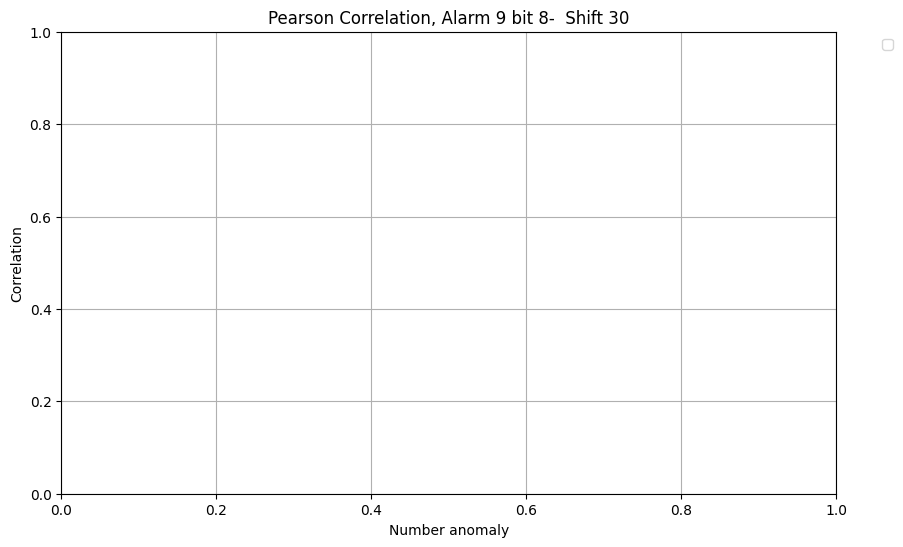

Plotting all non-NaN Spearman coefficients
43


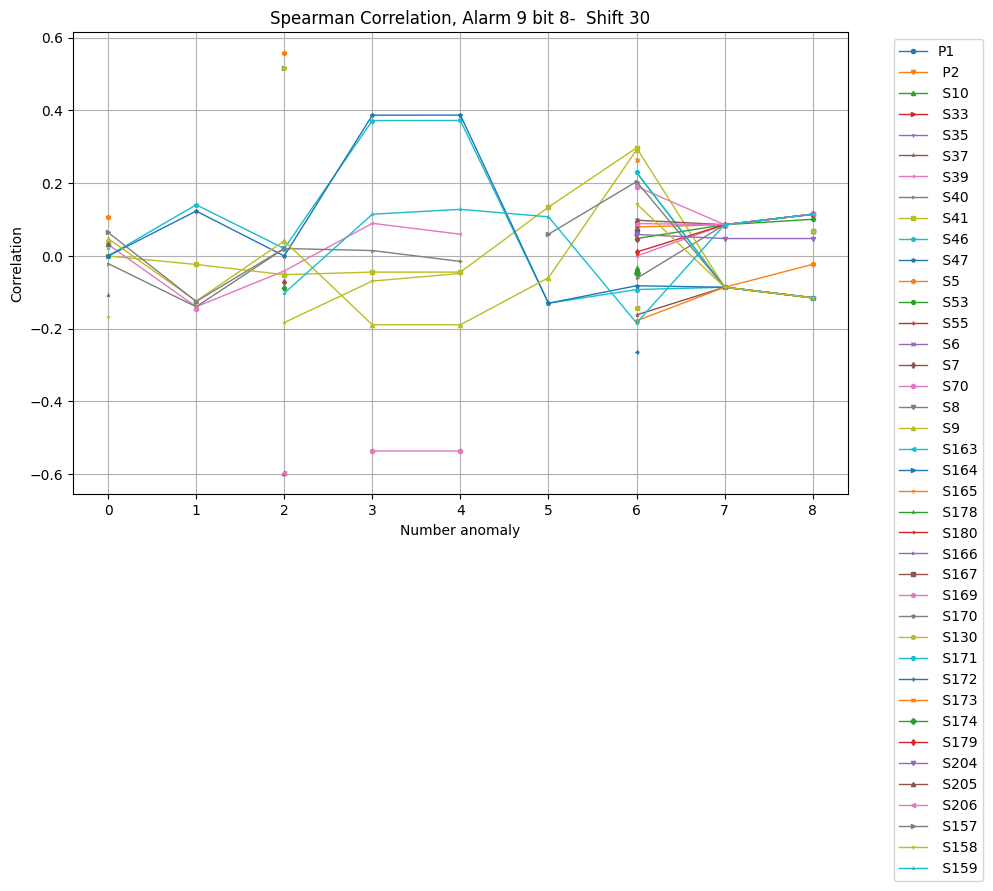

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


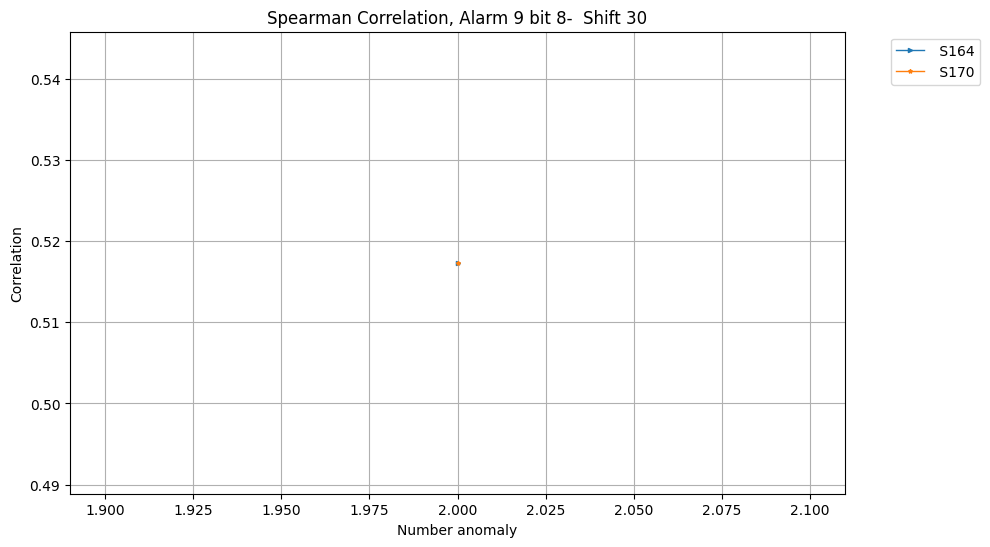

In [10]:
for shift in shifts:

    text1=col_names[2]
    text2=f'Shift {shift}'

    file_path= f'./{columns[2]}_shift{shift}_correlations.txt'

    print(f'Plotting all non-NaN Pearson coefficients')
    aux.read_and_plot(file_path,'Pearson',text1,text2)
    print(f'Plotting Pearson coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Pearson',text1,text2,avg_lim=limit_value)
    print(f'Plotting all non-NaN Spearman coefficients')
    aux.read_and_plot(file_path,'Spearman',text1,text2)
    print(f'Plotting Spearman coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Spearman',text1,text2,avg_lim=limit_value)

Plotting all non-NaN Pearson coefficients
43


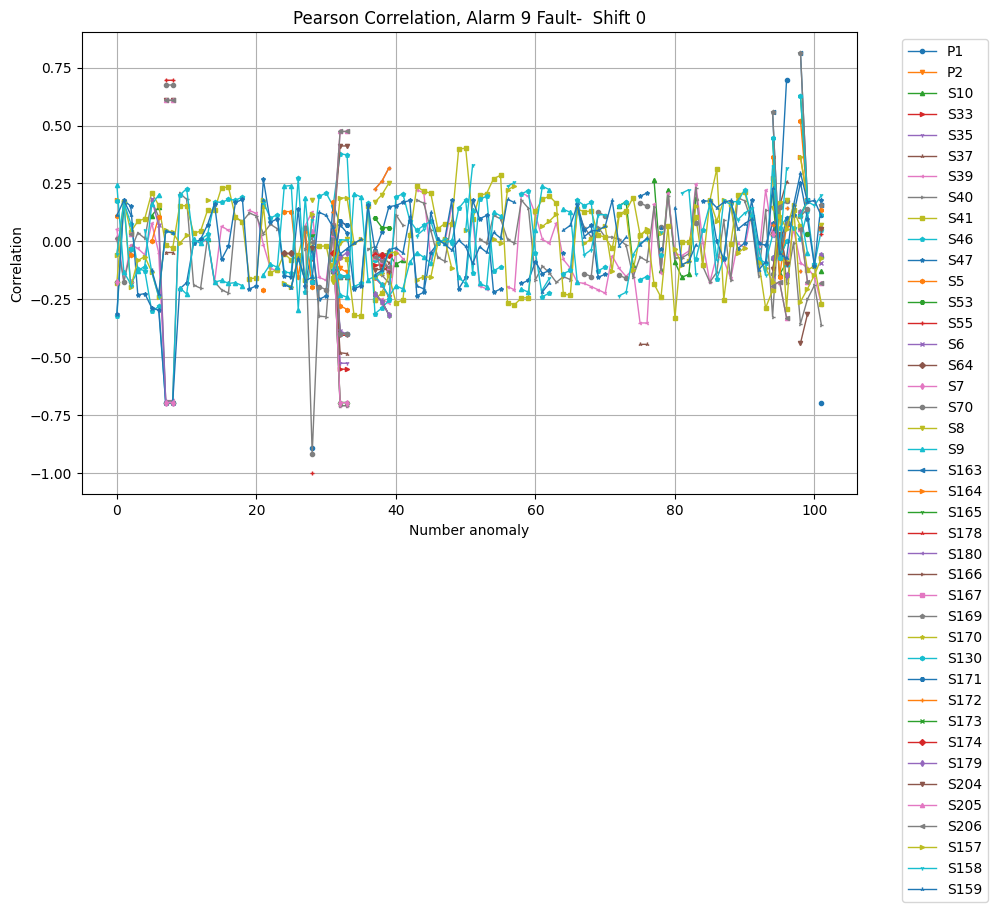

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


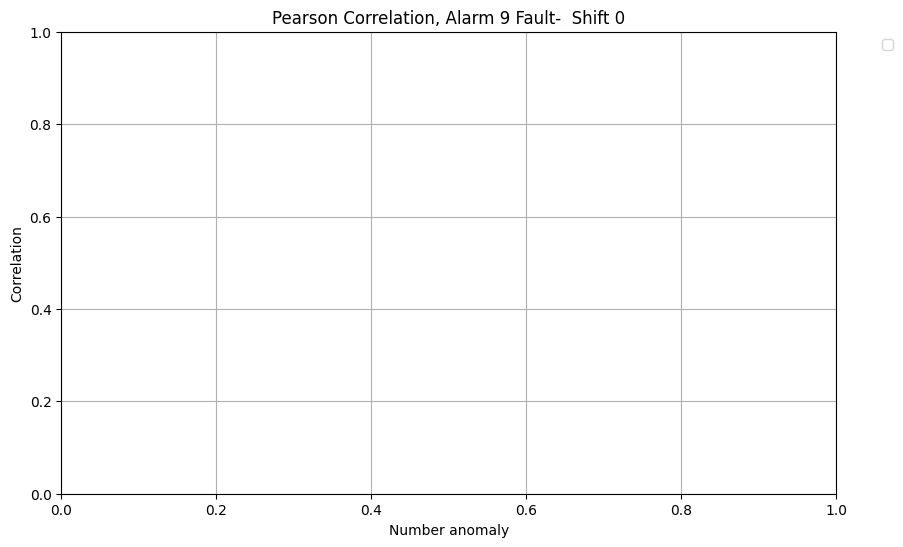

Plotting all non-NaN Spearman coefficients
43


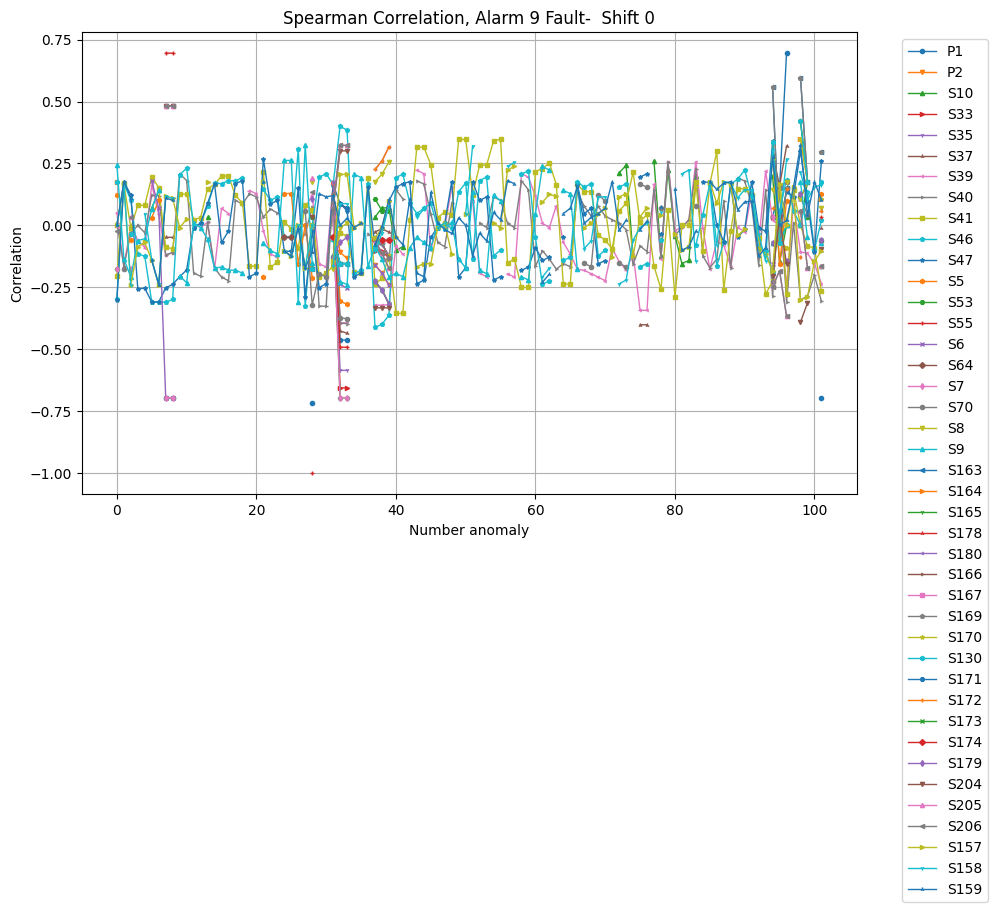

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


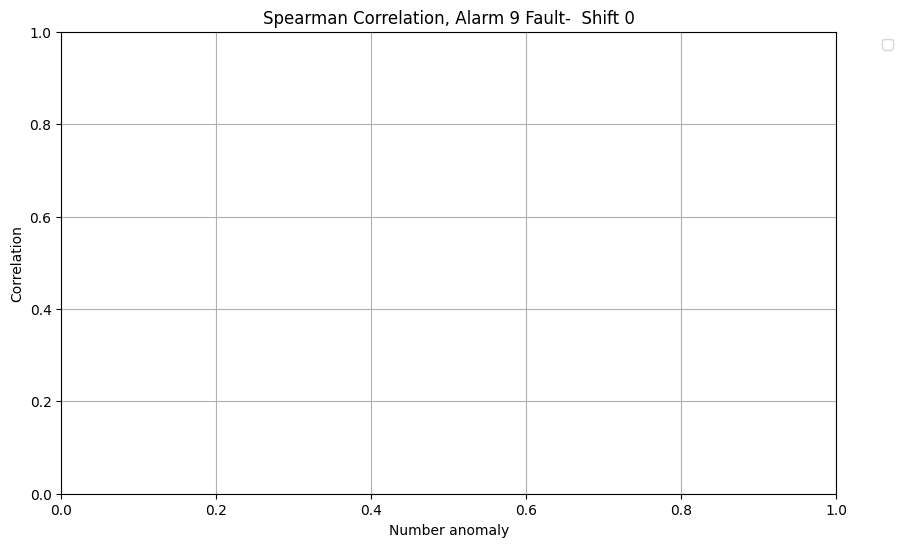

Plotting all non-NaN Pearson coefficients
43


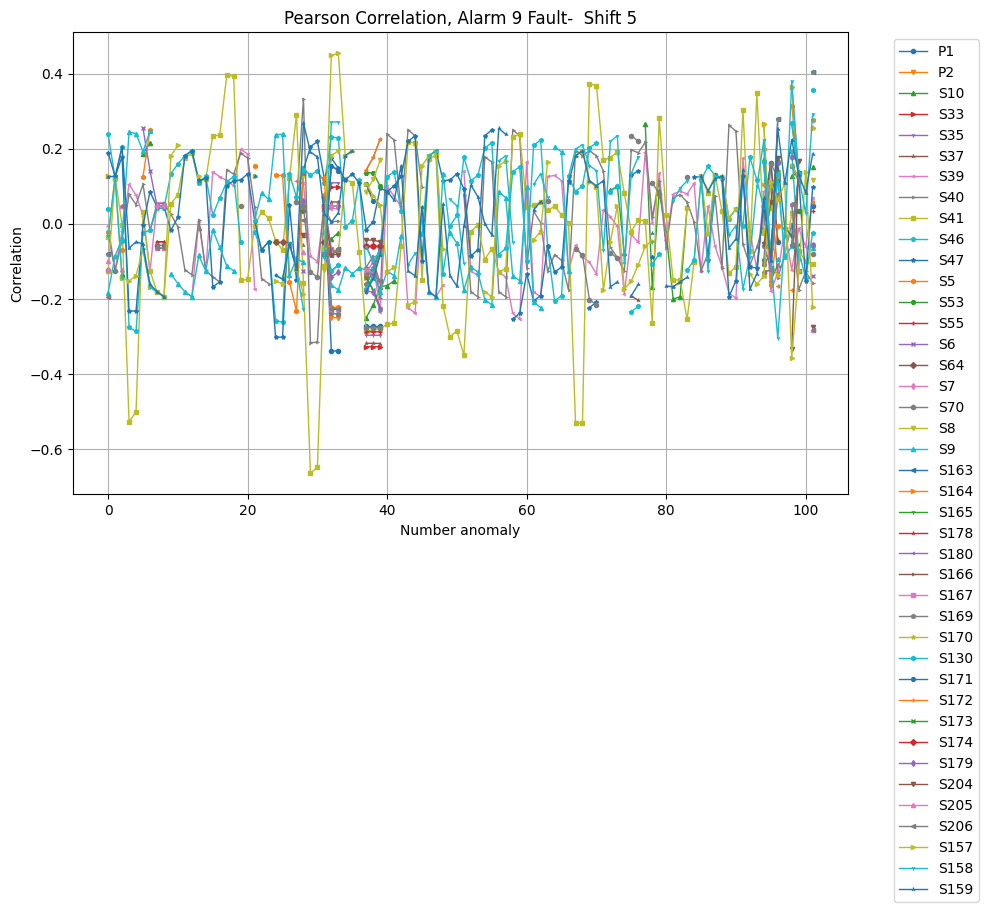

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


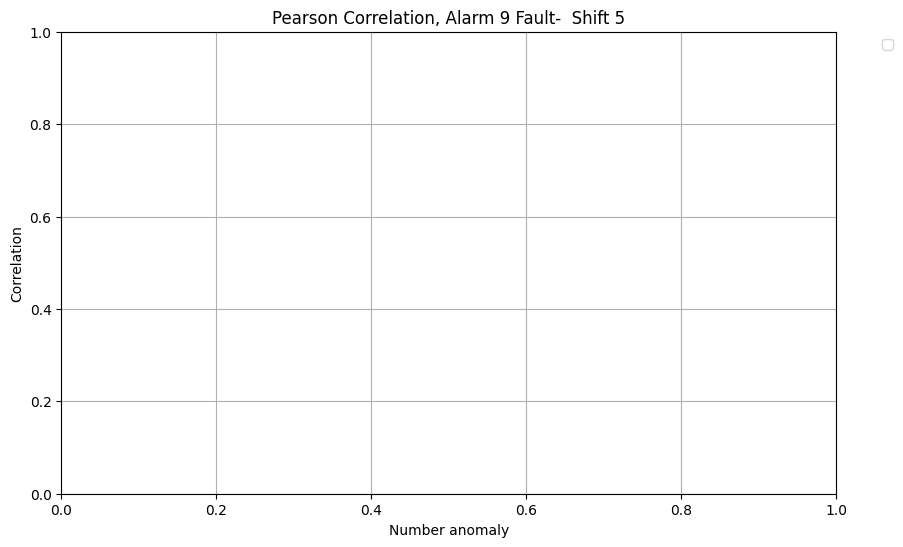

Plotting all non-NaN Spearman coefficients
43


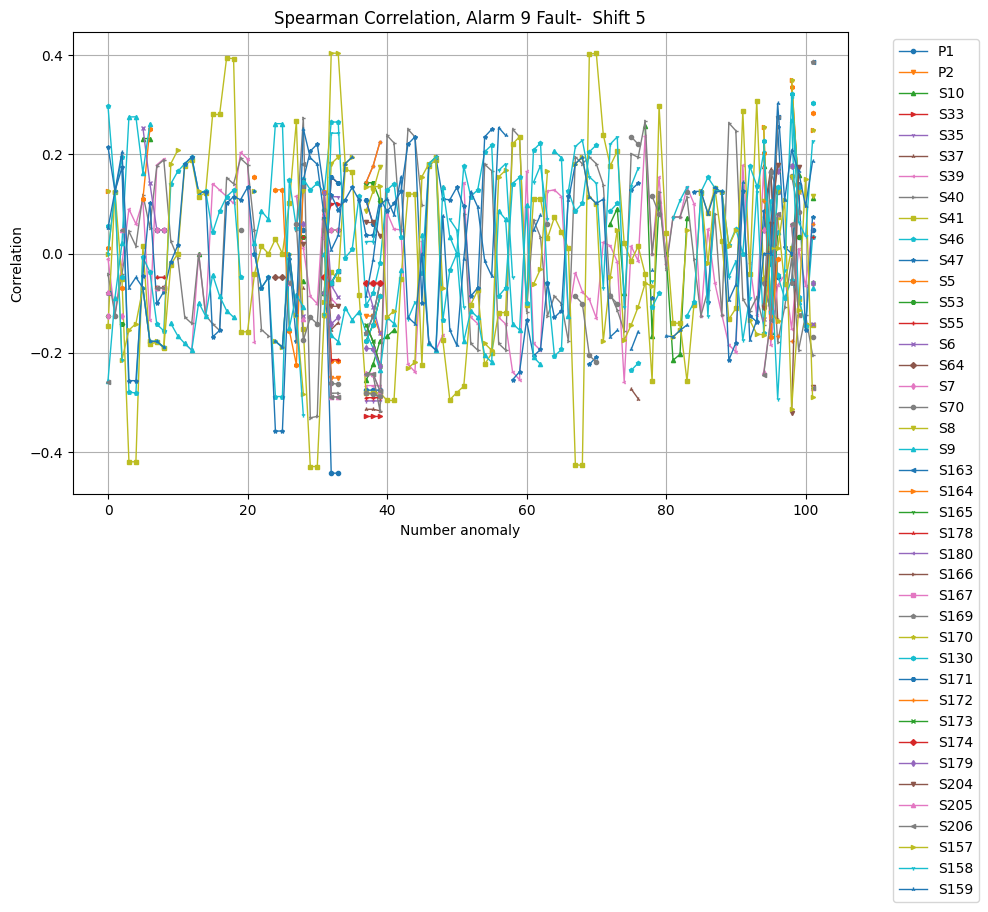

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


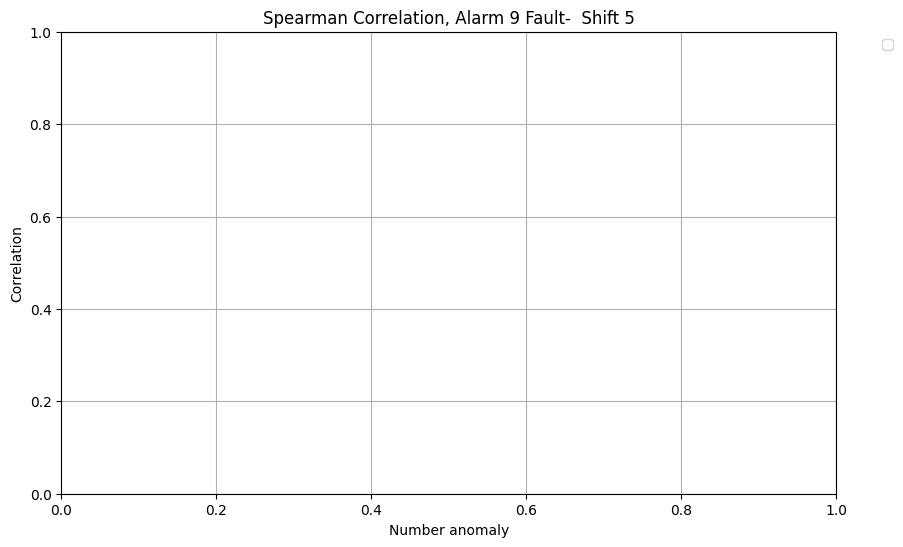

Plotting all non-NaN Pearson coefficients
43


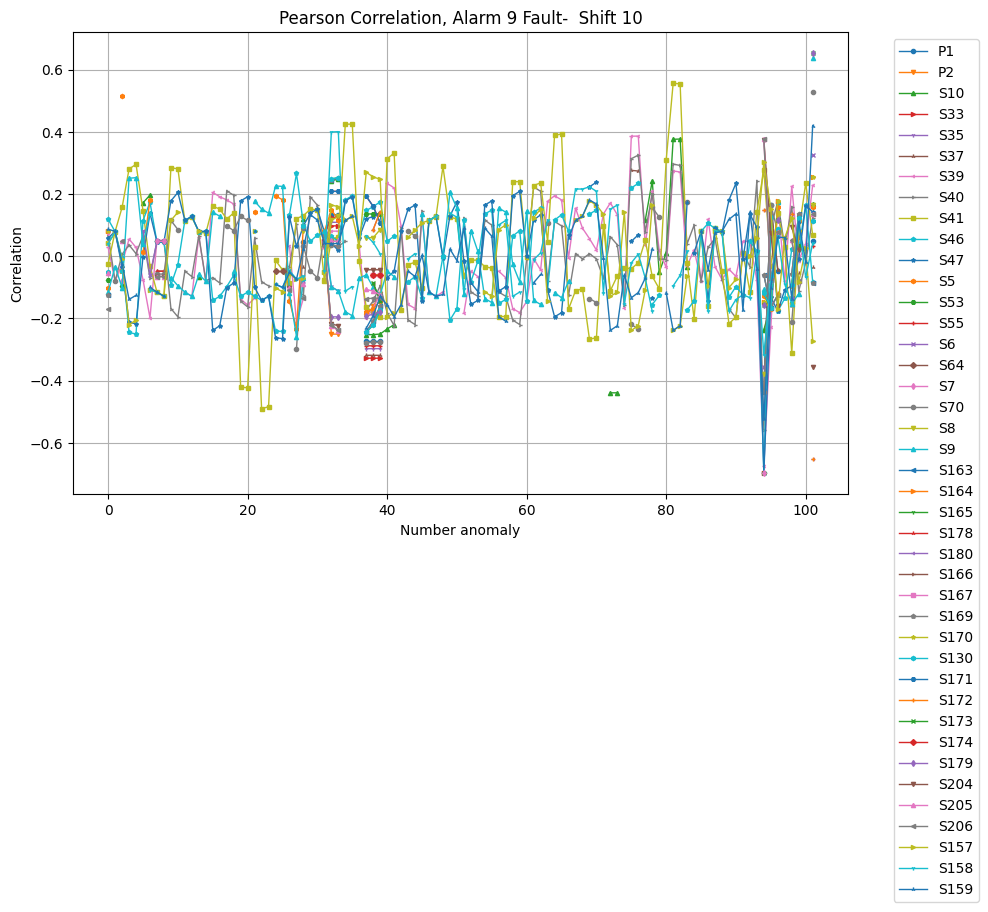

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


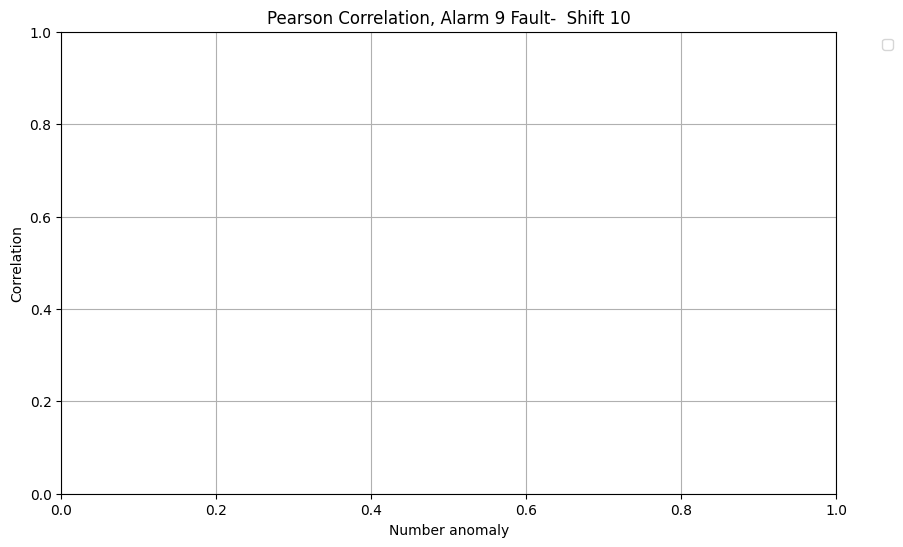

Plotting all non-NaN Spearman coefficients
43


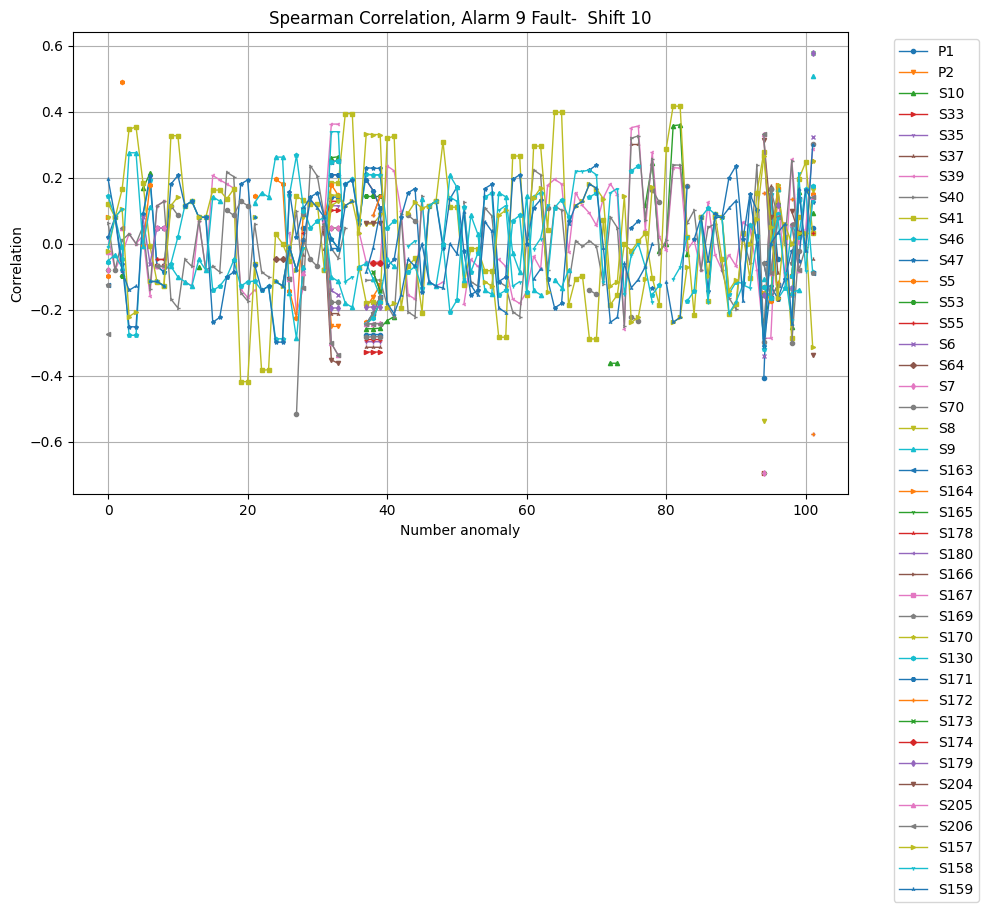

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


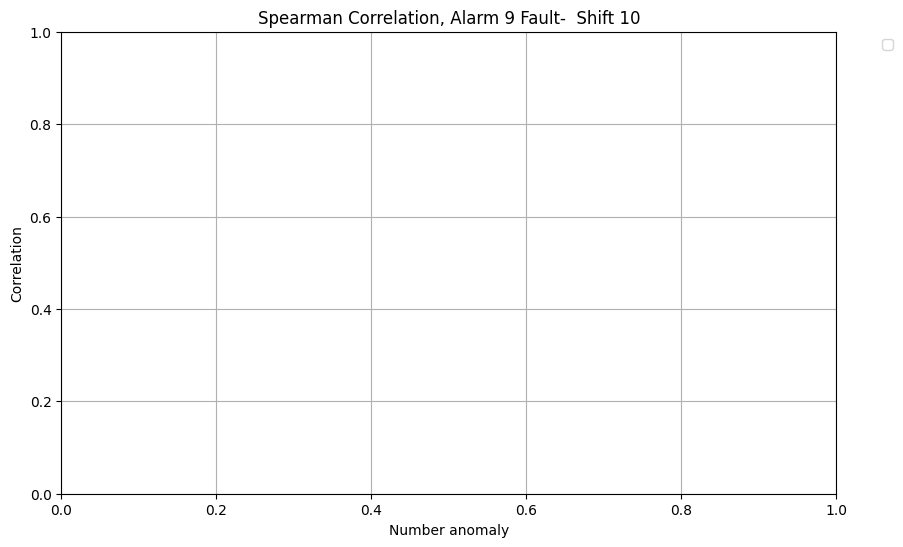

Plotting all non-NaN Pearson coefficients
43


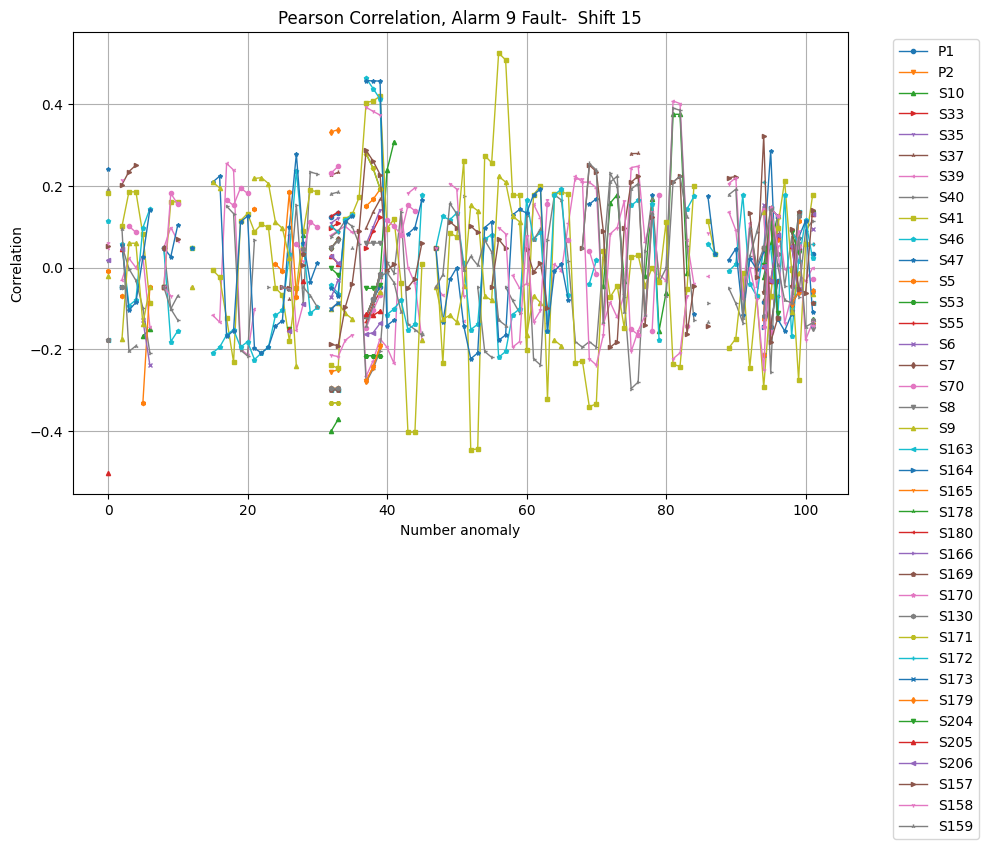

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


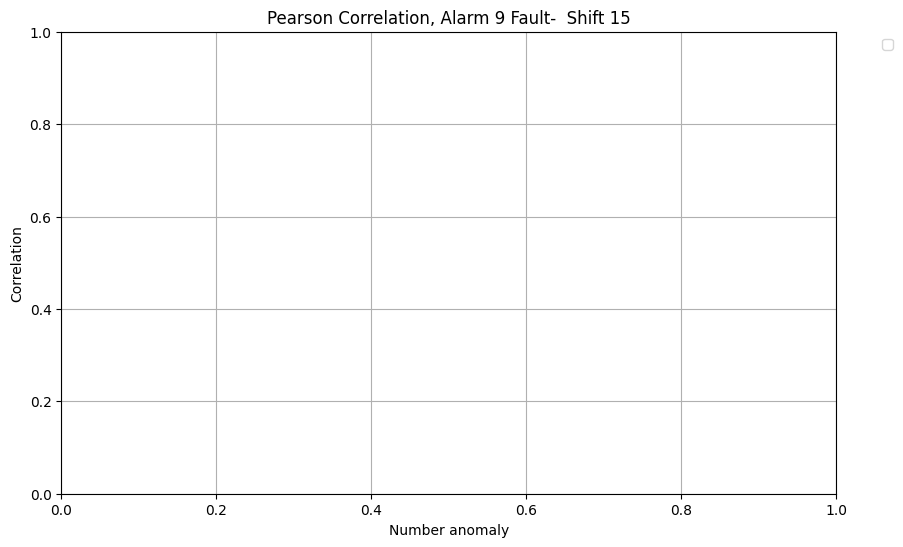

Plotting all non-NaN Spearman coefficients
43


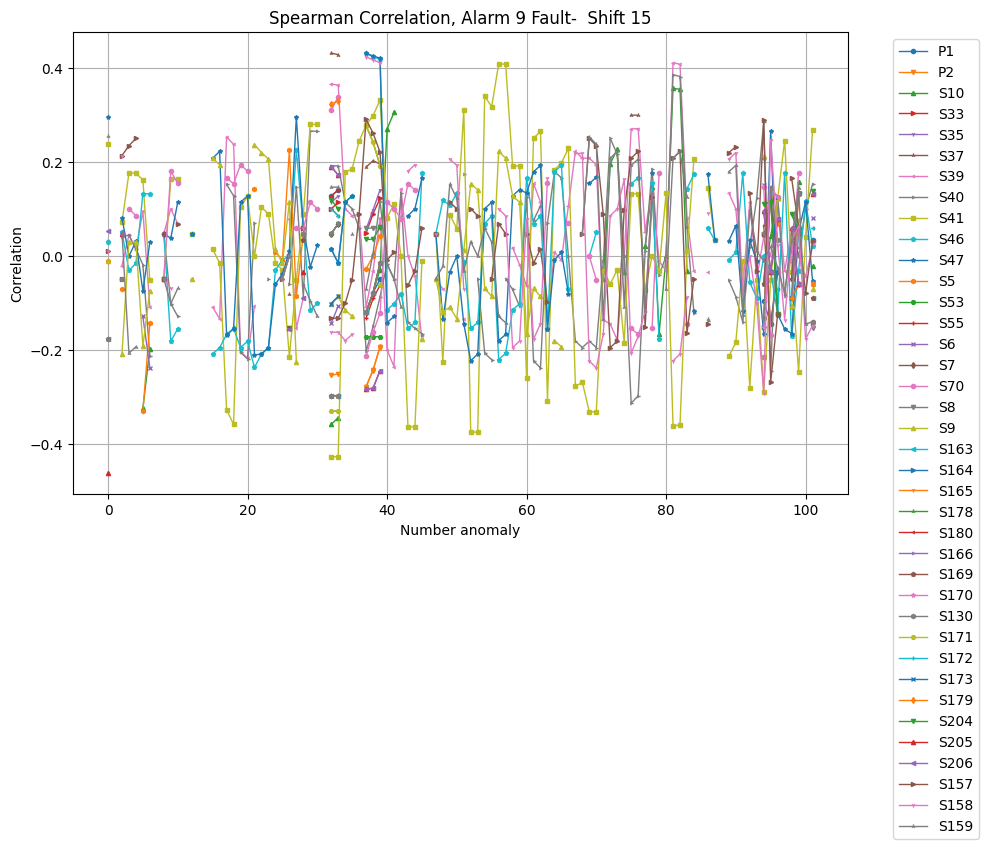

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


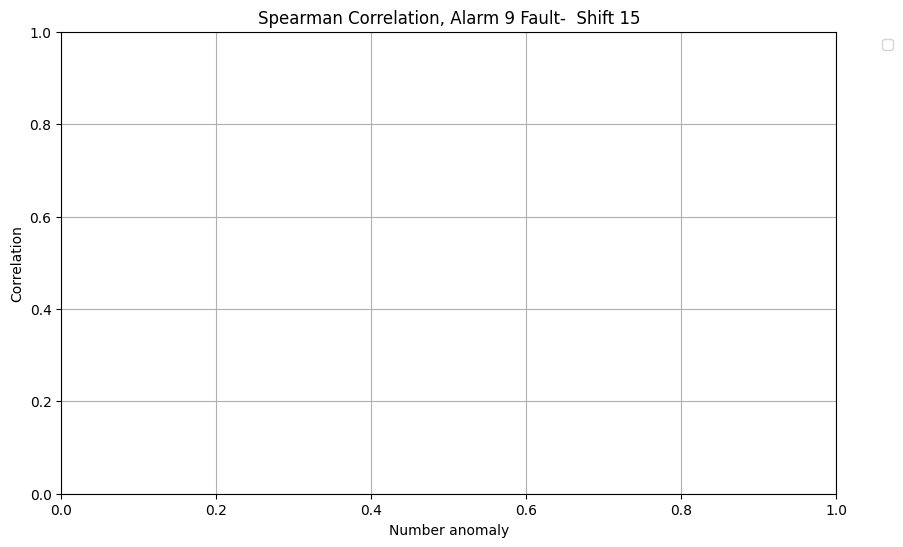

Plotting all non-NaN Pearson coefficients
43


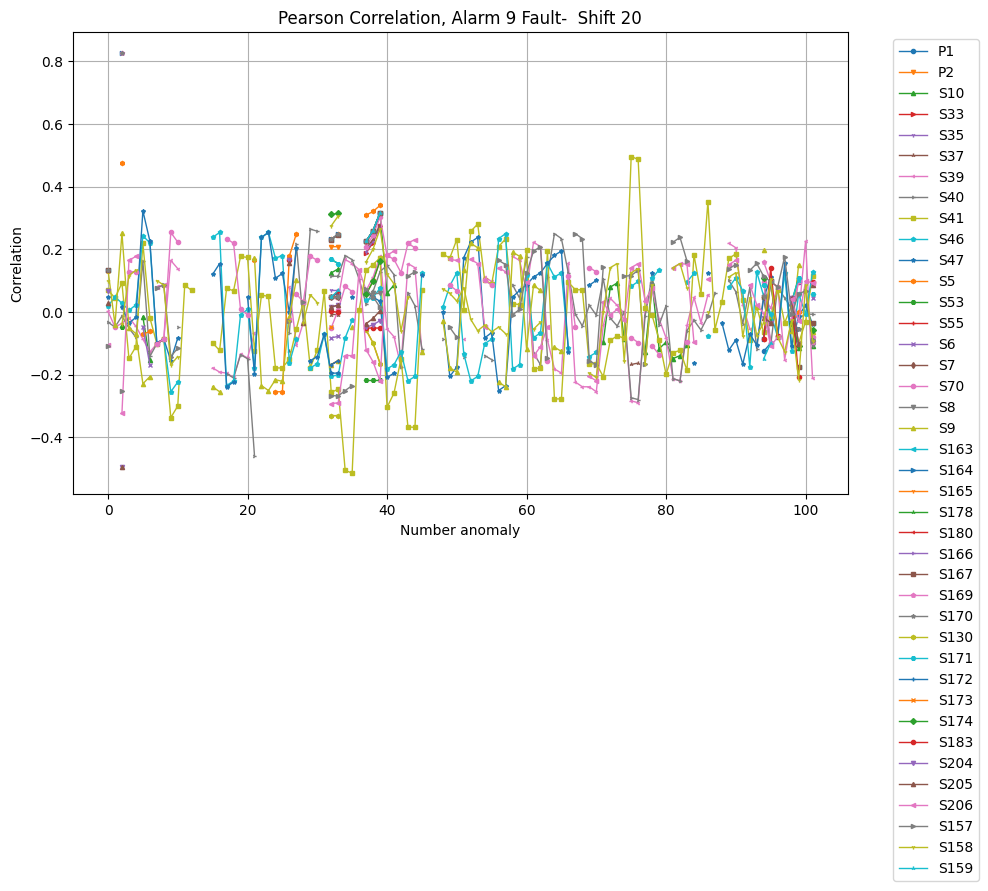

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


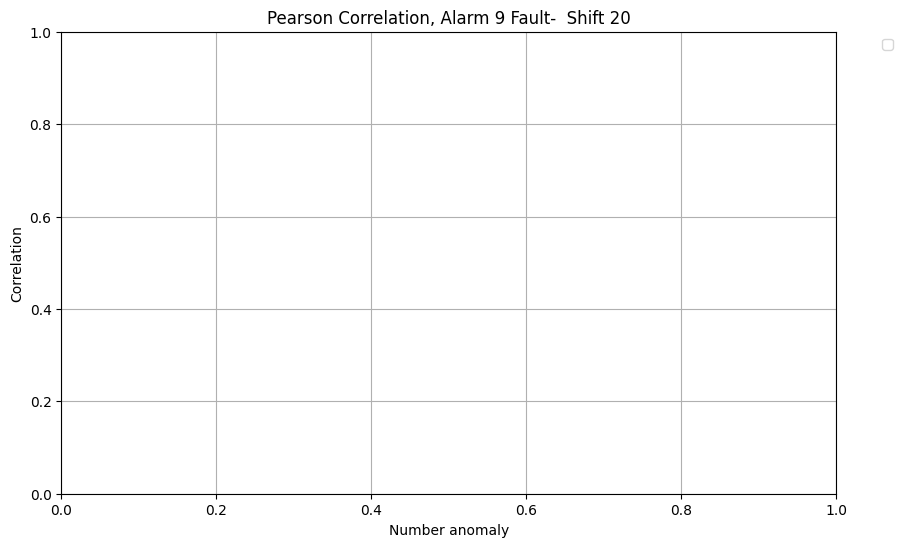

Plotting all non-NaN Spearman coefficients
43


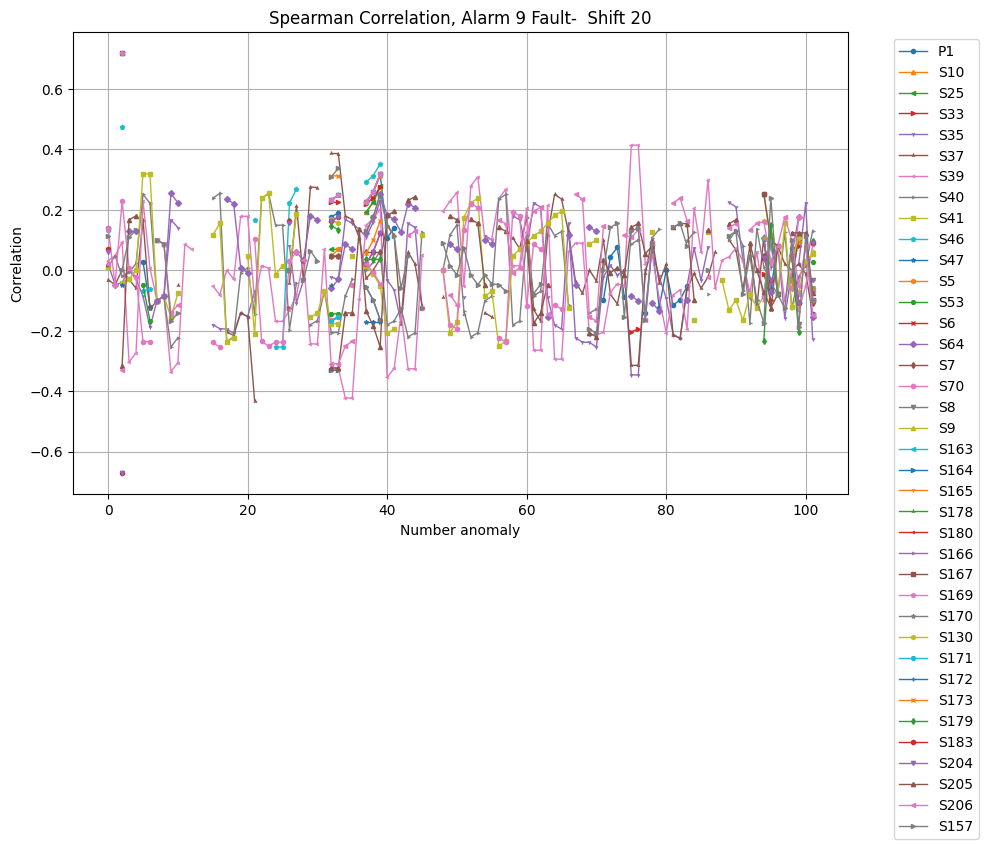

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


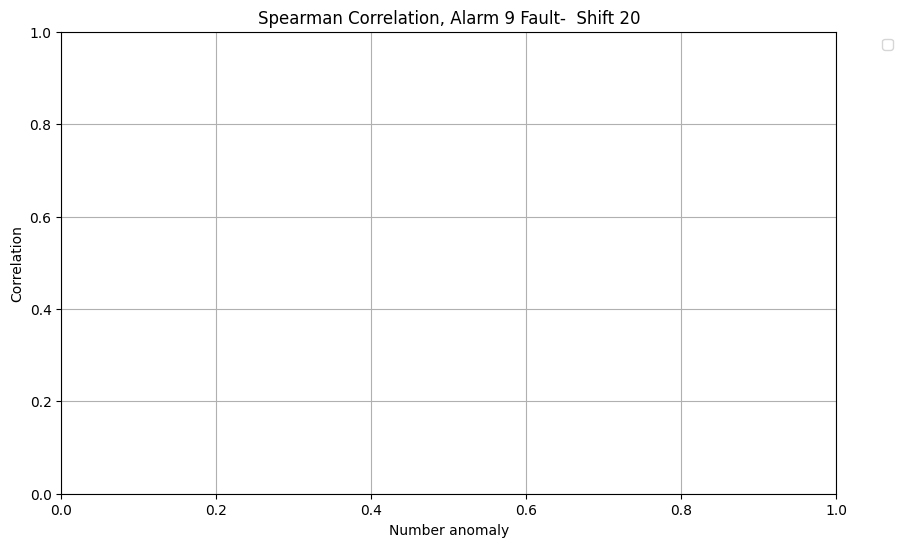

Plotting all non-NaN Pearson coefficients
43


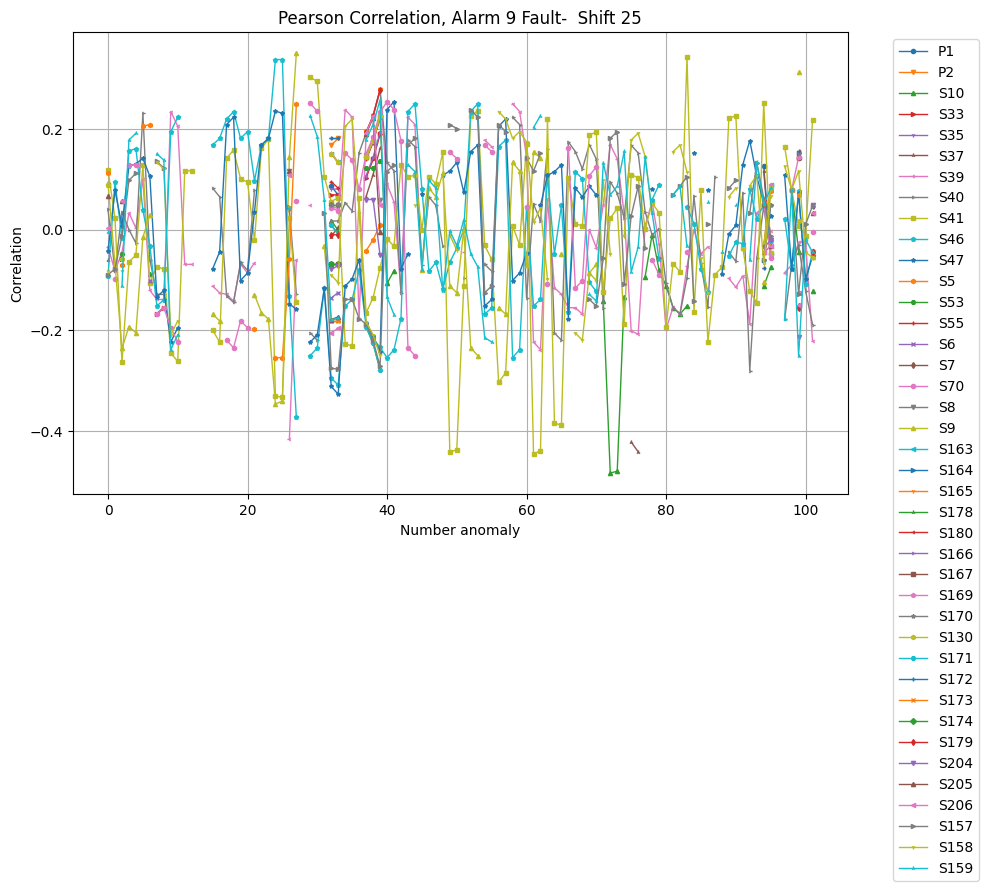

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


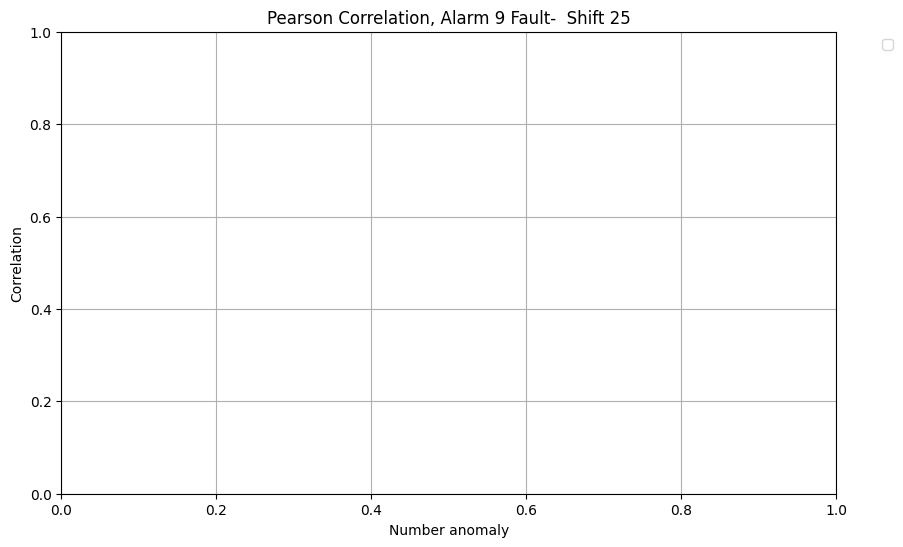

Plotting all non-NaN Spearman coefficients
43


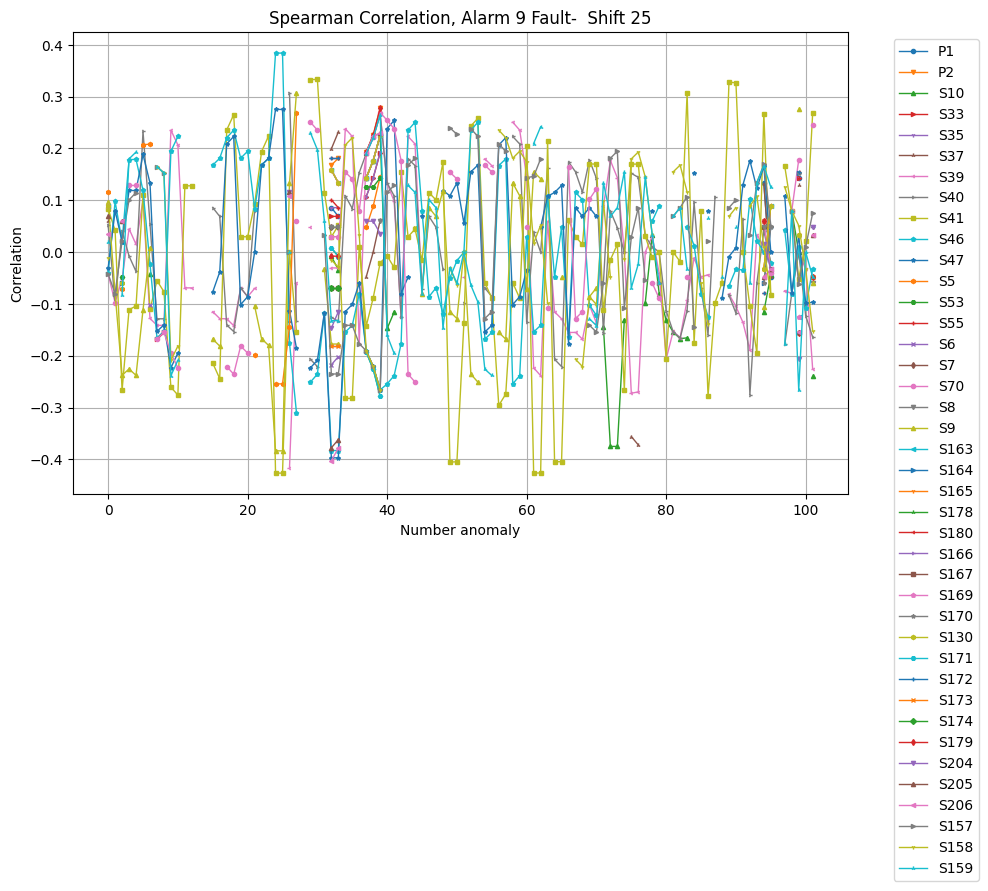

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


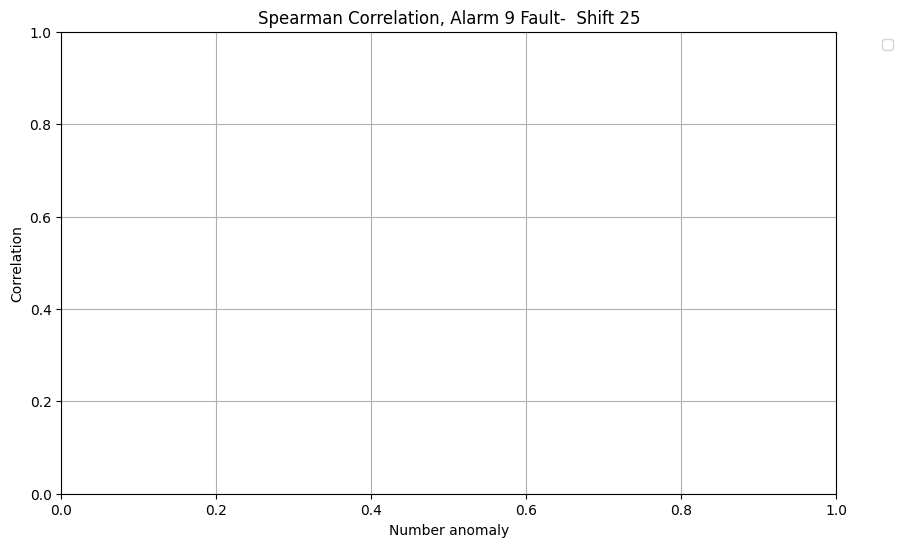

Plotting all non-NaN Pearson coefficients
43


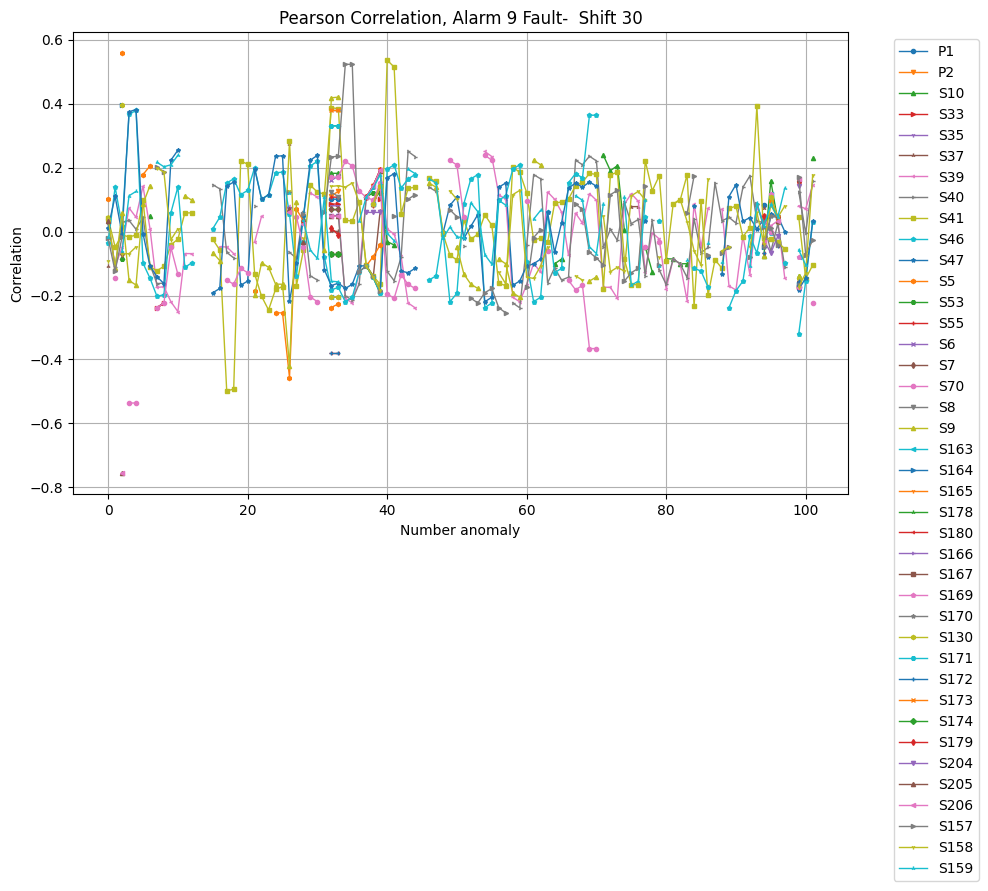

Plotting Pearson coefficients of metrics that have a mean value greater than 0.4
43


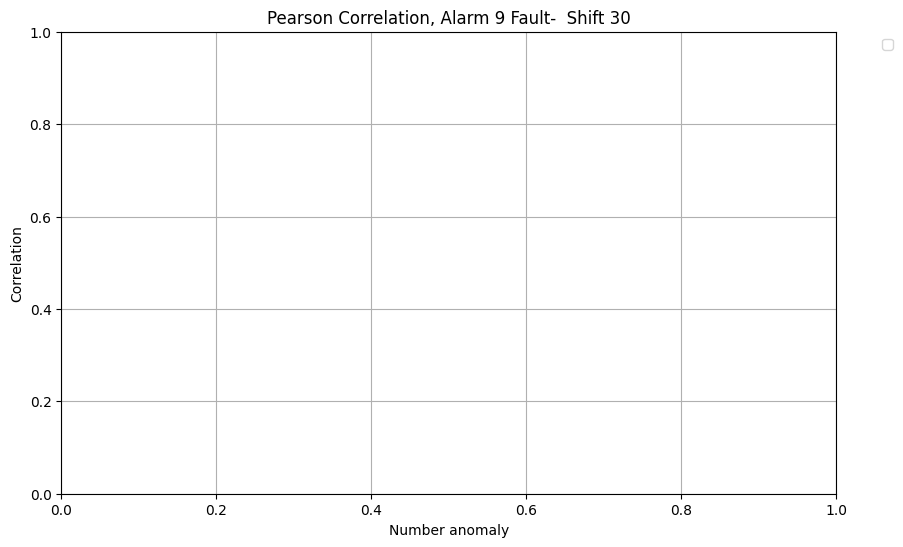

Plotting all non-NaN Spearman coefficients
43


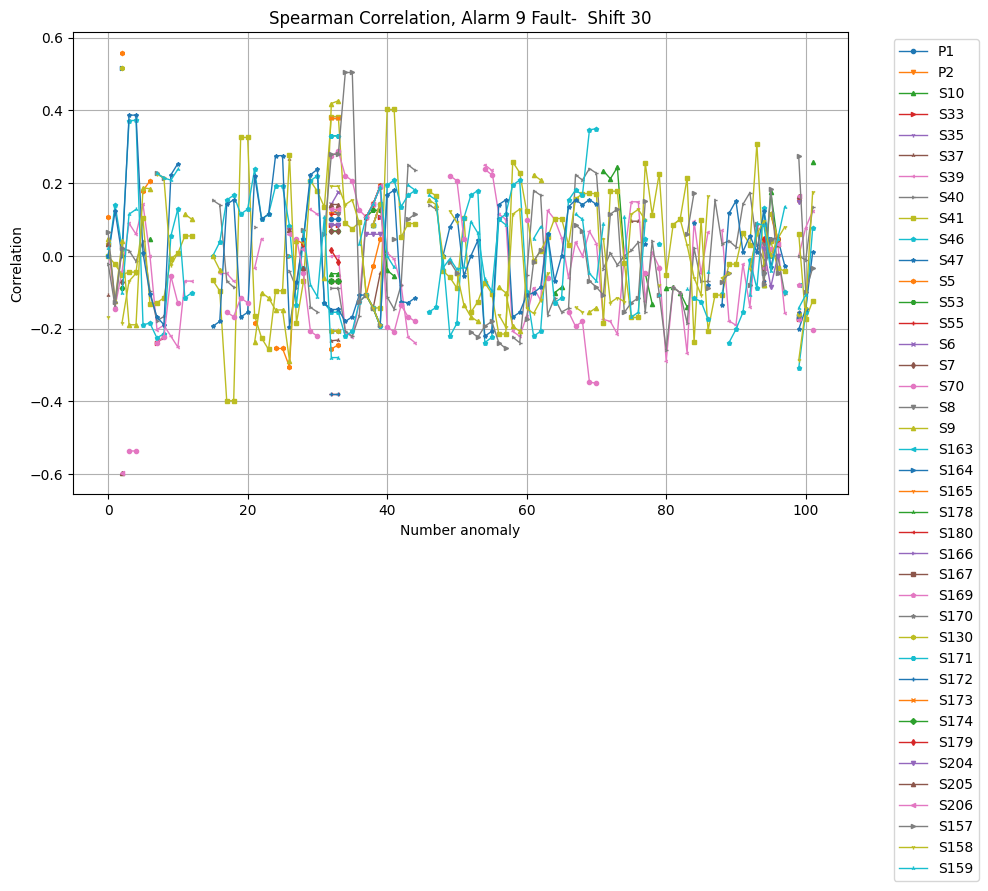

Plotting Spearman coefficients of metrics that have a mean value greater than 0.4
43


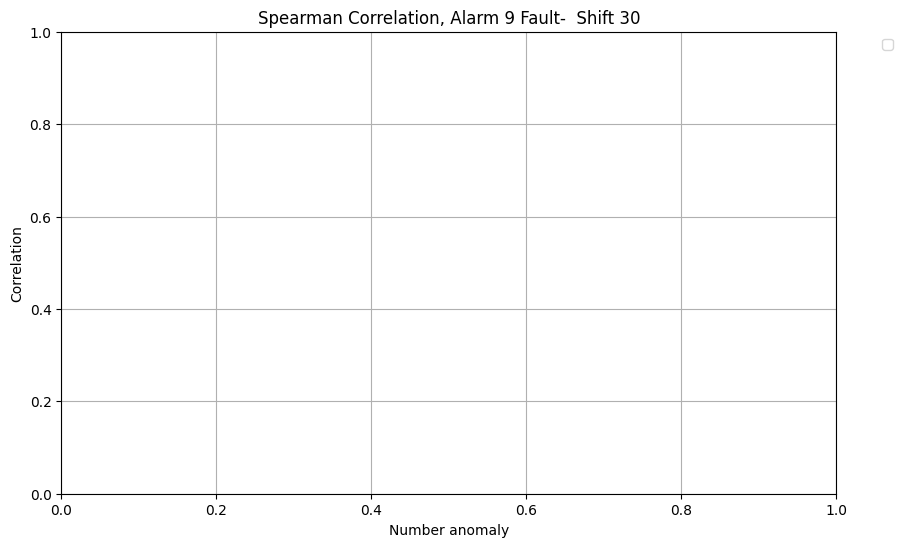

In [11]:
for shift in shifts:

    text1=col_names[3]
    text2=f'Shift {shift}'

    file_path= f'./{columns[3]}_shift{shift}_correlations.txt'

    print(f'Plotting all non-NaN Pearson coefficients')
    aux.read_and_plot(file_path,'Pearson',text1,text2)
    print(f'Plotting Pearson coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Pearson',text1,text2,avg_lim=limit_value)
    print(f'Plotting all non-NaN Spearman coefficients')
    aux.read_and_plot(file_path,'Spearman',text1,text2)
    print(f'Plotting Spearman coefficients of metrics that have a mean value greater than {limit_value}')
    aux.read_and_plot(file_path,'Spearman',text1,text2,avg_lim=limit_value)